# Matteo Circa's analysis

In [1]:
!pip install -r requirements.txt
%pip install ffmpeg-python
%pip install ffmpeg

ERROR: Could not find a version that satisfies the requirement matplotlib==3.4.2 (from versions: 0.86, 0.86.1, 0.86.2, 0.91.0, 0.91.1, 1.0.1, 1.1.0, 1.1.1, 1.2.0, 1.2.1, 1.3.0, 1.3.1, 1.4.0, 1.4.1rc1, 1.4.1, 1.4.2, 1.4.3, 1.5.0, 1.5.1, 1.5.2, 1.5.3, 2.0.0b1, 2.0.0b2, 2.0.0b3, 2.0.0b4, 2.0.0rc1, 2.0.0rc2, 2.0.0, 2.0.1, 2.0.2, 2.1.0rc1, 2.1.0, 2.1.1, 2.1.2, 2.2.0rc1, 2.2.0, 2.2.2, 2.2.3, 2.2.4, 2.2.5, 3.0.0rc2, 3.0.0, 3.0.1, 3.0.2, 3.0.3, 3.1.0rc1, 3.1.0rc2, 3.1.0, 3.1.1, 3.1.2, 3.1.3, 3.2.0rc1, 3.2.0rc3, 3.2.0, 3.2.1, 3.2.2, 3.3.0rc1, 3.3.0, 3.3.1, 3.3.2, 3.3.3, 3.3.4)
ERROR: No matching distribution found for matplotlib==3.4.2
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


## Importing libraries

In [2]:
#%matplotlib notebook
%matplotlib inline

from pymongo import MongoClient

import datetime

import matplotlib
import matplotlib.pyplot as plt
import pandas as pd

import numpy as np
from numpy import inf

import seaborn as sns

from scipy.stats import norm

import liwc
import re
from collections import Counter

import itertools

import math

import bar_chart_race as bcr

import warnings

sns.set_theme()

_A big thanks to the work of Constantin Popa, for the cleaning of datas and the methods listed here below before "Let's do the sentiment analysis for each work in each community" paragraph._

## Reporting collection document's structure in MongoDB

Example of Harry Potter collection document:
- _id (ObjectID): This ID is the default key that is generated by Mongo to uniquely identify each document in the collection. Its type is a special Mongo type, and it consists of 12-byte hexadecimal string values
- **id**: the work ID on AO3 (integer)
- **authors** (array of strings): a list of users that have contributed to writing the work. Most of the time, the works are released under a single username, although there are a few exceptions (less than 1% of the works in each fandom) where there are collaborations on producing the fanfic.
- **title** (string): title of the work.
- **nchapters** (integer): the number of chapters that have been released so far (integer)
- **expected_chapters** (integer or string): the number of chapters that the author is expecting to release. It is often the case that the author does not know this number, so it will appear as a question mark on AO3. The Mongo DB documents capture this information by storing the "N/A" placeholder value which will make this field become a string rather than an integer.
- **complete** (boolean): indicates whether the author is going to publish new chapters in the future or the work has been completed and marked as such (boolean)
- **status** (string): similar to the previous one, it describes the status of the work as a human-readable string. The possible values are In Progress or Complete.
- **date_updated** (datetime): the last time the author has edited their work, stored using the ISO Date format.
- **hits** (integer): the number of clicks the work has received. This number increases each time the work is loaded, therefore it might not correlate perfectly with the number of distinct users that access a specific work.
- **language** (string): the (main) language the work is written in, stored as human-readable string (e.g: English rather than EN).
- **summary** (string): a short work summary written by the author of the work.
- **tags** (array of strings): a list of (optional) and user-defined (i.e: a new tag can be created at anytime even if it was not used on the platform before) tags added by the author (e.g: Mystery, Crossover, Drama).
- **nkudos** (integer or string): the number of kudos the work has received. Sometimes this number is not available on AO3, so in order to distinguish between an unknown value and an actual zero, the "N/A" value is used like we did for the number of expected chapters, hence the field becomes a string.
- **nbookmarks** (integer or string): the number of bookmarks a work has received (see nkudos).
- **ncomments** (integer or string): the number of total comments a work has received (see nkudos).
- **words** (integer): the number of total words of a work.
- **chapters** (array of objects): this is one of the nested structures mentioned earlier. Each item in the list represent one chapter and is described by two inner fields:
    - _id_ (integer): identifier of the chapter (as can be seen on AO3)
    - _title_ (string): the title of the chapter.
- **date_published** (datetime): the date and time when the work was added to AO3.

- **kudos** (array of strings): The users who left a kudo on the work. Each item in the list represent one username.

- **bookmarks** (array of objects): this is one is a nested structure as well and each item represents one bookmark having the following attributes:
    - _author_: the username of the user who created the bookmark
    - _datetime_ (datetime): the date when the bookmark was created store as ISO Date
    - _text_ (string): the (optional) message that the user chose to attach to the bookmark
    - _type_ (string): it can be either a Recommendation, Public or Private, although by far the most common value is Public.
- **fandoms** (array of strings): list of fandom names the work is present in. In most of the cases this is redundant since the fandom is implicitly captured by the Mongo collection a work is present in. However, crossovers (fanfics across multiple universes) can contain a list with more than one element.

Example of Harry Potter Comments collection document:
- _id (ObjectID): This ID is the default key that is generated by Mongo to uniquely identify each document in the collection. Its type is a special Mongo type, and it consists of 12-byte hexadecimal string values
- **id** (integer): the comment ID on AO3. This identifier can be used to retrieve the thread rooted in the comment with a given id.
- **author** (string): the username of the user who left the comment.
- **chapter** (integer): the chapter number - please note this is not the chapter identifier, but rather a sequence number starting at 1 of the chapters inside a work - the user has commented on.
- **datetime** (datetime): the date and time the user have left the comment
- **parent_id** (integer): the id of the comment the user has replied to. In case it is a top level comment, the value is null.
- **work_id** (integer) : the id of the work associated to this comment. This is the same identifier named id in the above collection.
- **text** (string): the content of the comment.

## Let's retrieve datas

In [3]:
#For offline working
works_dfs = {}
works_collected_categories_desc = {}
ao3_comments_dfs = {}
liwc_categories_main = [ 'Posemo', 'Negemo', 'Anx', 'Anger', 'Sad', 'Ppron', 'I', 'SheHe', 'We', 'They', 'You', 'Ipron', 'Male', 'Female', 'See', 'Hear', 'Feel' ]
FANDOMS = [ 'marvel', 'harry_potter', 'sherlock_holmes', 'lord_of_the_rings', 'percy_jackson', 'twilight', 'marvel' ]
parse, category_names = liwc.load_token_parser('English_LIWC2015_Dictionary.dic')
def tokenize(text):
    # it is possible to use a smarter tokenizer
    for match in re.finditer(r'\w+', text, re.UNICODE):
        yield match.group(0)
for fandom in ['marvel']:
    print(f"Creating dataframes in {fandom}...")
    df = pd.read_csv(f'{fandom}_works_dfs.csv')
    df = df.drop([df.columns[0]], axis=1)
    works_dfs[fandom] = df
    df = pd.read_csv(f'{fandom}_works_collected_categories_desc.csv')
    df = df.drop([df.columns[0]], axis=1)
    works_collected_categories_desc[fandom] = df
    df = pd.read_csv(f'{fandom}_ao3_comments_dfs.csv')
    df = df.drop([df.columns[0]], axis=1)
    df['datetime'] = pd.to_datetime(df['datetime'], errors='coerce')
    df['text'] = df['text'].astype(str)
    ao3_comments_dfs[fandom] = df

Creating dataframes in marvel...


## Analysis of each community

In [4]:
#GLOBAL DEFINEMENTS - variables

#Part of the study related to the community
community_by_comment = {}
community_by_work = {}
community_by_author = {}
community_by_user = {}
community_by_author_only_text = {}
community_by_user_only_text = {}
authors = {}
authors_wid = {}
daily_stats = {}
total_stats = {}
monthly_stats = {}
daily_stats_by_work = {}
monthly_stats_by_work = {}
chapter_stats_by_work = {}
for fandom in FANDOMS:
    daily_stats_by_work[fandom] = {}
    monthly_stats_by_work[fandom] = {}
    chapter_stats_by_work[fandom] = {}
eligible_works = {}
authors_on_their_works = {}
authors_on_others_works = {}
for fandom in FANDOMS:
    authors_on_their_works[fandom] = pd.DataFrame()
    authors_on_others_works[fandom] = pd.DataFrame()
community_by_work_level_analysis = {}

categories_colors = {
    "Anger": "#ff0000",
    "Negemo": "#000000",
    "Posemo": "#ffb639",
    "Sad": "#3581b7",
    "Anx": "#8058a7"
}

#Part of the study related to the centrality of the author and the user more in general
authors_vs_others_comparison = {}
very_authors_vs_others_comparison = {}
author_vs_non_author_comparison = {}
author_vs_others_per_work = {}
author_vs_non_author = {}
word_frequency_author_vs_others_author = {}
word_frequency_author_vs_others_others = {}
word_frequency_author_vs_non_author_author = {}
word_frequency_author_vs_non_author_non_author = {}

In [5]:
#GLOBAL DEFINEMENTS - functions

def f(x, y):
    if(x!=0):
        return round(x/y, 2)
    else:
        return 0.00

def plot_sma(df, category, polynomial_degree, rm1=20, rm2=50, rolling_mean=True, height=8, width=16, save_fig=False):
    plt.figure(figsize=(width, height))
    plt.plot(df.index, df[category], label=category)
    if(rolling_mean):
        rolling_mean1 = df[category].rolling(window=rm1).mean()
        rolling_mean2 = df[category].rolling(window=rm2).mean()
        plt.plot(df.index, rolling_mean1, label=f'{category} SMA - {rm1} rolling mean\'s window', color='orange')
        plt.plot(df.index, rolling_mean2, label=f'{category} SMA - {rm2} rolling mean\'s window', color='magenta')
    X = np.arange(0, len(df.index))
    z = np.polyfit(X, np.array(df[category]), polynomial_degree)
    p = np.poly1d(z)
    plt.plot(df.index, p(X), "--", color='black') #Trend Line
    plt.legend(loc='upper left')
    if save_fig:
        plt.savefig('pic', dpi=1200)
    plt.show()
    
def subplot_sma(plot, category, polynomial_degree, columns, rm1=20, rm2=50, rolling_mean=True, height=8, width=16):
    fig = plt.figure(figsize=(width, height))
    fig.subplots_adjust(wspace=0.07)
    for i in range(0, columns):
        ax = fig.add_subplot(1, columns, i+1)
        ax.plot(plot[i].index, plot[i][category], label=category)
        if(rolling_mean):
            rolling_mean1 = plot[i][category].rolling(window=rm1).mean()
            rolling_mean2 = plot[i][category].rolling(window=rm2).mean()
            ax.plot(plot[i].index, rolling_mean1, label=f'{category} SMA - {rm1} rolling mean\'s window', color='orange')
            ax.plot(plot[i].index, rolling_mean2, label=f'{category} SMA - {rm2} rolling mean\'s window', color='magenta')
        X = np.arange(0, len(plot[i].index))
        z = np.polyfit(X, np.array(plot[i][category]), polynomial_degree)
        p = np.poly1d(z)
        ax.plot(plot[i].index, p(X), "--", color='black') #Trend Line
        plt.legend(loc='upper left')

def plot_ema(df, category, polynomial_degree, w_exp1=20, w_exp2=50, exp=True, height=8, width=16):    
    plt.figure(figsize=(width, height))
    plt.plot(df.index, df[category], label=category)
    if(exp):
        exp1 = df[category].ewm(span=w_exp1, adjust=False).mean()
        exp2 = df[category].ewm(span=w_exp2, adjust=False).mean()
        plt.plot(df.index, exp1, label=f'{category} EMA - {w_exp1} exp\'s window')
        plt.plot(df.index, exp2, label=f'{category} EMA - {w_exp2} exp\'s window')
    X = np.arange(0, len(df.index))
    z = np.polyfit(X, np.array(df[category]), polynomial_degree)
    p = np.poly1d(z)
    plt.plot(df.index, p(X), "--", color='black') #Trend Line
    plt.legend(loc='upper left')
    plt.show()
    
def subplot_ema(plot, category, polynomial_degree, columns, w_exp1=20, w_exp2=50, exp=True, height=8, width=16):
    fig = plt.figure(figsize=(width, height))
    fig.subplots_adjust(wspace=0.07)
    for i in range(0, columns):
        ax = fig.add_subplot(1, columns, i+1)
        ax.plot(plot[i].index, plot[i][category], label=category)
        if(exp):
            exp1 = plot[i][category].ewm(span=w_exp1, adjust=False).mean()
            exp2 = plot[i][category].ewm(span=w_exp2, adjust=False).mean()
            plt.plot(plot[i].index, exp1, label=f'{category} EMA - {w_exp1} exp\'s window')
            plt.plot(plot[i].index, exp2, label=f'{category} EMA - {w_exp2} exp\'s window')
        X = np.arange(0, len(plot[i].index))
        z = np.polyfit(X, np.array(plot[i][category]), polynomial_degree)
        p = np.poly1d(z)
        ax.plot(plot[i].index, p(X), "--", color='black') #Trend Line
        plt.legend(loc='upper left')

def plt_corr(df, y_ax, x_ax, title, log_scale=False, xlog_scale=False, ylog_scale=False, xlim=0.1, ylim=0.1, polyfit=False, height=8, width=16):
    fig, ax = plt.subplots(figsize=(width, height))
    x = np.array(df[x_ax])
    y = np.array(df[y_ax])
    plt.scatter(x, y,
                edgecolor='black', linewidth=1, alpha=0.75)
    if(xlog_scale):
        plt.gca().set_xscale('log')
    if(ylog_scale):
        plt.gca().set_yscale('log')
    if(log_scale):
        plt.loglog()
    if(xlog_scale or ylog_scale or log_scale):
        for axis in [ax.xaxis, ax.yaxis]:
            axis.set_major_formatter(matplotlib.ticker.FuncFormatter(lambda y, _: '{:g}'.format(y)))
        ax.set_xlim(xlim)
        ax.set_ylim(ylim)
    if(polyfit):
        z = np.polyfit(x, y, 1)
        p = np.poly1d(z)
        plt.plot(x,p(x),"r--")
    plt.xlabel(x_ax)
    plt.ylabel(y_ax)
    plt.title(title)
    plt.tight_layout()
    plt.show()

def plot_zscore(df, pair, height=8, width=16):
    plt.figure(figsize=(width, height))
    for category in pair:
        plt.plot(
            df.index,
            (df[category] - df[category].mean())
            / df[category].std(),
            color=categories_colors[category],
            label=category,
        )
    plt.legend(
        bbox_to_anchor=(0.0, 1.02, 1.0, 0.102),
        loc="lower left",
        ncol=4,
        mode="expand",
        borderaxespad=0.0,
    )
    
def subplot_zscore(plot, pair, columns, height=8, width=16):
    fig = plt.figure(figsize=(width, height))
    fig.subplots_adjust(wspace=0.07)
    for i in range(0, columns):
        ax = fig.add_subplot(1, columns, i+1)
        for category in pair:
            plt.plot(
                plot[i].index,
                (plot[i][category] - plot[i][category].mean())
                / plot[i][category].std(),
                color=categories_colors[category],
                label=category,
            )
        plt.legend(
            bbox_to_anchor=(0.0, 1.02, 1.0, 0.102),
            loc="lower left",
            ncol=4,
            mode="expand",
            borderaxespad=0.0,
        )
    
def plot_histogram_density_function(variable, title, xlabel, ylim, bins, height=8, width=16):
    fig, ax = plt.subplots(figsize=(width, height))
    variable.plot(kind="hist", bins=bins)
    #X
    ax.set_xlabel(xlabel)
    ax.set_xlim(0)
    ax.set_title(title[0])
    plt.show()

    fig, ax = plt.subplots(figsize=(width, height))
    #Plot histogram
    variable.plot(kind="hist", density=True, bins=bins, alpha=0.7) #change density to true, because KDE uses density
    #Plot KDE
    variable.plot(kind="kde", color='red')
    #X
    ax.set_xlabel(xlabel)
    ax.set_xlim(0)
    #Y
    ax.set_ylim(0, ylim)
    ax.set_title(title[1])
    plt.show()

    fig, ax = plt.subplots(figsize=(width, height))
    #Plot histogram
    variable.plot(kind="hist", density=True, bins=bins, alpha=0.7, label='_nolegend_') #change density to true, because KDE uses density
    #Plot KDE
    variable.plot(kind="kde", color='red', label='_nolegend_')
    #Quantile lines
    quant_5, quant_25, quant_50, quant_75, quant_95 = variable.quantile(0.05), variable.quantile(0.25), variable.quantile(0.5), variable.quantile(0.75), variable.quantile(0.95)
    quants = [[quant_5, 0.6, 0.16], [quant_25, 0.8, 0.26], [quant_50, 1, 0.36],  [quant_75, 0.8, 0.46], [quant_95, 0.6, 0.56]]
    quants_label = [ '5th', '25th', '50th', '75th', '95th']
    for i, label in zip(quants,quants_label):
        ax.axvline(i[0], alpha = i[1], ymax = i[2], linestyle = "--", linewidth=3, color='black', label=label)
    #X
    ax.set_xlabel(xlabel)
    ax.set_xlim(0)
    #Y
    ax.set_ylim(0, ylim)
    ax.set_yticklabels([])
    ax.set_ylabel("Frequency")
    ax.grid(False)
    ax.set_title(title[2])
    #Remove ticks and spines
    ax.tick_params(left=False, bottom=False)
    for ax, spine in ax.spines.items():
        spine.set_visible(False)
    plt.legend(loc=0)
    plt.show()
    
matplotlib.rcParams['animation.embed_limit'] = 2**128
def bar_chart_race(df):
    warnings.filterwarnings('ignore')
    selected_columns = df[['Posemo','Negemo','Anx','Anger','Sad']]
    new_df = selected_columns.copy()
    df = pd.DataFrame(new_df)
    df.index = pd.to_datetime(df.index)
    html = bcr.bar_chart_race(df, title='Emotional trends over time', period_fmt='%b %d, %Y')
    warnings.filterwarnings('default')
    return html

def calculate_percentages_avg(df):
    for i, row in df.iterrows():
        for category in liwc_categories_main:
            ifor_val = 0.00
            if row[category] != 0:
                    ifor_val = round(((row[category] / row['text_length']) * 100), 2)
            df.at[i,category] = ifor_val
    df['average_content_length'] = df.apply(lambda x: f(x.text_length, x.ncomments), axis=1)
    cols = df.columns.tolist()
    cols = cols[0:2] + cols[-1:] + cols[2:19]
    df = df[cols]
    return df

def show_distance(calculation_df, title, label_auth, label_non_auth, change_ylim=False):
    my_range=range(1,len(calculation_df.index)+1)
    plt.figure(figsize=(16, 8))
    plt.hlines(y=my_range, xmin=calculation_df['author'], xmax=calculation_df['non-author'], color='grey', alpha=0.4)
    plt.scatter(calculation_df['author'], my_range, color='navy', alpha=1, label=label_auth)
    plt.scatter(calculation_df['non-author'], my_range, color='gold', alpha=0.8, label=label_non_auth)
    plt.legend()
    plt.yticks(my_range, calculation_df['index'])
    if(change_ylim):
        ax = plt.gca()
        ax.set_xlim([0,max(float(calculation_df['non-author']),float(calculation_df['author']))+abs((float(calculation_df['non-author'])-float(calculation_df['author'])))])
    plt.title(title, loc='left')
    plt.xlabel('Value of the Positions')
    plt.ylabel('Categories')
    plt.show()
    
def bar_chart(df, title, fmt='%.0f', width=0.1, fig_width=16, fig_height=8):
    df.index.name = None
    # plot bars or kind='barh' for horizontal bars; adjust figsize accordingly
    ax = df.plot(kind='barh', title=title, width=width, figsize=(fig_width, fig_height))
    ax.set(xlabel='Quantity')
    # add some labels
#     for c in ax.containers:
#         # set the bar label
#         ax.bar_label(c, fmt=fmt, label_type='edge')
    # add a little space at the top of the plot for the annotation
    ax.margins(x=0.1)
    # move the legend out of the plot
    ax.legend(bbox_to_anchor=(1, 1.02), loc='upper left')

**Andrea's metrics**

Recall the meaning of some metrics:
- **Relevant users**: utenti distinti che hanno commentato sotto ad un work (compreso l'autore).
- **Relevant interactions**: numero di interazioni tra gli utenti che hanno commentato sotto ad un work, dove l'interazione è uno o più commenti in risposta.
- **Clustering coeff**: misura di quanto gli user sotto a un work si scrivono tra di loro, ovvero di quanto è social la rete dei commenti sotto ad un work.
- **Reciprocity**: misura di quanto gli user tendono a rispondere a chi gli ha commentato.
- **Ncomments**: numero di commenti totali sotto a un work.
- **Tree Height**: altezza della thread più lunga.
- **Breadth**: numero di risposte al commento con maggiore reply.
- **Breadthest Layer**: profondità del commento con maggiore reply.
- **Is author most active user?**
- **% Author Comments**: percentuale di commenti dell'autore sul totale di commenti.
- **% Author-replied comments**: percentuale di commenti a cui l'autore ha risposto (esclusi i suoi commenti).
- **Distinct Users**: numero di user che partecipano ai commenti sotto al work.
- **Avg. Comments per user**: media di commenti per utente (compreso l'autore).
- **Avg. Comments per user (no author)**: media di commenti per utente (senza l'autore).
- **Avg Thread Length**: lunghezza media di una thread.
- **% Single Comments**: percentuale di commenti singoli sul totale, ovvero commenti che non danno origine a una conversazione.
- **% Threads long 1 or 2**: percentuale di threads lunghi 1 o 2.
- **% Threads longer than 3**: percentuale di threads più lunghi di 3.
- **% Threads longer than 5**: percentuale di threads più lunghi di 5.
- **% Threads longer than 10**: percentuale di threads più lunghi di 10.
- **% Thread where user has last word**: percentuale di conversazioni dove l'autore è l'ultimo a scrivere.
- **Avg % Author Replies in Thread**: partecipazione media dell'autore in una conversazione.
- **Avg % Author Replies in Threads longer than 3**: partecipazione media dell'autore in una conversazione più lunga di 3.
- **Avg % Author Replies in Threads longer than 5**: partecipazione media dell'autore in una conversazione più lunga di 5.
- **Avg % Author Replies in Threads longer than 10**: partecipazione media dell'autore in una conversazione più lunga di 10.

Recall the meaning of some metrics:
- **Comments (others works)**: numero di commenti che fa un autore a work che non sono suoi. 
- **Comments (own works)**: numero di commenti che fa un autore a work suoi.
- **Commented works**: numero di work altrui a cui commenta un autore.
- **Written works**: numero di work scritti da un autore.
- **Avg "comments" (others works)**: numero di commenti in media di un autore per work di altri utenti.
- **Avg "comments" (own works)**: numero di commenti in media di un autore nei suoi work.
- **Avg pagerank (others works)**: quanto è rilevante l'autore nei work degli altri.
- **Avg pagerank (own works)**: quanto è rilevante l'autore nei suoi work.
- **Avg out degree (others works)**: con quanti utenti interagisce in media l'autore in work di altri.
- **Avg out degree (own works)**: con quanti utenti interagisce in media l'autore nei suoi work.
- **Avg in degree (others works)**: quanti utenti interagiscono con l'autore in work che non sono suoi.
- **Avg in degree (own works)**: quanti utenti interagiscono con l'autore nei suoi work.

### marvel community

In [6]:
analysed_works_all_communities = pd.read_csv('analysed_works_all_communities.csv')
analysed_works_all_communities = analysed_works_all_communities[analysed_works_all_communities["fandom"] == "marvel"].drop(columns='fandom').set_index('workid')
analysed_works_all_communities

,Nodes,Edges,Clustering coeff,Reciprocity,Ncomments,Tree Height,Breadth,Breadthest Layer,is Author most active user?,% Author Comments,...,% Single Comments,% Threads long 1 or 2,% Threads longer than 3,% Threads longer than 5,% Threads longer than 10,% Thread where user has last word,Avg % Author Replies in Thread,Avg % Author Replies in Threads longer than 3,Avg % Author Replies in Threads longer than 5,Avg % Author Replies in Threads longer than 10
workid,,,,,,,,,,,,,,,,,,,,,
16769773,17.0,28.0,0.0,0.857143,30.0,3.0,16.0,1.0,yes,40.000000,...,13.333333,93.750000,6.250000,0.000000,0.0,91.666667,48.611111,33.333333,0.0,0.0
16704133,12.0,21.0,0.0,0.952381,27.0,4.0,13.0,1.0,yes,44.444444,...,7.407407,84.615385,15.384615,0.000000,0.0,90.909091,48.484848,41.666667,0.0,0.0
9821255,24.0,29.0,0.0,0.413793,32.0,2.0,26.0,1.0,yes,18.750000,...,62.500000,100.000000,0.000000,0.000000,0.0,100.000000,50.000000,0.000000,0.0,0.0
9417707,17.0,22.0,0.0,0.545455,23.0,3.0,16.0,1.0,yes,26.086957,...,43.478261,93.750000,6.250000,0.000000,0.0,83.333333,47.222222,33.333333,0.0,0.0
9340169,22.0,34.0,0.0,0.764706,34.0,2.0,21.0,1.0,yes,38.235294,...,23.529412,100.000000,0.000000,0.000000,0.0,100.000000,50.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
458152,20.0,34.0,0.0,0.882353,70.0,5.0,37.0,1.0,yes,38.571429,...,17.142857,86.486486,13.513514,2.702703,0.0,84.000000,47.600000,38.000000,40.0,0.0
424187,31.0,60.0,0.0,1.000000,71.0,4.0,33.0,1.0,yes,49.295775,...,1.408451,90.909091,9.090909,0.000000,0.0,100.000000,50.000000,50.000000,0.0,0.0
421212,29.0,40.0,0.0,0.600000,46.0,3.0,31.0,1.0,yes,26.086957,...,39.130435,96.774194,3.225806,0.000000,0.0,84.615385,44.871795,33.333333,0.0,0.0


In [7]:
analysed_users_all_communities = pd.read_csv('analysed_users_all_communities.csv')
analysed_users_all_communities = analysed_users_all_communities[analysed_users_all_communities["fandom"] == "marvel"].drop(columns='fandom').set_index('user')
analysed_users_all_communities.rename(columns = {'commenti (altri work)':'Comments (others works)', 'commenti (propri work)':'Comments (own works)', 'work commentati':'Commented works', 'work scritti':'Written works', 'avg "commenti" (altri work)':'Avg "comments" (others works)', 'avg "commenti" (propri work)':'Avg "comments" (own works)', 'avg pagerank (altri work)':'Avg pagerank (others works)', 'avg pagerank (propri work)':'Avg pagerank (own works)', 'avg out degree (altri work)':'Avg out degree (others works)', 'avg out degree (propri work)':'Avg out degree (own works)', 'avg in degree (altri work)':'Avg in degree (others works)', 'avg in degree (propri work)':'Avg in degree (own works)'}, inplace=True)
analysed_users_all_communities

,Comments (others works),Comments (own works),Commented works,Written works,"Avg ""comments"" (others works)","Avg ""comments"" (own works)",Avg pagerank (others works),Avg pagerank (own works),Avg out degree (others works),Avg out degree (own works),Avg in degree (others works),Avg in degree (own works)
user,,,,,,,,,,,,
STARSdidathing,24127,22718,848,423,28.451651,53.706856,25.682568,39.976303,19,38,19,38
Nonymos,20748,19389,668,42,31.059880,461.642857,58.772795,221.000000,14,218,14,219
Hermaline75,15944,14810,380,109,41.957895,135.871560,24.705736,34.545455,7,31,8,33
AnonEhouse,14844,11028,1489,336,9.969107,32.821429,52.623568,37.246988,3,28,4,36
Sineala,14214,12708,1537,157,9.247885,80.942675,18.817739,63.922581,6,62,6,62
...,...,...,...,...,...,...,...,...,...,...,...,...
Calendula07,0,0,0,11,0.000000,0.000000,0.000000,0.000000,0,0,0,0
RedK_addict,0,0,0,11,0.000000,0.000000,0.000000,0.000000,0,0,0,0
d_aredevisl,0,0,0,11,0.000000,0.000000,0.000000,0.000000,0,0,0,0


#### A first comparison

In [8]:
community_by_comment["marvel"] = ao3_comments_dfs["marvel"].copy(deep=True)
community_by_comment["marvel"] = community_by_comment["marvel"].drop(labels=['parent_id', 'comment_id', 'text_len', 'reply_to'], axis=1)
community_by_comment["marvel"]['datetime'] = community_by_comment["marvel"]['datetime'].dt.date #Keep only the date
community_by_comment["marvel"]

,chapter,datetime,text,work_id,comment_author,work_author
0,1.0,2008-09-17,I still love this story!,326,Nestra,Kass
1,1.0,2010-11-14,"lovely. and somehow, opposite of depressing. W...",326,dollam (Guest User),Kass
2,1.0,2010-11-14,"Oh, thank you so much! I'm really glad it work...",326,Kass,Kass
3,1.0,2011-06-12,I really enjoyed this. I like the way you've w...,326,tahariel (Guest User),Kass
4,1.0,2011-06-15,"This is lovely, and I thought you might like t...",326,Andraste,Kass
...,...,...,...,...,...,...
10946615,1.0,2021-06-11,Thank you so much! ❤️,31666004,crackdkettle,crackdkettle
10946616,1.0,2021-06-21,"Ooh! A delightful surprise, I was re-reading t...",31666004,wizardtxt,crackdkettle
10946617,1.0,2021-06-21,"I can't tell you how much this means to me, th...",31666004,crackdkettle,crackdkettle
10946618,1.0,2021-06-23,Seeing this in my que made me go back and enjo...,31666004,lou2,crackdkettle


In [ ]:
columns = { 'date': [], 'text_length': [], 'ncomments': [], 'Posemo': [], 'Negemo': [], 'Anx': [], 'Anger': [], 'Sad': [], 'Ppron': [], 'I': [], 'SheHe': [], 'We': [], 'They': [], 'You': [], 'Ipron': [], 'Male': [], 'Female': [], 'See': [], 'Hear': [], 'Feel': [] }

for index, row in community_by_comment["marvel"].iterrows():
    columns['ncomments'].append(1)
    columns['date'].append(row['datetime'])
    text = row['text'].lower()
    text_tokens = tokenize(text)
    text_tokens_len = len(list(tokenize(text)))
    columns['text_length'].append(text_tokens_len)
    text_categories = Counter(category for token in text_tokens for category in parse(token))
    #Adding categories with values and filling missing categories with 0 value
    for category in liwc_categories_main:
        if category in text_categories:
            columns[category].append(float(text_categories[category]))
        else:
            columns[category].append(float(0))
    
daily_stats["marvel"] = pd.DataFrame(data=columns)
daily_stats["marvel"]

,date,text_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear,Feel
0,2008-09-17,5,1,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,2010-11-14,13,1,1.0,2.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
2,2010-11-14,27,1,4.0,1.0,0.0,0.0,1.0,3.0,1.0,0.0,0.0,0.0,2.0,3.0,0.0,0.0,0.0,0.0,0.0
3,2011-06-12,31,1,2.0,0.0,0.0,0.0,0.0,5.0,2.0,0.0,0.0,2.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0
4,2011-06-15,16,1,1.0,0.0,0.0,0.0,0.0,3.0,2.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10946615,2021-06-11,4,1,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
10946616,2021-06-21,49,1,5.0,0.0,0.0,0.0,0.0,4.0,3.0,0.0,0.0,0.0,1.0,4.0,0.0,0.0,1.0,0.0,0.0
10946617,2021-06-21,13,1,1.0,0.0,0.0,0.0,0.0,4.0,2.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0
10946618,2021-06-23,77,1,4.0,0.0,0.0,0.0,0.0,6.0,4.0,0.0,0.0,0.0,2.0,5.0,0.0,0.0,6.0,0.0,0.0


In [ ]:
authors["marvel"] = list(dict.fromkeys(community_by_comment["marvel"]['work_author']))
authors_wid["marvel"] = pd.Series(community_by_comment["marvel"].work_author.values,index=community_by_comment["marvel"].work_id).to_dict()

In [ ]:
community_by_user_only_text["marvel"] = community_by_comment["marvel"].groupby(['comment_author', 'work_id']).agg({'text': ' '.join})
community_by_author_only_text["marvel"] = community_by_user_only_text["marvel"][community_by_user_only_text["marvel"].index.get_level_values('comment_author').isin(authors["marvel"])]
community_by_user_only_text["marvel"] = community_by_user_only_text["marvel"][[not elem for elem in community_by_user_only_text["marvel"].index.get_level_values('comment_author').isin(authors["marvel"])]]

selected_columns = daily_stats["marvel"][["text_length","ncomments","Posemo","Negemo","Anx","Anger","Sad","Ppron","I","SheHe","We","They","You","Ipron","Male","Female","See","Hear","Feel"]]
new_df = selected_columns.copy()
community_by_comment["marvel"] = pd.concat([community_by_comment["marvel"], new_df], axis=1)
community_by_work["marvel"] = community_by_comment["marvel"].groupby(community_by_comment["marvel"]['work_id']).sum()

community_by_user["marvel"] = community_by_comment["marvel"].groupby(['comment_author', 'work_id'])[['text', 'text_length', 'ncomments', 'Posemo', 'Negemo', 'Anx', 'Anger', 'Sad', 'Ppron', 'I', 'SheHe', 'We', 'They', 'You', 'Ipron', 'Male', 'Female', 'See', 'Hear', 'Feel']].sum()
community_by_author["marvel"] = community_by_user["marvel"][community_by_user["marvel"].index.get_level_values('comment_author').isin(authors["marvel"])]
authors_on_their_works["marvel"] = community_by_author["marvel"].reset_index()[[True if elem in list(authors_wid["marvel"].items()) else False for elem in list(zip(community_by_author["marvel"].reset_index()['work_id'], community_by_author["marvel"].reset_index()['comment_author']))]].groupby(['comment_author', 'work_id'])[['text_length', 'ncomments', 'Posemo', 'Negemo', 'Anx', 'Anger', 'Sad', 'Ppron', 'I', 'SheHe', 'We', 'They', 'You', 'Ipron', 'Male', 'Female', 'See', 'Hear', 'Feel']].sum()
authors_on_others_works["marvel"] = community_by_author["marvel"].reset_index()[[False if elem in list(authors_wid["marvel"].items()) else True for elem in list(zip(community_by_author["marvel"].reset_index()['work_id'], community_by_author["marvel"].reset_index()['comment_author']))]].groupby(['comment_author', 'work_id'])[['text_length', 'ncomments', 'Posemo', 'Negemo', 'Anx', 'Anger', 'Sad', 'Ppron', 'I', 'SheHe', 'We', 'They', 'You', 'Ipron', 'Male', 'Female', 'See', 'Hear', 'Feel']].sum()
community_by_user["marvel"] = community_by_user["marvel"][[not elem for elem in community_by_user["marvel"].index.get_level_values('comment_author').isin(authors["marvel"])]]

for work in community_by_work["marvel"].index:
    chapter_stats_by_work["marvel"][work] = community_by_comment["marvel"].loc[community_by_comment["marvel"]['work_id'] == work]
    chapter_stats_by_work["marvel"][work] = chapter_stats_by_work["marvel"][work].groupby(chapter_stats_by_work["marvel"][work]['chapter']).sum()
    chapter_stats_by_work["marvel"][work].drop(['work_id'], axis=1, inplace=True)
    
community_by_comment["marvel"].drop('chapter', axis=1, inplace=True)
    
for work in community_by_work["marvel"].index:
    daily_stats_by_work["marvel"][work] = community_by_comment["marvel"].loc[community_by_comment["marvel"]['work_id'] == work]
    daily_stats_by_work["marvel"][work] = daily_stats_by_work["marvel"][work].rename(columns={"datetime":"date"})
    daily_stats_by_work["marvel"][work] = daily_stats_by_work["marvel"][work].groupby(daily_stats_by_work["marvel"][work]['date']).sum()
    daily_stats_by_work["marvel"][work].drop('work_id', axis=1, inplace=True)
    
for work in community_by_work["marvel"].index:
    monthly_stats_by_work["marvel"][work] = community_by_comment["marvel"].loc[community_by_comment["marvel"]['work_id'] == work]
    monthly_stats_by_work["marvel"][work] = monthly_stats_by_work["marvel"][work].rename(columns={"datetime":"date"})
    monthly_stats_by_work["marvel"][work] = monthly_stats_by_work["marvel"][work].set_index('date')
    monthly_stats_by_work["marvel"][work].index = pd.to_datetime(monthly_stats_by_work["marvel"][work].index, errors='coerce')
    monthly_stats_by_work["marvel"][work] = monthly_stats_by_work["marvel"][work].groupby(pd.Grouper(freq='M')).sum()
    monthly_stats_by_work["marvel"][work] = monthly_stats_by_work["marvel"][work][monthly_stats_by_work["marvel"][work].text_length != 0] #Drop months of inactivity
    monthly_stats_by_work["marvel"][work].drop('work_id', axis=1, inplace=True)
    
#Calculate liwc categories' percentages
for work in community_by_work["marvel"].index:
    for i, row in chapter_stats_by_work["marvel"][work].iterrows():
        for category in liwc_categories_main:
            ifor_val = 0.00
            if row[category] != 0:
                    ifor_val = round(((row[category] / row['text_length']) * 100), 2)
            chapter_stats_by_work["marvel"][work].at[i,category] = ifor_val

#Calculate liwc categories' percentages
for work in community_by_work["marvel"].index:
    for i, row in daily_stats_by_work["marvel"][work].iterrows():
        for category in liwc_categories_main:
            ifor_val = 0.00
            if row[category] != 0:
                    ifor_val = round(((row[category] / row['text_length']) * 100), 2)
            daily_stats_by_work["marvel"][work].at[i,category] = ifor_val

#Calculate liwc categories' percentages          
for work in community_by_work["marvel"].index:
    for i, row in monthly_stats_by_work["marvel"][work].iterrows():
        for category in liwc_categories_main:
            ifor_val = 0.00
            if row[category] != 0:
                    ifor_val = round(((row[category] / row['text_length']) * 100), 2)
            monthly_stats_by_work["marvel"][work].at[i,category] = ifor_val
    
#Calculate liwc categories' percentages
for i, row in community_by_comment["marvel"].iterrows():
    for category in liwc_categories_main:
        ifor_val = 0.00
        if row[category] != 0:
                ifor_val = round(((row[category] / row['text_length']) * 100), 2)      
        community_by_comment["marvel"].at[i,category] = ifor_val

#Calculate liwc categories' percentages
for i, row in community_by_work["marvel"].iterrows():
    for category in liwc_categories_main:
        ifor_val = 0.00
        if row[category] != 0:
                ifor_val = round(((row[category] / row['text_length']) * 100), 2)      
        community_by_work["marvel"].at[i,category] = ifor_val

Let's take a look at the ranking of the most featured categories.

In [ ]:
daily_stats["marvel"]

In [ ]:
columns = { 'Posemo': [], 'Negemo': [], 'Anx': [], 'Anger': [], 'Sad': [], 'Ppron': [], 'I': [], 'SheHe': [], 'We': [], 'They': [], 'You': [], 'Ipron': [], 'Male': [], 'Female': [], 'See': [], 'Hear': [], 'Feel': [] }
for category in liwc_categories_main:
    columns[category].append(daily_stats["marvel"][category].sum().astype(int))
total_stats["marvel"] = pd.DataFrame(data=columns).transpose().reset_index().rename(columns={0: 'total'})
total_stats["marvel"] = total_stats["marvel"].sort_values(by=['total'], ascending=False)
total_words = daily_stats["marvel"]['text_length'].sum()
total_stats["marvel"]['percentage'] = total_stats["marvel"]['total'].apply(lambda x: round((x/total_words)*100, 2))
total_stats["marvel"]

In [ ]:
#Group and sum values by day
daily_stats["marvel"] = daily_stats["marvel"].groupby(daily_stats["marvel"]['date']).sum()
#Group and sum values by month
daily_stats["marvel"].index = pd.to_datetime(daily_stats["marvel"].index, errors='coerce')
monthly_stats["marvel"] = daily_stats["marvel"].groupby(pd.Grouper(freq='M')).sum()
monthly_stats["marvel"] = monthly_stats["marvel"][monthly_stats["marvel"].text_length != 0] #Drop months of inactivity
monthly_stats["marvel"]

In [ ]:
#Calculate liwc categories' percentages
for i, row in daily_stats["marvel"].iterrows():
    for category in liwc_categories_main:
        ifor_val = 0.00
        if row[category] != 0:
                ifor_val = round(((row[category] / row['text_length']) * 100), 2)        
        daily_stats["marvel"].at[i,category] = ifor_val
        
#Calculate liwc categories' percentages
for i, row in monthly_stats["marvel"].iterrows():
    for category in liwc_categories_main:
        ifor_val = 0.00
        if row[category] != 0:
                ifor_val = round(((row[category] / row['text_length']) * 100), 2)       
        monthly_stats["marvel"].at[i,category] = ifor_val

It's interesting to see the trend of emotions within a community and diluted over time, by day and month for example. **Let's look at the percentage of the main LIWC categories' in each year's comments and draw a line to see the trend**.

A **moving average** can help _filter noise_ and create a _smooth curve_ from an otherwise noisy curve. It is important to note moving averages lag because they are based on historical data, not current ones.

The most commonly used Moving Averages (MAs) are the simple and exponential moving average. _Simple Moving Average_ (SMA) takes the average over some set number of time periods. So a 10 period SMA would be over 10 periods (usually meaning 10 days).
The Simple Moving Average formula is a very basic arithmetic mean over the number of periods.

<span style="font-size:1.5em;">**$SMA$** = $\frac{A_{1}+A_{2}+...+A_{n}}{n}$</span>

Let's first take a look at the global trend.

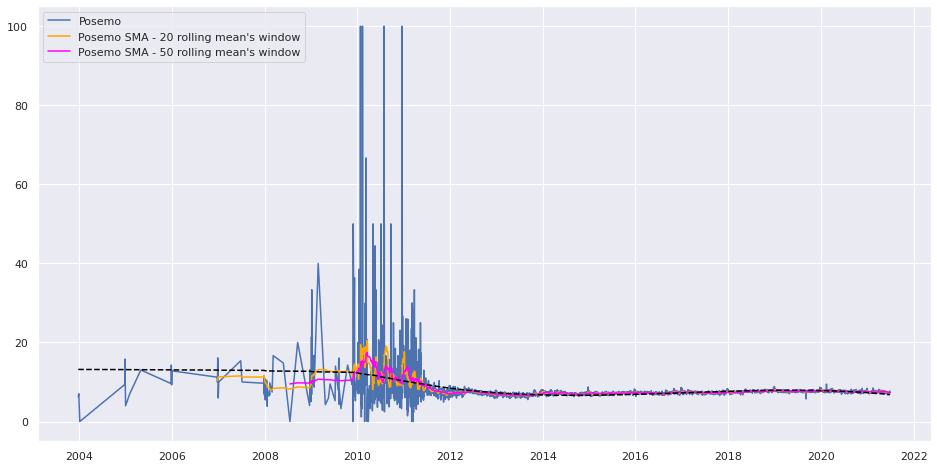

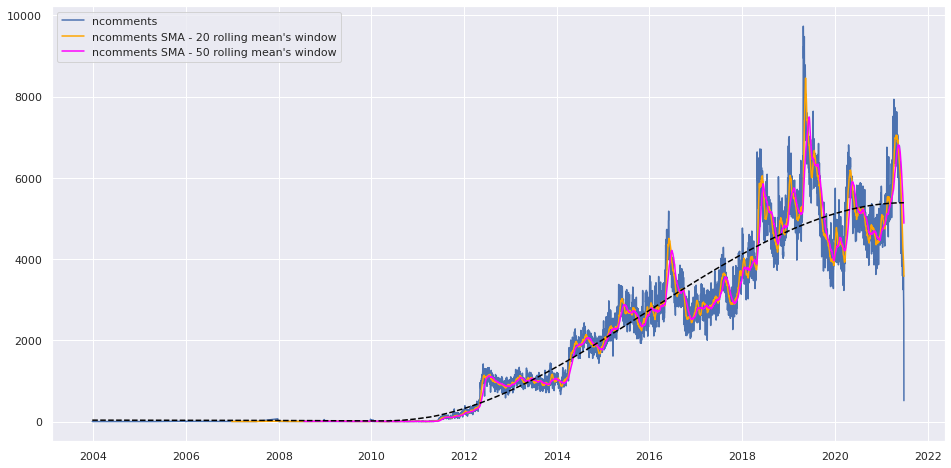

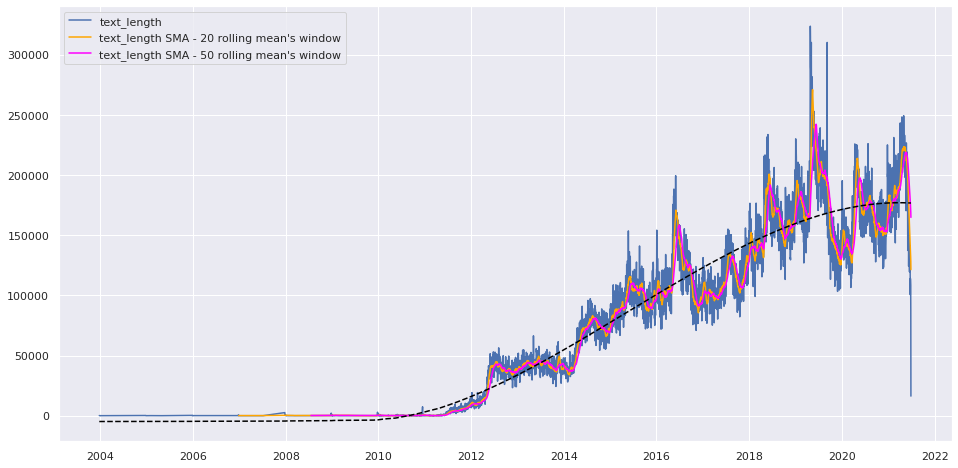

In [196]:
plot_sma(daily_stats["marvel"], 'Posemo', rm1=20, rm2=50, polynomial_degree=3)
plot_sma(daily_stats["marvel"], 'ncomments', rm1=20, rm2=50, polynomial_degree=3)
plot_sma(daily_stats["marvel"], 'text_length', rm1=20, rm2=50, polynomial_degree=3)

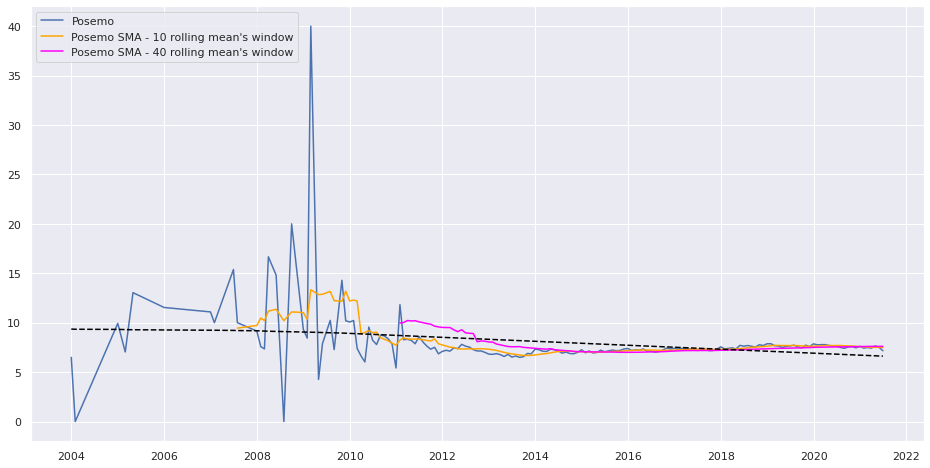

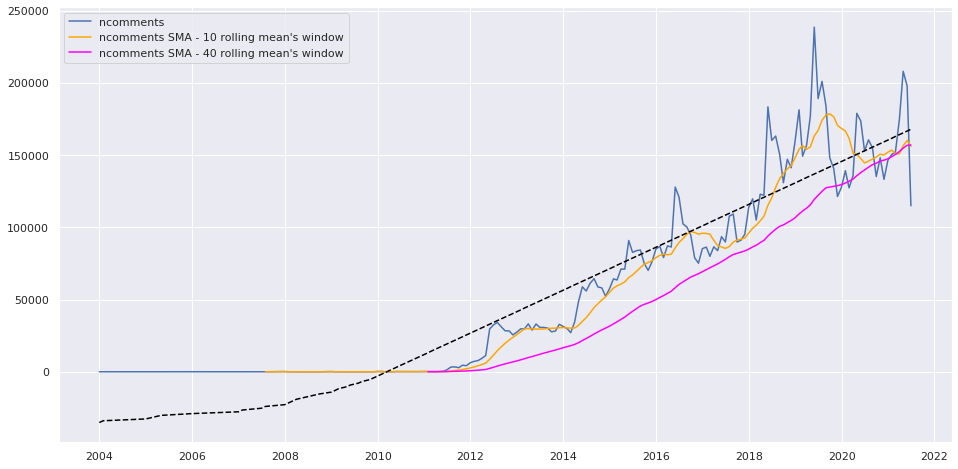

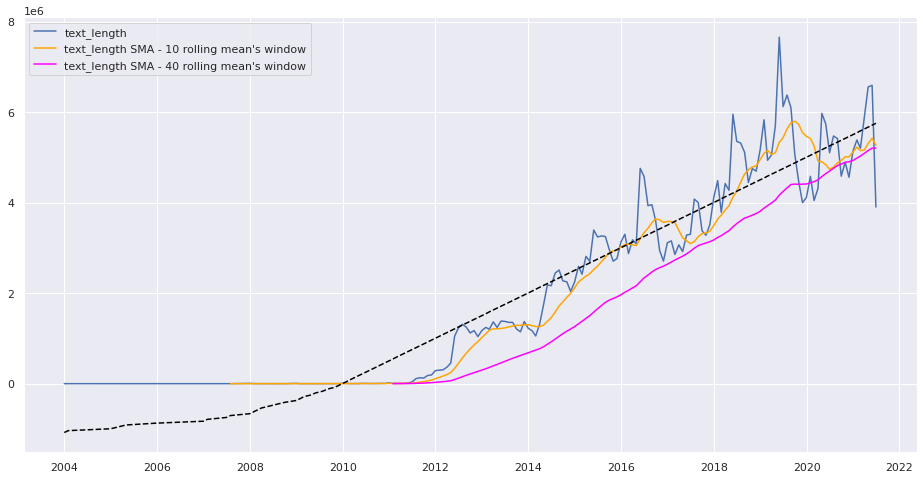

In [197]:
plot_sma(monthly_stats["marvel"], 'Posemo', rm1=10, rm2=40, polynomial_degree=1)
plot_sma(monthly_stats["marvel"], 'ncomments', rm1=10, rm2=40, polynomial_degree=1)
plot_sma(monthly_stats["marvel"], 'text_length', rm1=10, rm2=40, polynomial_degree=1)

In [ ]:
daily_stats["marvel"]['average_content_length'] = daily_stats["marvel"].apply(lambda x: f(x.text_length, x.ncomments), axis=1)
#Shift average_content_length to the beginning
cols = daily_stats["marvel"].columns.tolist()
cols = cols[0:2] + cols[-1:] + cols[2:19]
daily_stats["marvel"] = daily_stats["marvel"][cols]

monthly_stats["marvel"]['average_content_length'] = monthly_stats["marvel"].apply(lambda x: f(x.text_length, x.ncomments), axis=1)
#Shift average_content_length to the beginning
cols = monthly_stats["marvel"].columns.tolist()
cols = cols[0:2] + cols[-1:] + cols[2:19]
monthly_stats["marvel"] = monthly_stats["marvel"][cols]

community_by_work["marvel"]['average_content_length'] = community_by_work["marvel"].apply(lambda x: f(x.text_length, x.ncomments), axis=1)
#Shift average_content_length to the beginning
cols = community_by_work["marvel"].columns.tolist()
cols = cols[0:2] + cols[-1:] + cols[2:19]
community_by_work["marvel"] = community_by_work["marvel"][cols]

for work in community_by_work["marvel"].index:
    daily_stats_by_work["marvel"][work]['average_content_length'] = daily_stats_by_work["marvel"][work].apply(lambda x: f(x.text_length, x.ncomments), axis=1)
    #Shift average_content_length to the beginning
    cols = daily_stats_by_work["marvel"][work].columns.tolist()
    cols = cols[0:2] + cols[-1:] + cols[2:19]
    daily_stats_by_work["marvel"][work] = daily_stats_by_work["marvel"][work][cols]
    if not monthly_stats_by_work["marvel"][work].empty:
        monthly_stats_by_work["marvel"][work]['average_content_length'] = monthly_stats_by_work["marvel"][work].apply(lambda x: f(x.text_length, x.ncomments), axis=1)
        #Shift average_content_length to the beginning
        cols = monthly_stats_by_work["marvel"][work].columns.tolist()
        cols = cols[0:2] + cols[-1:] + cols[2:19]
        monthly_stats_by_work["marvel"][work] = monthly_stats_by_work["marvel"][work][cols]
    if not chapter_stats_by_work["marvel"][work].empty:
        chapter_stats_by_work["marvel"][work]['average_content_length'] = chapter_stats_by_work["marvel"][work].apply(lambda x: f(x.text_length, x.ncomments), axis=1)
        #Shift average_content_length to the beginning
        cols = chapter_stats_by_work["marvel"][work].columns.tolist()
        cols = cols[0:2] + cols[-1:] + cols[2:19]
        chapter_stats_by_work["marvel"][work] = chapter_stats_by_work["marvel"][work][cols]

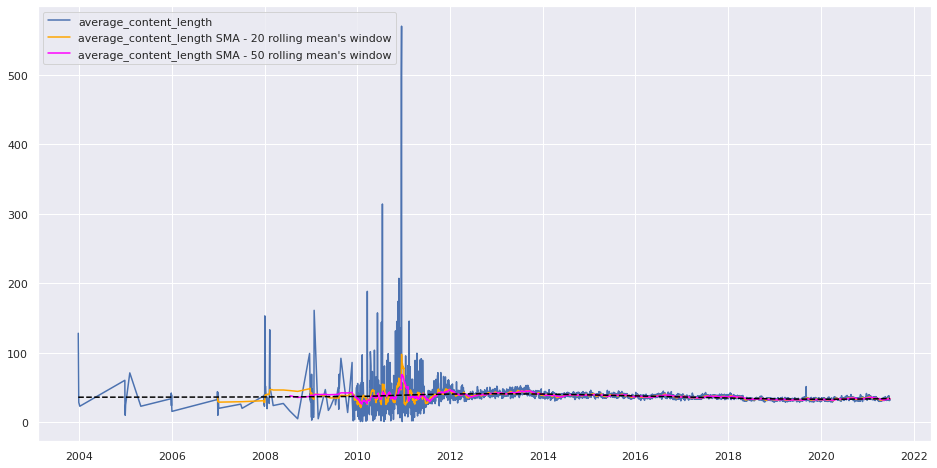

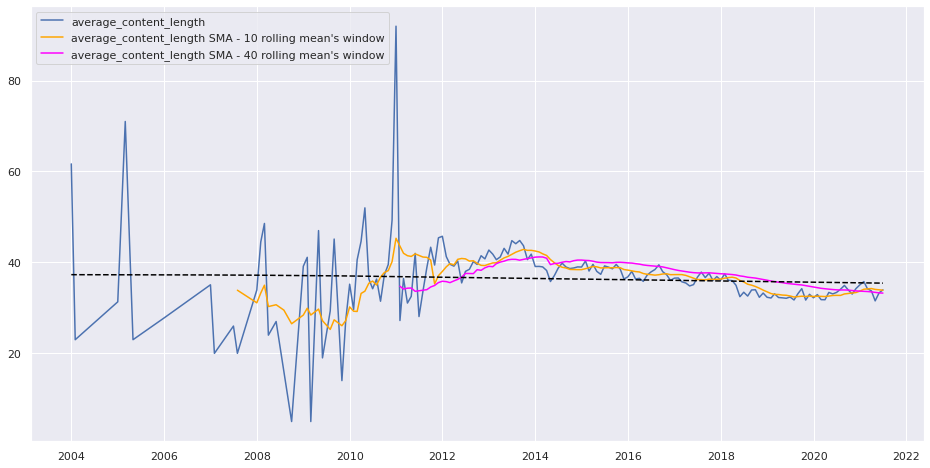

In [198]:
plot_sma(daily_stats["marvel"], 'average_content_length', rm1=20, rm2=50, polynomial_degree=3)
plot_sma(monthly_stats["marvel"], 'average_content_length', rm1=10, rm2=40, polynomial_degree=1)

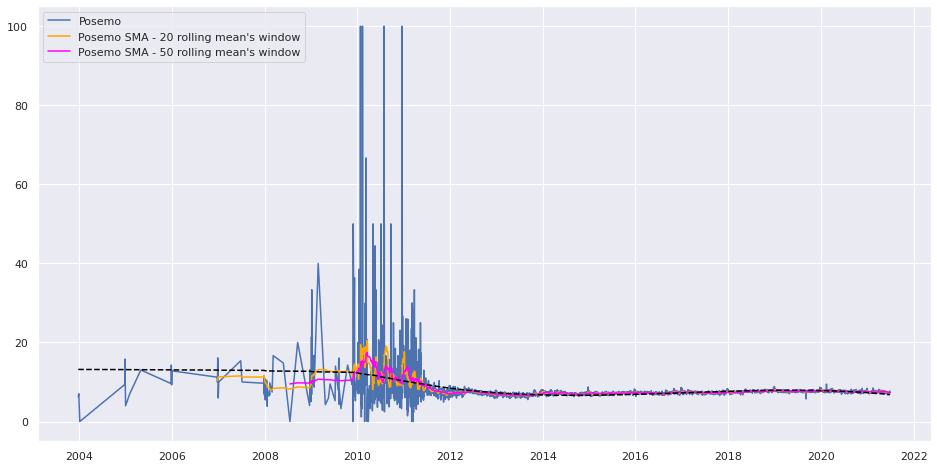

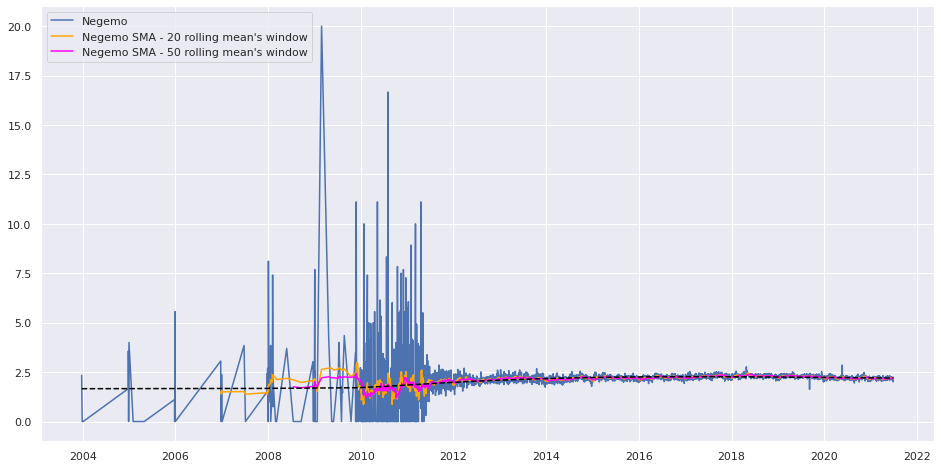

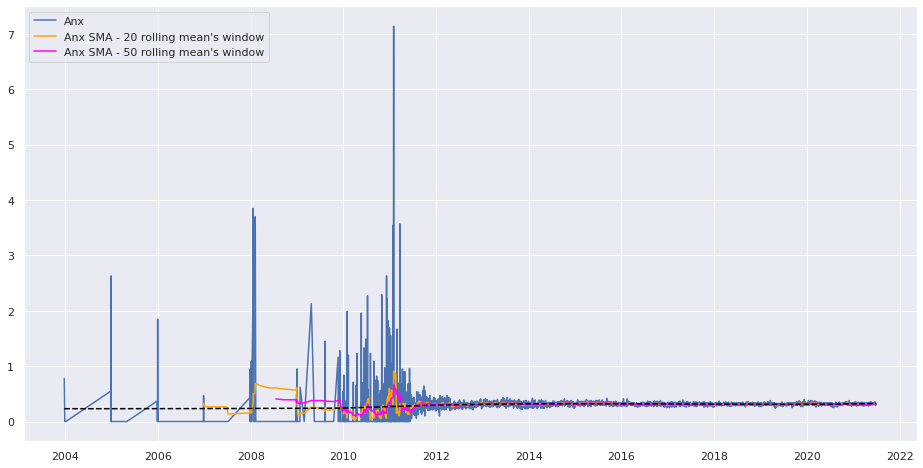

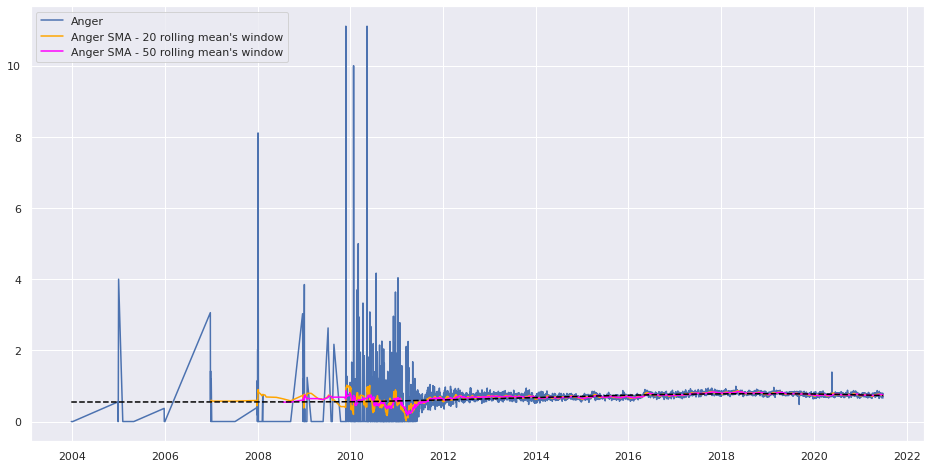

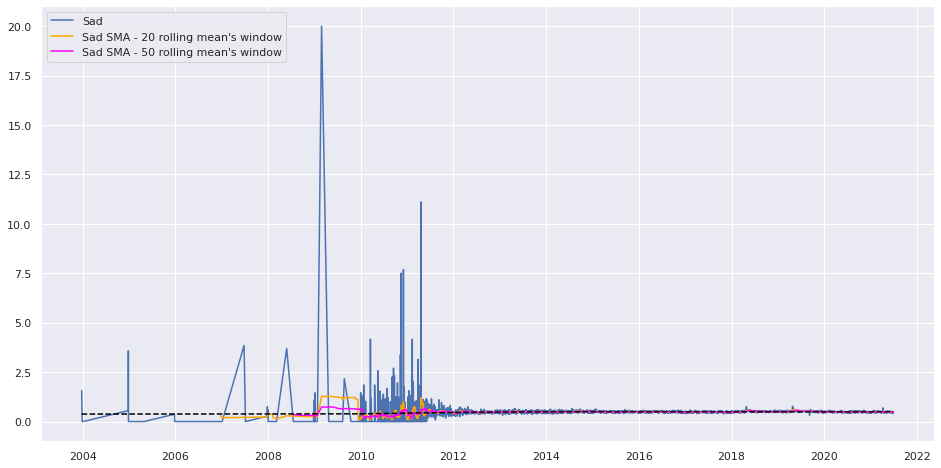

In [199]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plot_sma(daily_stats["marvel"], category, rm1=20, rm2=50, polynomial_degree=3)

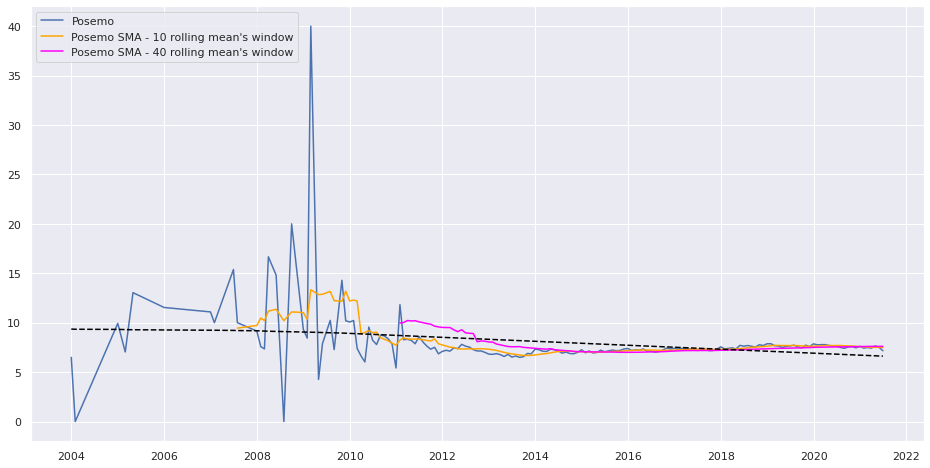

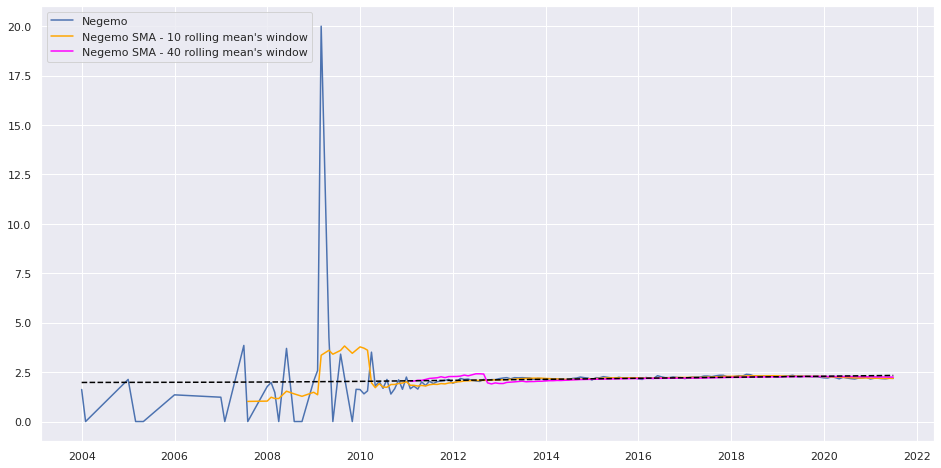

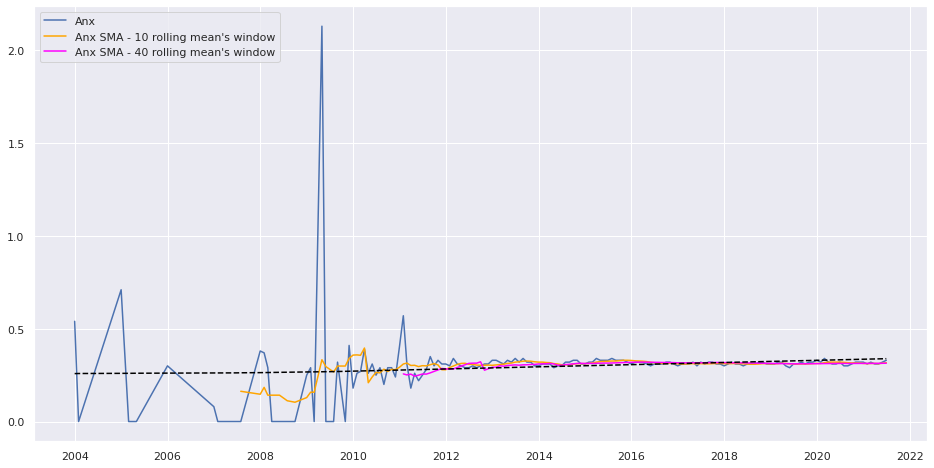

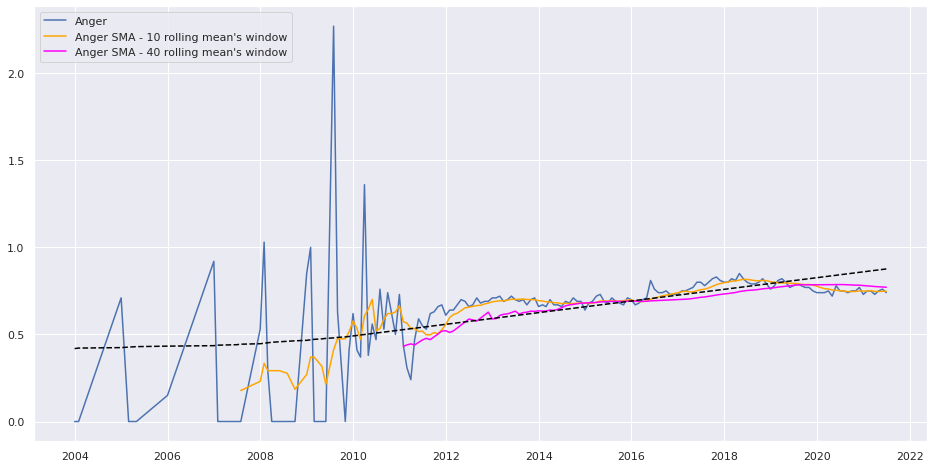

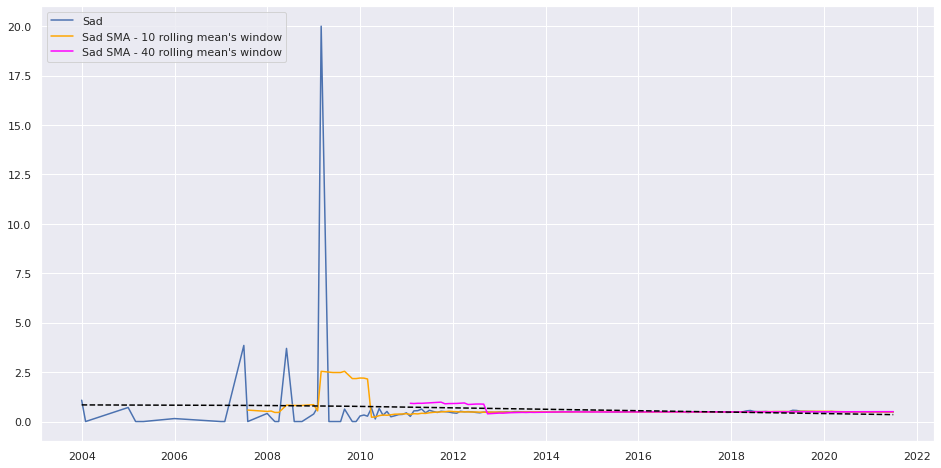

In [200]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plot_sma(monthly_stats["marvel"], category, rm1=10, rm2=40, polynomial_degree=1)

In [201]:
#Ancora da approvare, sarebbe meglio farlo su quantità cumulative nel tempo
# bar_chart_race(monthly_stats["marvel"])

#### In search of correlations with scatter plots

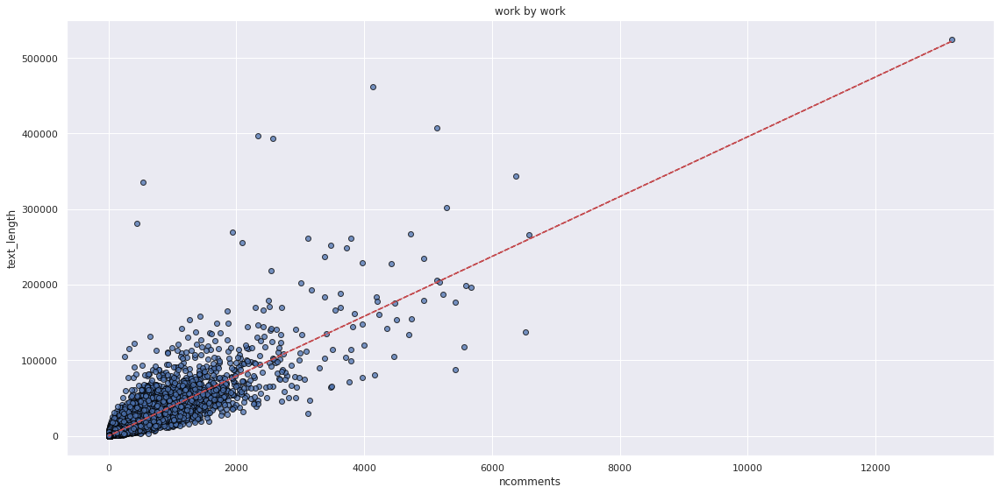

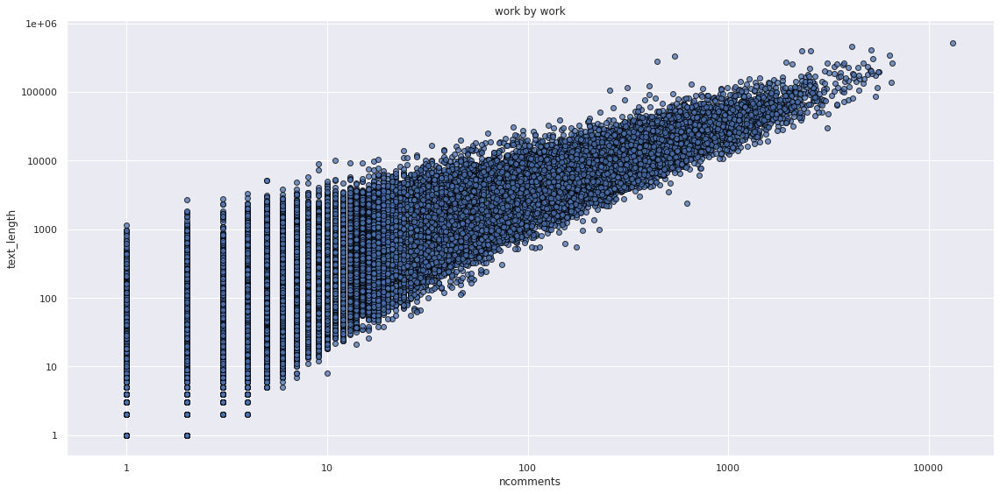

In [202]:
plt_corr(community_by_work["marvel"], y_ax='text_length', x_ax='ncomments', title='work by work', polyfit=True)
plt_corr(community_by_work["marvel"], y_ax='text_length', x_ax='ncomments', title='work by work', log_scale=True, xlim=0.5, ylim=0.5)

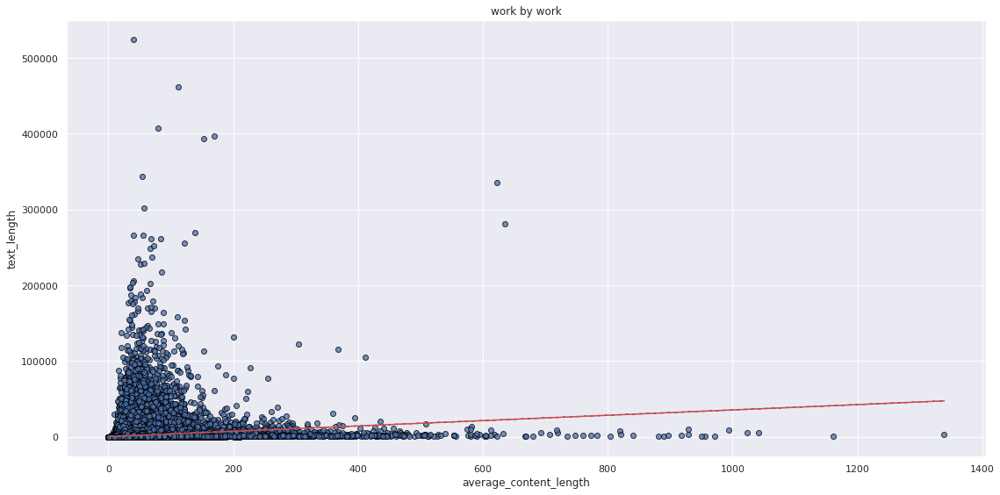

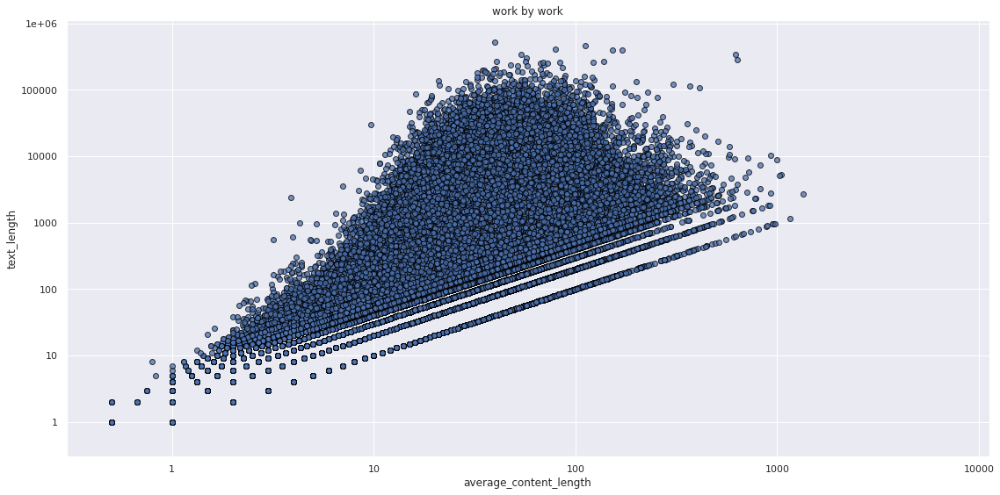

In [203]:
plt_corr(community_by_work["marvel"], y_ax='text_length', x_ax='average_content_length', title='work by work', polyfit=True)
plt_corr(community_by_work["marvel"], y_ax='text_length', x_ax='average_content_length', title='work by work', log_scale=True, xlim=0.3, ylim=0.3)

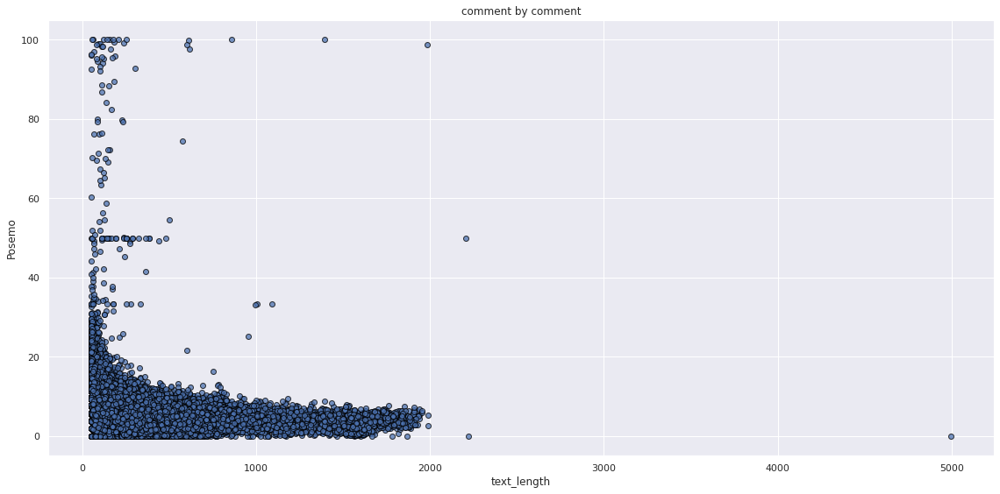

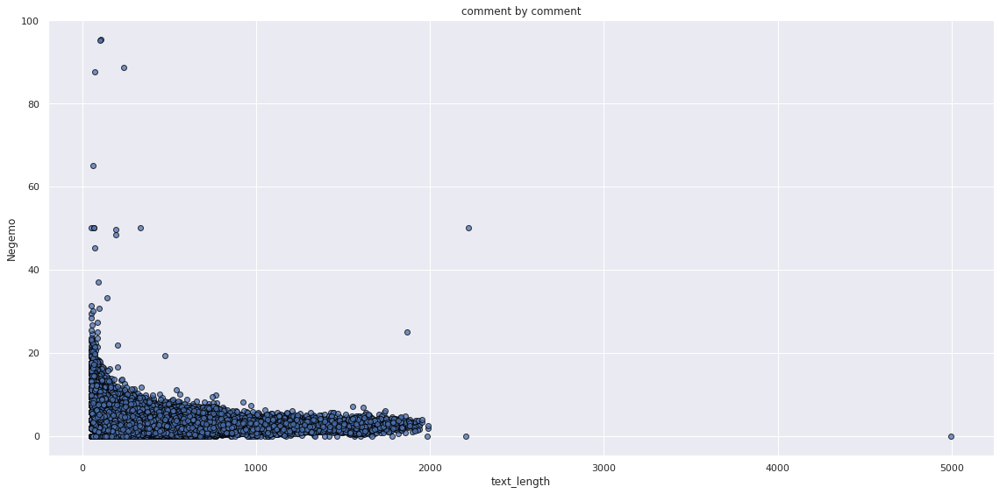

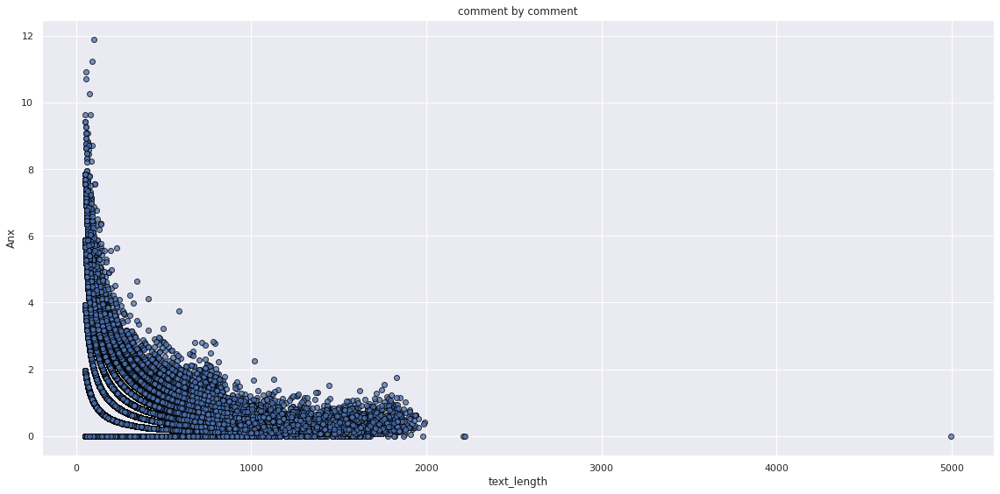

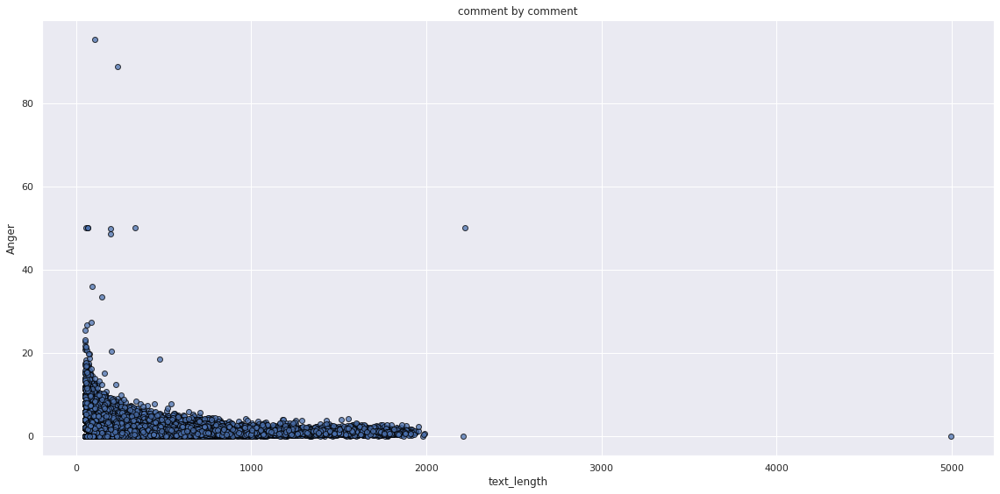

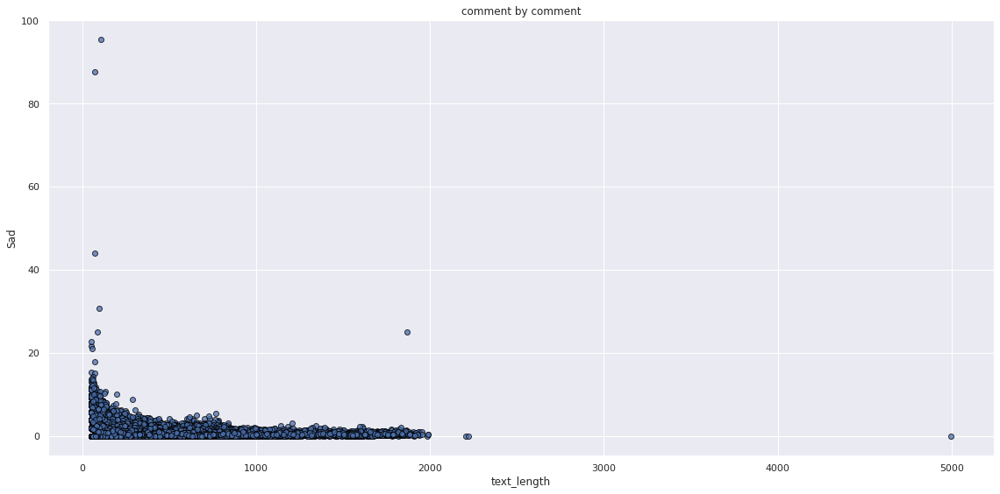

In [204]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plt_corr(community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50], y_ax=category, x_ax='text_length', title='comment by comment')

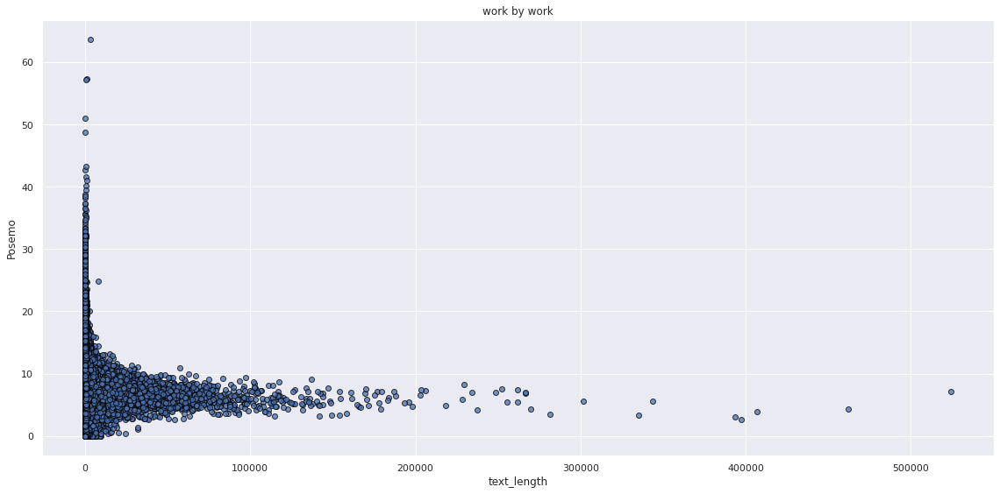

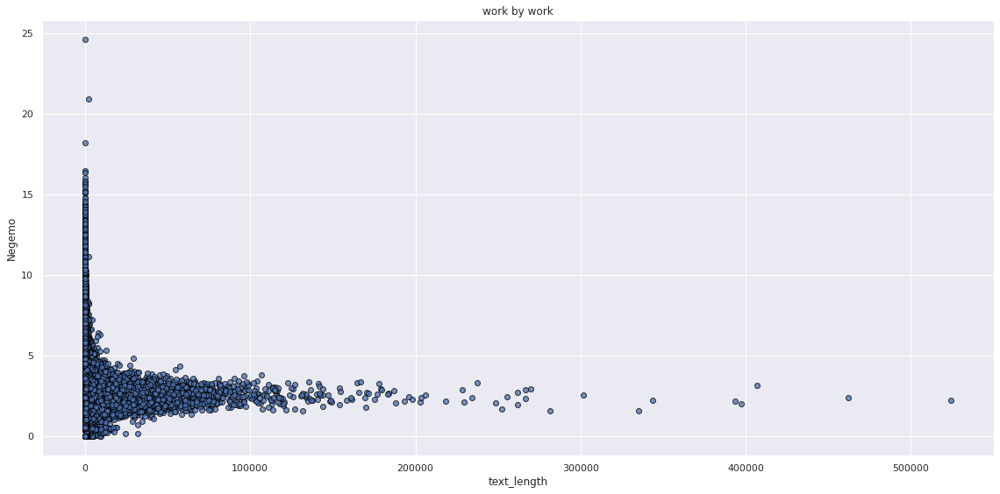

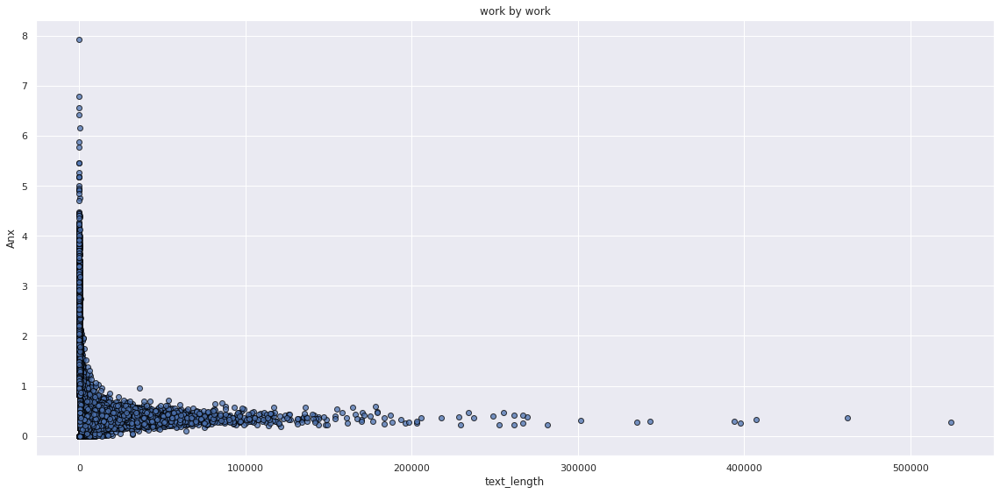

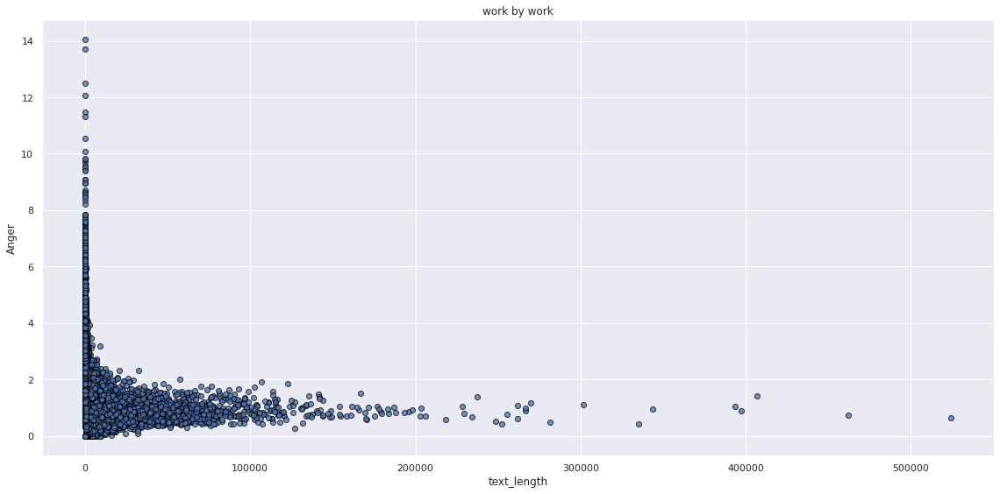

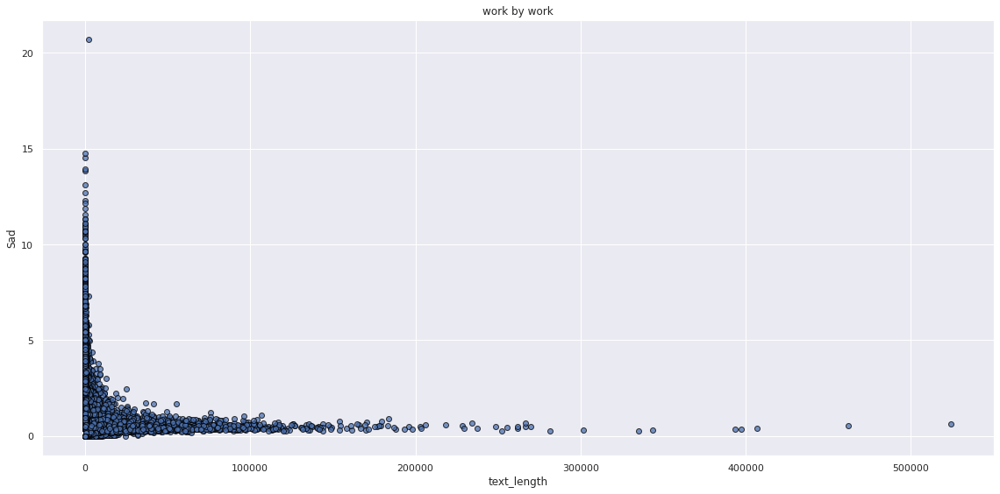

In [205]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax=category, x_ax='text_length', title='work by work')

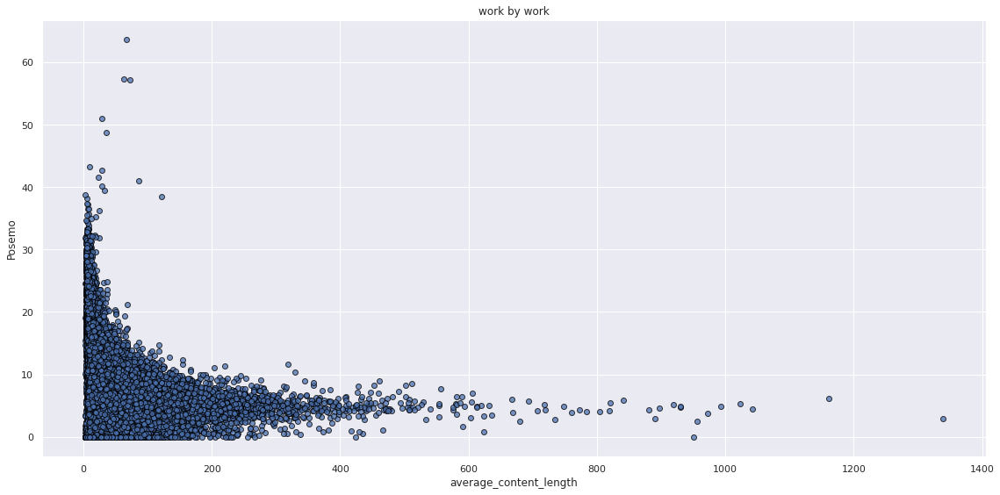

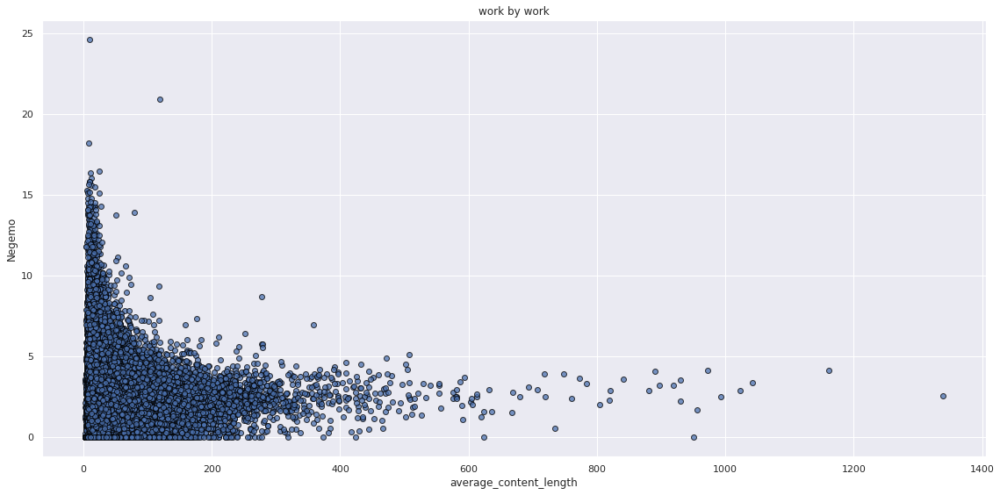

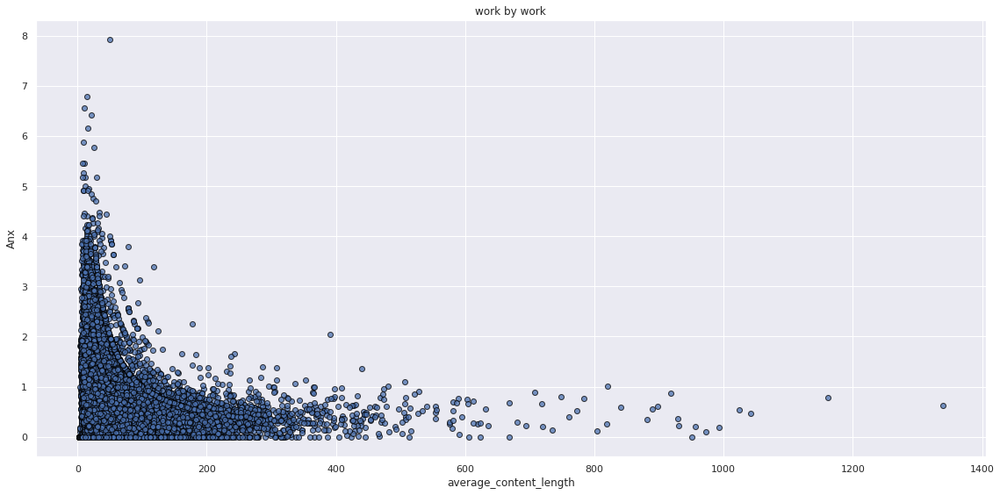

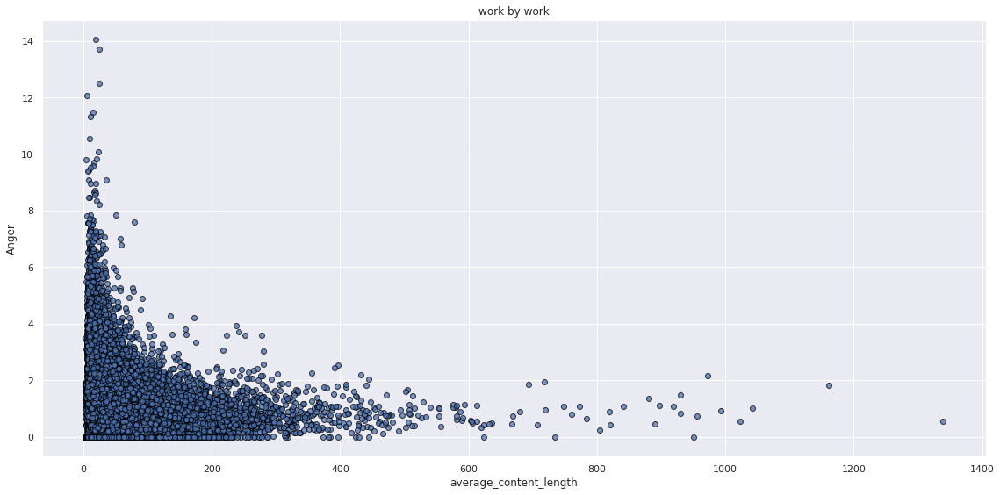

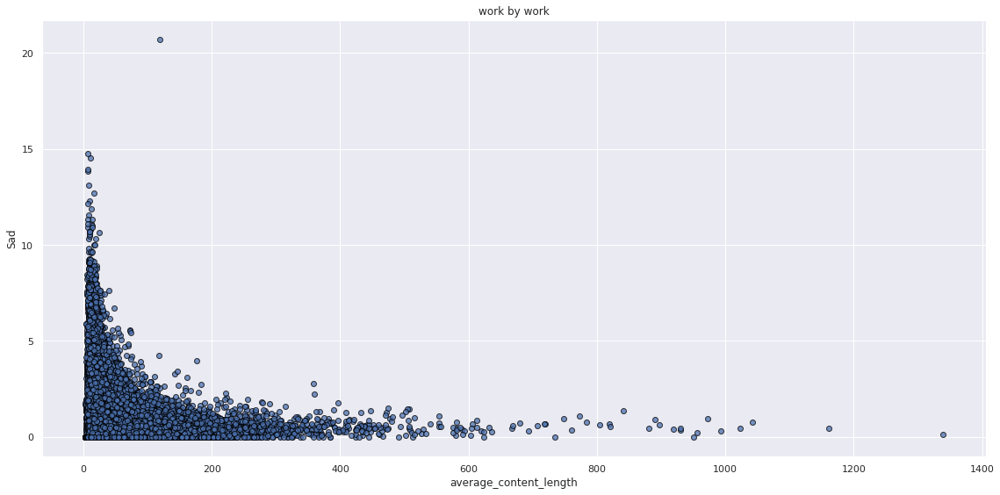

In [206]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax=category, x_ax='average_content_length', title='work by work')

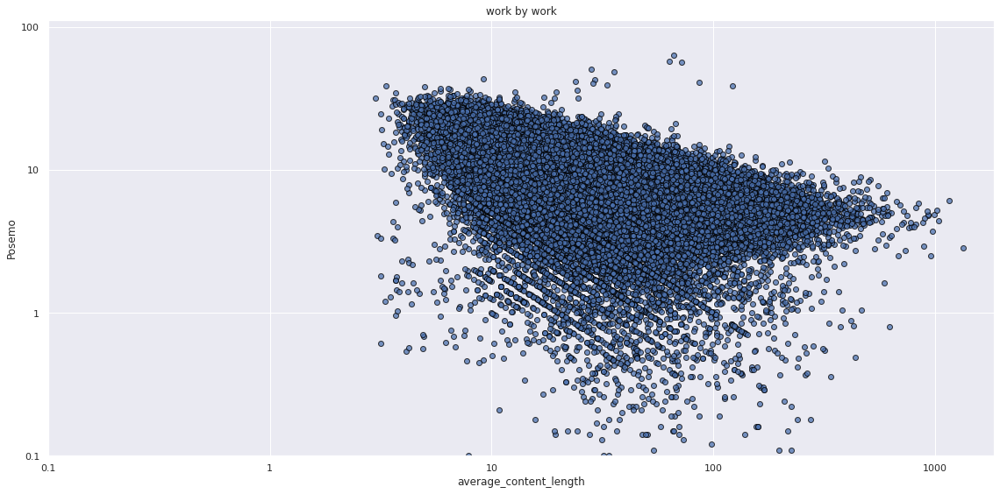

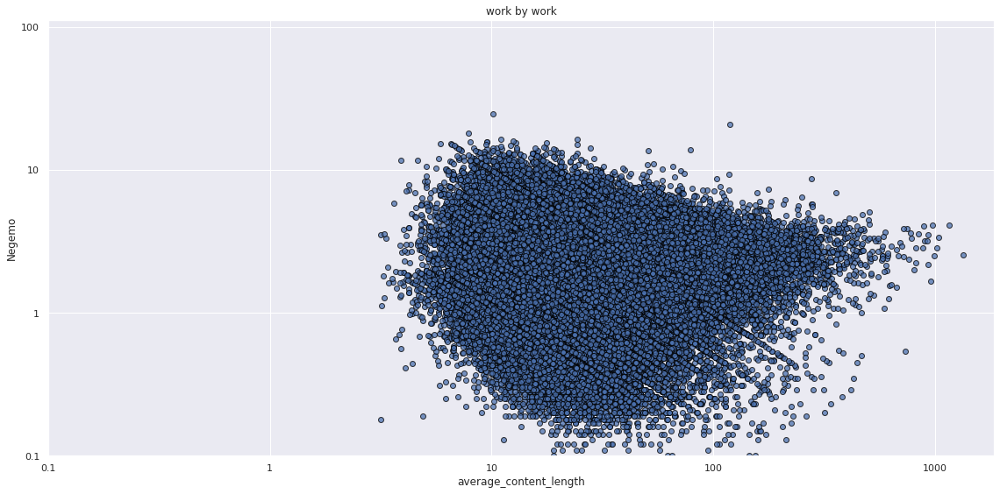

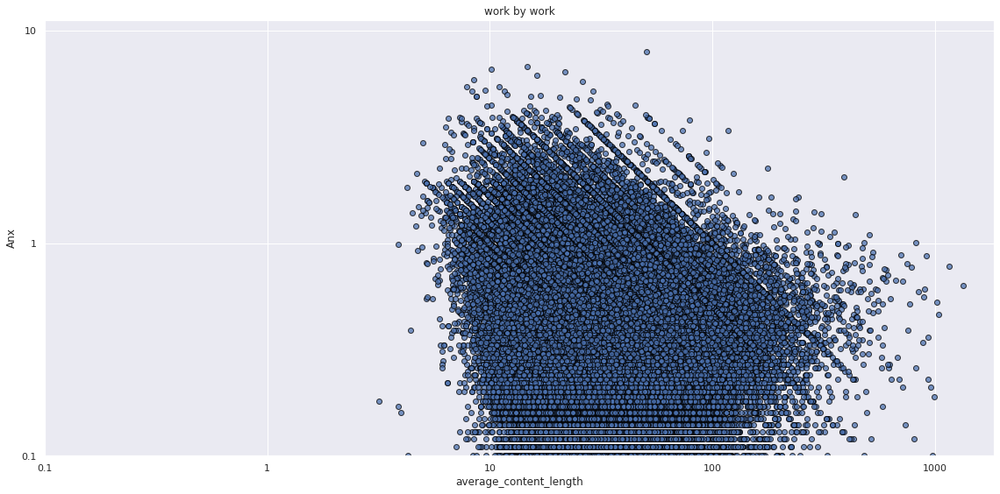

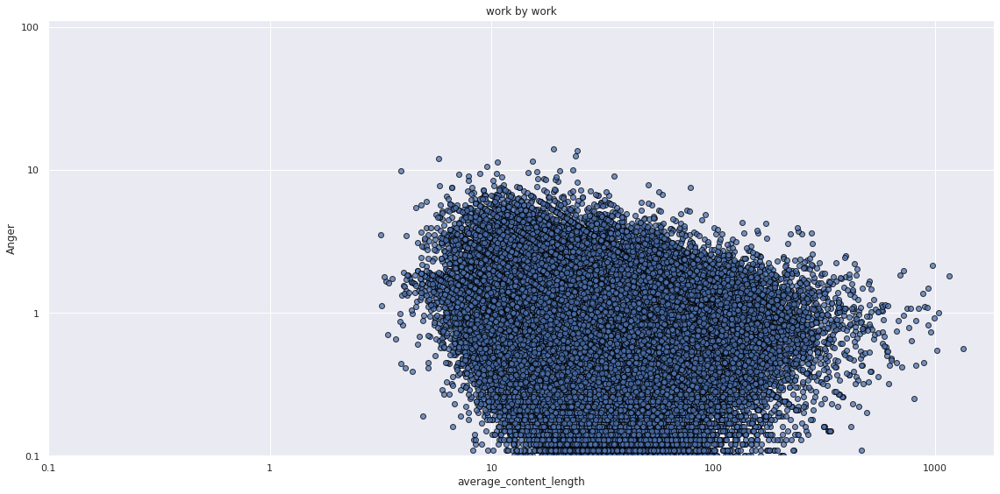

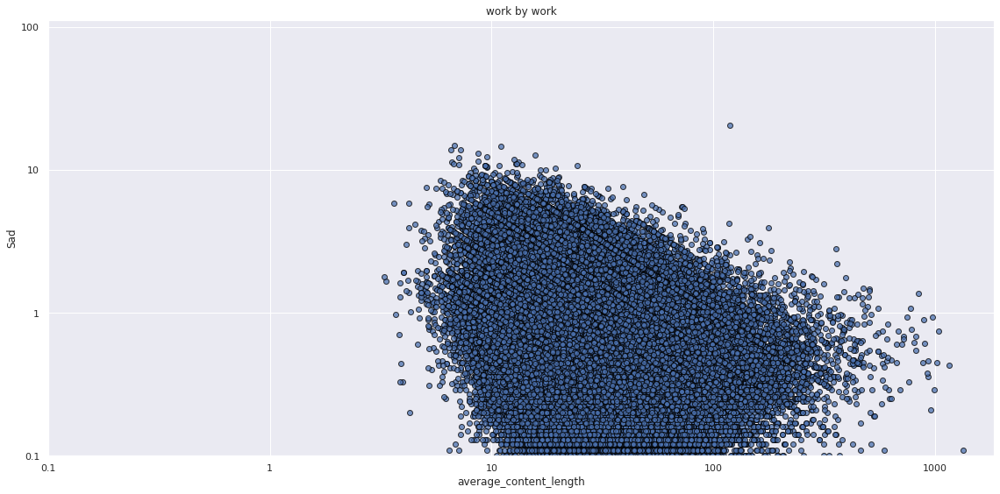

In [207]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax=category, x_ax='average_content_length', title='work by work', log_scale=True)

Let's continue with these other questions:
1. Is Posemo inversely related to Anx? 
2. Are average_content_length peaks correlated with Anx peaks?
3. How is the relationship between Anx and popularity (=nkudos)?

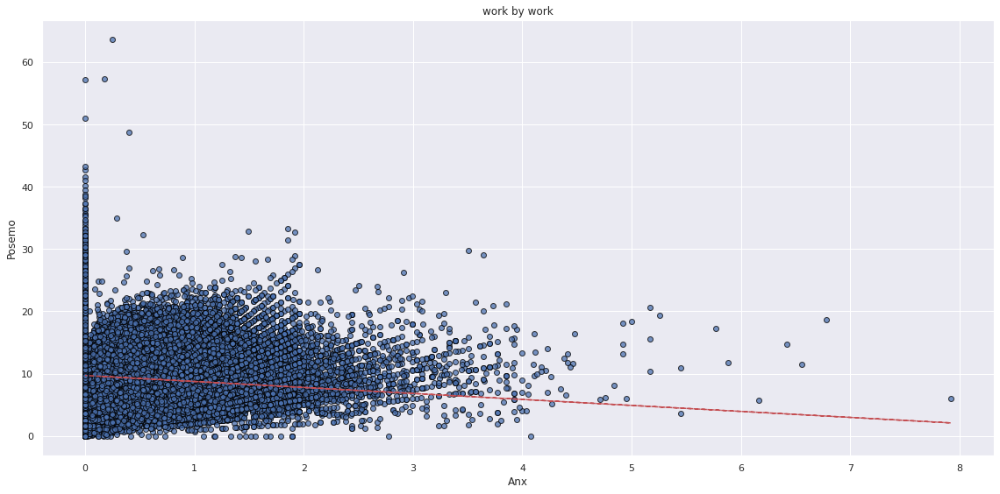

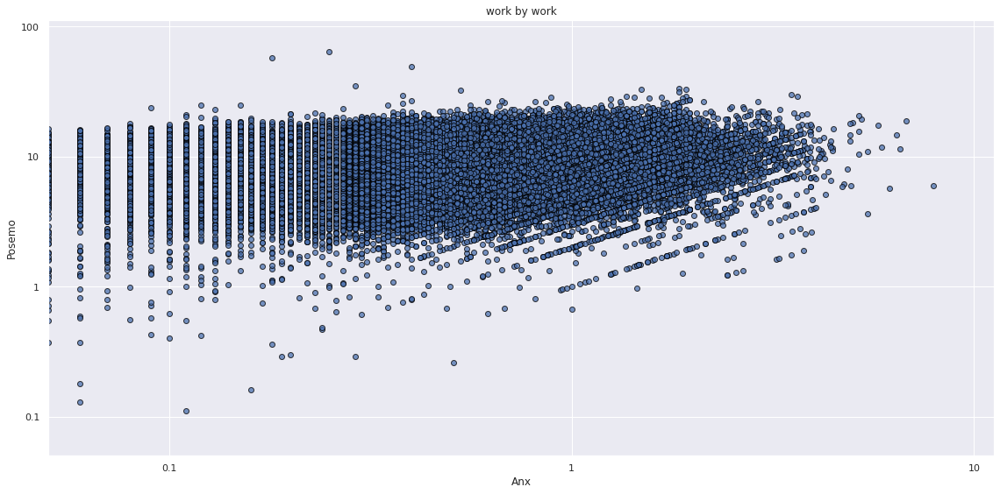

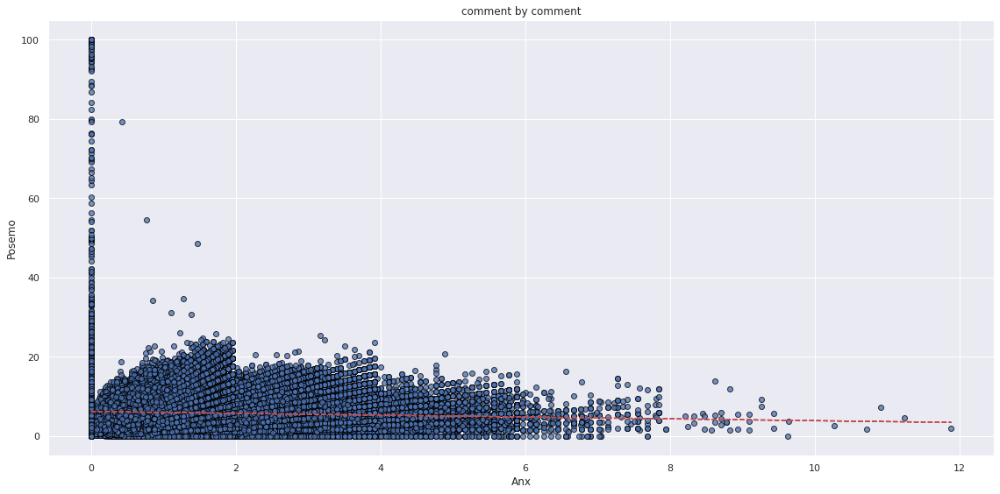

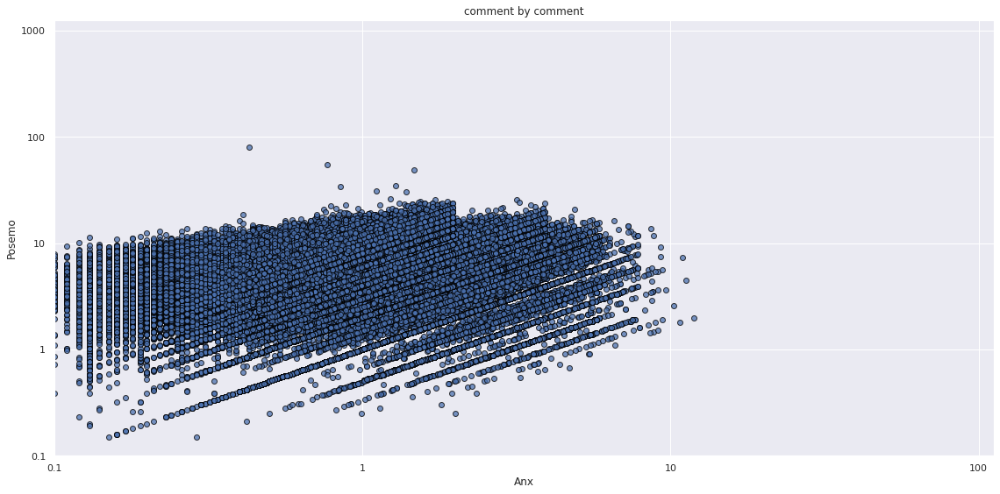

In [208]:
plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax='Posemo', x_ax='Anx', title='work by work', polyfit=True)
plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax='Posemo', x_ax='Anx', title='work by work', log_scale=True, xlim=0.05, ylim=0.05)
plt_corr(community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50], y_ax='Posemo', x_ax='Anx', title='comment by comment', polyfit=True)
plt_corr(community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50], y_ax='Posemo', x_ax='Anx', title='comment by comment', log_scale=True)

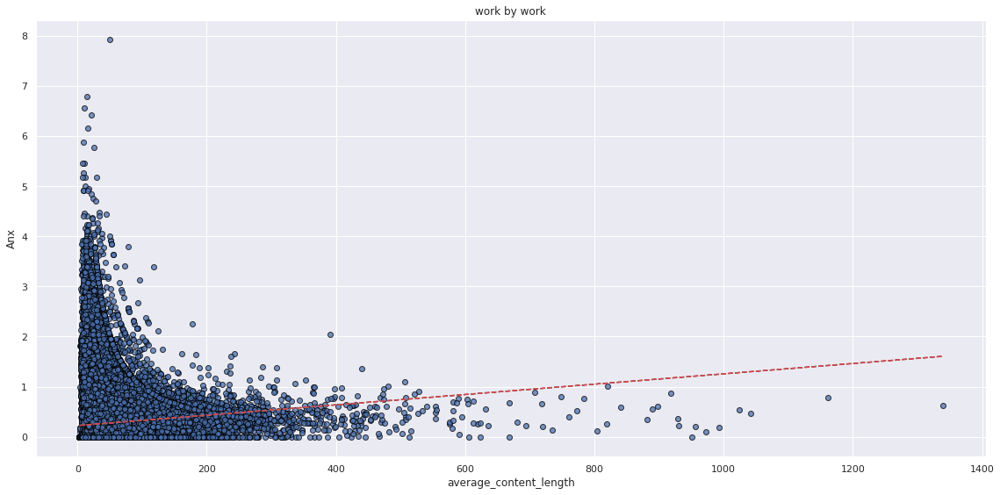

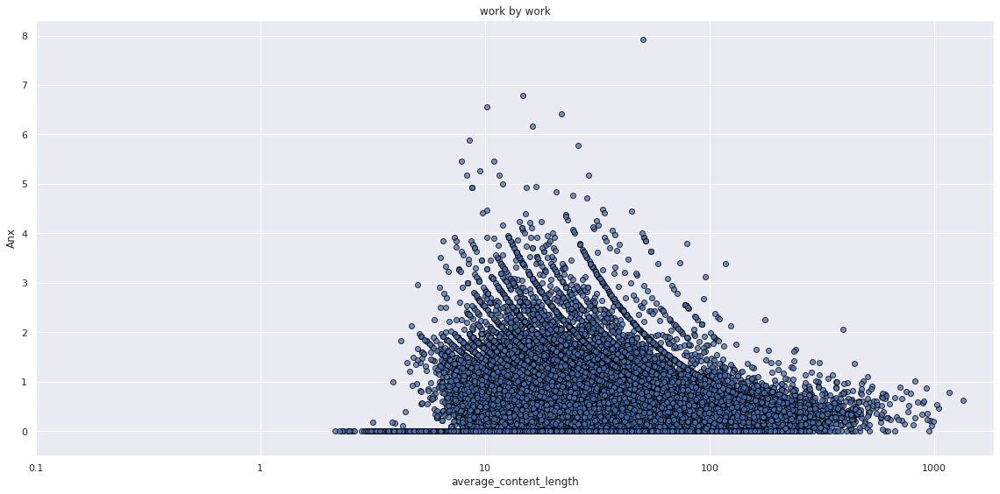

In [209]:
plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax='Anx', x_ax='average_content_length', title='work by work', polyfit=True)
plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax='Anx', x_ax='average_content_length', title='work by work', xlog_scale=True, ylim=-0.5)

In [210]:
nkudos = []
for work in community_by_work["marvel"][community_by_work["marvel"]['text_length']>50].index:
    row_index = works_dfs["marvel"].index[works_dfs["marvel"]["id"] == work].tolist()[0]
    nkudos.append(works_dfs["marvel"]['nkudos'][row_index])

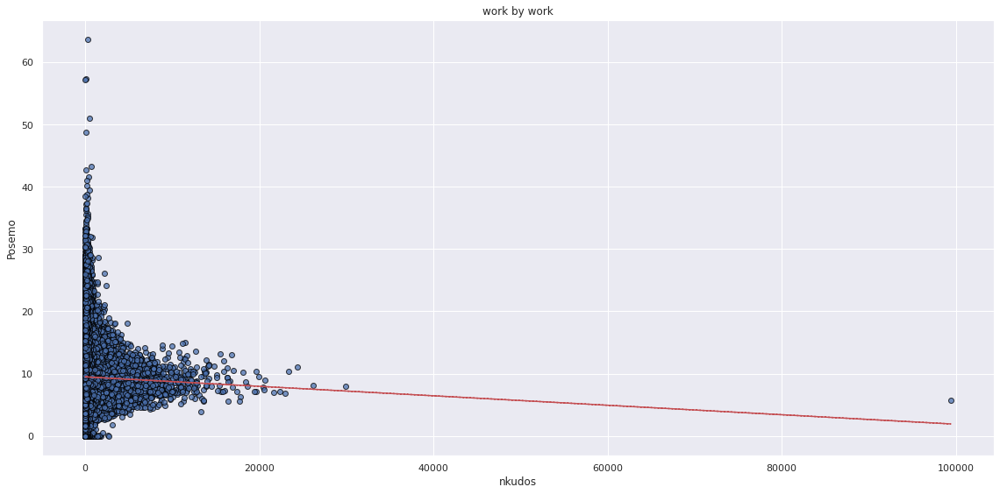

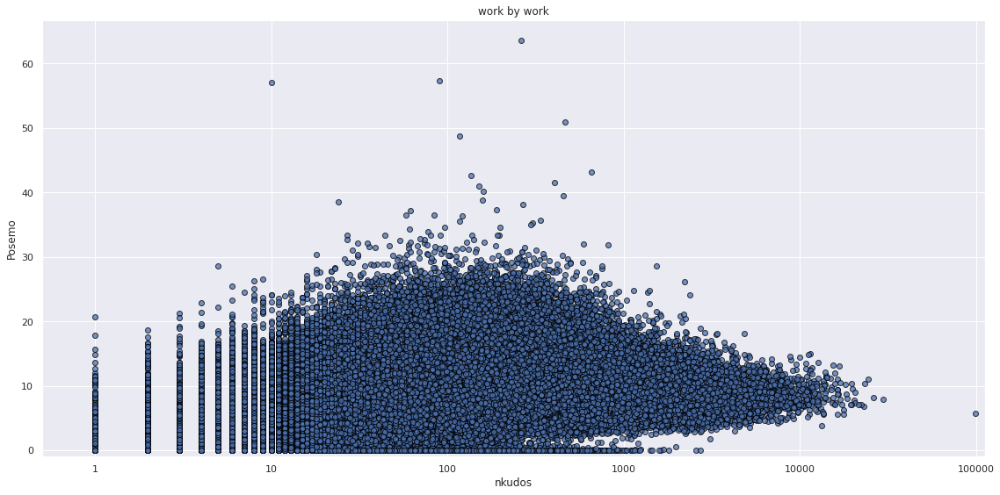

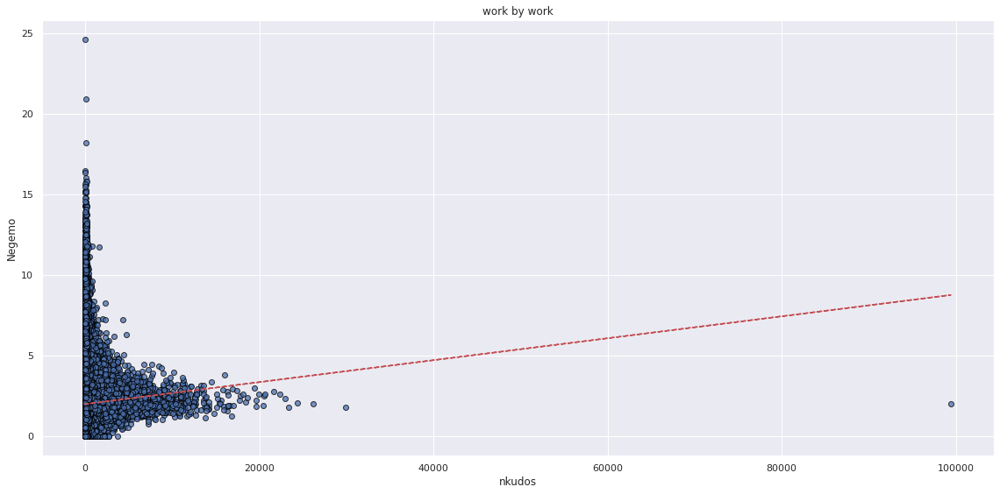

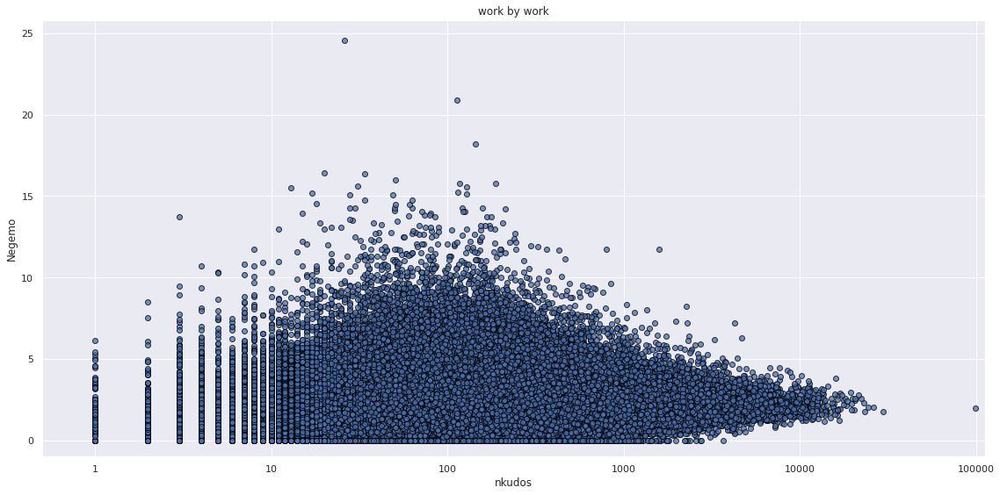

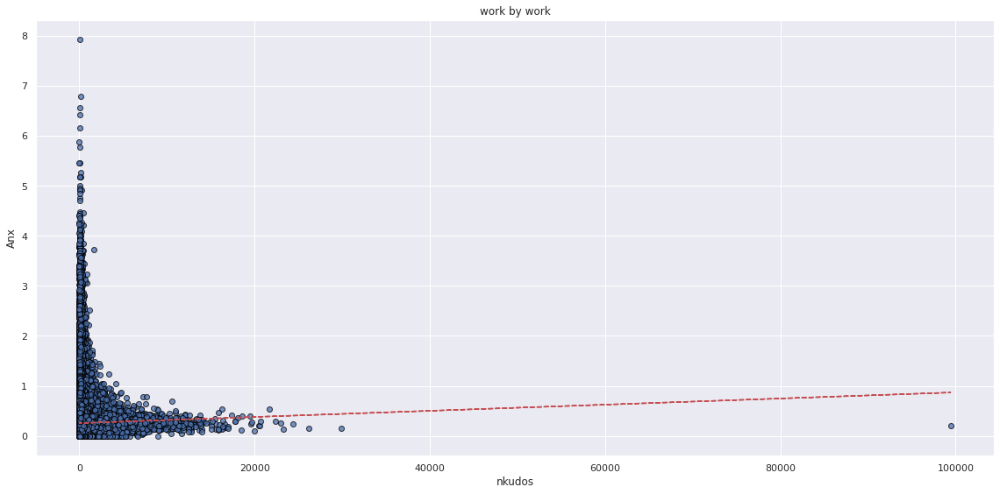

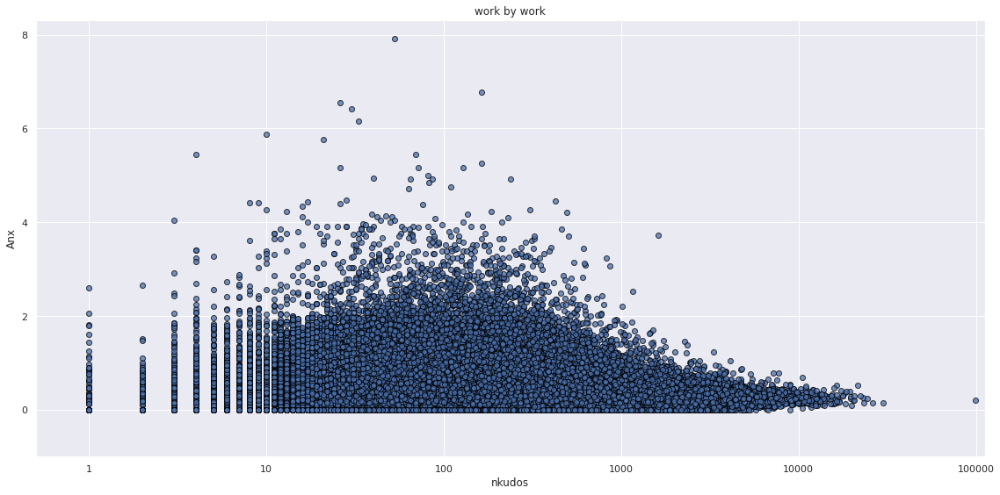

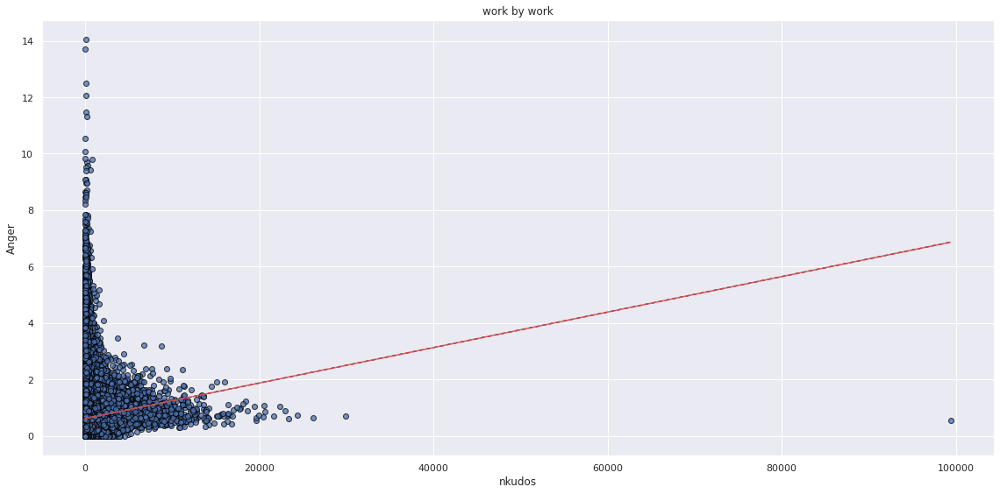

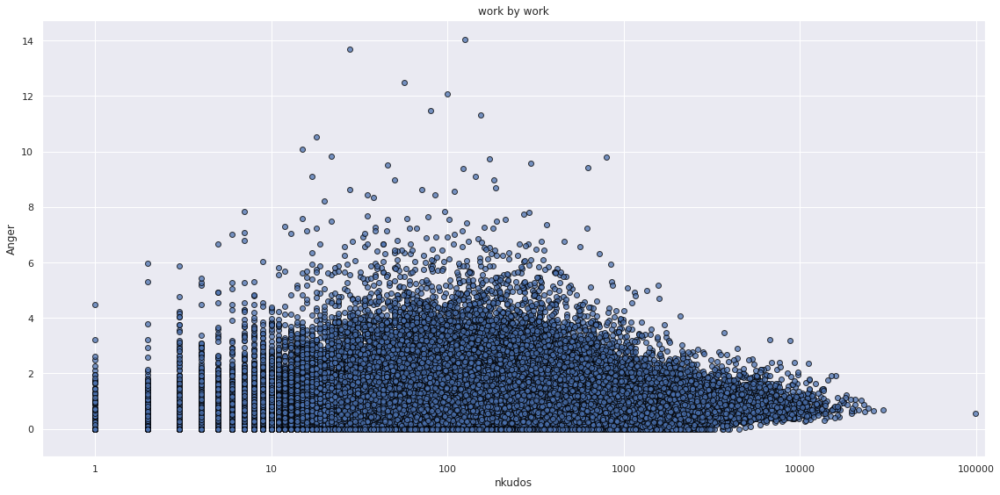

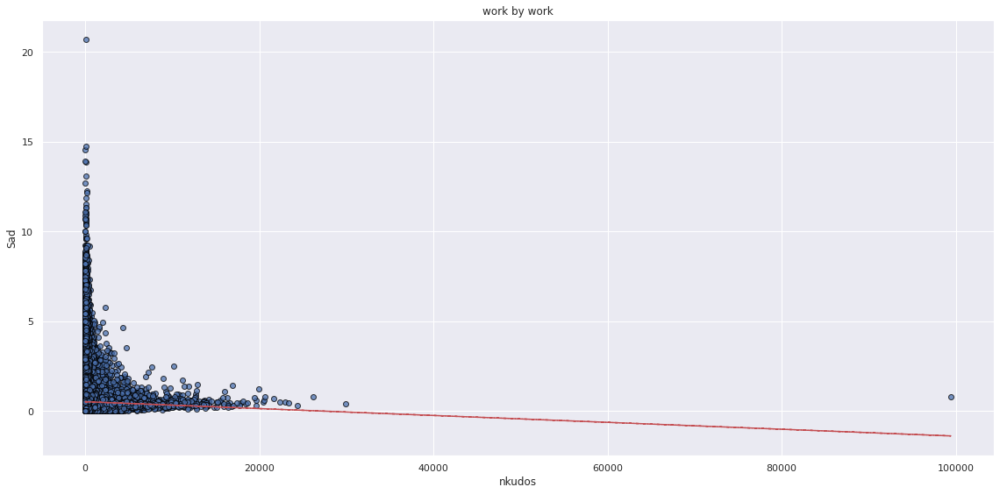

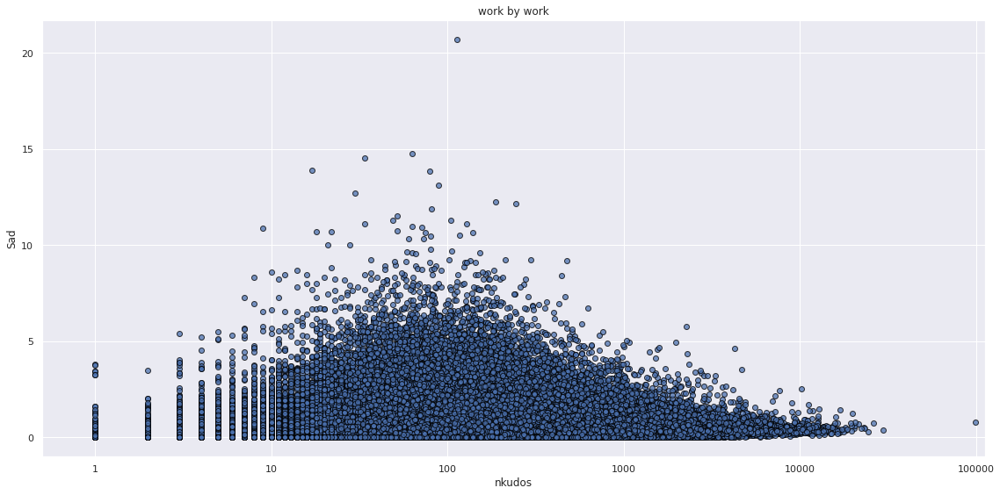

In [211]:
_nkudos = pd.DataFrame(list(zip(nkudos,
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Posemo'].copy(),
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Negemo'].copy(),
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Anx'].copy(),
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Anger'].copy(),
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Sad'].copy(),
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['ncomments'].copy(),
                                community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['text_length'].copy(),community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['average_content_length'].copy())
                           ),
                       columns =['nkudos', 'Posemo', 'Negemo', 'Anx', 'Anger', 'Sad', 'ncomments', 'text_length', 'average_content_length'])
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plt_corr(_nkudos, y_ax=category, x_ax='nkudos', title='work by work', polyfit=True)
    plt_corr(_nkudos, y_ax=category, x_ax='nkudos', title='work by work', xlog_scale=True, xlim=0.5, ylim=-1)

Let's see more comparisons with nkudos.

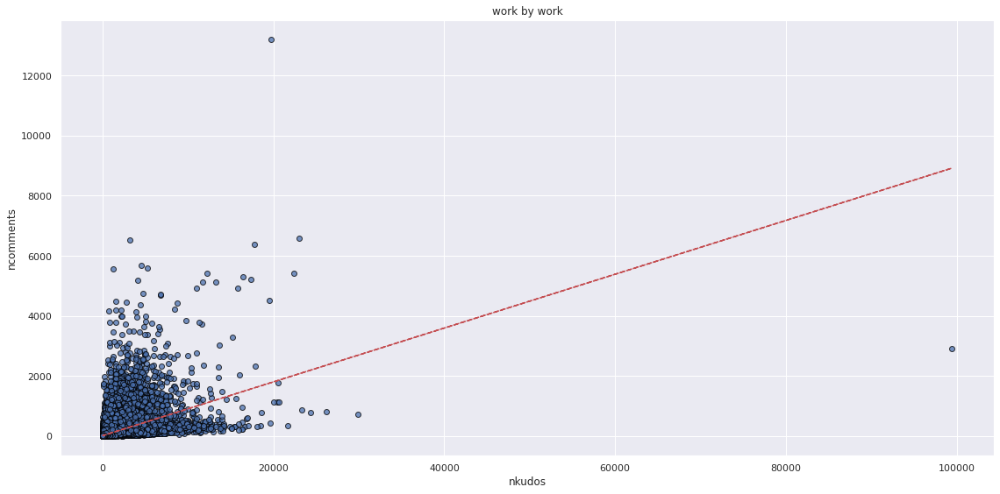

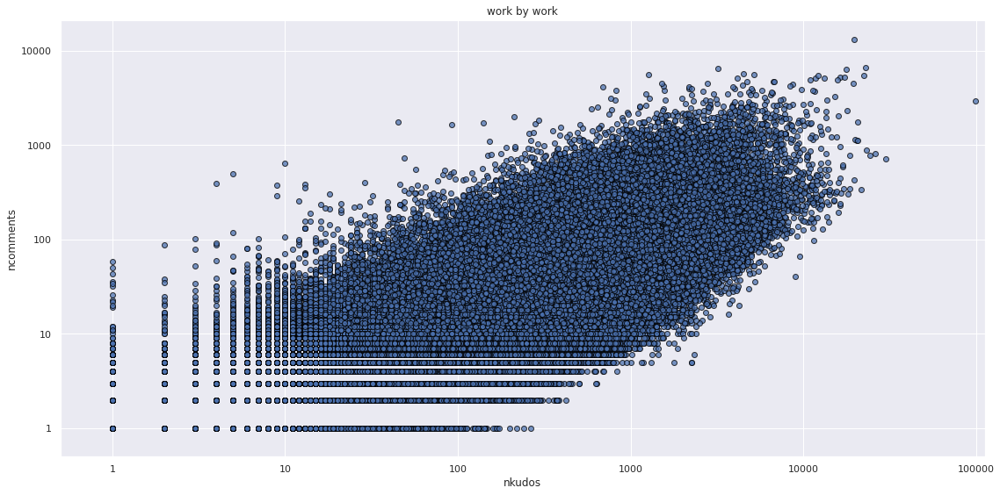

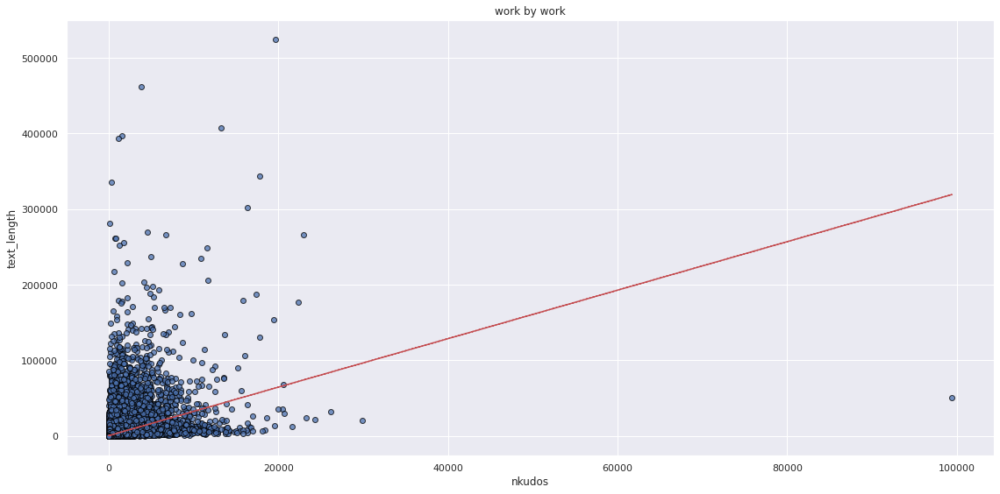

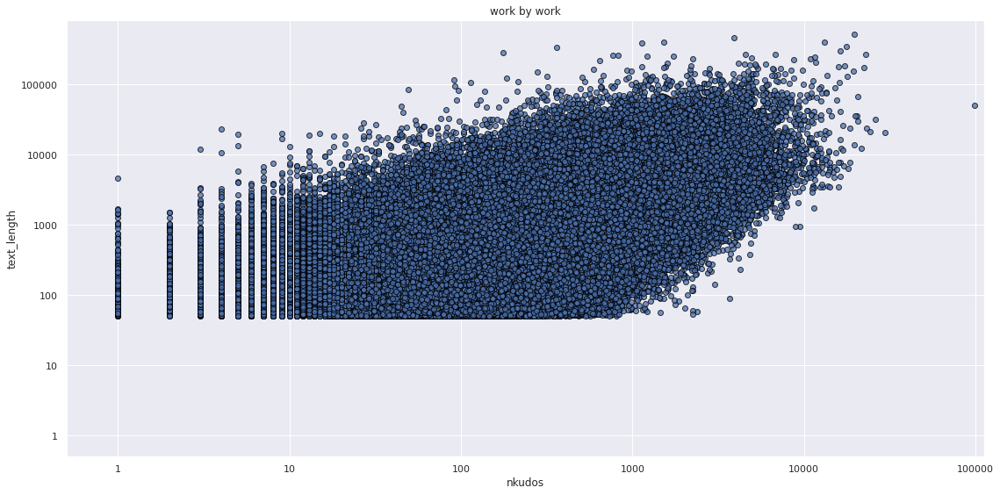

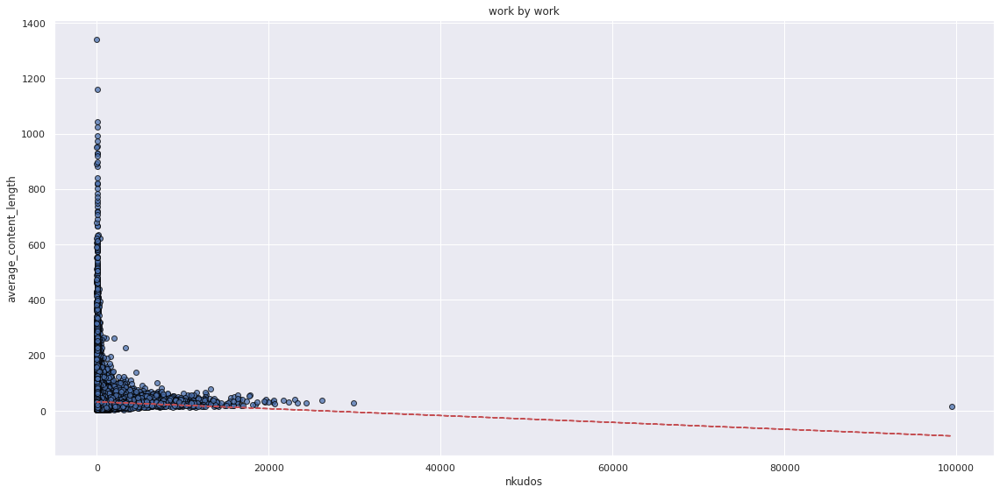

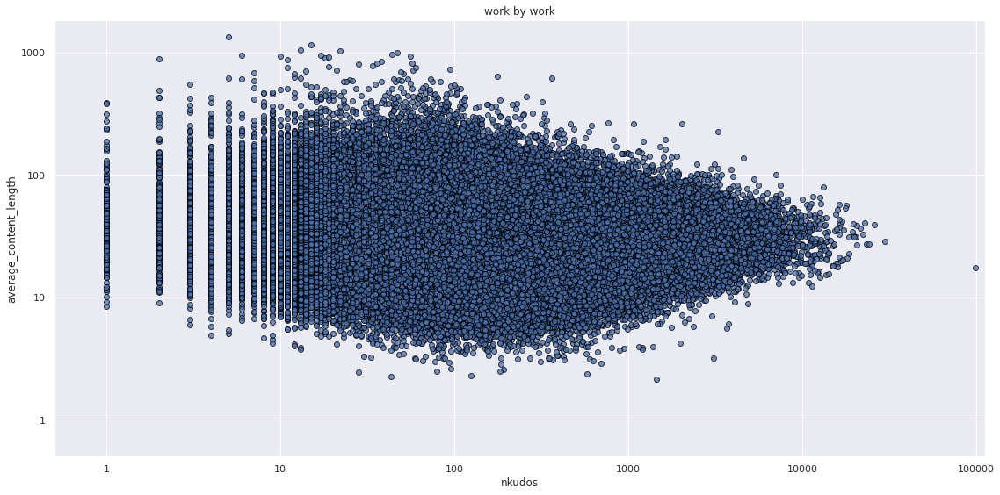

In [212]:
for category in ['ncomments', 'text_length', 'average_content_length']:
    plt_corr(_nkudos, y_ax=category, x_ax='nkudos', title='work by work', polyfit=True)
    plt_corr(_nkudos, y_ax=category, x_ax='nkudos', title='work by work', log_scale=True, xlim=0.5, ylim=0.5)

Now let's compare the emotions with each other.

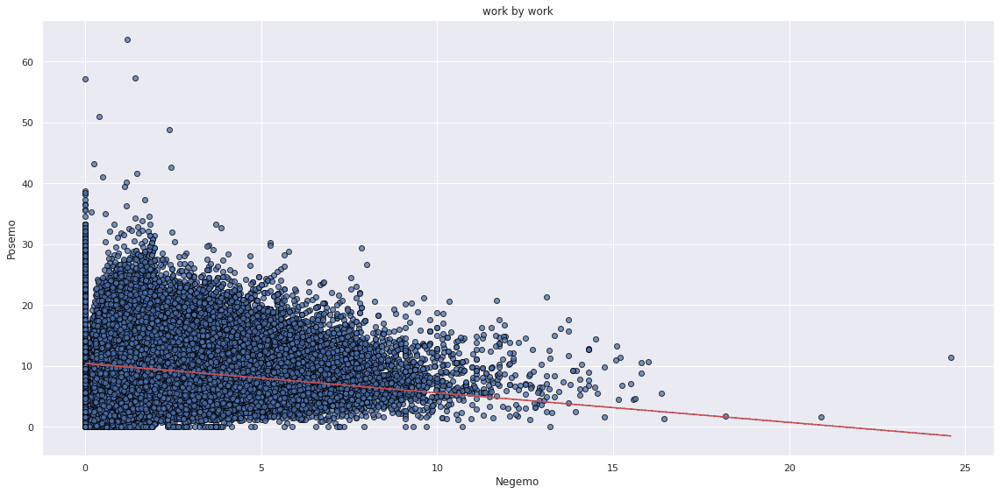

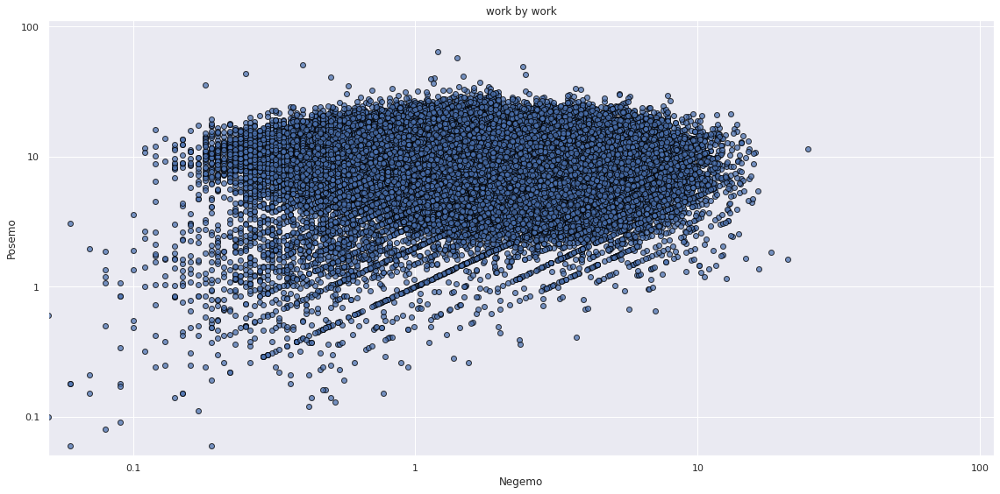

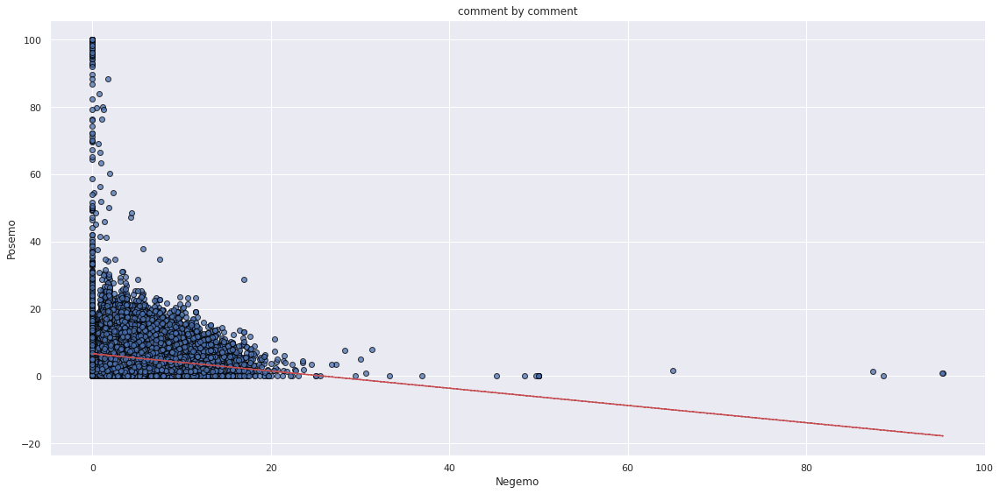

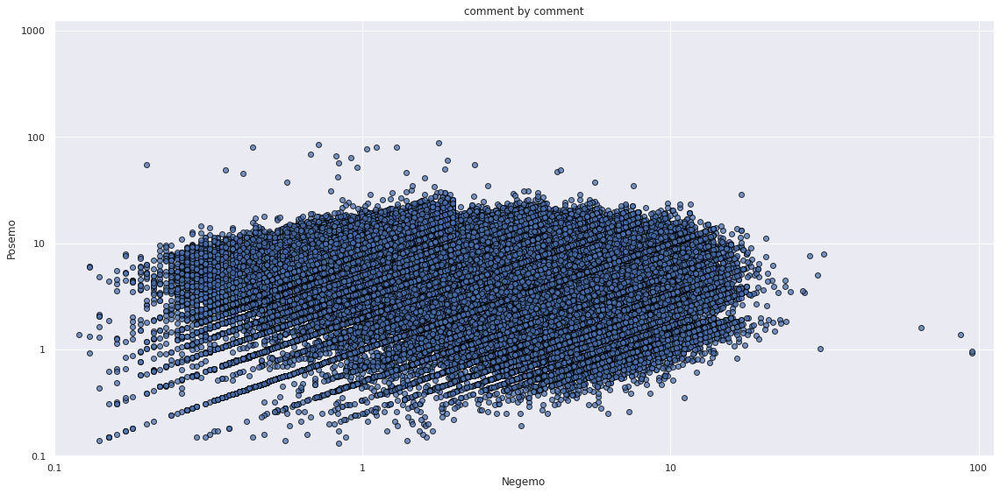

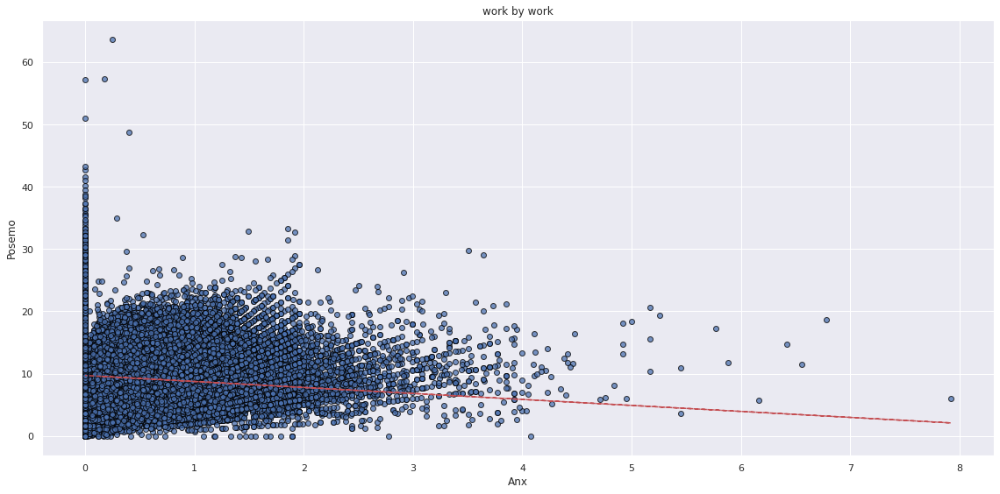

...

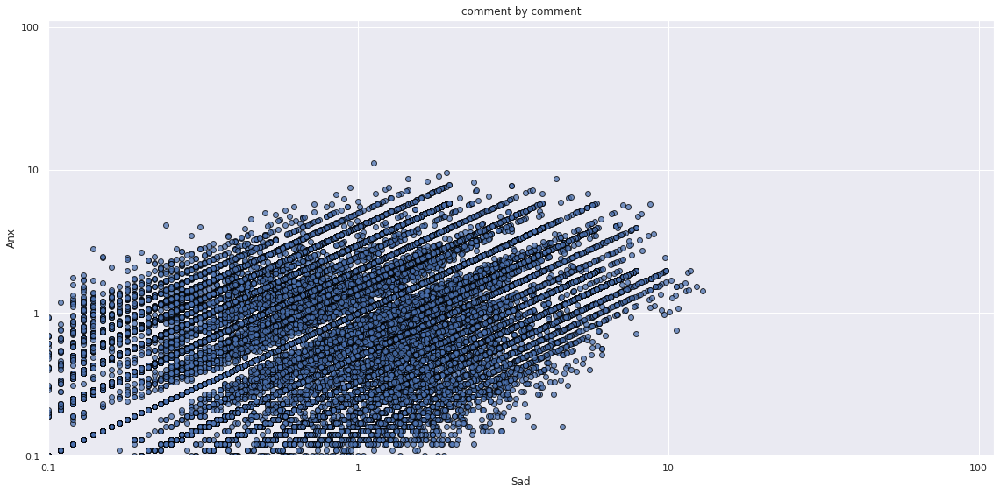

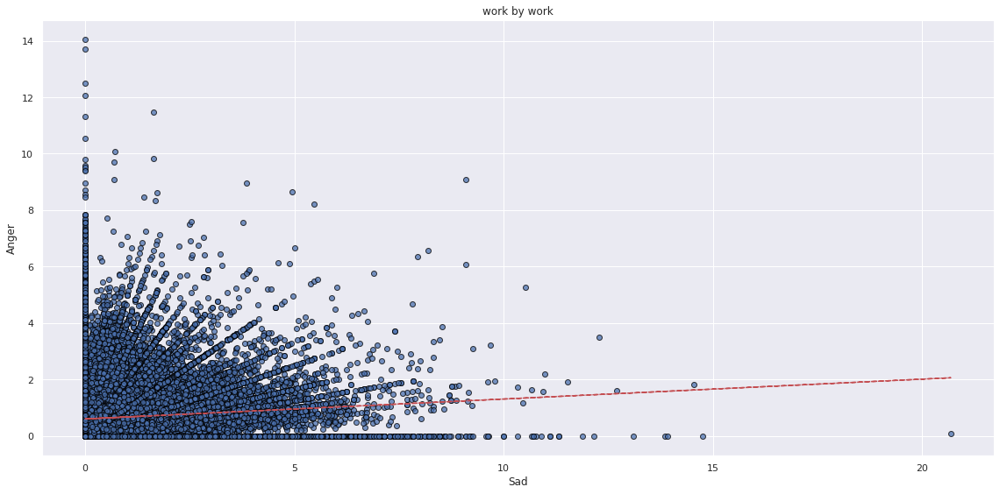

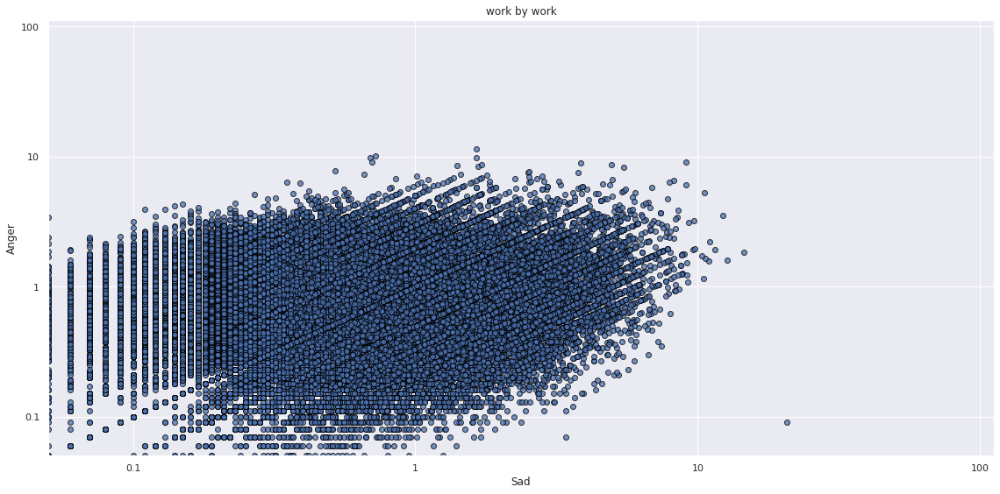

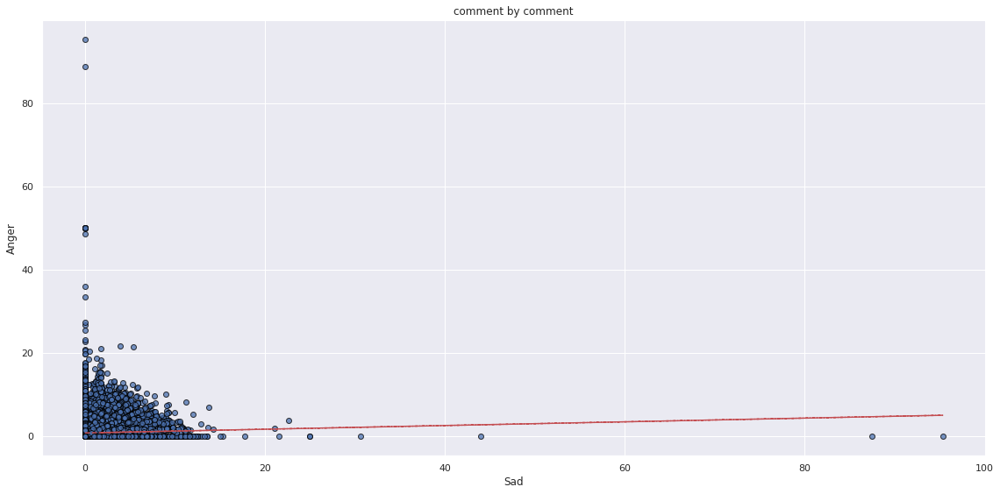

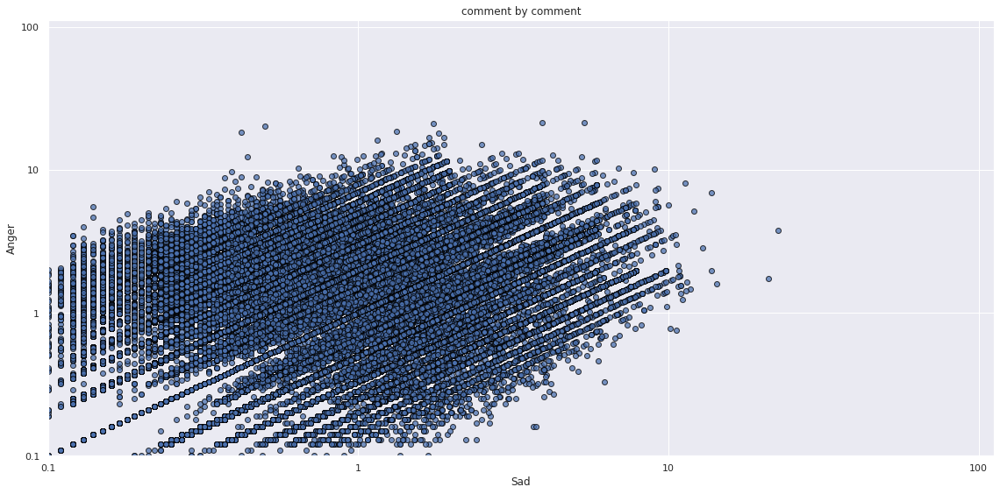

In [213]:
for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
    plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax=pair[0], x_ax=pair[1], title='work by work', polyfit=True)
    plt_corr(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50], y_ax=pair[0], x_ax=pair[1], title='work by work', log_scale=True, xlim=0.05, ylim=0.05)
    plt_corr(community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50], y_ax=pair[0], x_ax=pair[1], title='comment by comment', polyfit=True)
    plt_corr(community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50], y_ax=pair[0], x_ax=pair[1], title='comment by comment', log_scale=True)

We will analyze these comparisons then with the correlation matrix that follows.

Questions still searching for an answer:
1. Is there a correlation between thread length and Posemo or other emotions?

It follows the meaning of **Thread** from Andrea's metrics.

I define the concept of thread, with two different interpretations:
- A thread is a succession of comments in which there is a parental hierarchy, i.e. each comment is a child of another and can, in turn, have $n$ child comments.
- A thread is such if it consists of more than one comment, otherwise it is a single comment (at level 1).
- _leaves-originated thread_, a thread originates in the root and terminates in a leaf. It is computed by starting at a leaf and traveling backwards to the root. Each comment at this point can belong to several threads. It takes into account the concept of subthreads, which cannot be underestimated in case of bifurcations.
- _subtree-originated thread_, a thread originates in a $a$ node of level 1 and includes the entire subtree that has root in that $a$ node. The amount of nodes present is not indicative of the maximum depth of the thread, and nothing can be said at the structural level.

Below is used the _leaves-originated thread_.

In [214]:
joint_analysis = analysed_works_all_communities.join(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50])
nkudos_joint = []
for work in joint_analysis.index:
    row_index = works_dfs["marvel"].index[works_dfs["marvel"]["id"] == work].tolist()[0]
    nkudos_joint.append(works_dfs["marvel"]['nkudos'][row_index])
joint_analysis['nkudos'] = nkudos_joint
joint_analysis

,Nodes,Edges,Clustering coeff,Reciprocity,Ncomments,Tree Height,Breadth,Breadthest Layer,is Author most active user?,% Author Comments,...,SheHe,We,They,You,Ipron,Male,Female,See,Hear,nkudos
workid,,,,,,,,,,,,,,,,,,,,,
16769773,17.0,28.0,0.0,0.857143,30.0,3.0,16.0,1.0,yes,40.000000,...,1.38,0.46,0.31,3.99,6.45,2.00,0.00,0.92,0.77,233
16704133,12.0,21.0,0.0,0.952381,27.0,4.0,13.0,1.0,yes,44.444444,...,0.43,0.43,1.30,4.35,10.22,0.43,0.00,0.00,0.87,145
9821255,24.0,29.0,0.0,0.413793,32.0,2.0,26.0,1.0,yes,18.750000,...,1.76,0.00,0.54,2.44,8.66,2.03,0.00,0.41,0.14,832
9417707,17.0,22.0,0.0,0.545455,23.0,3.0,16.0,1.0,yes,26.086957,...,1.15,0.19,1.15,3.24,6.68,1.34,0.00,0.00,2.48,572
9340169,22.0,34.0,0.0,0.764706,34.0,2.0,21.0,1.0,yes,38.235294,...,2.54,0.40,0.13,4.01,8.14,2.67,0.00,0.80,0.13,1013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
458152,20.0,34.0,0.0,0.882353,70.0,5.0,37.0,1.0,yes,38.571429,...,2.02,0.27,0.74,1.96,5.05,2.12,0.42,0.85,0.85,237
424187,31.0,60.0,0.0,1.000000,71.0,4.0,33.0,1.0,yes,49.295775,...,1.84,0.19,0.50,1.99,7.07,2.01,0.00,1.43,0.35,225
421212,29.0,40.0,0.0,0.600000,46.0,3.0,31.0,1.0,yes,26.086957,...,0.37,0.00,0.30,2.01,6.93,0.37,0.00,0.67,0.30,171


In [215]:
joint_analysis.describe()

,Nodes,Edges,Clustering coeff,Reciprocity,Ncomments,Tree Height,Breadth,Breadthest Layer,% Author Comments,% Author-replied comments,...,SheHe,We,They,You,Ipron,Male,Female,See,Hear,nkudos
count,96973.000000,96973.000000,96900.000000,96973.000000,96973.000000,96973.000000,96973.000000,96973.000000,96973.000000,96973.000000,...,96971.00000,96971.000000,96971.000000,96971.000000,96971.000000,96971.000000,96971.000000,96971.000000,96971.000000,96973.000000
mean,35.476823,54.944304,0.003698,0.737993,95.305518,4.223815,55.914904,0.999876,34.892888,61.111173,...,1.61454,0.202498,0.781885,2.912157,6.850681,1.526665,0.482922,0.885803,0.476268,690.489621
std,51.998503,77.177256,0.020180,0.314692,204.786485,5.051249,124.742665,0.011123,15.802664,32.567478,...,1.05759,0.202579,0.524741,1.207828,1.237463,0.978122,0.673380,0.454631,0.350829,1090.374589
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,14.000000,23.000000,0.000000,0.592593,28.000000,2.000000,16.000000,1.000000,26.388889,35.483871,...,0.85000,0.070000,0.430000,2.080000,6.160000,0.810000,0.000000,0.610000,0.270000,189.000000
50%,21.000000,33.000000,0.000000,0.880000,43.000000,3.000000,25.000000,1.000000,41.666667,71.428571,...,1.46000,0.170000,0.700000,2.750000,6.810000,1.390000,0.210000,0.840000,0.420000,381.000000
75%,37.000000,57.000000,0.000000,0.981818,84.000000,5.000000,50.000000,1.000000,47.222222,89.041096,...,2.20000,0.280000,1.030000,3.570000,7.540000,2.090000,0.670000,1.100000,0.610000,772.000000
max,2739.000000,3870.000000,1.000000,1.000000,13197.000000,580.000000,11787.000000,1.000000,100.000000,600.000000,...,10.86000,8.990000,6.250000,13.640000,28.920000,9.810000,6.980000,9.380000,17.170000,99419.000000


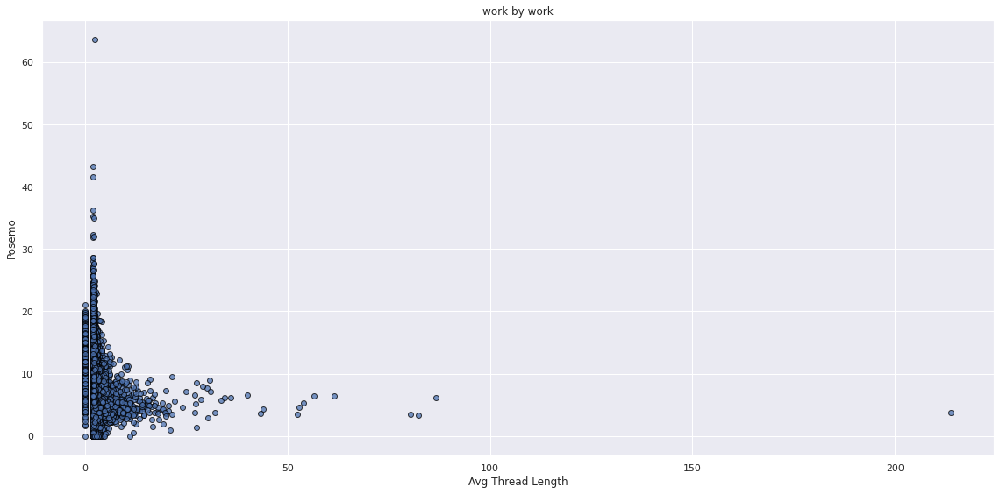

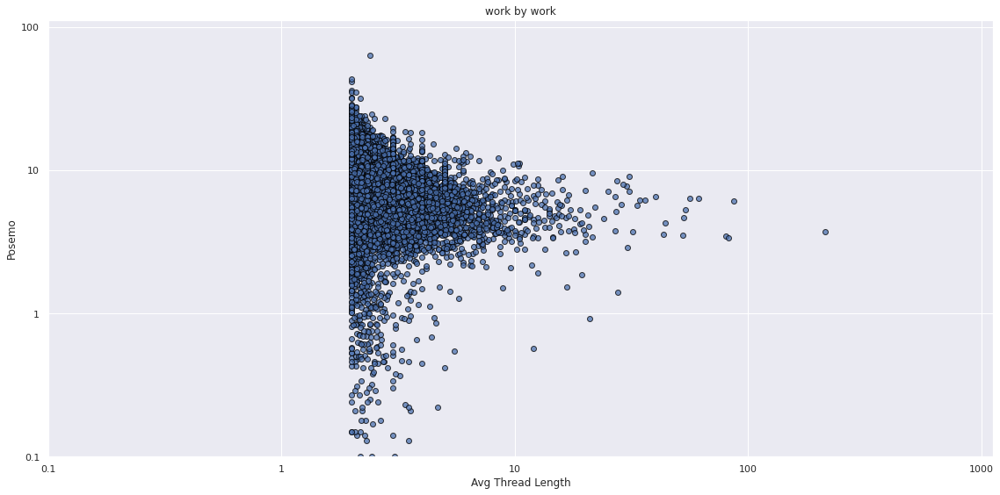

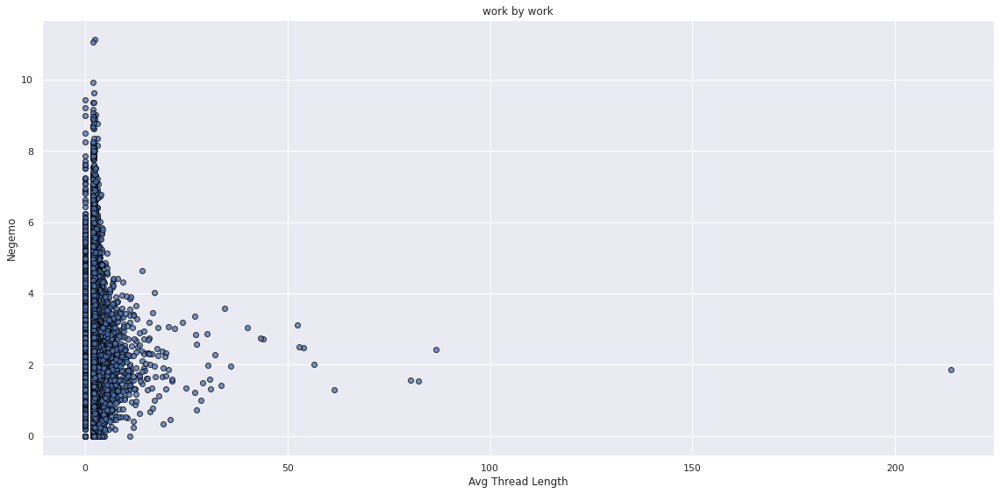

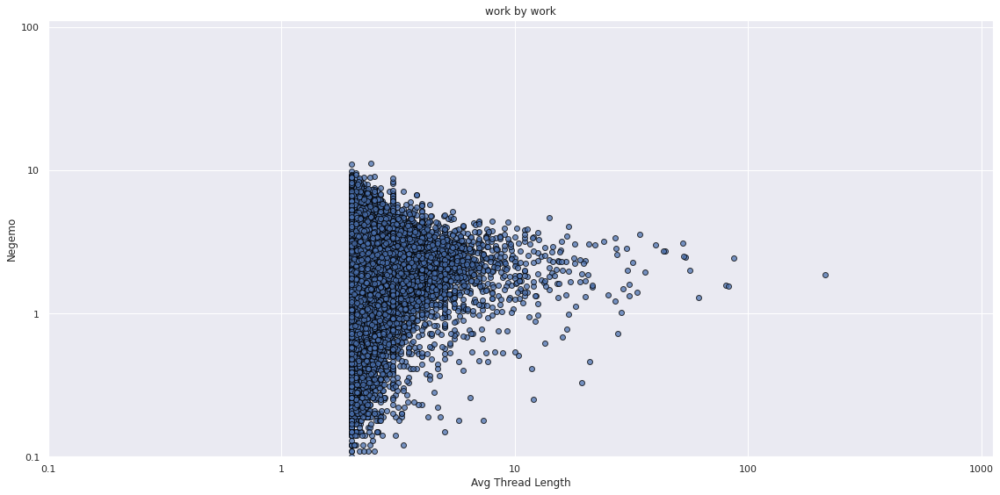

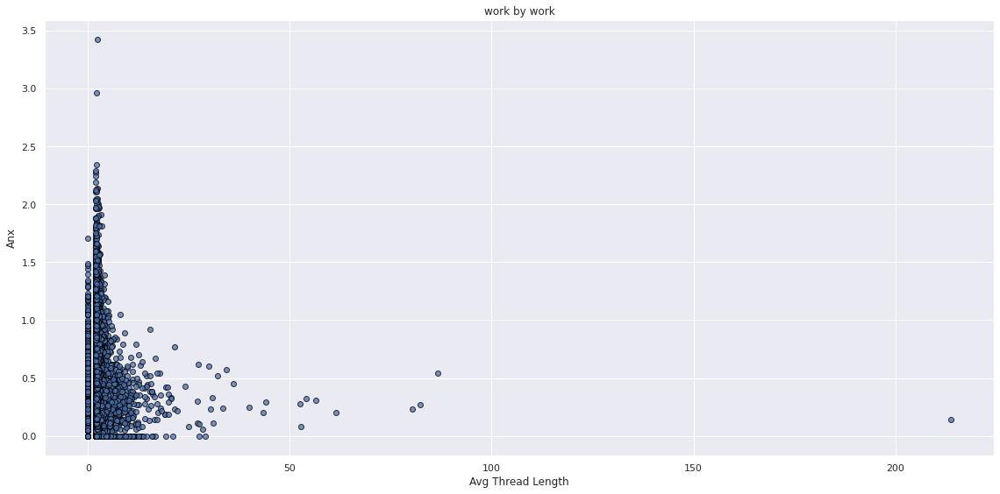

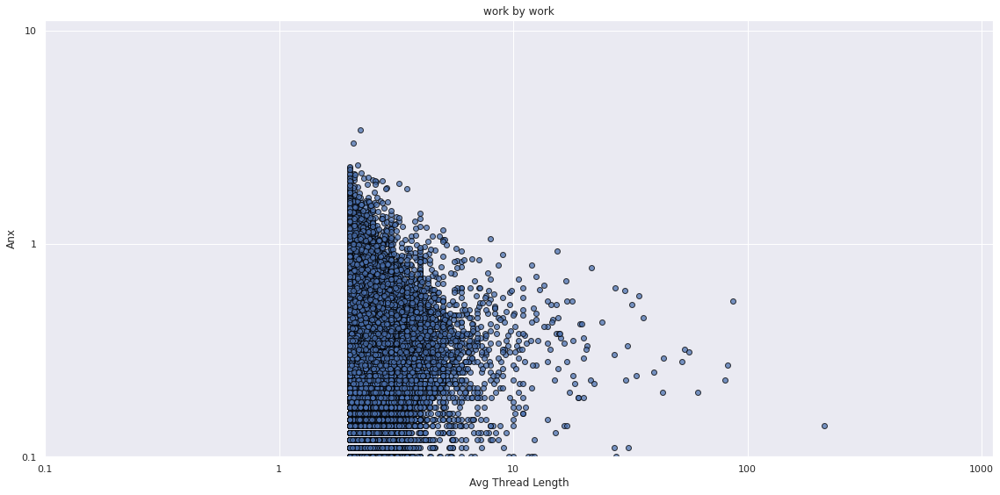

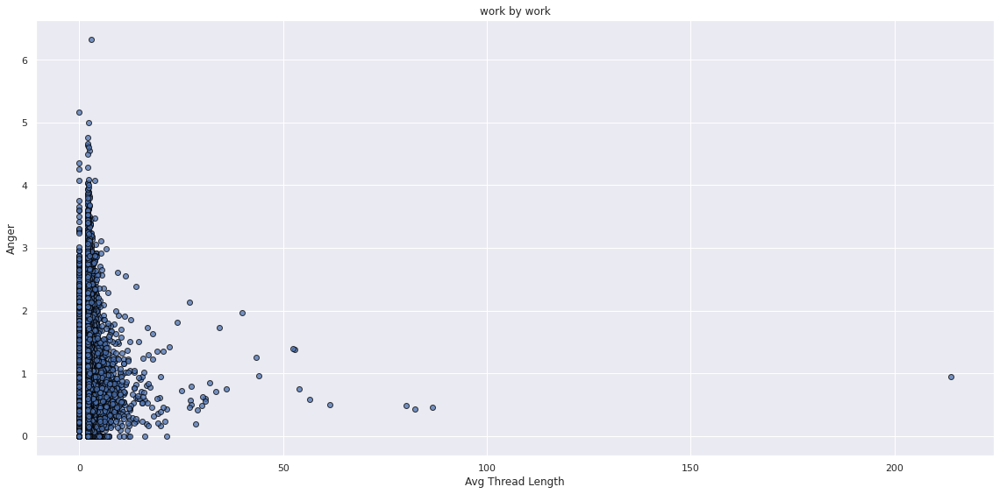

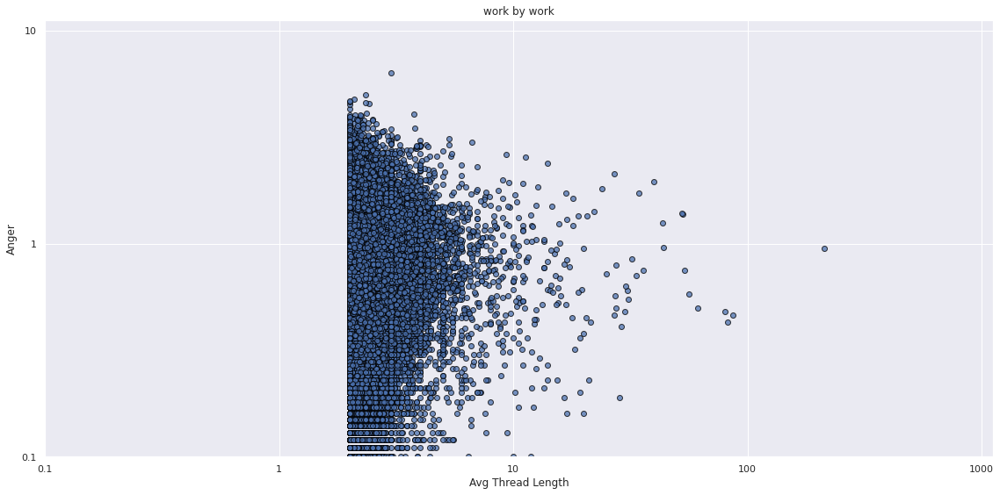

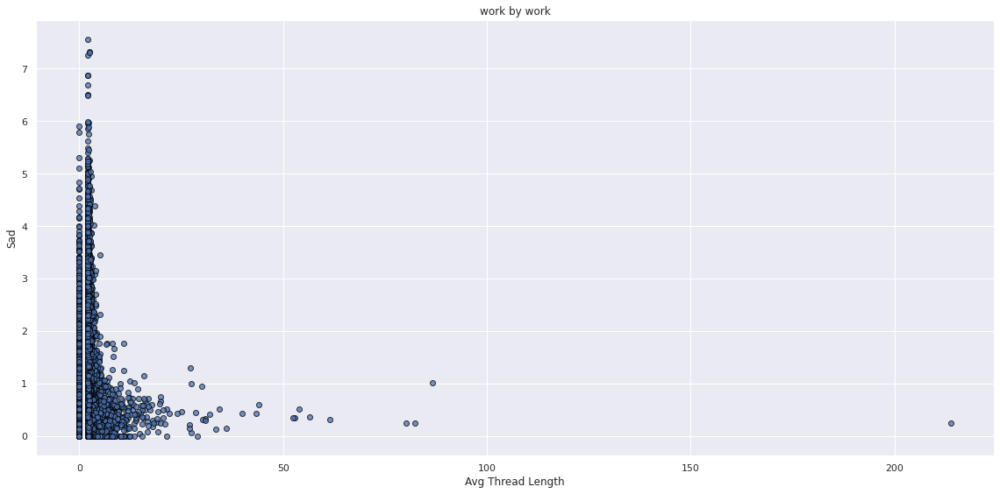

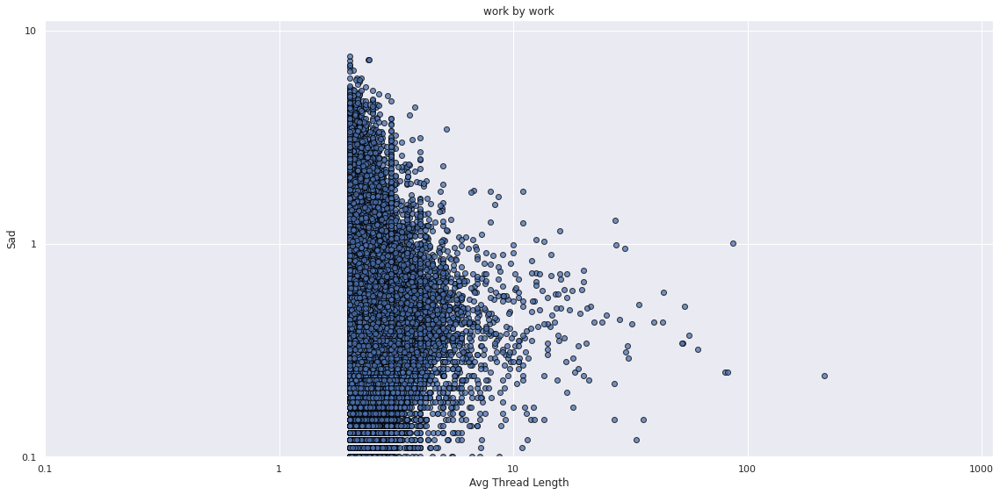

In [216]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plt_corr(joint_analysis, y_ax=category, x_ax='Avg Thread Length', title='work by work', polyfit=False)
    plt_corr(joint_analysis, y_ax=category, x_ax='Avg Thread Length', title='work by work', log_scale=True, xlim=0.1, ylim=0.1)

#### Correlation matrices

**None of the emotions would appear to be related to thread length** and **the categories take the highest percentage values when thread length in the works is minimal**. However, the latter statement is weakened by the fact that most works have average thread lengths around 4.

Let's go into detail by analyzing a **correlation coefficient**. A correlation coefficient is a numerical measure of some type of correlation, meaning a statistical relationship between two variables. The variables may be two columns of a given data set of observations, often called a sample, or two components of a multivariate random variable with a known distribution.

**About Pearson Correlation Coefficient**

Consider a dataset with two features: x and y. Each feature has n values, so x and y are n-tuples. Say that the first value x₁ from x corresponds to the first value y₁ from y, the second value x₂ from x to the second value y₂ from y, and so on. Then, there are n pairs of corresponding values: (x₁, y₁), (x₂, y₂), and so on. Each of these x-y pairs represents a single observation.

The Pearson (product-moment) correlation coefficient is a measure of the linear relationship between two features. It’s the ratio of the covariance of x and y to the product of their standard deviations. It’s often denoted with the letter r and called Pearson’s r. You can express this value mathematically with this equation:

r = Σᵢ((xᵢ − mean(x))(yᵢ − mean(y))) (√Σᵢ(xᵢ − mean(x))² √Σᵢ(yᵢ − mean(y))²)⁻¹

Here, i takes on the values 1, 2, …, n. The mean values of x and y are denoted with mean(x) and mean(y). This formula shows that if larger x values tend to correspond to larger y values and vice versa, then r is positive. On the other hand, if larger x values are mostly associated with smaller y values and vice versa, then r is negative.

Here are some important facts about the Pearson correlation coefficient:

- The Pearson correlation coefficient can take on any real value in the range −1 ≤ r ≤ 1.

- The maximum value r = 1 corresponds to the case in which there’s a perfect positive linear relationship between x and y. In other words, larger x values correspond to larger y values and vice versa.

- The value r > 0 indicates positive correlation between x and y.

- The value r = 0 corresponds to the case in which there’s no linear relationship between x and y.

- The value r < 0 indicates negative correlation between x and y.

- The minimal value r = −1 corresponds to the case when there’s a perfect negative linear relationship between x and y. In other words, larger x values correspond to smaller y values and vice versa.

The above facts can be summed up in the following table:

| **Pearson's r Value** 	| **Correlation Between x and y**      	|
|-----------------------	|--------------------------------------	|
| equal to 1            	| perfect positive linear relationship 	|
| greater than 0         	| positive correlation                 	|
| equal to 0            	| no linear relationship               	|
| less than 0           	| negative correlation                 	|
| equal to -1           	| perfect negative linear relationship 	|

By comment.

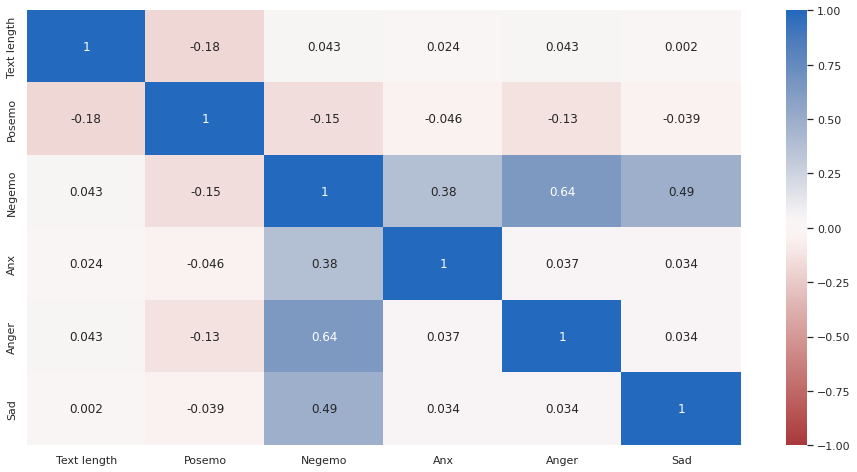

In [217]:
data = {'Text length': community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50]['text_length'],
        'Posemo': community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50]['Posemo'],
        'Negemo': community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50]['Negemo'],
        'Anx': community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50]['Anx'],
        'Anger': community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50]['Anger'],
        'Sad': community_by_comment["marvel"][community_by_comment["marvel"]['text_length']>50]['Sad']
        }
df = pd.DataFrame(data,columns=['Text length',
                                'Number of comments',
                                'Average content length',
                                'Posemo', 
                                'Negemo', 
                                'Anx', 
                                'Anger', 
                                'Sad',
                                'Kudos'
                               ])
plt.figure(figsize=(16, 8))
corrMatrix = df.corr()
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

By work.

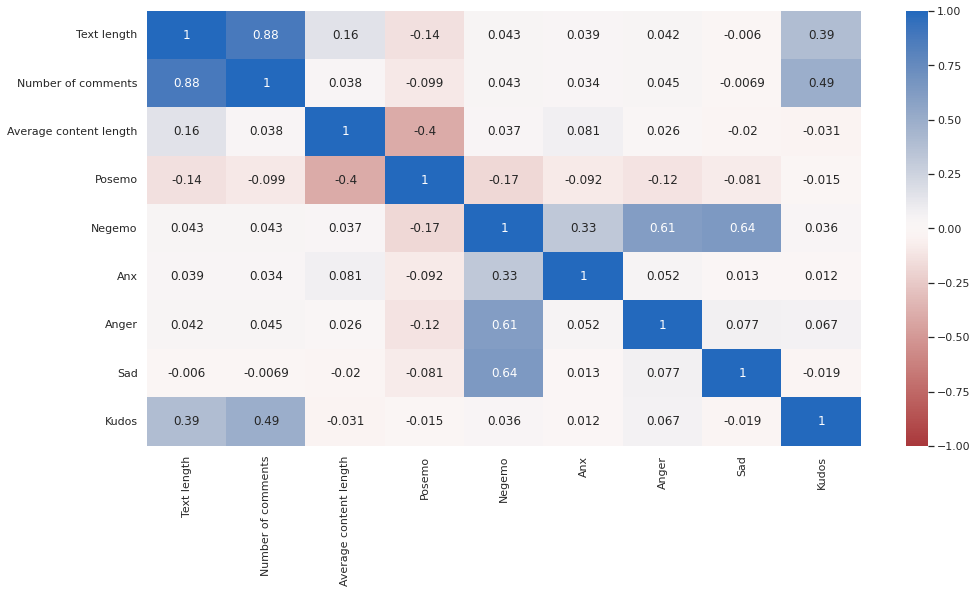

In [218]:
data = {'Text length': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['text_length'],
        'Number of comments': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['ncomments'],
        'Average content length': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['average_content_length'],
        'Posemo': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Posemo'],
        'Negemo': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Negemo'],
        'Anx': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Anx'],
        'Anger': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Anger'],
        'Sad': community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Sad'],
        'Kudos': nkudos
        }
df = pd.DataFrame(data,columns=['Text length',
                                'Number of comments',
                                'Average content length',
                                'Posemo', 
                                'Negemo', 
                                'Anx', 
                                'Anger', 
                                'Sad',
                                'Kudos'
                               ])
plt.figure(figsize=(16, 8))
corrMatrix = df.corr()
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

Recall the meaning of some metrics:
- **Relevant users**: utenti distinti che hanno commentato sotto ad un work (compreso l'autore).
- **Relevant interactions**: numero di interazioni tra gli utenti che hanno commentato sotto ad un work, dove l'interazione è uno o più commenti in risposta.
- **Clustering coeff**: misura di quanto gli user sotto a un work si scrivono tra di loro, ovvero di quanto è social la rete dei commenti sotto ad un work.
- **Reciprocity**: misura di quanto gli user tendono a rispondere a chi gli ha commentato.
- **Ncomments**: numero di commenti totali sotto a un work.
- **Tree Height**: altezza della thread più lunga.
- **Breadth**: numero di risposte al commento con maggiore reply.
- **Breadthest Layer**: profondità del commento con maggiore reply.
- **Is author most active user?**
- **% Author Comments**: percentuale di commenti dell'autore sul totale di commenti.
- **% Author-replied comments**: percentuale di commenti a cui l'autore ha risposto (esclusi i suoi commenti).
- **Distinct Users**: numero di user che partecipano ai commenti sotto al work.
- **Avg. Comments per user**: media di commenti per utente (compreso l'autore).
- **Avg. Comments per user (no author)**: media di commenti per utente (senza l'autore).
- **Avg Thread Length**: lunghezza media di una thread.
- **% Single Comments**: percentuale di commenti singoli sul totale, ovvero commenti che non danno origine a una conversazione.
- **% Threads long 1 or 2**: percentuale di threads lunghi 1 o 2.
- **% Threads longer than 3**: percentuale di threads più lunghi di 3.
- **% Threads longer than 5**: percentuale di threads più lunghi di 5.
- **% Threads longer than 10**: percentuale di threads più lunghi di 10.
- **% Thread where user has last word**: percentuale di conversazioni dove l'autore è l'ultimo a scrivere.
- **Avg % Author Replies in Thread**: partecipazione media dell'autore in una conversazione.
- **Avg % Author Replies in Threads longer than 3**: partecipazione media dell'autore in una conversazione più lunga di 3.
- **Avg % Author Replies in Threads longer than 5**: partecipazione media dell'autore in una conversazione più lunga di 5.
- **Avg % Author Replies in Threads longer than 10**: partecipazione media dell'autore in una conversazione più lunga di 10.

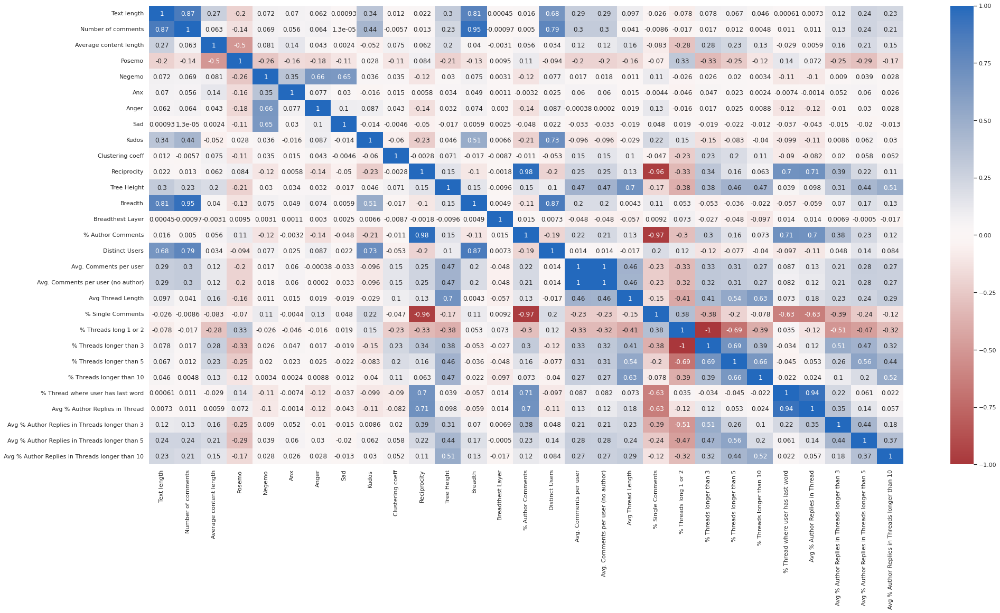

In [219]:
data = {'Text length': joint_analysis['text_length'],
        'Number of comments': joint_analysis['ncomments'],
        'Average content length': joint_analysis['average_content_length'],
        'Posemo': joint_analysis['Posemo'],
        'Negemo': joint_analysis['Negemo'],
        'Anx': joint_analysis['Anx'],
        'Anger': joint_analysis['Anger'],
        'Sad': joint_analysis['Sad'],
        'Kudos': joint_analysis['nkudos'],
        'Clustering coeff': joint_analysis['Clustering coeff'],
        'Reciprocity': joint_analysis['Reciprocity'],
        'Tree Height': joint_analysis['Tree Height'],
        'Breadth': joint_analysis['Breadth'],
        'Breadthest Layer': joint_analysis['Breadthest Layer'],
        '% Author Comments': joint_analysis['% Author Comments'],
        '% Author-replied comments': joint_analysis['% Author-replied comments'],
        'Distinct Users': joint_analysis['Distinct Users'],
        'Avg. Comments per user': joint_analysis['Avg. Comments per user'],
        'Avg. Comments per user (no author)': joint_analysis['Avg. Comments per user (no author)'],
        'Avg Thread Length': joint_analysis['Avg Thread Length'],
        '% Single Comments': joint_analysis['% Single Comments'],
        '% Threads long 1 or 2': joint_analysis['% Threads long 1 or 2'],
        '% Threads longer than 3': joint_analysis['% Threads longer than 3'],
        '% Threads longer than 5': joint_analysis['% Threads longer than 5'],
        '% Threads longer than 10': joint_analysis['% Threads longer than 10'],
        '% Thread where user has last word': joint_analysis['% Thread where user has last word'],
        'Avg % Author Replies in Thread': joint_analysis['Avg % Author Replies in Thread'],
        'Avg % Author Replies in Threads longer than 3': joint_analysis['Avg % Author Replies in Threads longer than 3'],
        'Avg % Author Replies in Threads longer than 5': joint_analysis['Avg % Author Replies in Threads longer than 5'],
        'Avg % Author Replies in Threads longer than 10': joint_analysis['Avg % Author Replies in Threads longer than 10']
        }
df = pd.DataFrame(data,columns=['Text length',
                                'Number of comments',
                                'Average content length',
                                'Posemo', 
                                'Negemo', 
                                'Anx', 
                                'Anger', 
                                'Sad',
                                'Kudos',
                                'Clustering coeff',
                                'Reciprocity',
                                'Tree Height',
                                'Breadth',
                                'Breadthest Layer',
                                '% Author Comments',
                                '% Author-replied Comments',
                                'Distinct Users',
                                'Avg. Comments per user',
                                'Avg. Comments per user (no author)',
                                'Avg Thread Length',
                                '% Single Comments',
                                '% Threads long 1 or 2',
                                '% Threads longer than 3',
                                '% Threads longer than 5',
                                '% Threads longer than 10',
                                '% Thread where user has last word',
                                'Avg % Author Replies in Thread',
                                'Avg % Author Replies in Threads longer than 3',
                                'Avg % Author Replies in Threads longer than 5',
                                'Avg % Author Replies in Threads longer than 10'
                               ])
plt.figure(figsize=(32, 16))
corrMatrix = df.corr()
corrMatrix.to_csv('./marvel/marvel_first_comparison.csv')
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

We now turn to **Z-Score**. This parameter looks at each point's difference from the mean and weighs it by the variance squared. Recall that variance is a numerical value that describes the variability of observations from its arithmetic mean. Because it is weighted by the variance it is more difficult for it to deviate from 0 and if there is a deviation it means there was significant variation. The Z-Score calculates the mean and variance over all data points and for each point the Z-Score is the <span style="font-size:1.5em;">$\frac{point - mean}{variance^2}$</span> value.

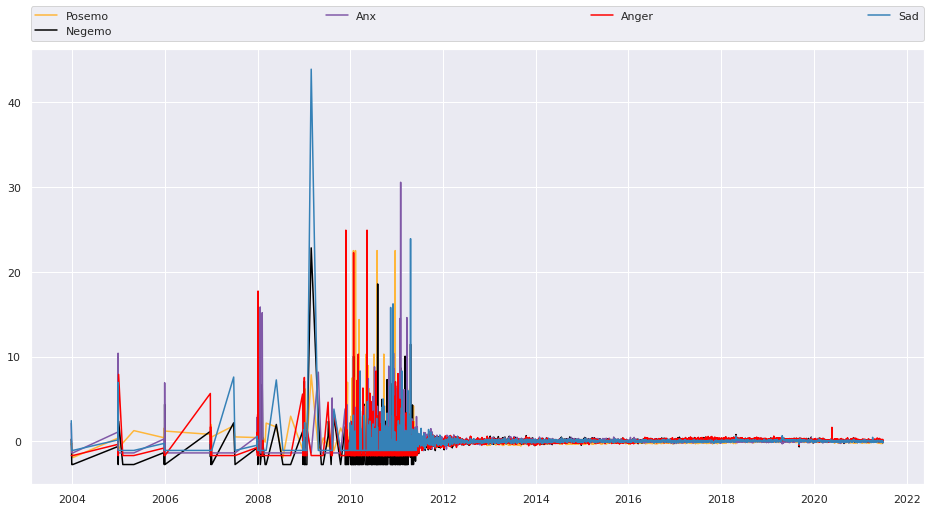

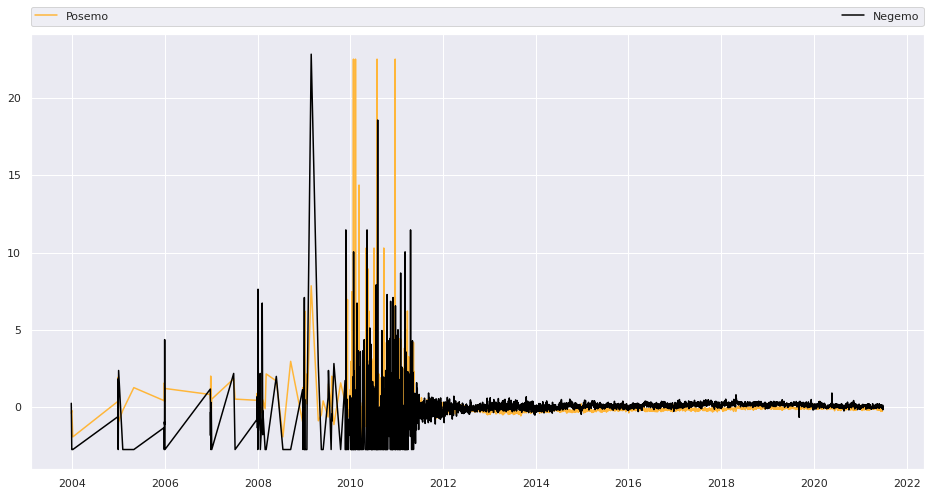

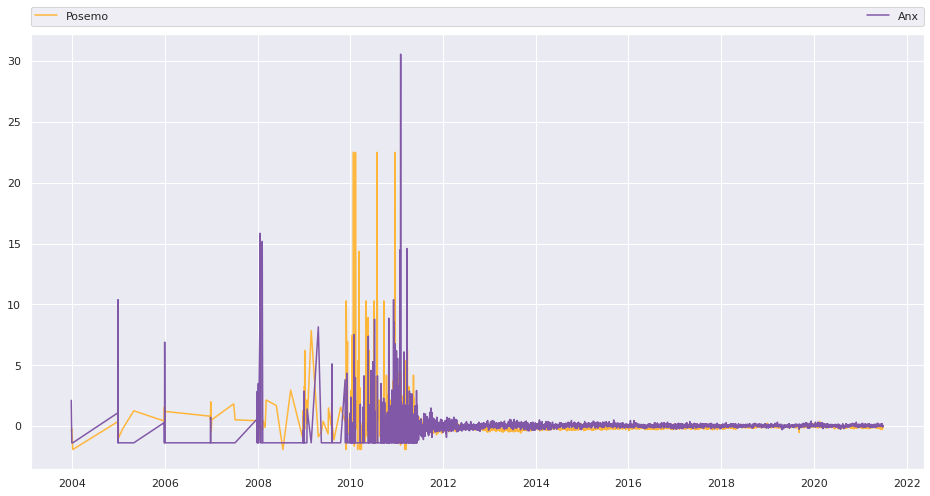

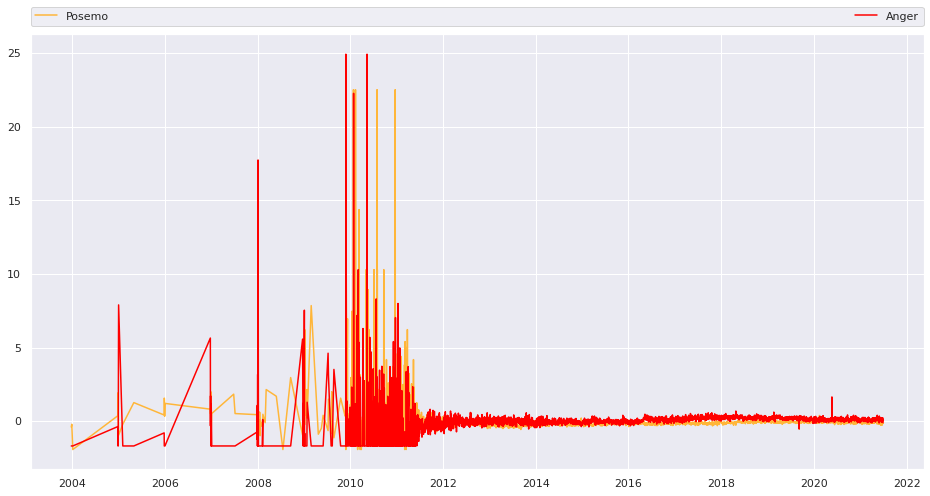

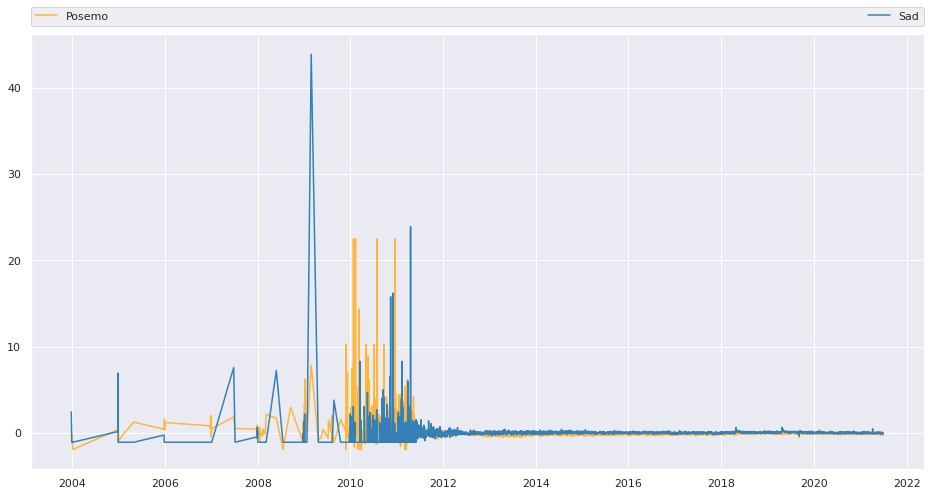

...

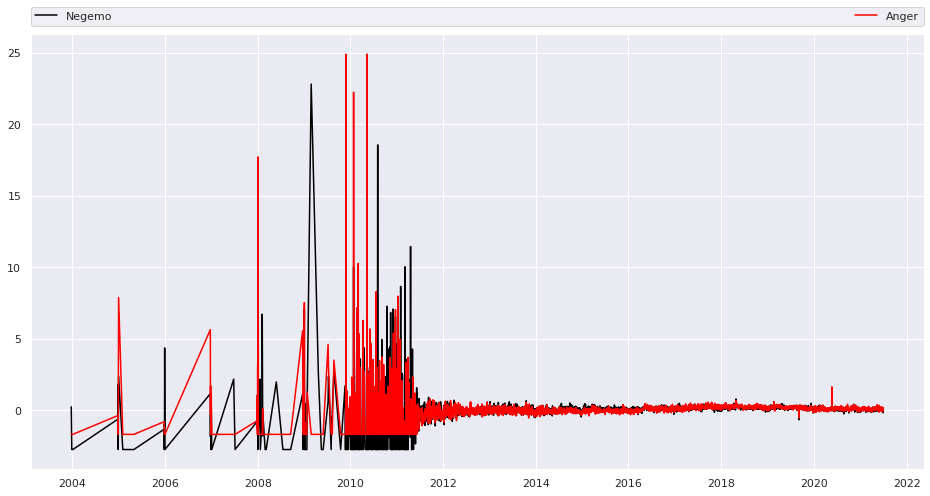

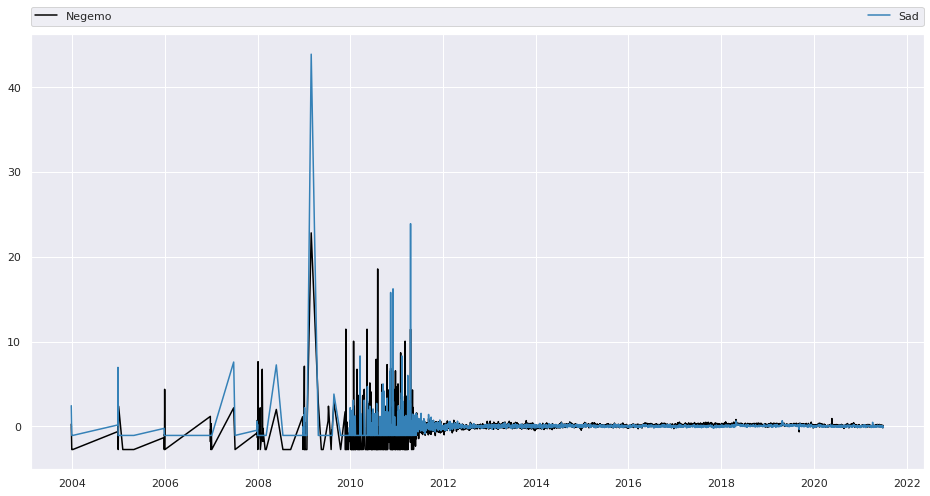

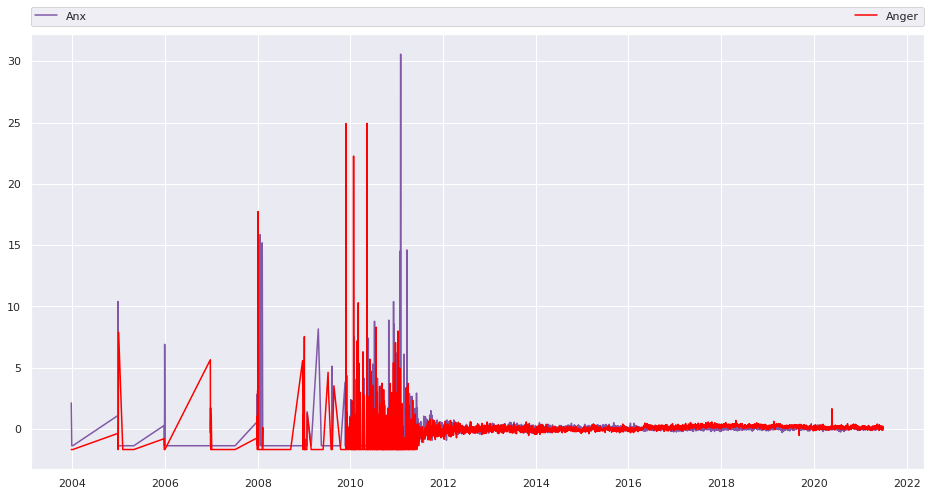

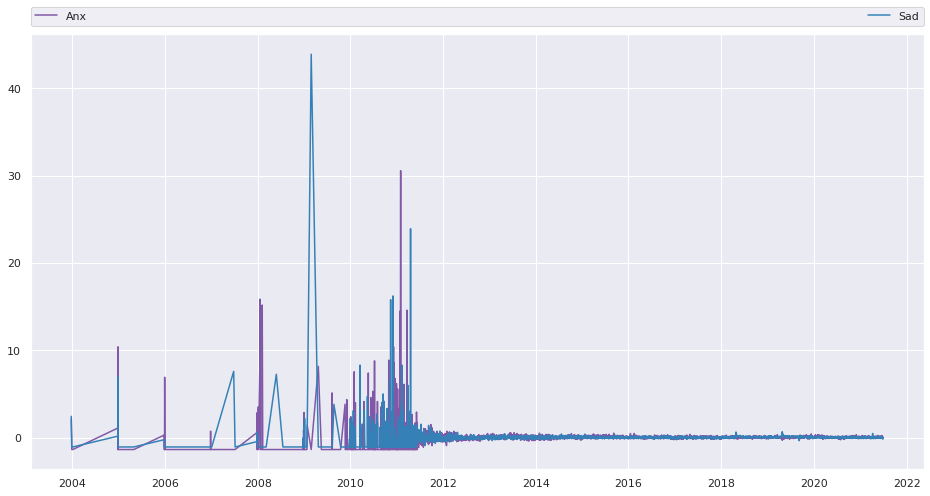

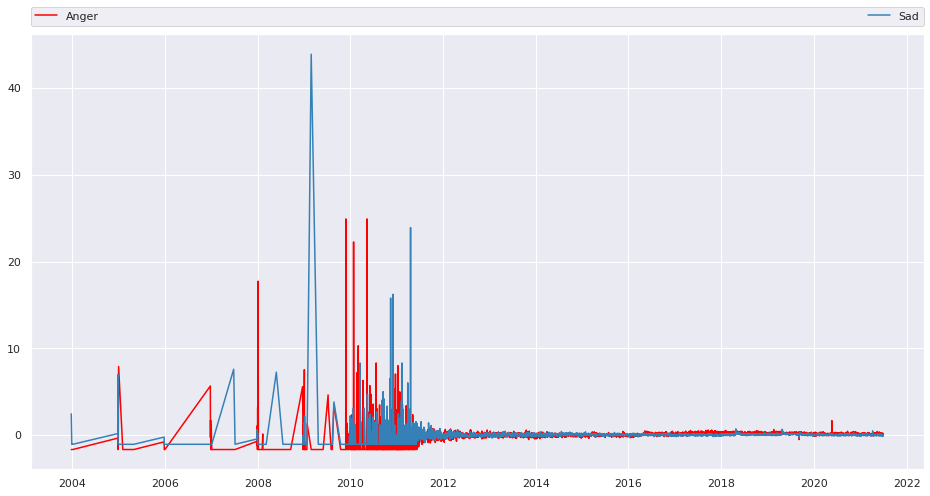

In [220]:
plot_zscore(daily_stats["marvel"], ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'])
for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
    plot_zscore(daily_stats["marvel"], pair)

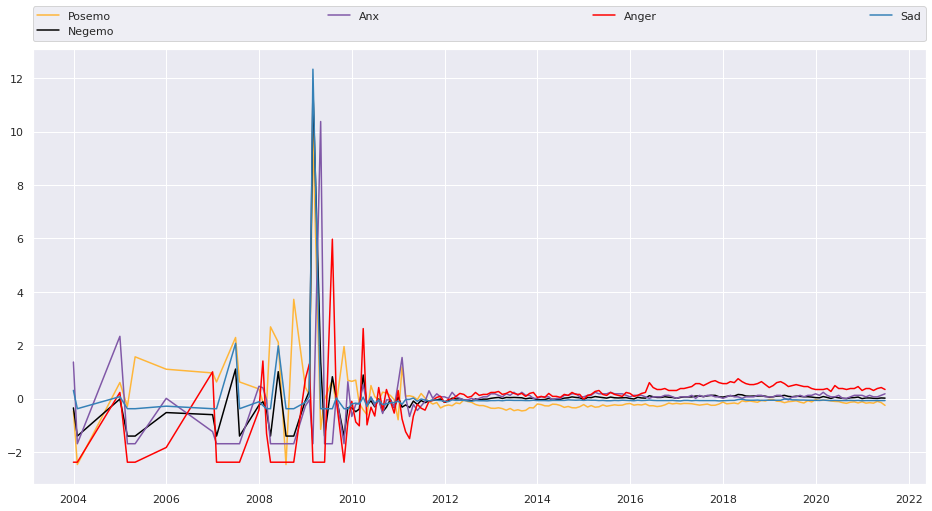

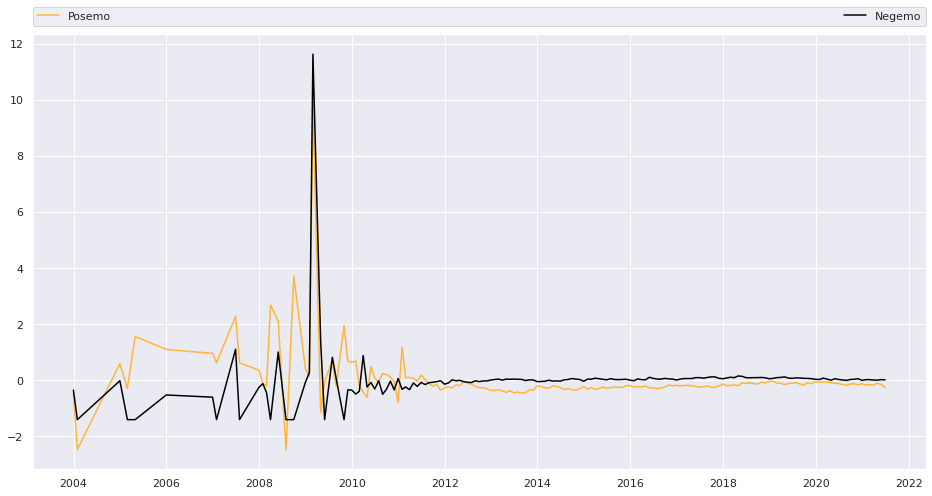

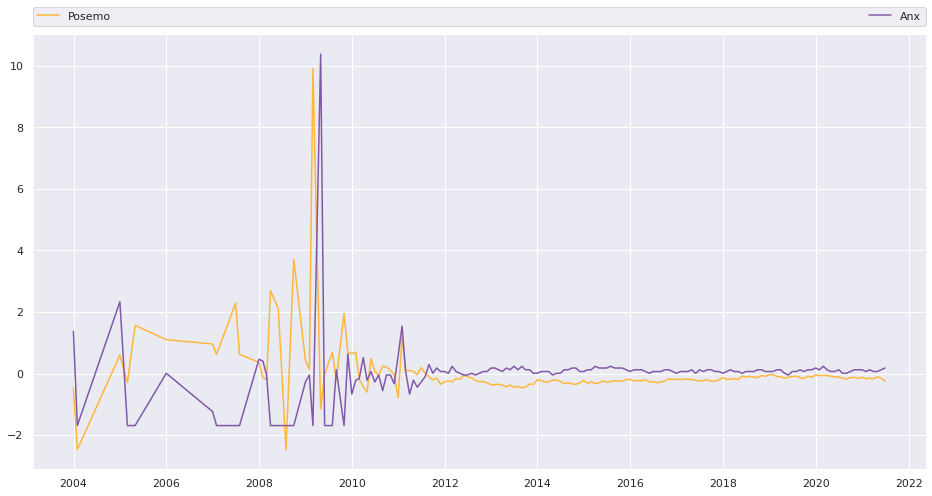

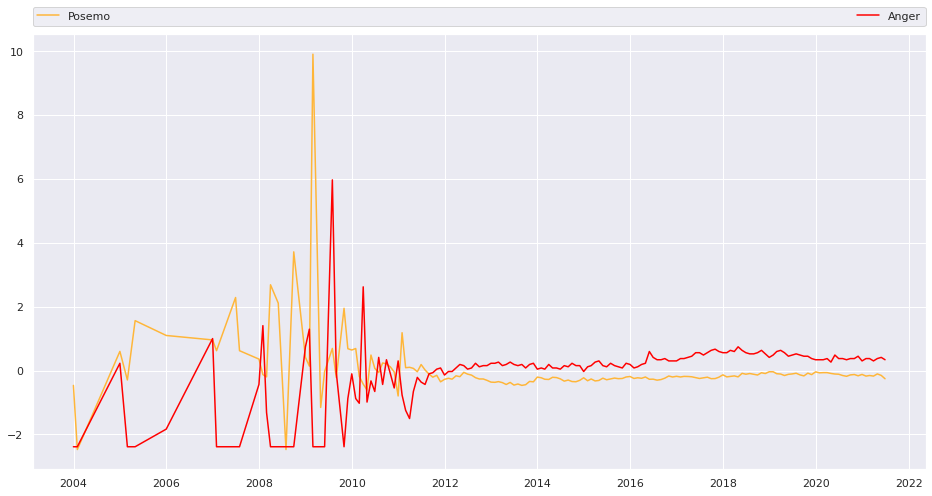

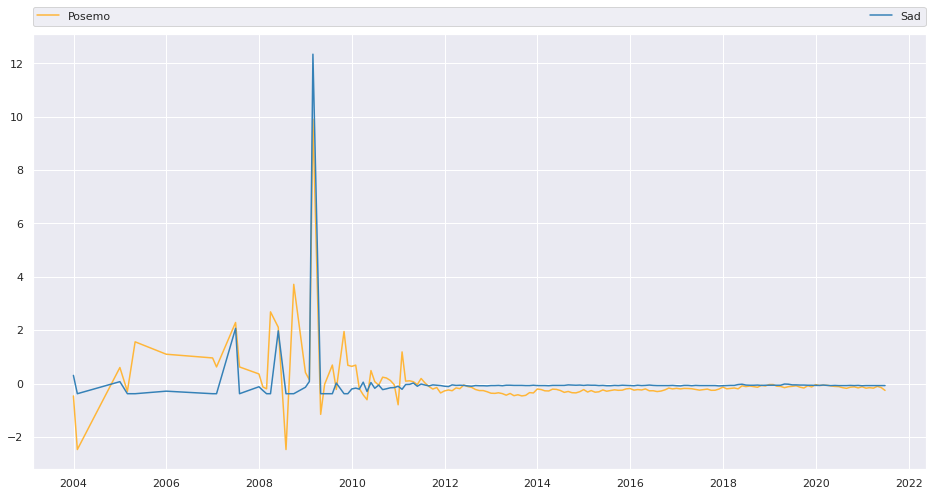

...

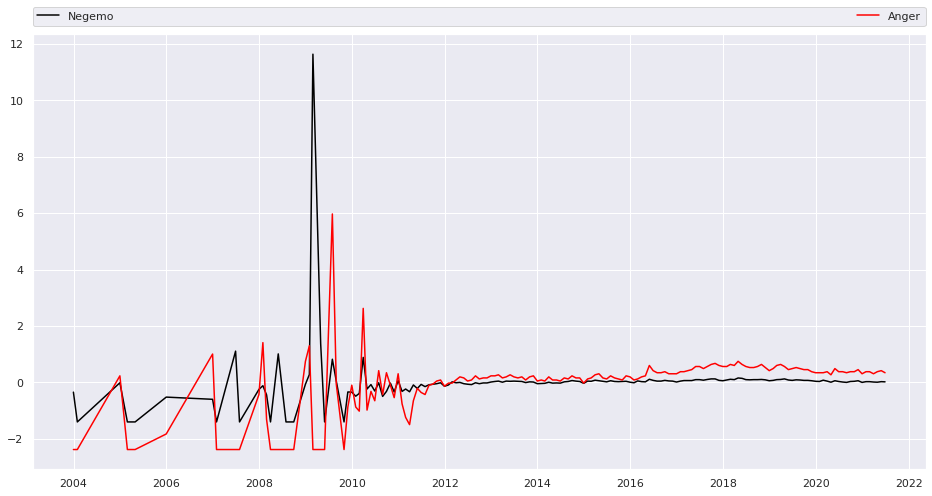

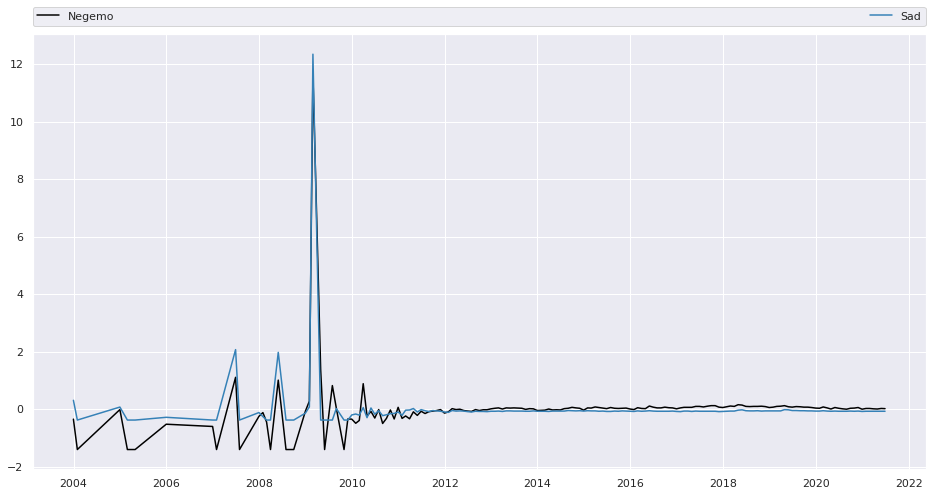

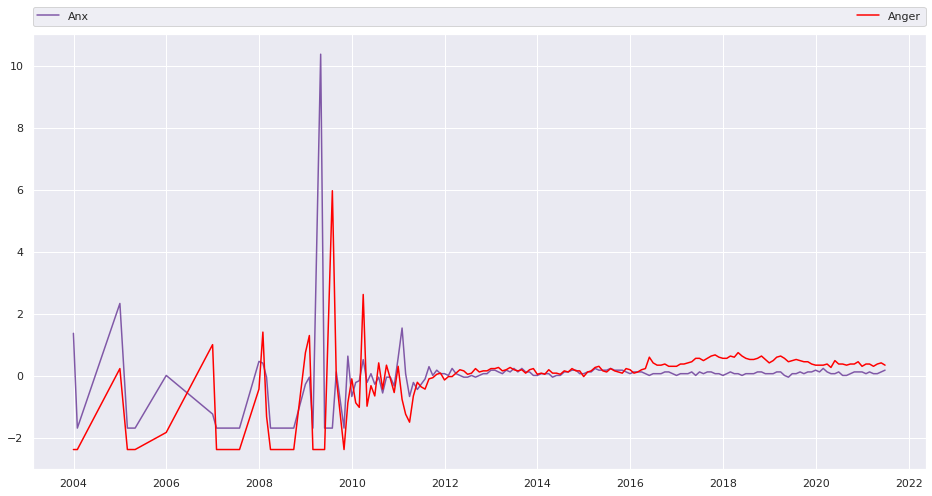

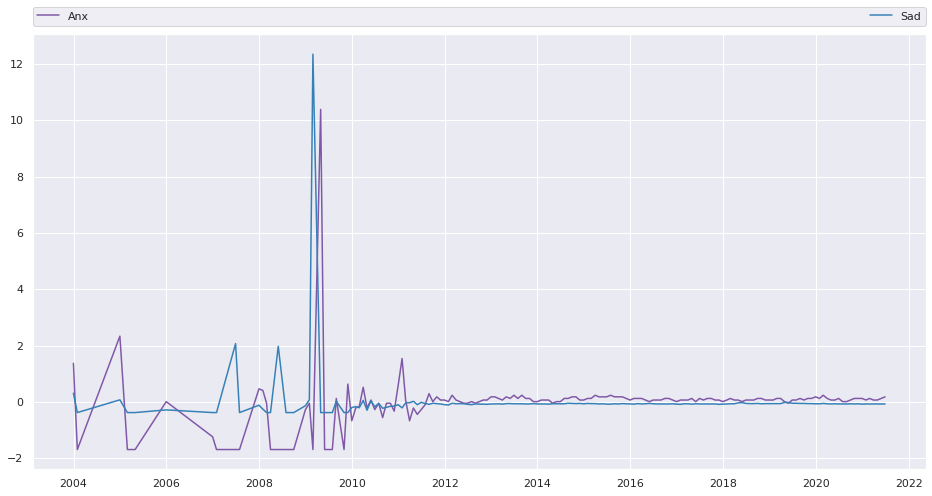

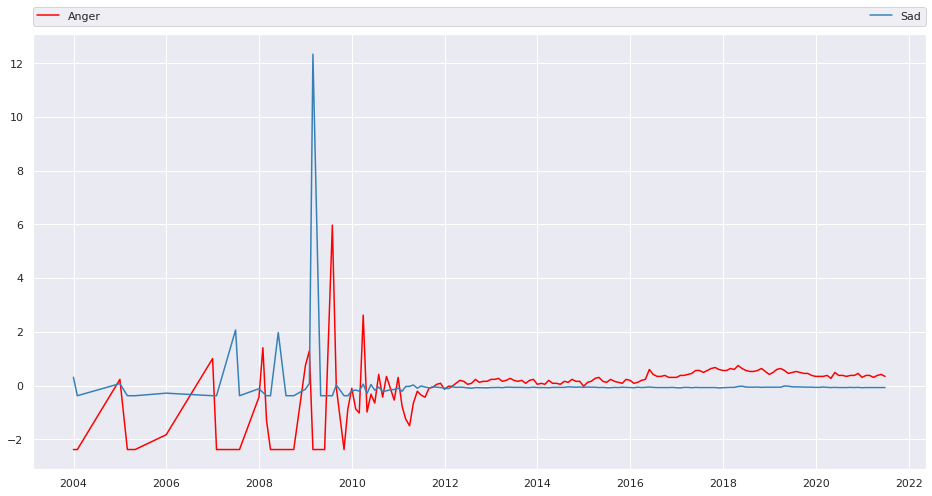

In [221]:
plot_zscore(monthly_stats["marvel"], ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'])
for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
    plot_zscore(monthly_stats["marvel"], pair)

#### Frequency histograms

And now let's explore some variables with the use of **histograms**. A histogram divides the variable into bins, counts the data points in each bin, and shows the bins on the x-axis and the counts on the y-axis. For Posemo the bins will be an interval of values representing the percentage of this category and the count will be the number of days falling into that interval. The binwidth is the most important parameter for a histogram and we should always try out a few different values of binwidth to select the best one for our data.

We will see an initial representation of the data with a **frequency histogram**. Then a **density function** over the histogram and finally the **percentiles**.

First, what is a density plot? A density plot is a smoothed, continuous version of a histogram estimated from the data. The most common form of estimation is known as kernel density estimation. In this method, a continuous curve (the kernel) is drawn at every individual data point and all of these curves are then added together to make a single smooth density estimation. The kernel most often used is a Gaussian (which produces a Gaussian bell curve at each data point).

The x-axis is the value of the variable just like in a histogram, but what exactly does the y-axis represent? The y-axis in a density plot is the probability density function for the kernel density estimation. However, we need to be careful to specify this is a probability density and not a probability. The difference is the probability density is the probability per unit on the x-axis. To convert to an actual probability, we need to find the area under the curve for a specific interval on the x-axis. Somewhat confusingly, because this is a probability density and not a probability, the y-axis can take values greater than one. The only requirement of the density plot is that the total area under the curve integrates to one. I generally tend to think of the y-axis on a density plot as a value only for relative comparisons between different categories.

Let's aggregate by day.

In [222]:
daily_stats["marvel"].describe()

,text_length,ncomments,average_content_length,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear,Feel
count,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000,4192.000000
mean,91981.821326,2611.312023,37.193015,7.873042,2.144148,0.306300,0.701918,0.478647,10.803223,5.397161,1.839239,0.195196,0.782202,2.591560,6.684175,1.705489,0.533891,0.855126,0.498795,0.679437
std,66442.741820,2018.180553,15.993961,4.093109,0.782215,0.223515,0.417691,0.444514,2.123082,1.233443,0.655823,0.139510,0.376073,1.924207,1.443387,0.583518,0.408496,0.343156,0.398965,0.504112
min,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,36495.250000,912.750000,33.240000,7.050000,2.100000,0.290000,0.660000,0.450000,10.567500,5.190000,1.767500,0.180000,0.750000,2.330000,6.510000,1.630000,0.430000,0.850000,0.460000,0.630000
50%,93434.500000,2527.500000,36.260000,7.380000,2.210000,0.310000,0.730000,0.480000,10.810000,5.340000,1.940000,0.210000,0.820000,2.480000,6.620000,1.770000,0.550000,0.890000,0.490000,0.670000
75%,145061.500000,4221.250000,39.552500,7.690000,2.300000,0.330000,0.780000,0.510000,11.020000,5.510000,2.080000,0.230000,0.860000,2.620000,6.740000,1.900000,0.630000,0.920000,0.520000,0.700000
max,323599.000000,9734.000000,569.850000,100.000000,20.000000,7.140000,11.110000,20.000000,50.000000,42.860000,11.540000,5.260000,7.580000,50.000000,50.000000,9.620000,11.540000,6.250000,12.500000,12.500000


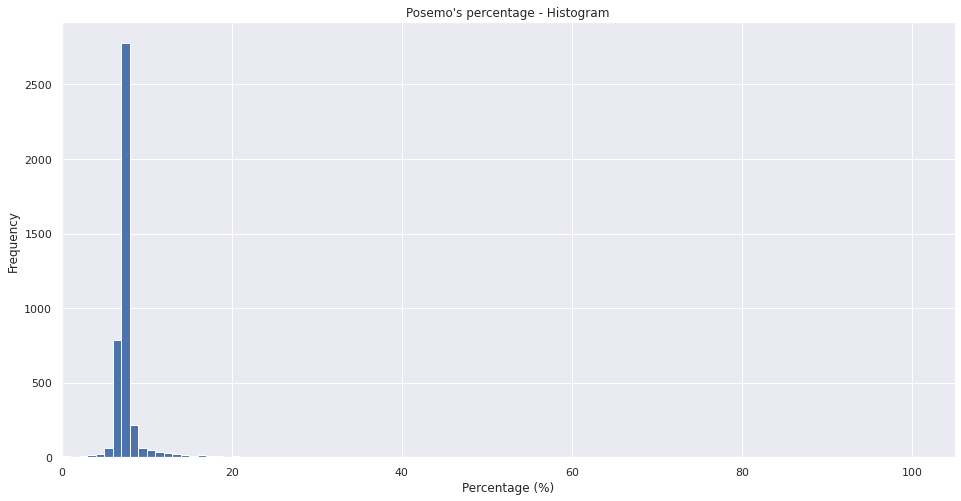

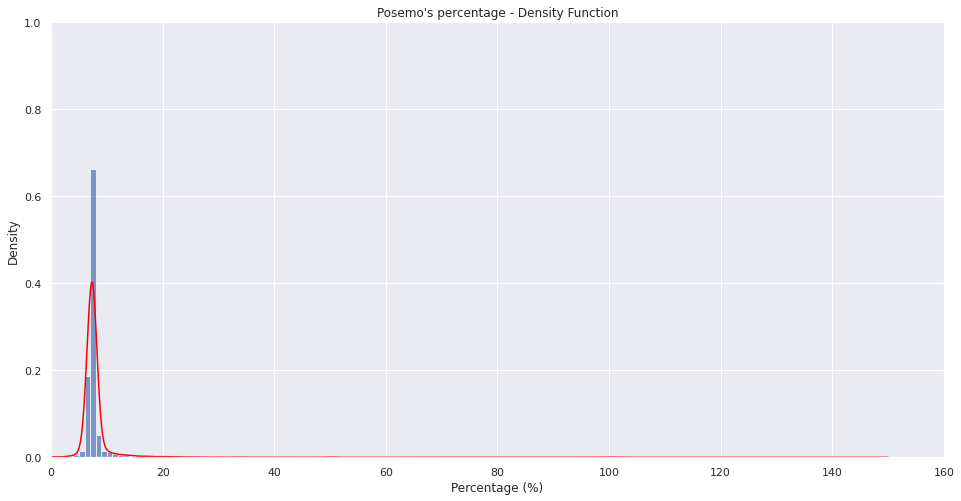

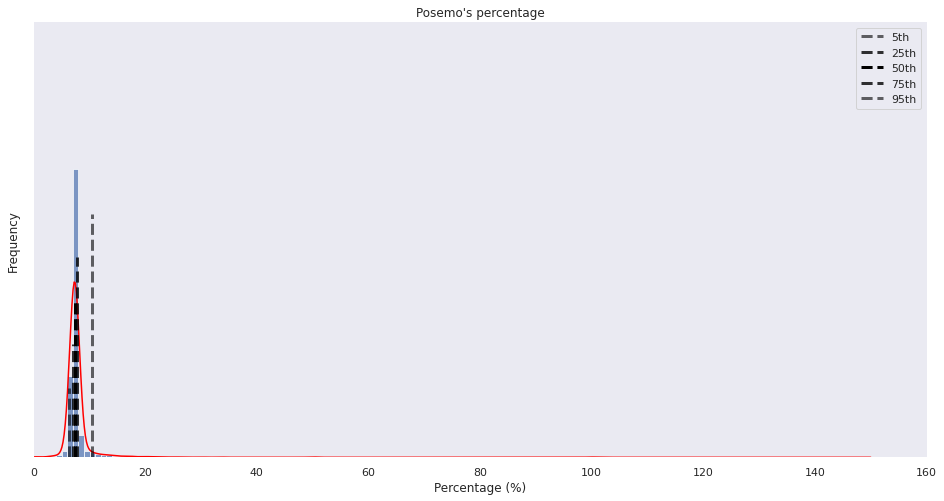

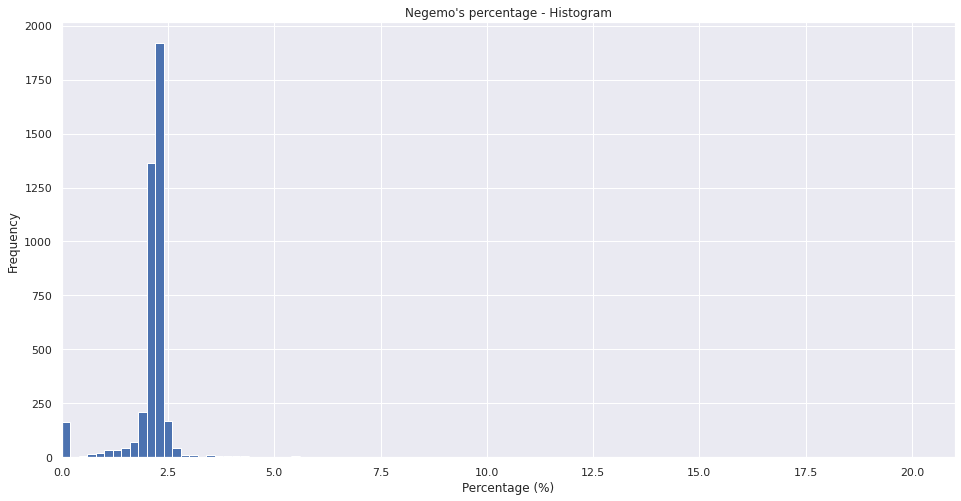

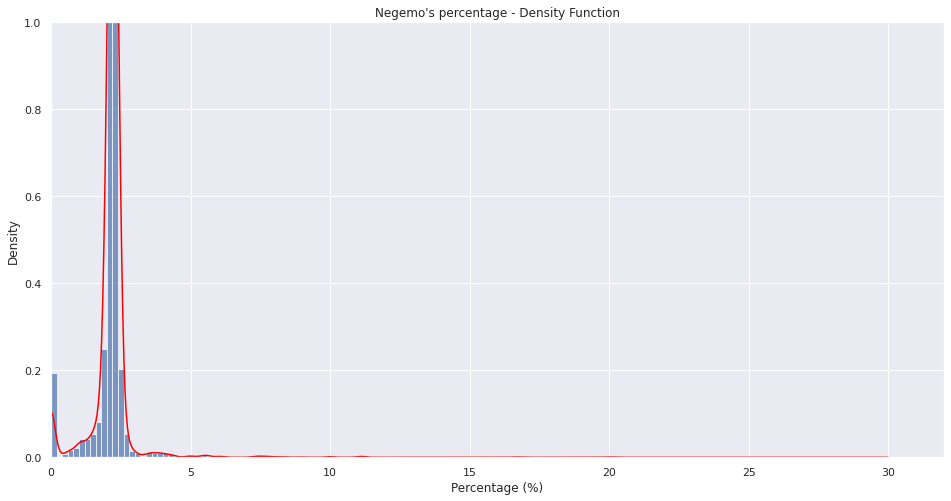

...

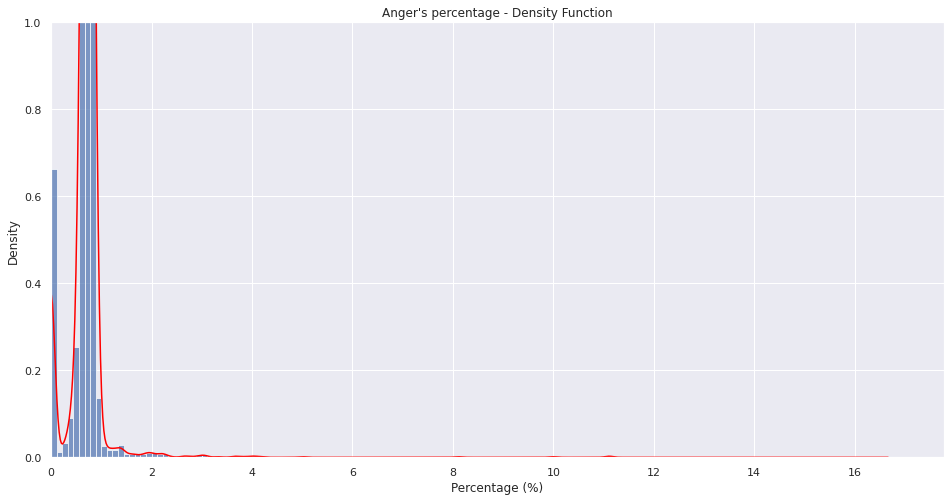

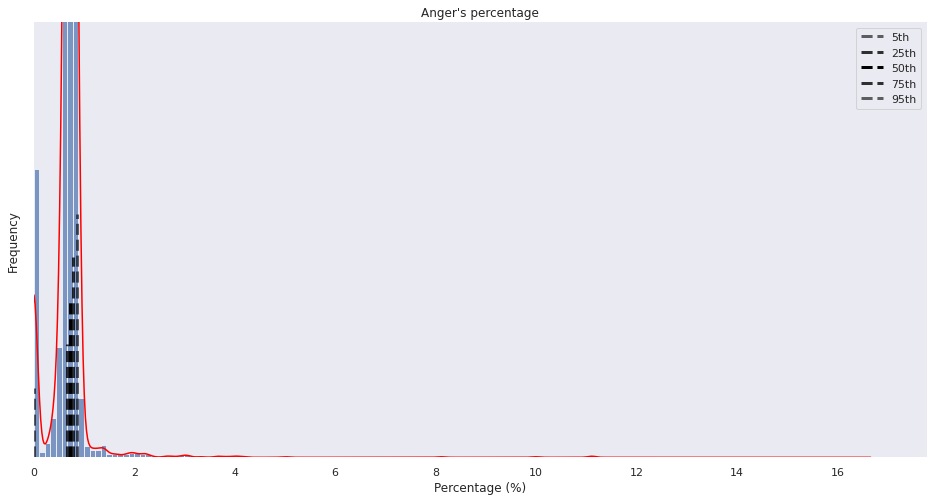

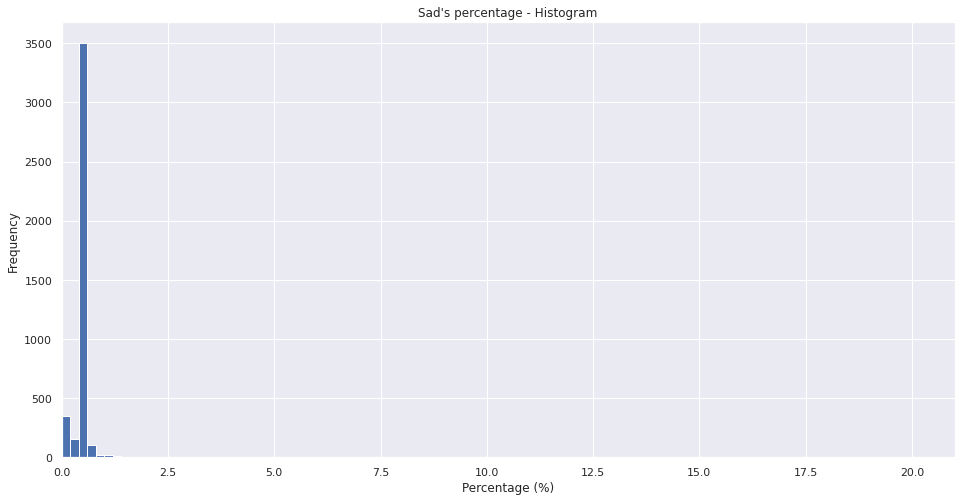

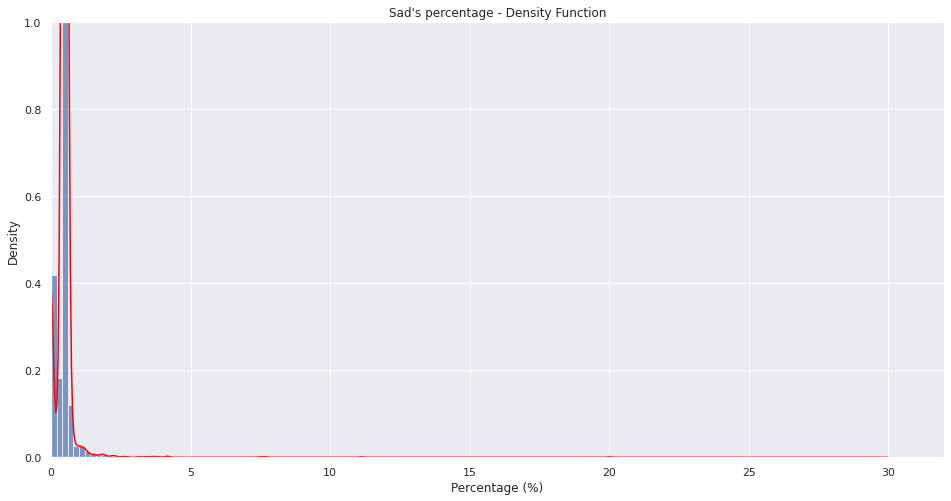

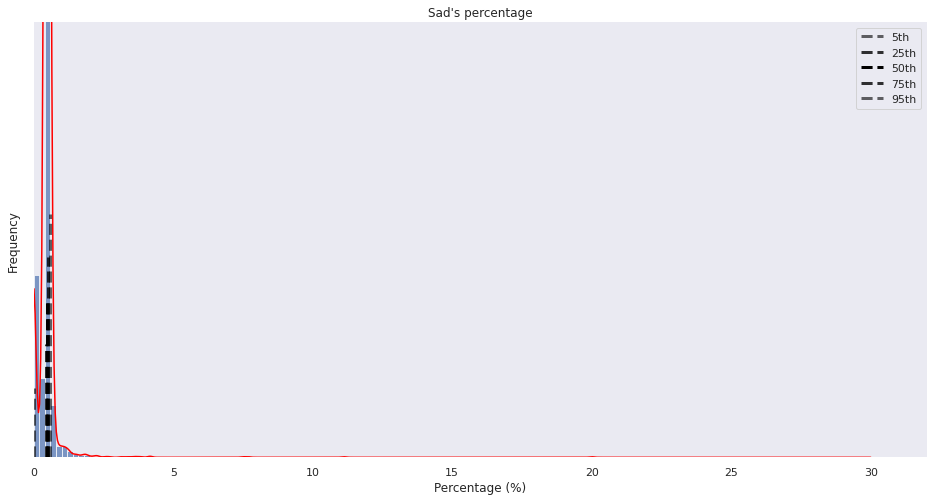

In [223]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plot_histogram_density_function(daily_stats["marvel"][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 1, 100)

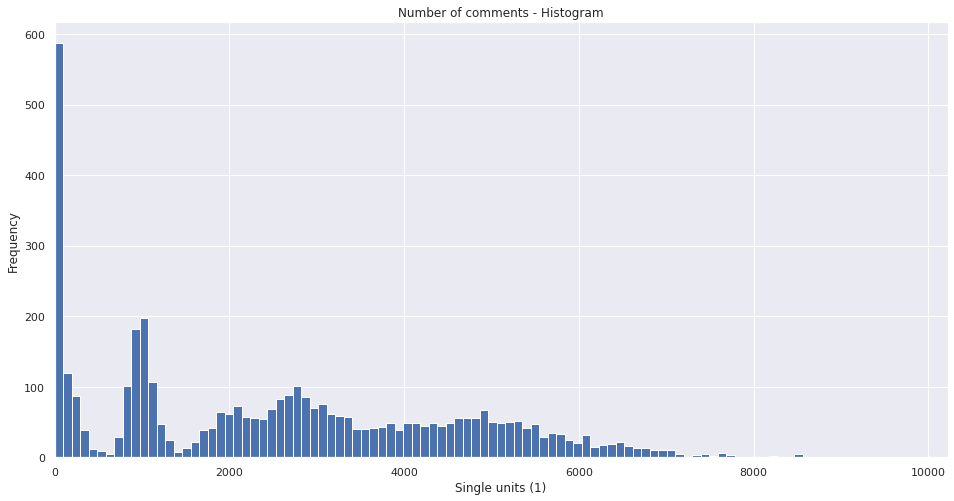

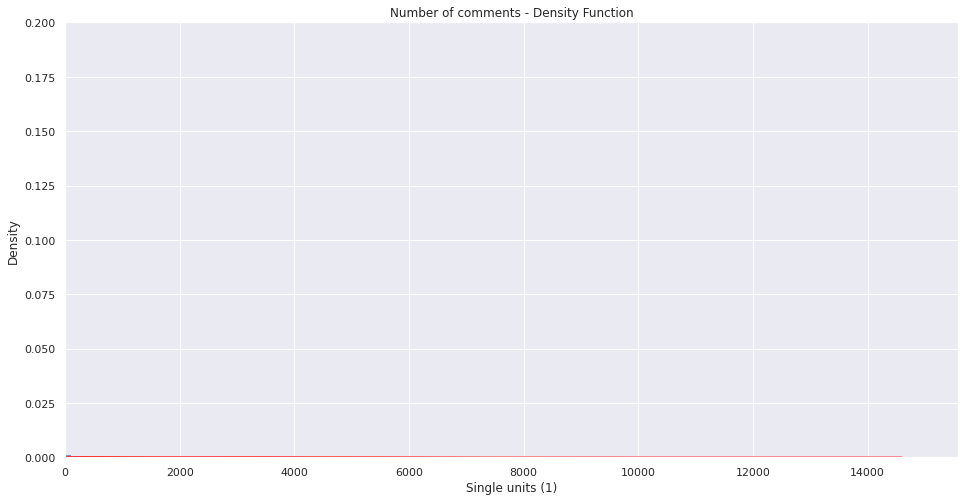

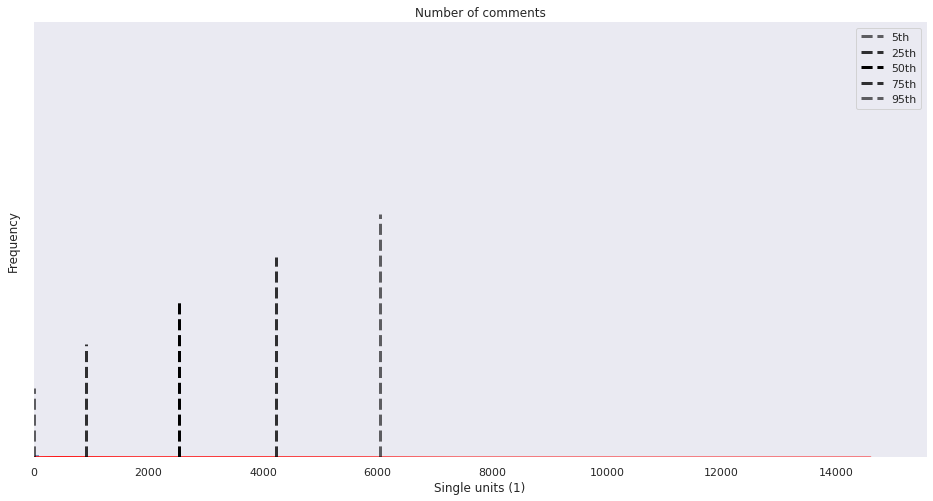

In [224]:
plot_histogram_density_function(daily_stats["marvel"]['ncomments'], ["Number of comments - Histogram", "Number of comments - Density Function", "Number of comments"], "Single units (1)", 0.20, 100)

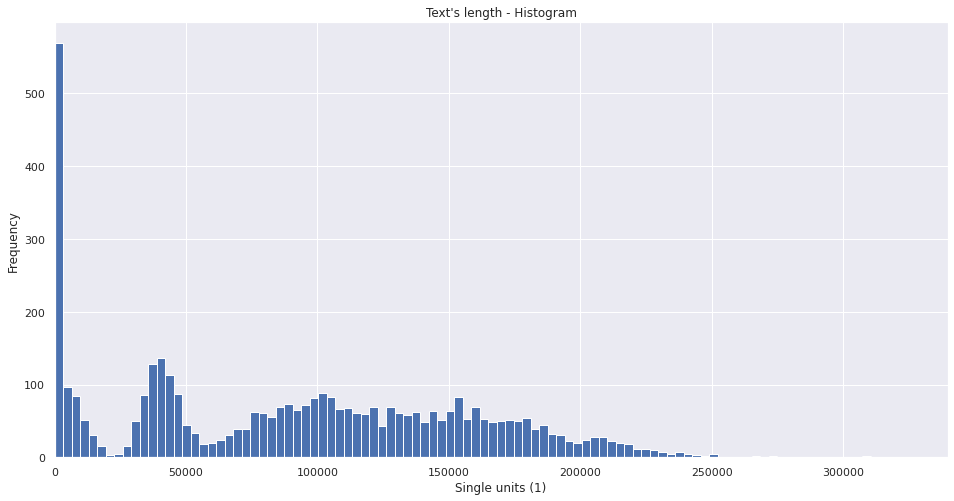

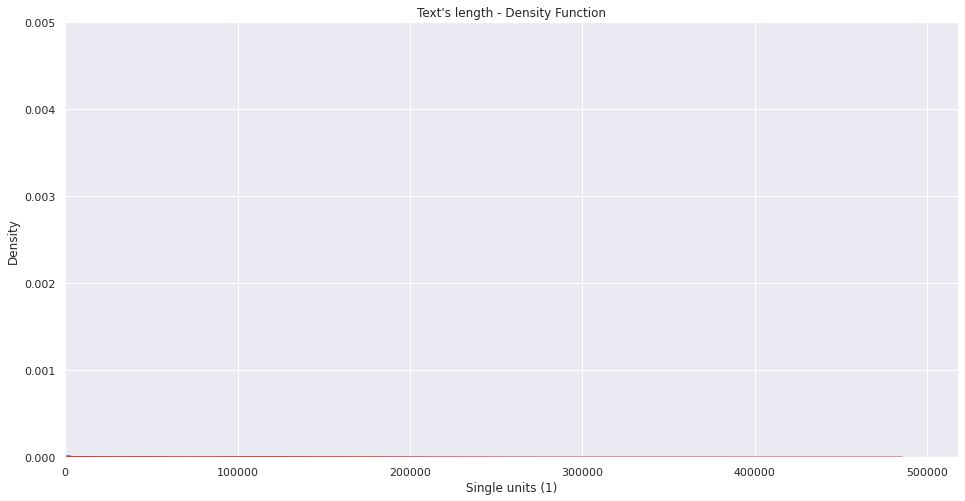

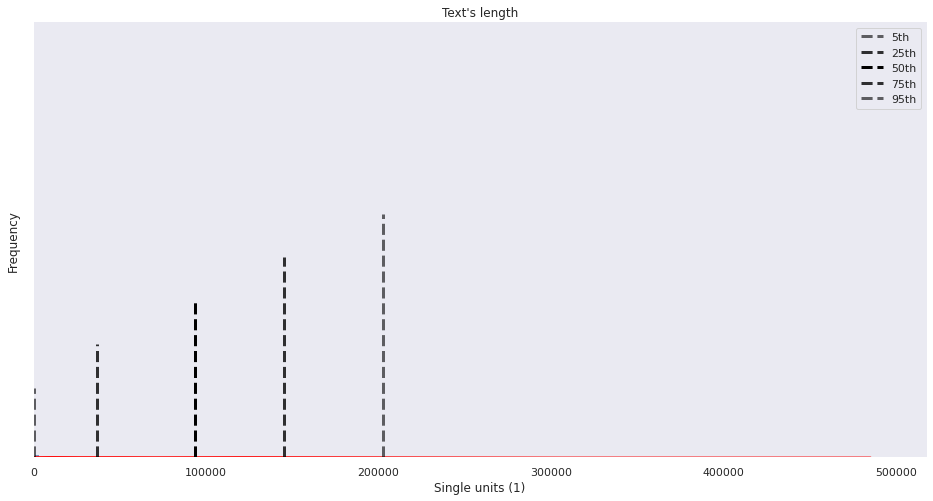

In [225]:
plot_histogram_density_function(daily_stats["marvel"]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.005, 100)

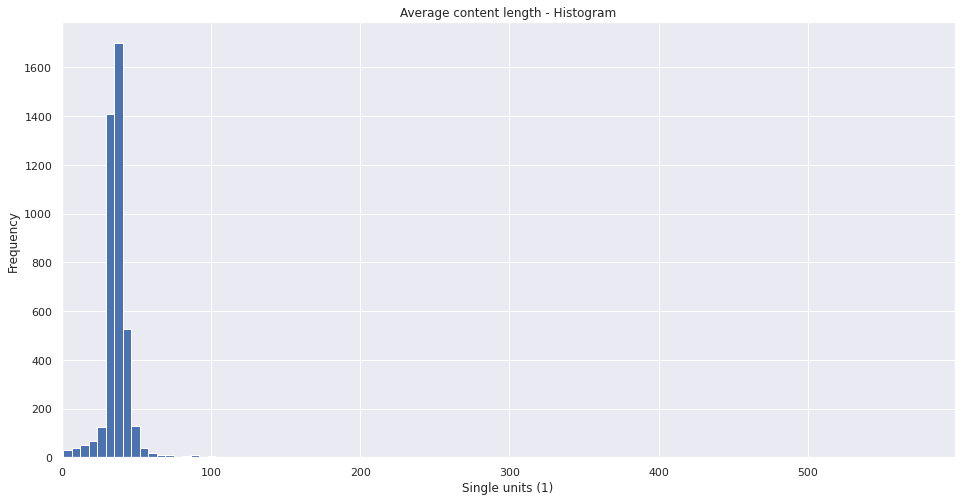

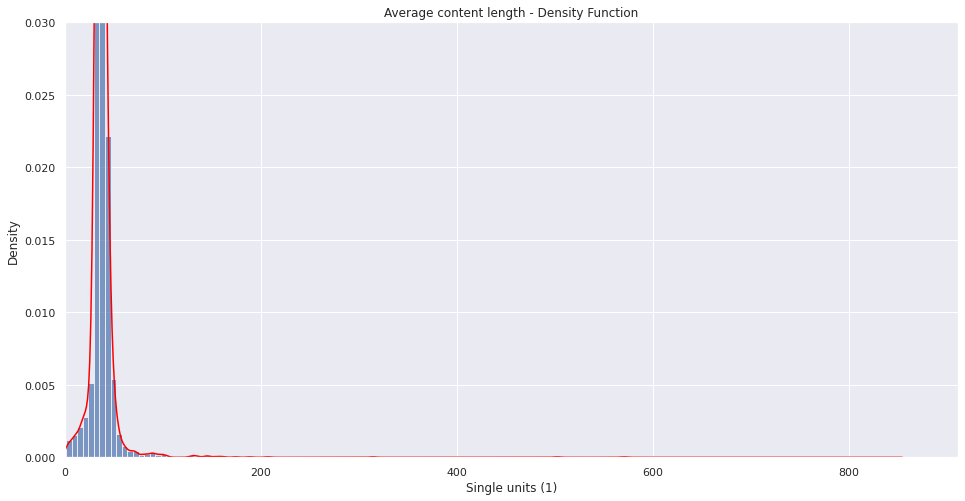

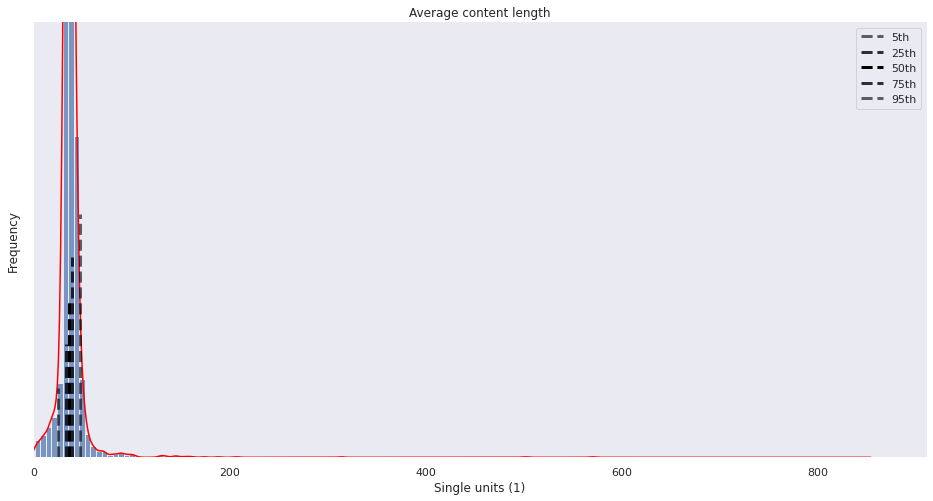

In [226]:
plot_histogram_density_function(daily_stats["marvel"]['average_content_length'], ["Average content length - Histogram", "Average content length - Density Function", "Average content length"], "Single units (1)", 0.03, 100)

Let's aggregate by month.

In [227]:
monthly_stats["marvel"].describe()

,text_length,ncomments,average_content_length,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear,Feel
count,1.650000e+02,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000,165.000000
mean,2.336896e+06,66343.151515,36.376303,7.984424,2.153636,0.298424,0.647515,0.596364,10.667273,5.457758,1.832848,0.183030,0.714424,2.481939,6.816606,1.622848,0.579758,0.812485,0.583576,0.658242
std,2.099752e+06,62984.268090,8.669825,3.231087,1.533195,0.176411,0.271622,1.572019,2.079582,1.719116,0.980101,0.137293,0.282449,1.065545,1.800640,0.583247,0.905842,0.439881,1.040114,0.381592
min,5.000000e+00,1.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.852000e+03,223.000000,33.090000,7.140000,2.080000,0.300000,0.640000,0.470000,10.500000,5.200000,1.730000,0.170000,0.720000,2.340000,6.570000,1.670000,0.390000,0.840000,0.480000,0.640000
50%,2.243744e+06,58068.000000,36.460000,7.400000,2.190000,0.310000,0.710000,0.480000,10.760000,5.330000,1.940000,0.200000,0.810000,2.460000,6.640000,1.790000,0.560000,0.880000,0.490000,0.660000
75%,4.079182e+06,119682.000000,39.420000,7.760000,2.250000,0.320000,0.760000,0.500000,10.970000,5.440000,2.040000,0.220000,0.840000,2.610000,6.720000,1.850000,0.620000,0.900000,0.500000,0.690000
max,7.657130e+06,238482.000000,91.960000,40.000000,20.000000,2.130000,2.270000,20.000000,22.220000,20.000000,11.540000,1.620000,2.130000,11.110000,20.000000,4.230000,11.540000,5.000000,12.500000,4.350000


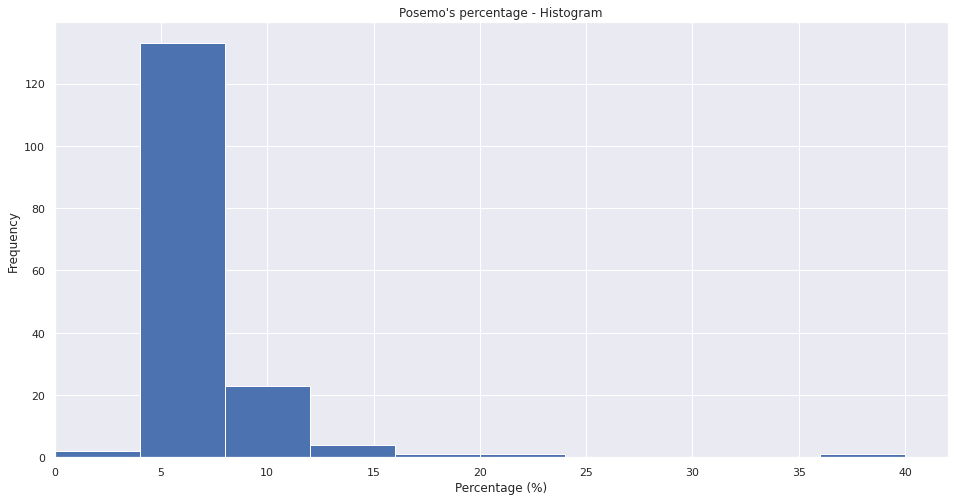

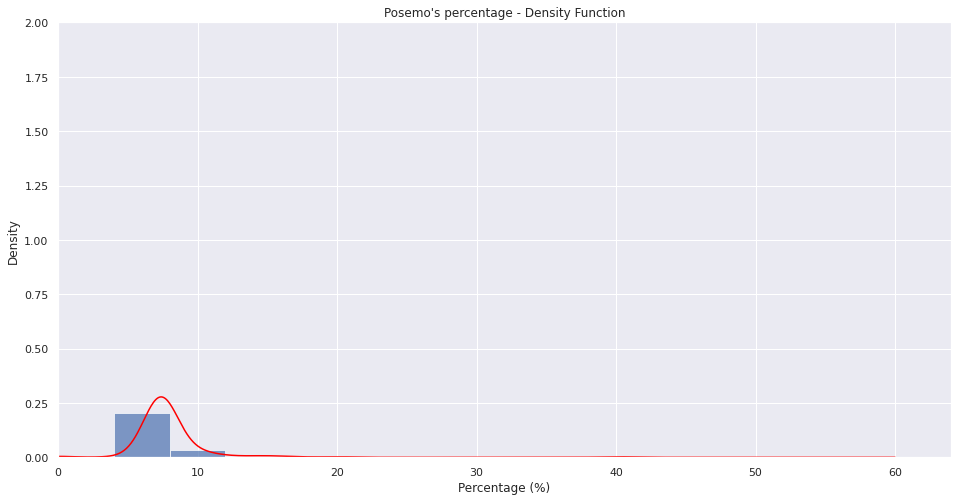

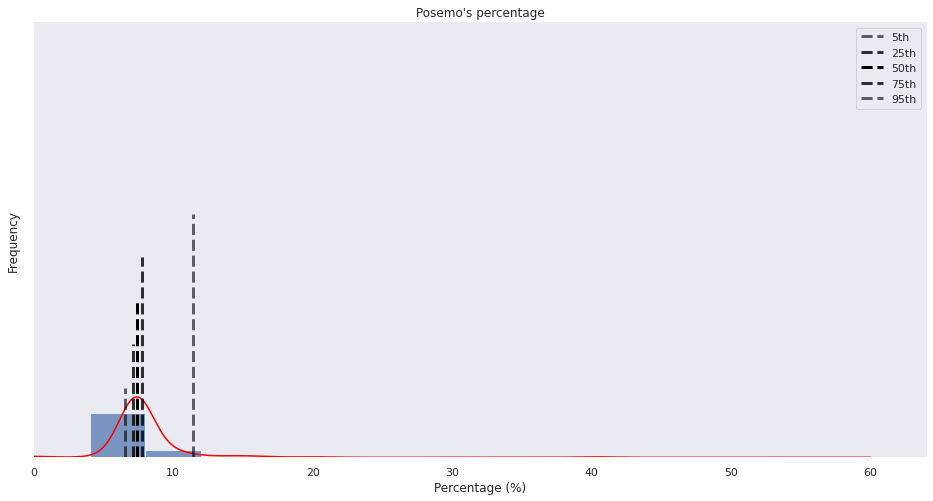

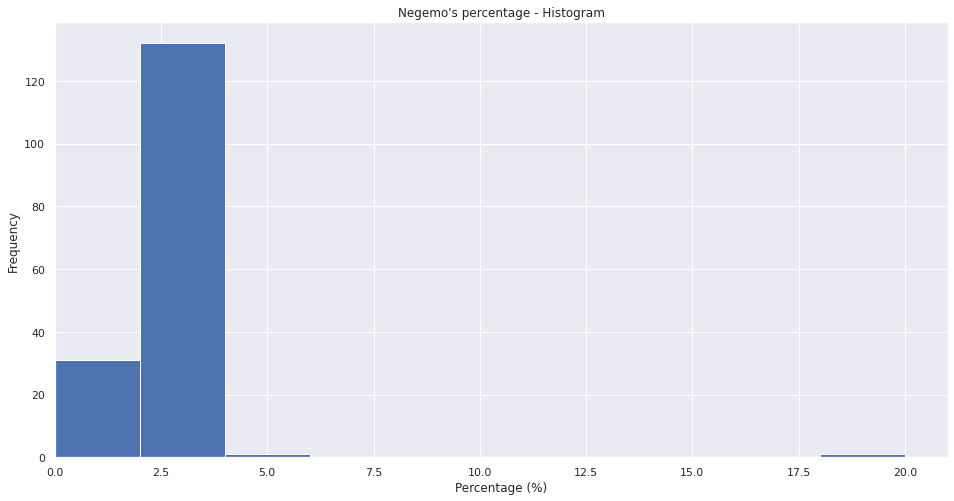

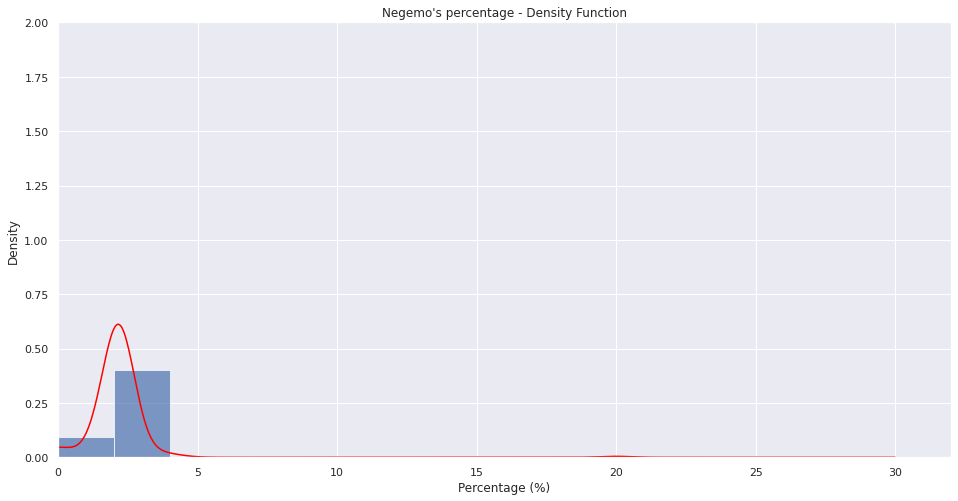

...

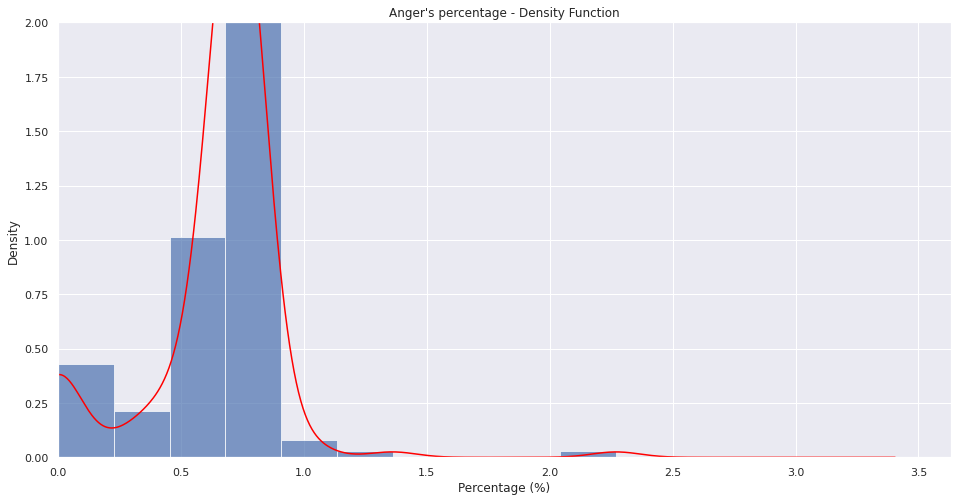

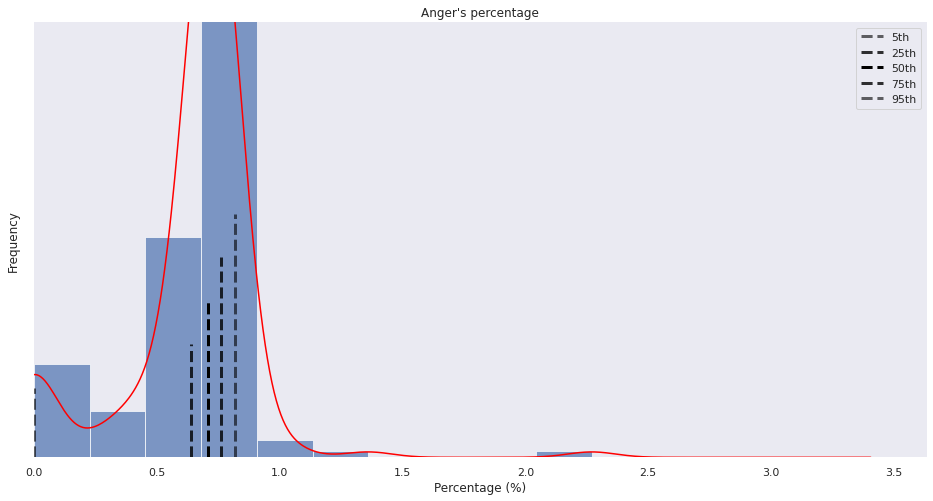

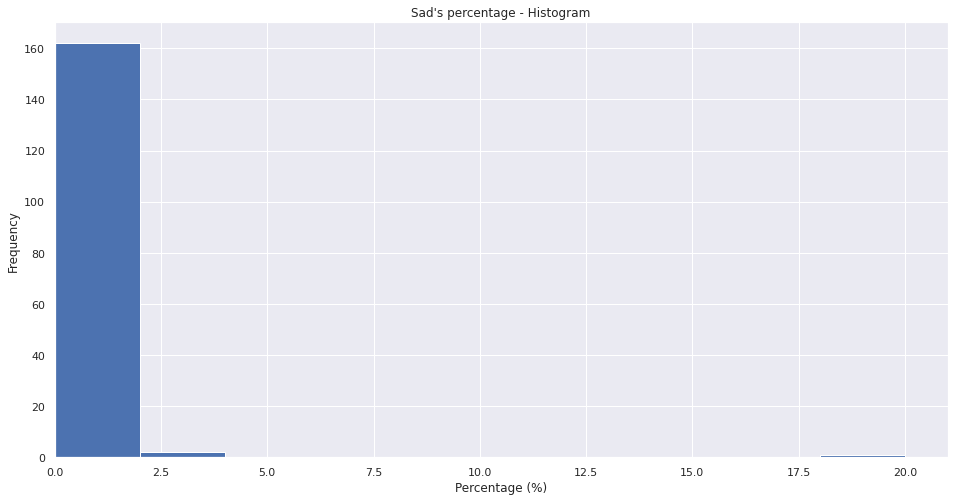

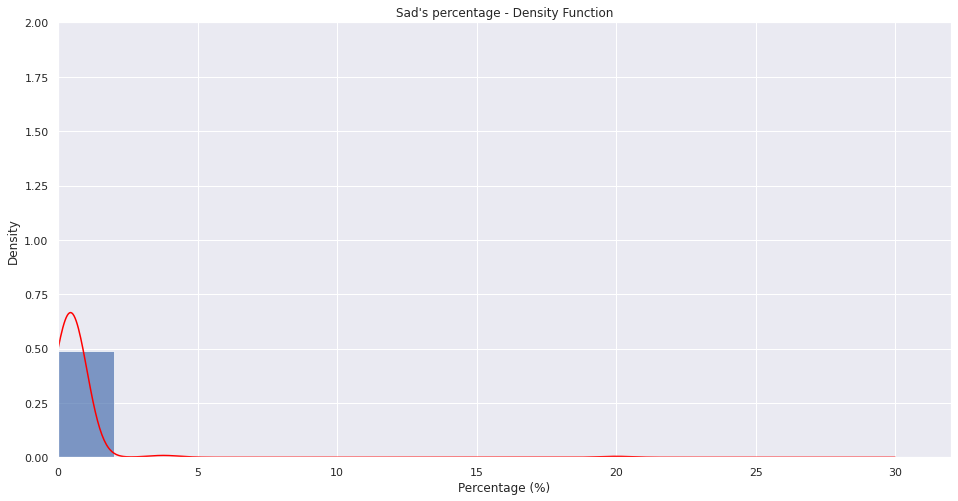

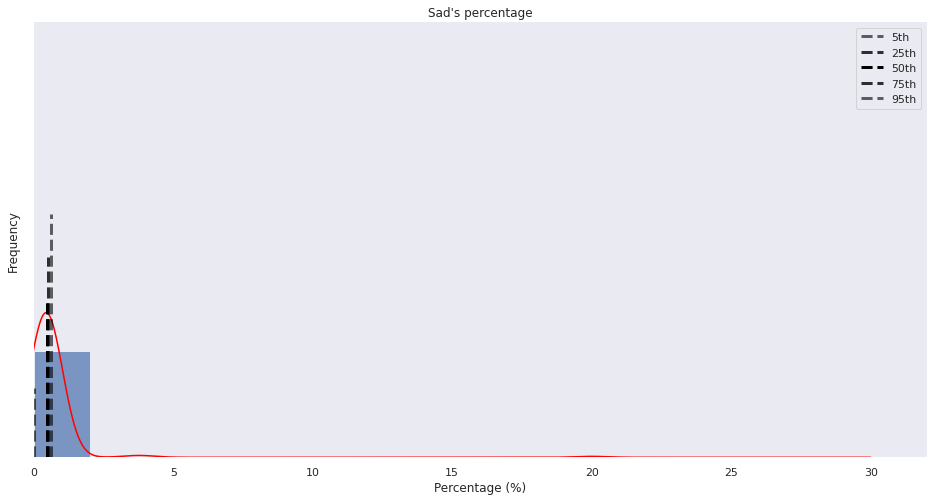

In [228]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plot_histogram_density_function(monthly_stats["marvel"][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 2, 10)

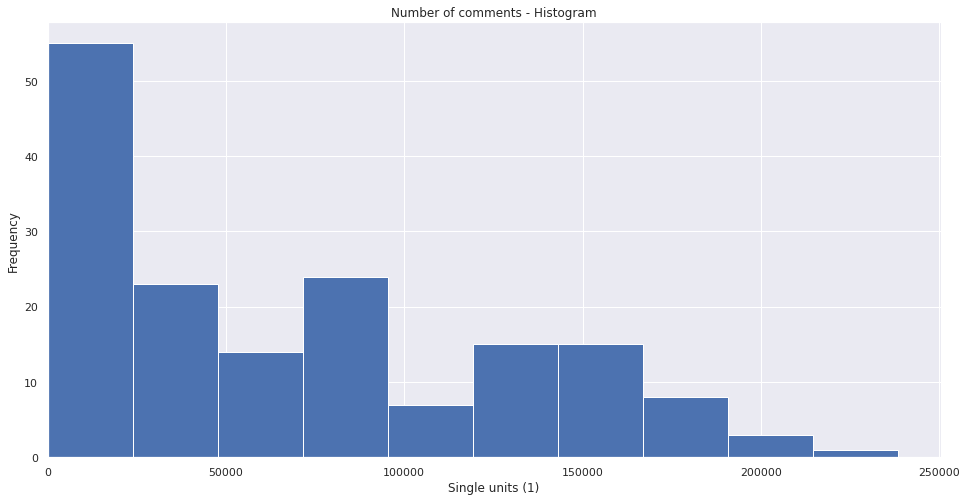

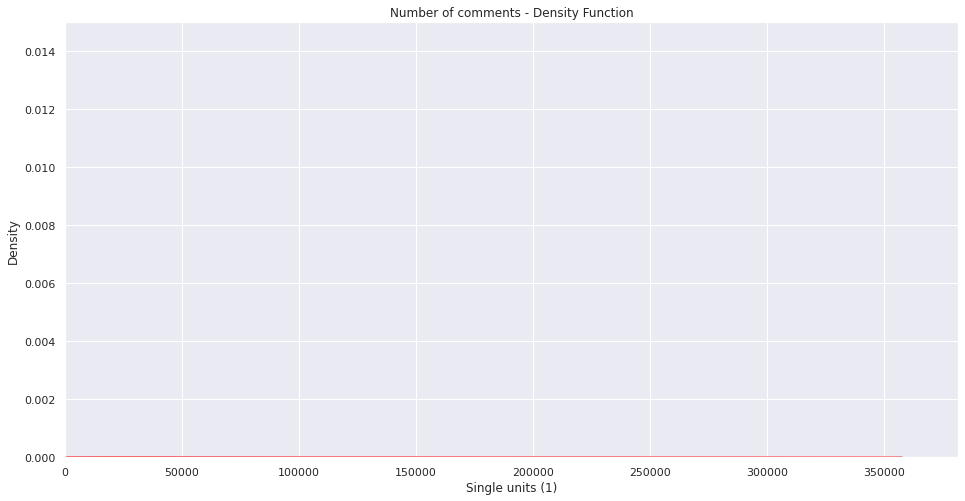

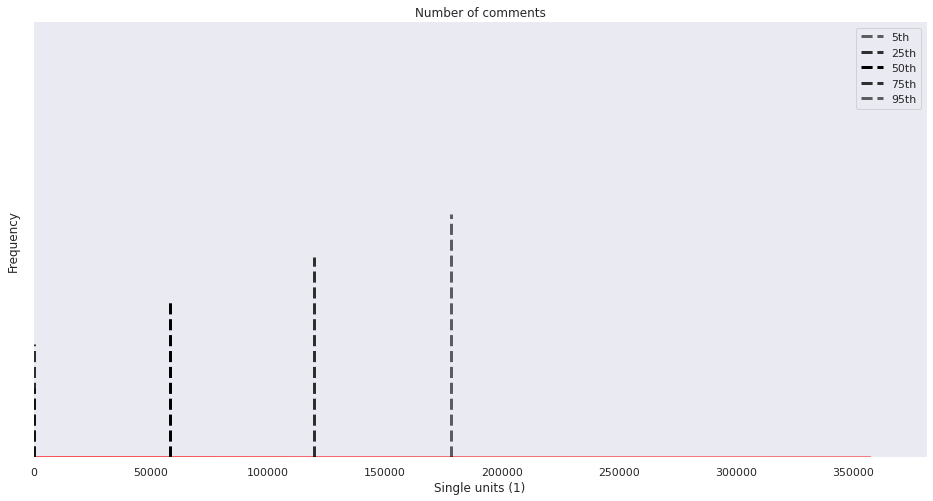

In [229]:
plot_histogram_density_function(monthly_stats["marvel"]['ncomments'], ["Number of comments - Histogram", "Number of comments - Density Function", "Number of comments"], "Single units (1)", 0.015, 10)

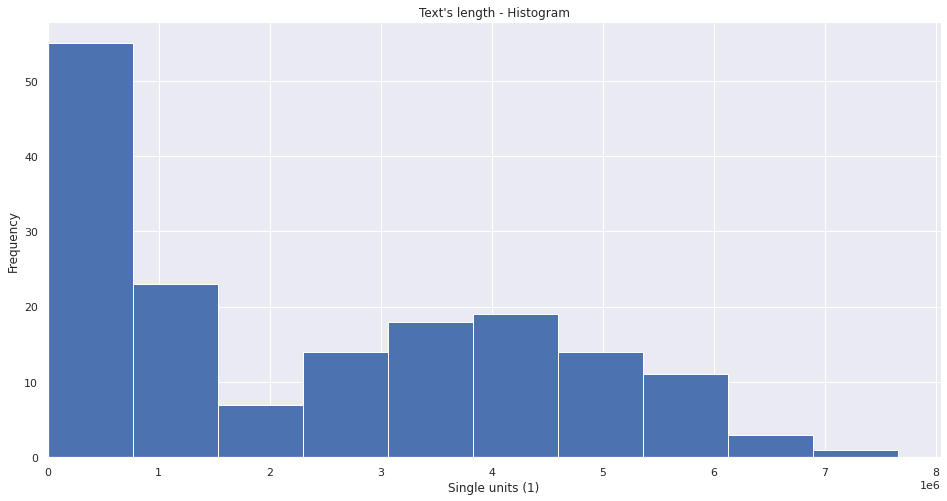

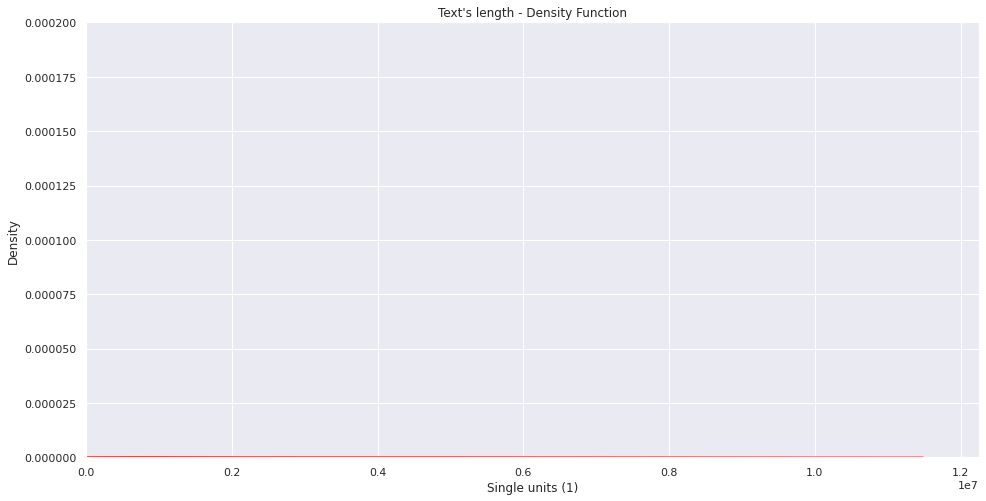

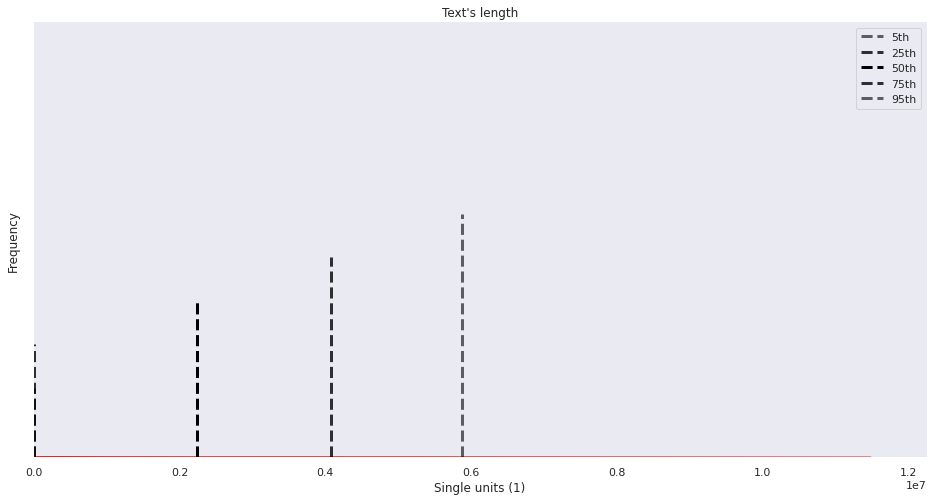

In [230]:
plot_histogram_density_function(monthly_stats["marvel"]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.0002, 10)

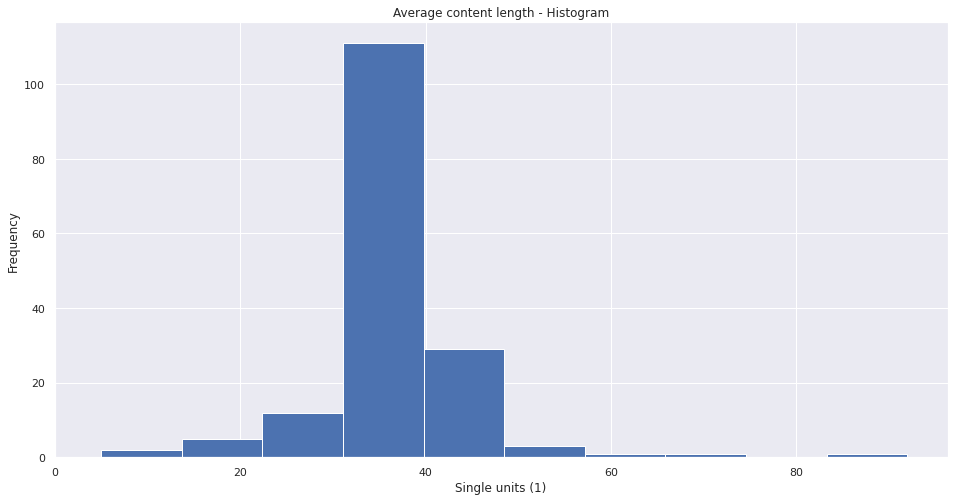

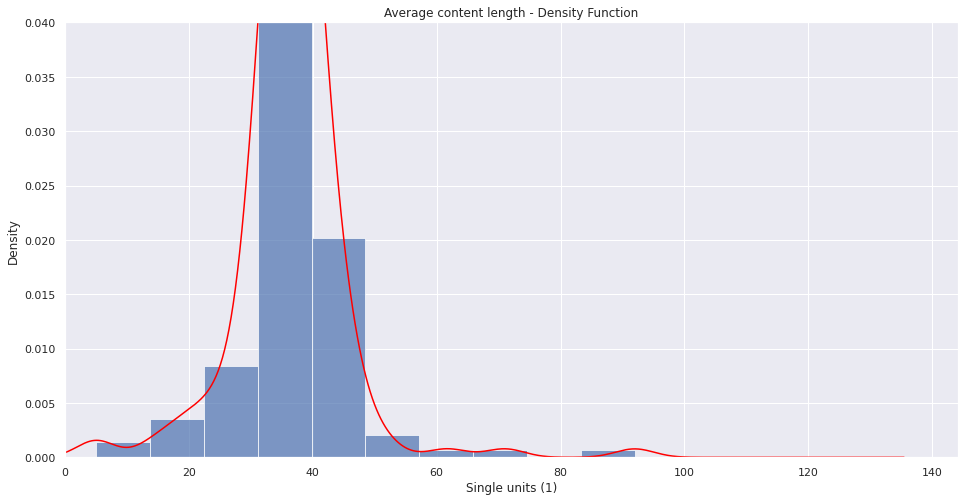

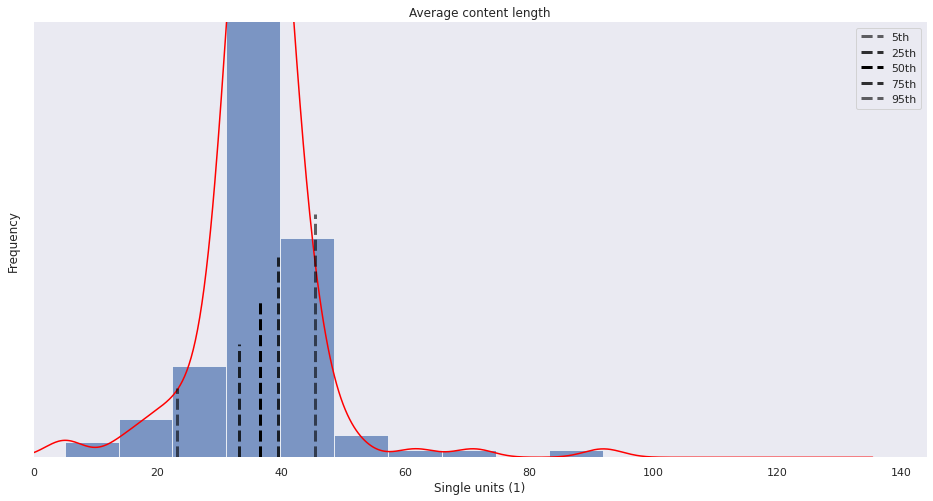

In [231]:
plot_histogram_density_function(monthly_stats["marvel"]['average_content_length'], ["Average content length - Histogram", "Average content length - Density Function", "Average content length"], "Single units (1)", 0.04, 10)

Let's aggregate by comment.

In [232]:
community_by_comment["marvel"].describe()

,work_id,text_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear,Feel
count,1.094662e+07,1.094662e+07,10946620.0,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07,1.094662e+07
mean,1.282180e+07,3.522437e+01,1.0,1.341205e+01,2.165104e+00,2.326496e-01,7.303048e-01,5.465058e-01,1.160868e+01,5.405349e+00,1.081848e+00,1.829149e-01,6.019841e-01,4.349604e+00,6.666557e+00,1.105645e+00,3.516274e-01,8.300750e-01,4.260650e-01,6.346578e-01
std,8.781423e+06,6.177077e+01,0.0,1.577686e+01,5.339509e+00,1.313662e+00,3.188588e+00,2.818809e+00,9.901449e+00,6.064375e+00,2.878449e+00,1.182340e+00,2.097097e+00,8.627835e+00,7.064296e+00,3.127638e+00,1.717806e+00,3.352456e+00,2.130799e+00,2.815303e+00
min,3.260000e+02,0.000000e+00,1.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,4.632426e+06,8.000000e+00,1.0,3.880000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.260000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.296845e+07,1.800000e+01,1.0,8.970000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.057000e+01,4.400000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.830000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,1.915132e+07,3.900000e+01,1.0,1.667000e+01,2.630000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.579000e+01,8.570000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000e+00,1.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,3.166600e+07,4.996000e+03,1.0,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02


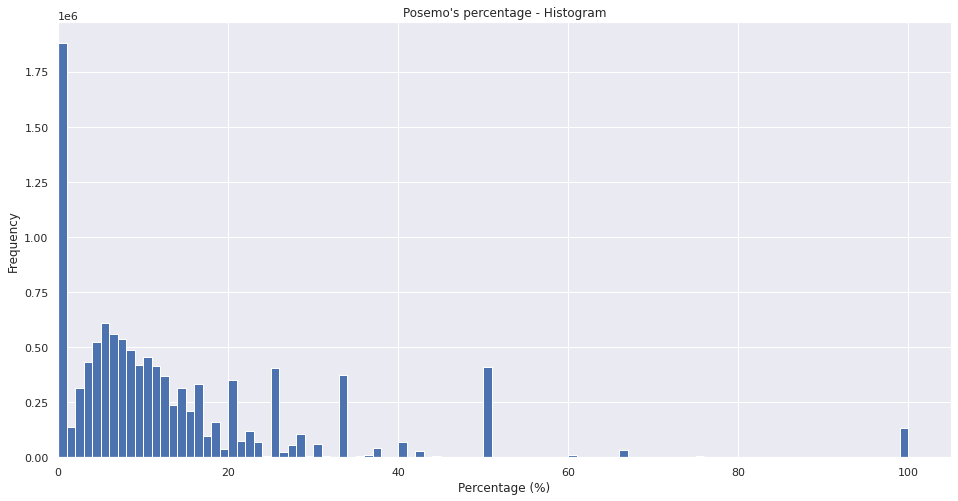

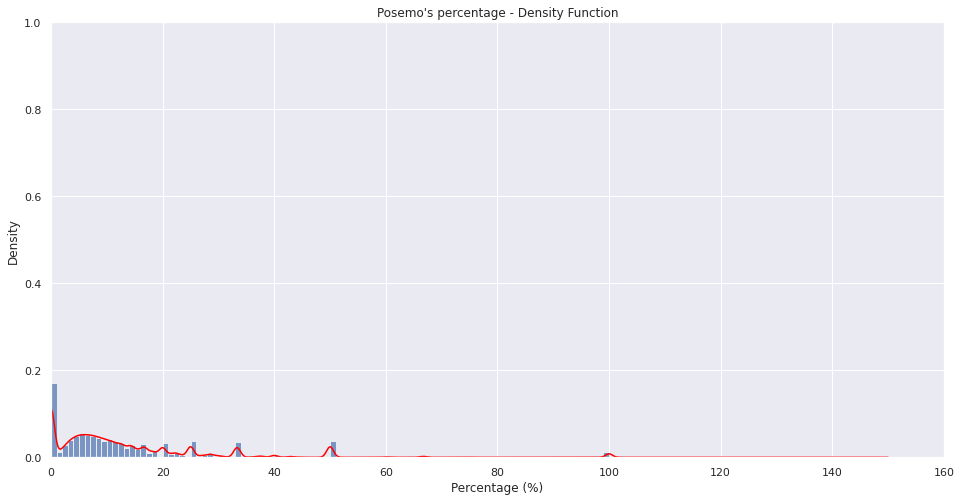

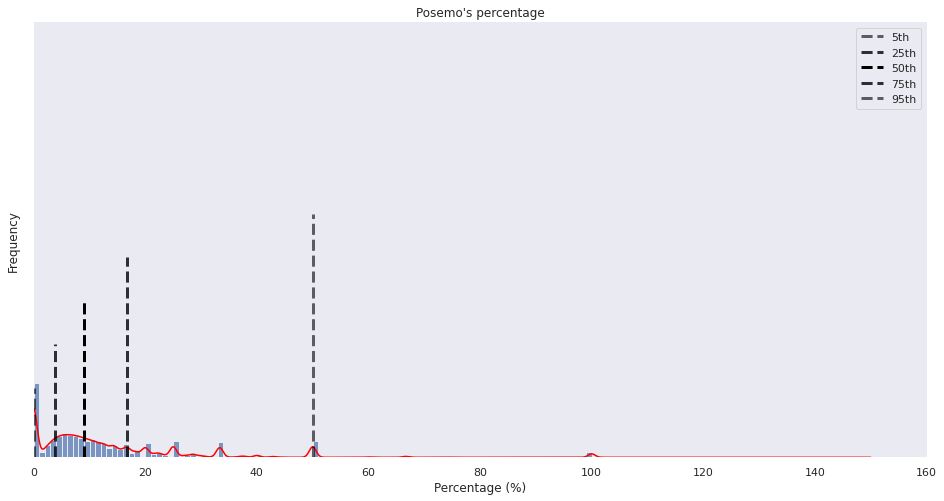

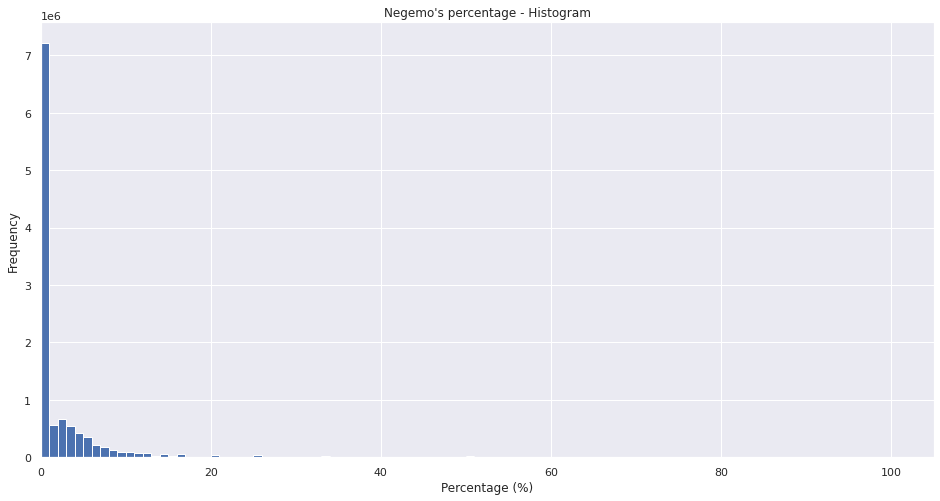

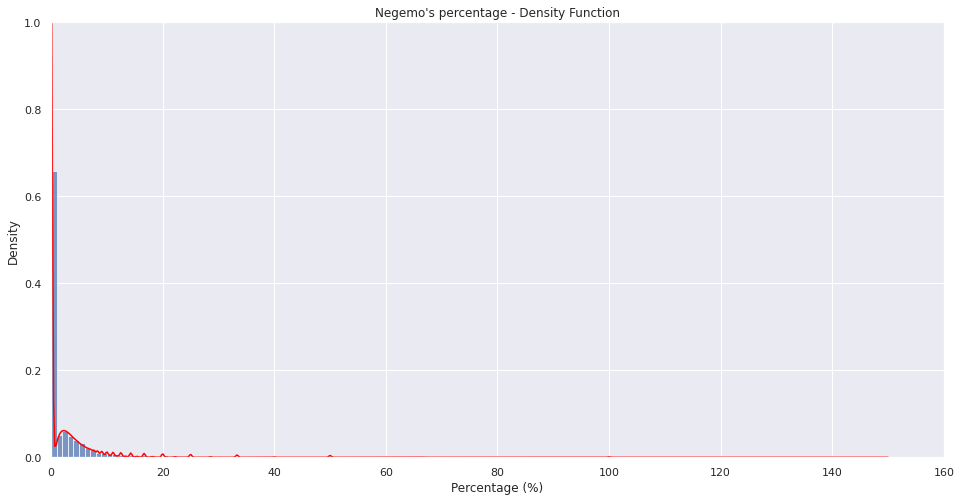

...

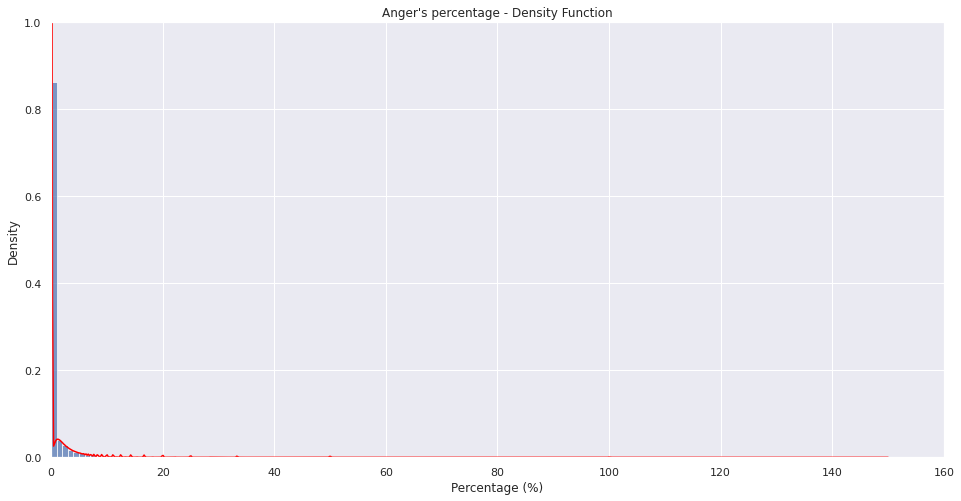

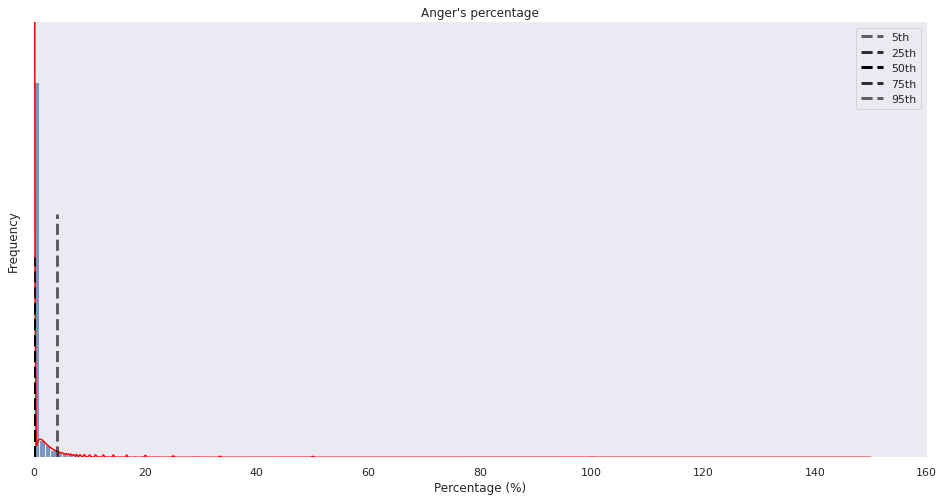

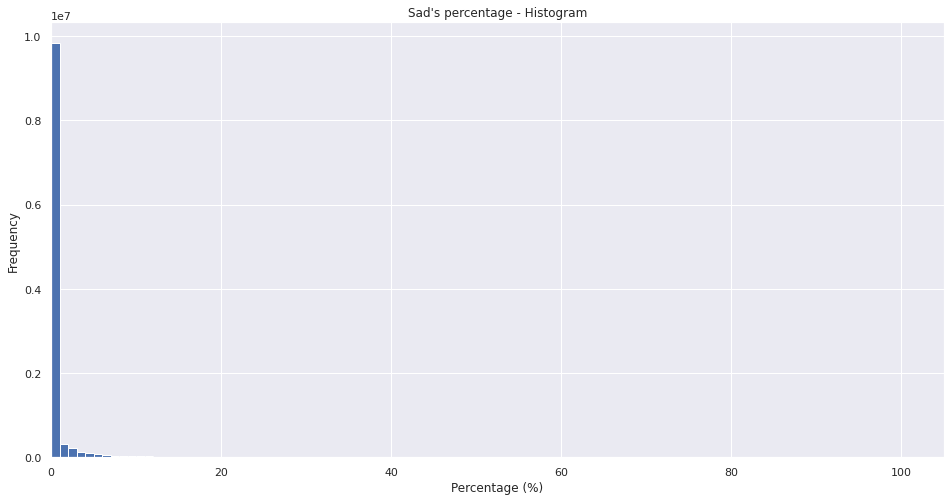

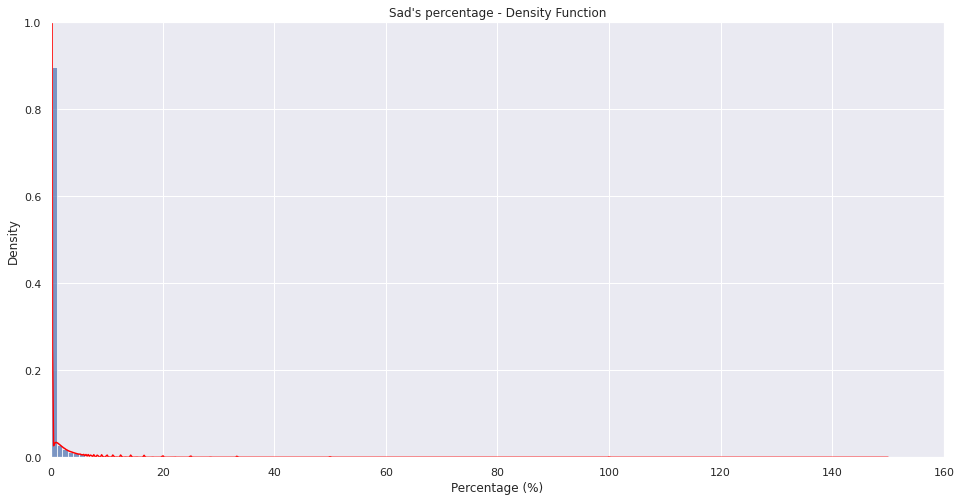

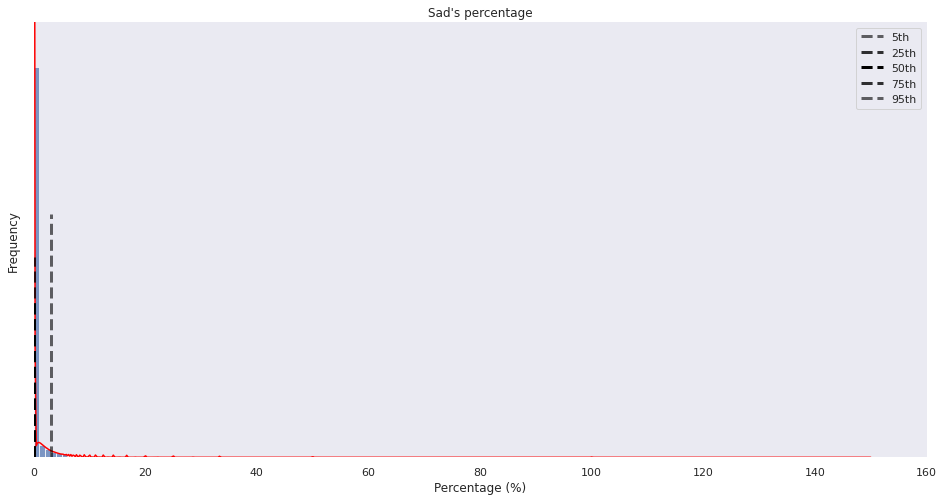

In [233]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plot_histogram_density_function(community_by_comment["marvel"][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 1, 100)

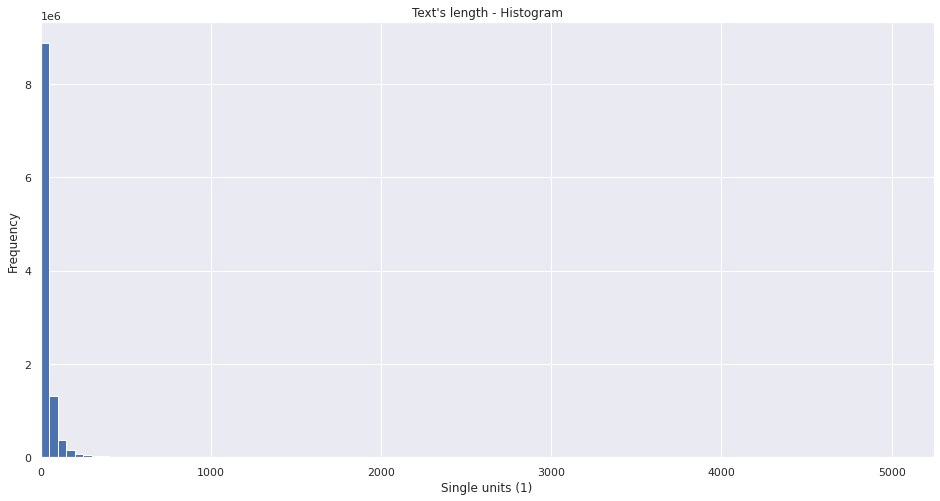

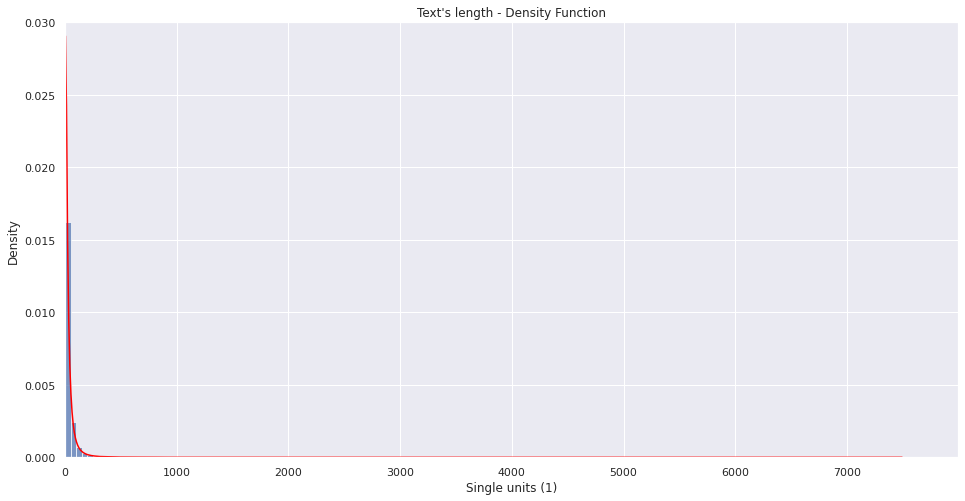

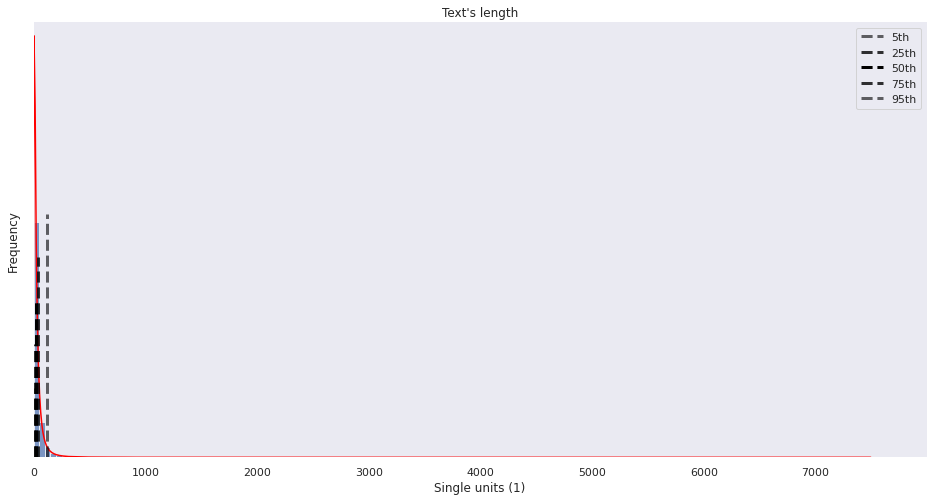

In [234]:
plot_histogram_density_function(community_by_comment["marvel"]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.03, 100)

Let's aggregate by work.

In [235]:
community_by_work["marvel"].describe()

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
count,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000
mean,289.297745,1306.315623,29.311891,37.085564,10.259524,1.989207,0.242807,0.633911,0.526219,11.136571,5.718923,1.355299,0.188133,0.740906,3.141807,7.095463,1.274124,0.458778,0.907599,0.444397
std,3303.126352,5584.846729,28.003725,124.318358,6.528296,2.142790,0.458226,1.188569,1.198444,3.774914,2.664819,1.534875,0.454762,1.009055,2.480024,3.067191,1.469479,0.963355,1.503176,0.748113
min,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.000000,113.000000,14.920000,6.000000,6.950000,0.900000,0.000000,0.000000,0.000000,9.660000,4.410000,0.000000,0.000000,0.000000,1.780000,5.880000,0.000000,0.000000,0.120000,0.000000
50%,14.000000,301.000000,23.050000,12.000000,9.140000,1.750000,0.050000,0.440000,0.260000,11.200000,5.680000,1.020000,0.000000,0.530000,2.770000,6.950000,0.960000,0.000000,0.750000,0.290000
75%,42.000000,843.000000,35.170000,28.000000,12.080000,2.610000,0.350000,0.880000,0.620000,12.830000,6.970000,2.050000,0.240000,1.050000,4.000000,8.200000,1.930000,0.530000,1.190000,0.610000
max,469948.000000,524143.000000,1339.000000,13197.000000,100.000000,100.000000,33.330000,100.000000,100.000000,66.670000,50.000000,50.000000,50.000000,50.000000,50.000000,100.000000,50.000000,50.000000,100.000000,50.000000


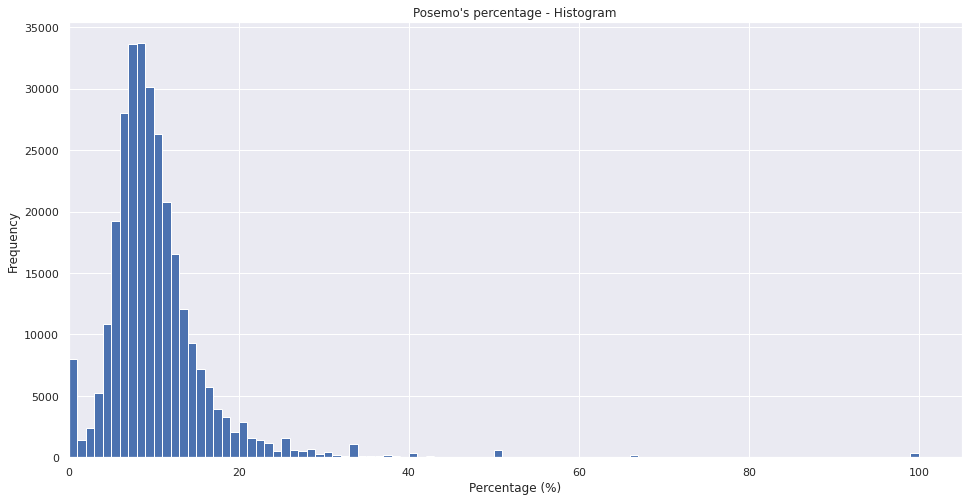

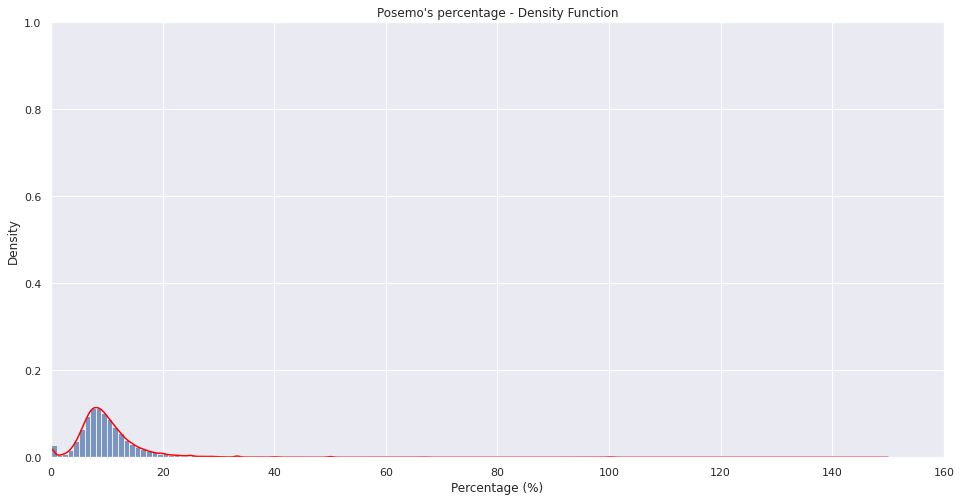

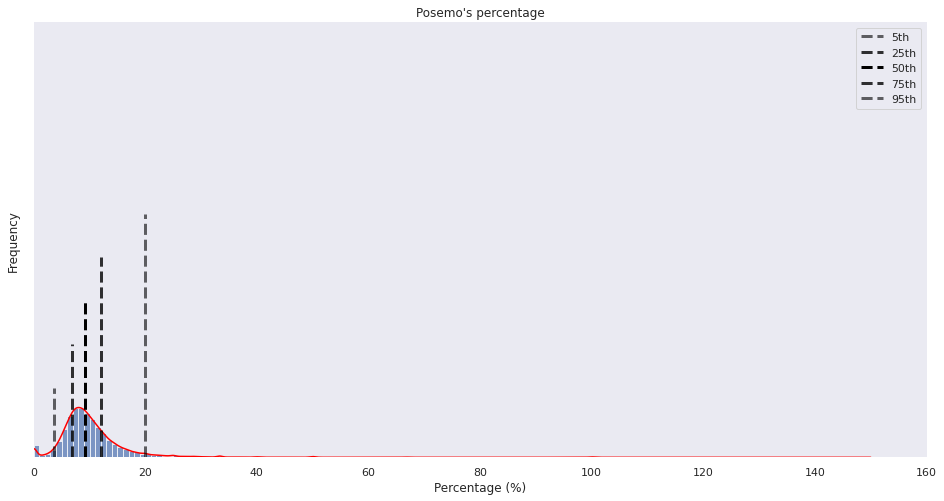

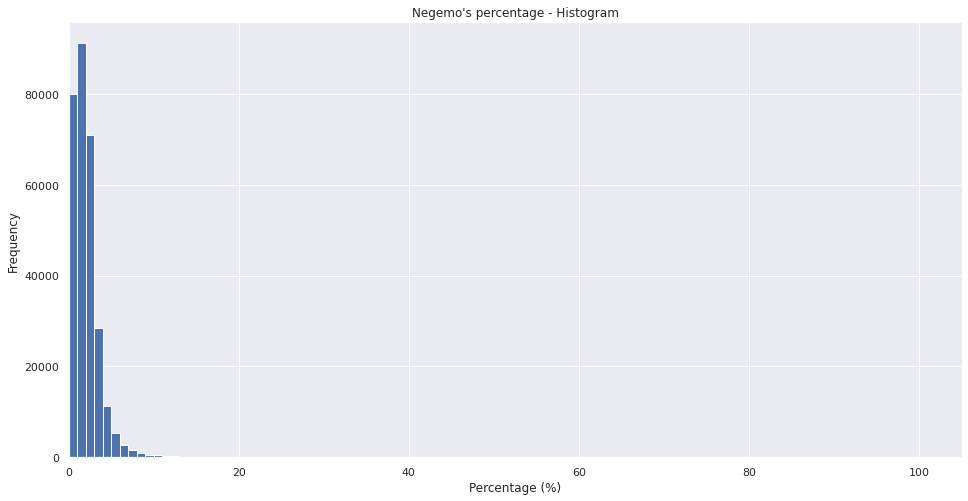

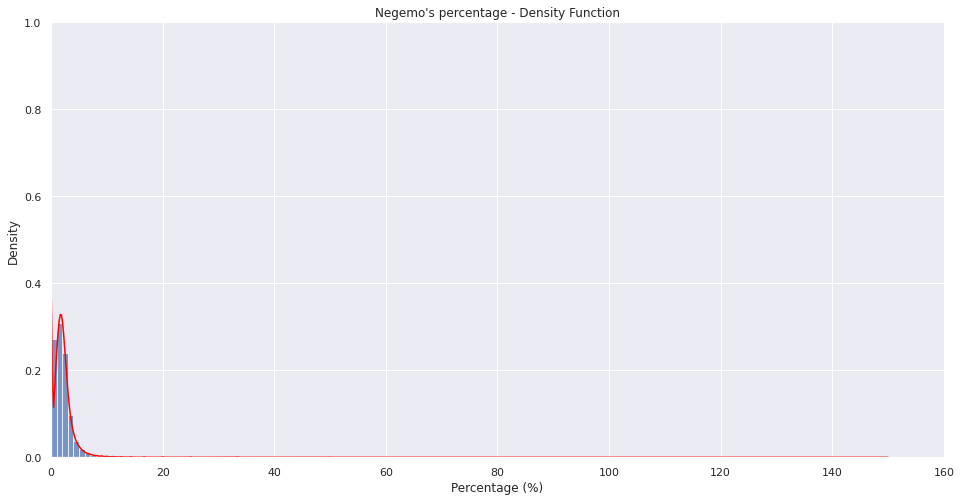

...

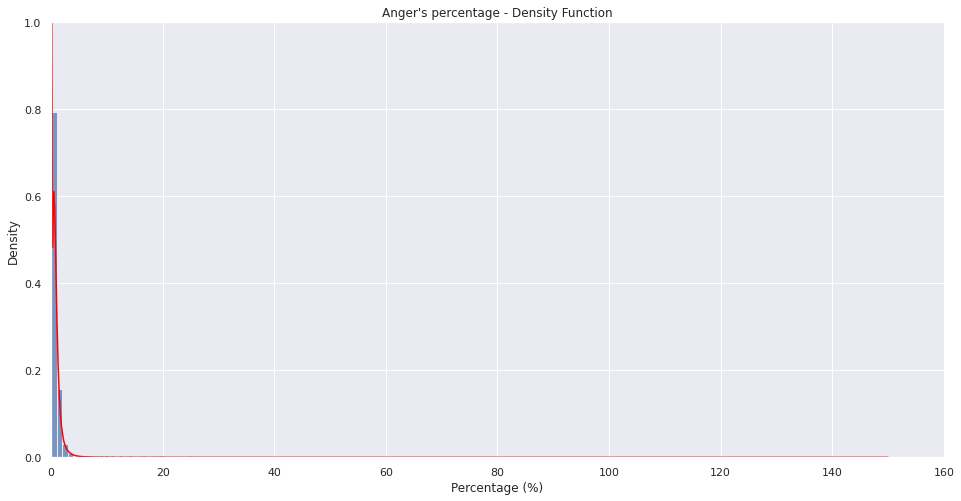

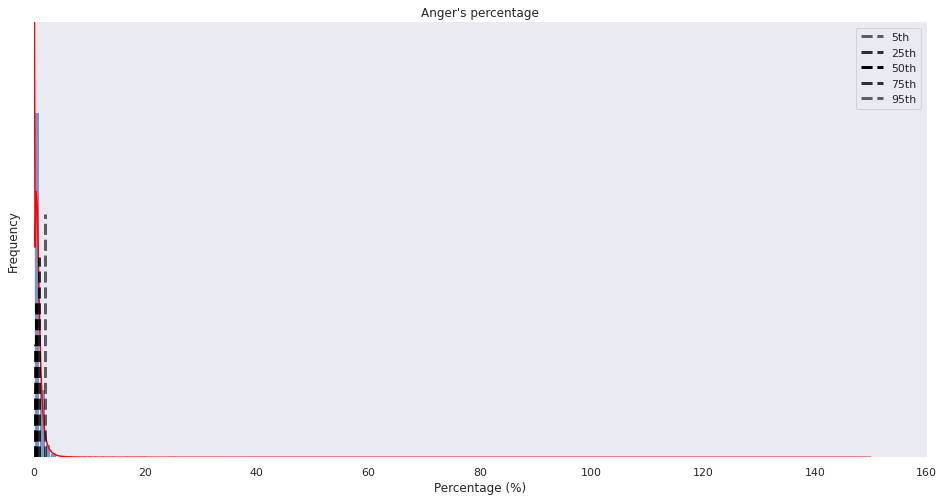

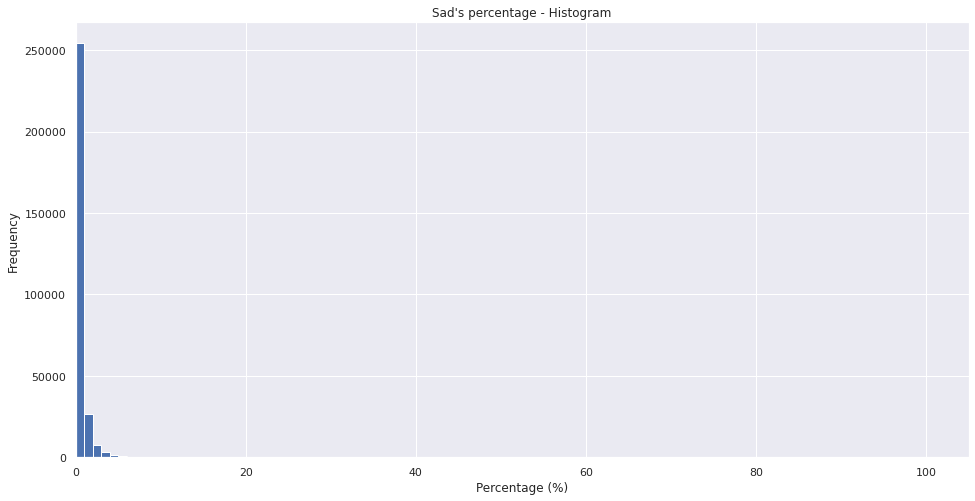

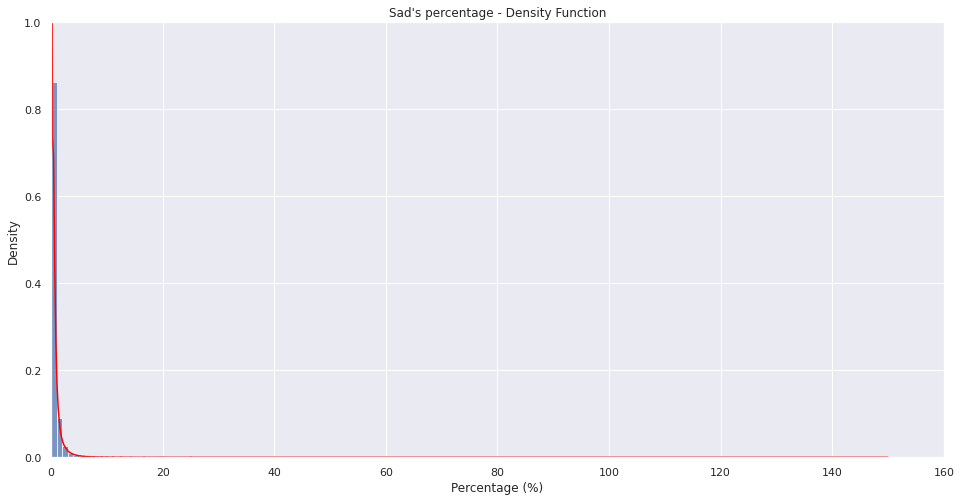

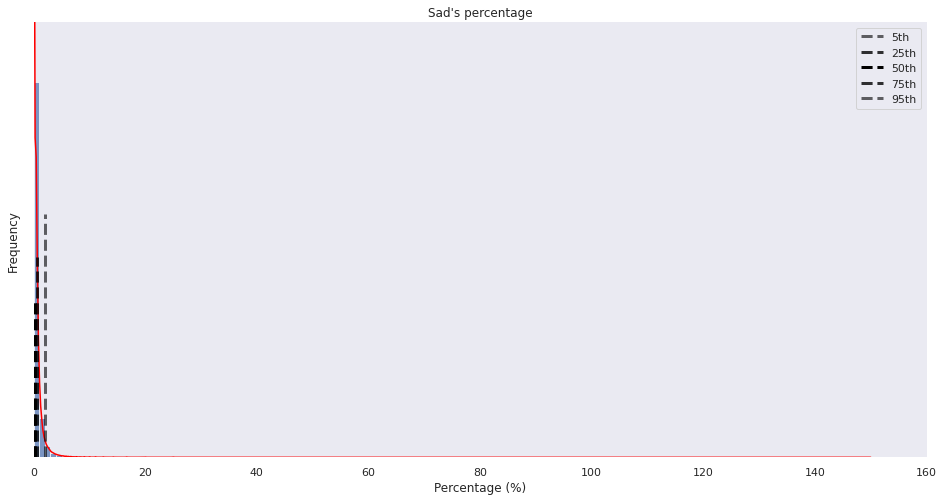

In [236]:
for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
    plot_histogram_density_function(community_by_work["marvel"][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 1, 100)

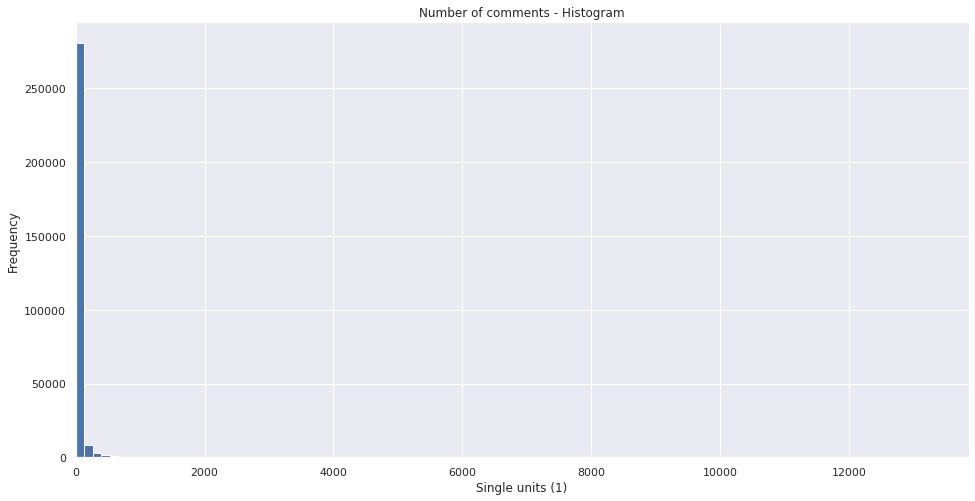

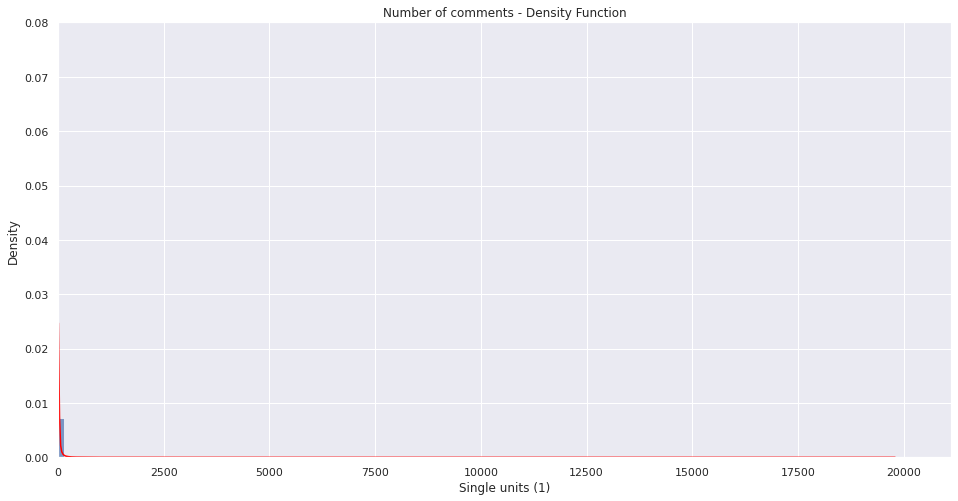

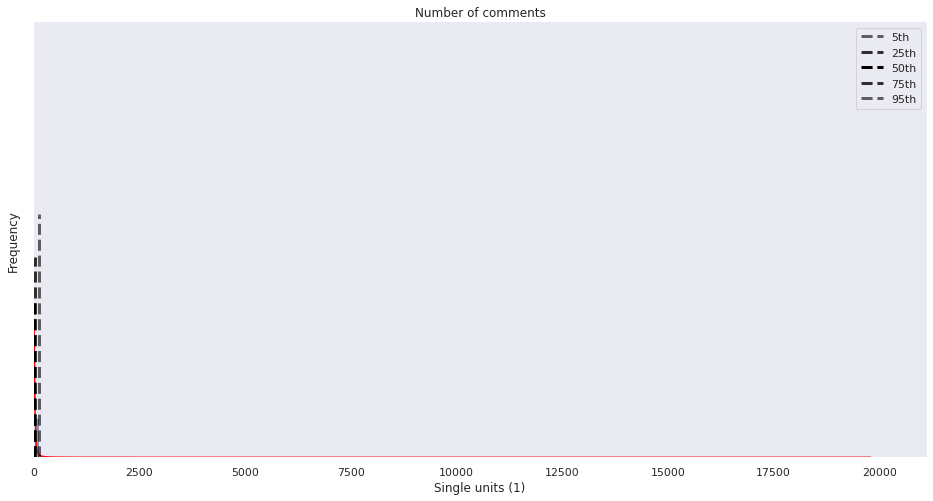

In [237]:
plot_histogram_density_function(community_by_work["marvel"]['ncomments'], ["Number of comments - Histogram", "Number of comments - Density Function", "Number of comments"], "Single units (1)", 0.08, 100)

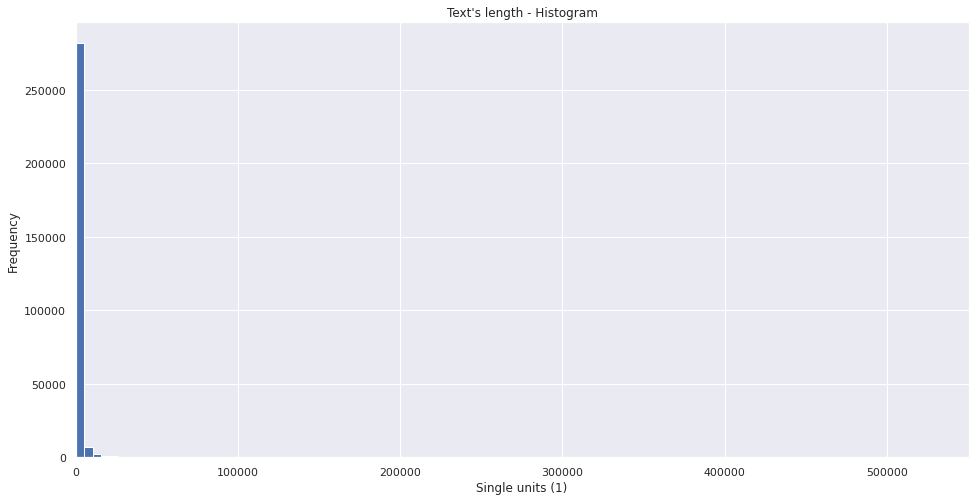

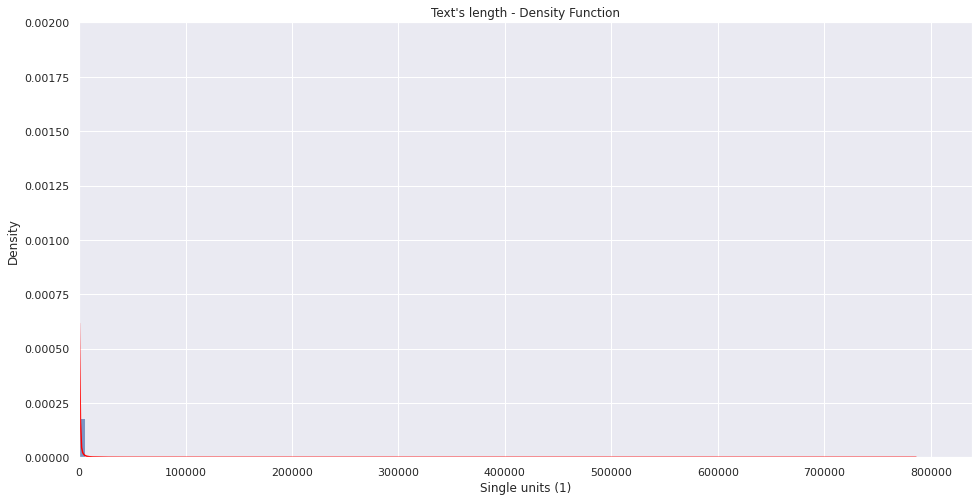

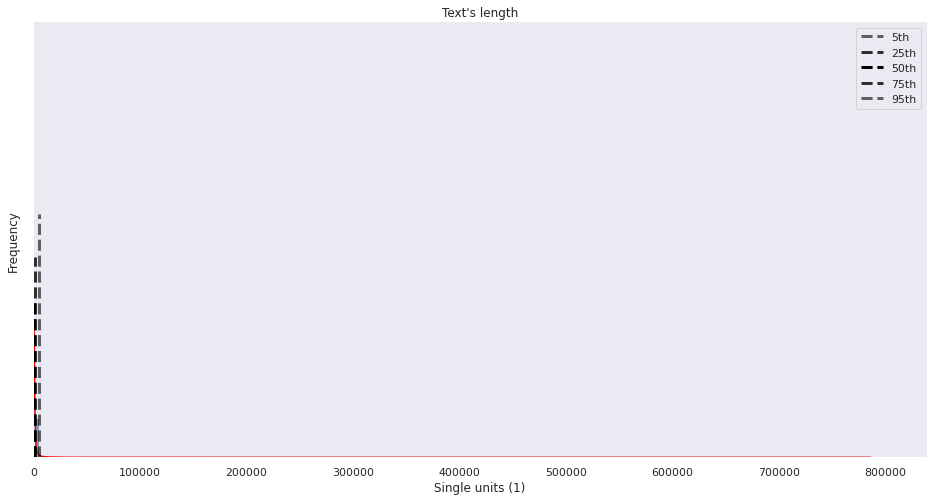

In [238]:
plot_histogram_density_function(community_by_work["marvel"]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.002, 100)

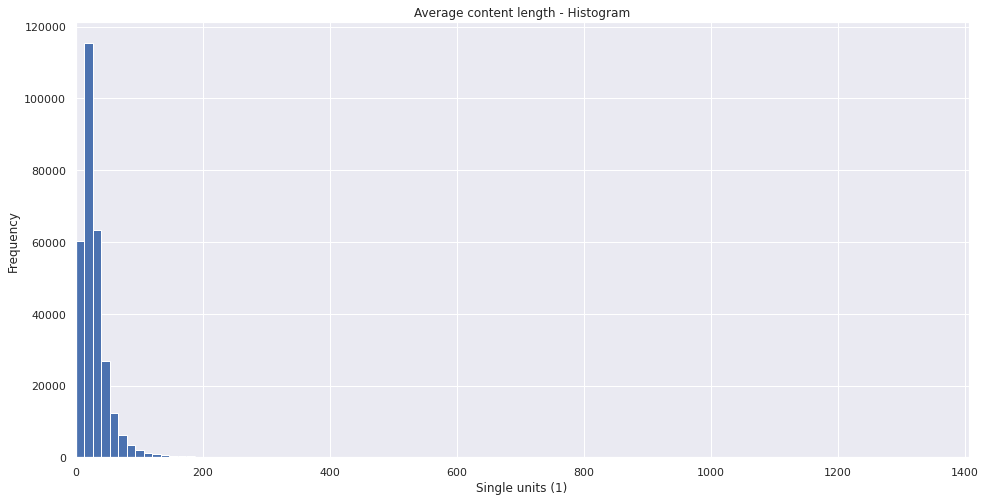

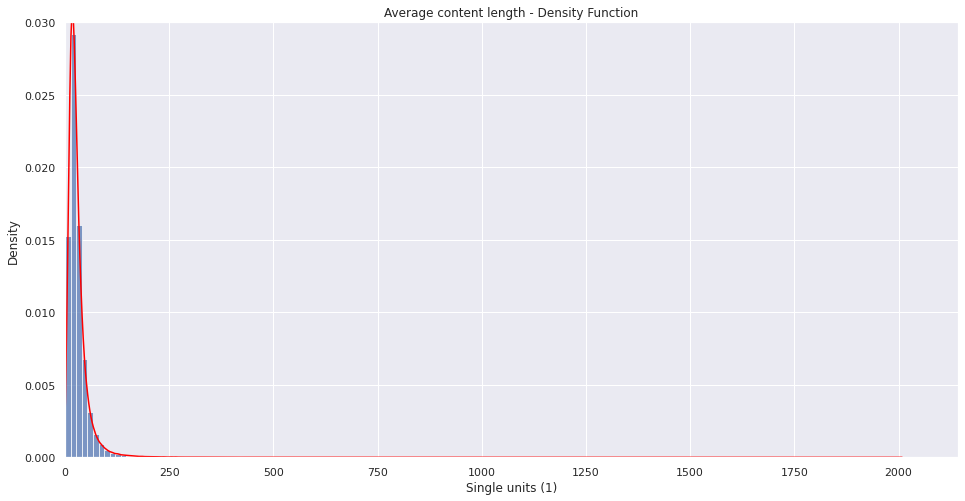

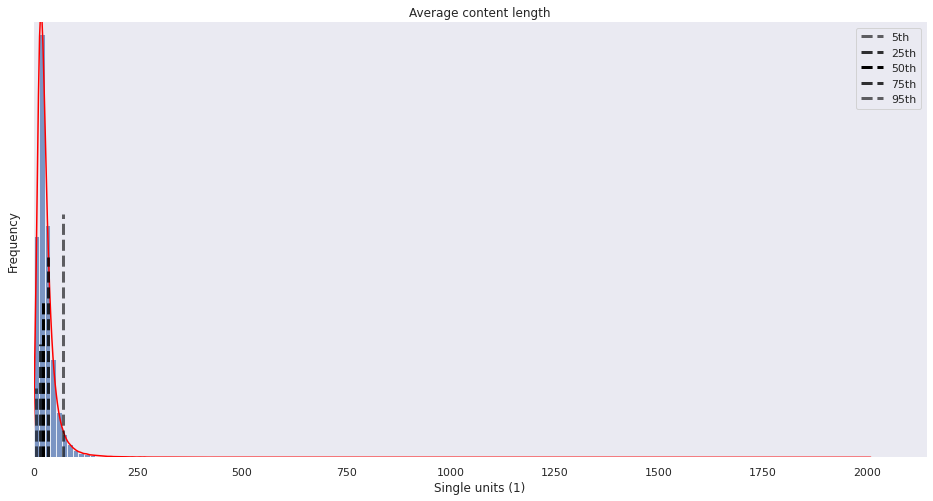

In [239]:
plot_histogram_density_function(community_by_work["marvel"]['average_content_length'], ["Average content length - Histogram", "Average content length - Density Function", "Average content length"], "Single units (1)", 0.03, 100)

#### Navigate by period

And now we analyze from year to year or from month to month...

In [240]:
# daily_stats["marvel"].filter(like='2019', axis=0).describe()

In [241]:
# daily_stats["marvel"].filter(like='2020', axis=0).describe()

In [242]:
# daily_stats_filtered = []
# monthly_stats_filtered = []
# period_filter = ['2019', '2020']
# for period in period_filter:
#     daily_stats_filtered.append(daily_stats["marvel"].filter(like=period, axis=0)) #Filter by day
#     monthly_stats_filtered.append(monthly_stats["marvel"].filter(like=period, axis=0)) #Filter by month

In [243]:
# subplot_sma(daily_stats_filtered, 'ncomments', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(daily_stats_filtered, 'text_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(daily_stats_filtered, 'average_content_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [244]:
# subplot_sma(monthly_stats_filtered, 'ncomments', rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(monthly_stats_filtered, 'text_length', rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(monthly_stats_filtered, 'average_content_length', rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [245]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_sma(daily_stats_filtered, category, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [246]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_sma(monthly_stats_filtered, category, rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [247]:
# bar_chart_race(monthly_stats_filtered[0])

In [248]:
# bar_chart_race(monthly_stats_filtered[1])

The _Exponential Moving Average_ (EMA) is a wee bit more involved. First, you should find the SMA. Second, calculate the smoothing factor. Then, use your smoothing factor with the previous EMA to find a new value. In this way, the latest values are given higher weights, whereas the SMA assigns equal weight to all periods.

<span style="font-size:1.5em;">**$EMA_{Today}$** = $(Value_{Today}*(\frac{Smoothing}{1+Days}))+EMA_{Yesterday}*(1-(\frac{Smoothing}{1+Days}))$</span>

The EMA allows to visualize the trend of the identified LIWC category against the average oscillations of the values.
Being a more precise tool than the Simple Moving Average (SMA), the EMA is more and more precise as the period taken into consideration is shorter and is a fundamental indicator on the short term.
The EMA is far more faithful to fluctuations than the SMA.

In [249]:
# subplot_ema(daily_stats_filtered, 'ncomments', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(daily_stats_filtered, 'text_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(daily_stats_filtered, 'average_content_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [250]:
# subplot_ema(monthly_stats_filtered, 'ncomments', exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(monthly_stats_filtered, 'text_length', exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(monthly_stats_filtered, 'average_content_length', exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [251]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_ema(daily_stats_filtered, category, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [252]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_ema(monthly_stats_filtered, category, exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

And now the Z-Score.

In [253]:
# subplot_zscore(daily_stats_filtered, ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], columns=len(period_filter), height=8, width=25)
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     subplot_zscore(daily_stats_filtered, pair, columns=len(period_filter), height=8, width=25)

In [254]:
# subplot_zscore(monthly_stats_filtered, ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], columns=len(period_filter), height=8, width=25)
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     subplot_zscore(monthly_stats_filtered, pair, columns=len(period_filter), height=8, width=25)

#### Analysis of the most positive and negative works

**And now let's start a joint work part with Andrea. We retrieve the ids of the most positive and negative works. Also, let's aggregate all the works' comments and look at the percentage of important categories like Anx, Anger and Sad.**

In [255]:
community_by_work["marvel"].describe()

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
count,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000
mean,289.297745,1306.315623,29.311891,37.085564,10.259524,1.989207,0.242807,0.633911,0.526219,11.136571,5.718923,1.355299,0.188133,0.740906,3.141807,7.095463,1.274124,0.458778,0.907599,0.444397
std,3303.126352,5584.846729,28.003725,124.318358,6.528296,2.142790,0.458226,1.188569,1.198444,3.774914,2.664819,1.534875,0.454762,1.009055,2.480024,3.067191,1.469479,0.963355,1.503176,0.748113
min,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.000000,113.000000,14.920000,6.000000,6.950000,0.900000,0.000000,0.000000,0.000000,9.660000,4.410000,0.000000,0.000000,0.000000,1.780000,5.880000,0.000000,0.000000,0.120000,0.000000
50%,14.000000,301.000000,23.050000,12.000000,9.140000,1.750000,0.050000,0.440000,0.260000,11.200000,5.680000,1.020000,0.000000,0.530000,2.770000,6.950000,0.960000,0.000000,0.750000,0.290000
75%,42.000000,843.000000,35.170000,28.000000,12.080000,2.610000,0.350000,0.880000,0.620000,12.830000,6.970000,2.050000,0.240000,1.050000,4.000000,8.200000,1.930000,0.530000,1.190000,0.610000
max,469948.000000,524143.000000,1339.000000,13197.000000,100.000000,100.000000,33.330000,100.000000,100.000000,66.670000,50.000000,50.000000,50.000000,50.000000,50.000000,100.000000,50.000000,50.000000,100.000000,50.000000


In [256]:
community_by_work["marvel"].sort_values(by=['Posemo'], ascending=False)

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
work_id,,,,,,,,,,,,,,,,,,,,
21024584,1.0,1,1.00,1,100.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
18959791,1.0,1,1.00,1,100.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
29080518,1.0,1,1.00,1,100.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
20220793,1.0,1,1.00,1,100.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
17307845,1.0,1,1.00,1,100.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20096428,1.0,22,22.00,1,0.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
29267694,2.0,7,3.50,2,0.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
20095405,23.0,21,2.33,9,0.0,0.00,0.0,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0


From here you can see that it is necessary to put a filter to get the works that have a sensible number of comments. We will take those that have ncomments greater than 100.

In [257]:
eligible_works["marvel"] = community_by_work["marvel"].copy()
eligible_works["marvel"]['ncomments'] = eligible_works["marvel"][eligible_works["marvel"]['ncomments'] > 100]['ncomments']
eligible_works["marvel"] = eligible_works["marvel"].dropna()
eligible_works["marvel"].describe()

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
count,19828.000000,19828.000000,19828.00000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000,19828.000000
mean,3663.186050,11542.260995,37.06038,301.456173,7.834218,2.235412,0.310108,0.759951,0.491647,11.024786,5.503916,1.863537,0.216397,0.808541,2.636113,6.594612,1.732650,0.551371,0.889951,0.486771
std,12245.029614,18468.646412,21.33219,387.498508,2.038952,0.665544,0.135366,0.343613,0.311760,1.341527,1.072766,0.890844,0.122388,0.365868,0.882686,0.852694,0.800269,0.614583,0.263260,0.226980
min,101.000000,532.000000,3.17000,101.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,379.000000,3876.000000,24.07000,129.000000,6.480000,1.790000,0.220000,0.520000,0.317500,10.260000,4.880000,1.220000,0.140000,0.560000,2.020000,6.120000,1.160000,0.130000,0.730000,0.350000
50%,1069.000000,6392.000000,32.11500,182.000000,7.650000,2.170000,0.300000,0.710000,0.430000,11.020000,5.540000,1.740000,0.200000,0.760000,2.540000,6.580000,1.650000,0.310000,0.870000,0.450000
75%,2789.000000,11958.000000,44.19000,311.000000,9.000000,2.610000,0.390000,0.940000,0.580000,11.830000,6.180000,2.370000,0.270000,1.000000,3.160000,7.080000,2.220000,0.780000,1.030000,0.570000
max,469948.000000,524143.000000,635.88000,13197.000000,24.910000,8.240000,1.510000,3.530000,5.790000,19.510000,10.570000,8.530000,2.860000,3.870000,8.330000,11.970000,9.810000,6.160000,3.550000,2.990000


In [258]:
eligible_works["marvel"].sort_values(by=['Posemo'], ascending=False)

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
work_id,,,,,,,,,,,,,,,,,,,,
25914946,10890.0,8209,18.00,456.0,24.91,1.39,0.15,0.30,0.62,10.76,4.18,1.64,0.26,0.62,4.06,4.40,0.61,1.32,0.74,0.22
19052773,125.0,886,7.09,125.0,20.99,1.47,0.11,0.56,0.11,11.96,5.64,0.68,0.11,0.90,4.63,7.56,0.79,0.00,0.56,0.34
21260531,424.0,1196,9.20,130.0,19.40,0.84,0.00,0.25,0.33,12.54,3.51,1.67,0.25,1.09,6.02,6.44,1.67,0.00,0.59,0.17
17769857,350.0,806,6.89,117.0,18.61,0.74,0.00,0.62,0.12,11.54,5.33,0.62,0.12,0.87,4.59,5.83,0.50,0.37,0.25,0.37
28160877,5330.0,1497,9.60,156.0,18.30,0.94,0.27,0.07,0.27,12.49,2.74,0.73,0.13,1.34,7.55,4.61,1.14,0.00,2.20,0.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28859289,187.0,6408,46.10,139.0,0.02,0.03,0.00,0.03,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.03,0.00,0.00,0.00
15975326,1599.0,9262,46.78,198.0,0.01,0.00,0.00,0.00,0.00,0.01,0.01,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00
6041935,17784.0,9679,16.52,586.0,0.01,0.00,0.00,0.00,0.00,0.01,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [259]:
eligible_works["marvel"].sort_values(by=['Negemo'], ascending=False)

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
work_id,,,,,,,,,,,,,,,,,,,,
4172004,110.0,1917,17.43,110.0,7.82,8.24,0.21,1.20,5.79,10.75,6.94,1.04,0.21,0.05,2.50,8.29,0.94,0.42,1.56,0.10
17456489,119.0,2007,16.87,119.0,6.18,7.52,0.10,1.84,5.03,12.81,9.42,0.10,0.15,0.20,2.94,8.22,0.20,0.10,0.85,0.40
15927563,119.0,2524,21.21,119.0,6.14,7.29,0.16,1.35,4.95,13.43,9.94,0.55,0.20,0.28,2.46,7.33,0.59,0.20,0.99,0.32
16547501,191.0,4232,22.16,191.0,6.59,7.21,0.12,1.68,4.37,12.48,7.66,1.13,0.12,0.17,3.40,7.63,1.37,0.02,1.32,0.31
19804459,112.0,2414,21.55,112.0,5.88,6.88,0.12,0.99,4.47,13.17,9.32,0.87,0.17,0.33,2.49,7.91,0.91,0.00,1.37,0.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15931250,836.0,2047,19.13,107.0,0.15,0.00,0.00,0.00,0.00,0.20,0.15,0.00,0.00,0.00,0.05,0.10,0.00,0.00,0.00,0.05
8544628,1794.0,3922,28.42,138.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
15975326,1599.0,9262,46.78,198.0,0.01,0.00,0.00,0.00,0.00,0.01,0.01,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00


In [260]:
eligible_works["marvel"].sort_values(by=['Anx'], ascending=False)

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
work_id,,,,,,,,,,,,,,,,,,,,
31082567,105.0,4238,40.36,105.0,5.10,4.11,1.51,1.06,0.85,10.38,4.86,2.97,0.17,1.06,1.32,6.35,3.02,0.19,0.73,0.64
27831565,1288.0,6231,27.94,223.0,7.70,2.95,1.30,0.61,0.32,11.68,5.38,1.94,0.35,0.45,3.56,5.87,2.07,0.48,1.12,0.50
16452353,105.0,3188,30.36,105.0,8.06,2.92,1.29,0.38,0.47,12.70,7.25,0.88,0.63,0.56,3.39,6.81,0.78,0.19,0.19,0.22
19182319,113.0,2015,17.83,113.0,9.28,3.57,1.24,1.64,0.15,10.27,6.60,1.79,0.20,0.25,1.44,9.73,1.54,0.40,1.04,0.35
7065379,115.0,6417,55.80,115.0,6.98,3.16,1.23,1.00,0.19,9.30,5.52,0.31,0.12,1.68,1.67,6.76,0.55,0.05,0.69,0.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7144718,376.0,3384,27.29,124.0,1.51,0.53,0.00,0.24,0.03,2.19,1.21,0.15,0.00,0.00,0.83,0.03,0.41,0.03,0.09,0.03
17958641,888.0,1958,8.78,223.0,14.20,2.30,0.00,1.38,0.31,12.31,5.31,0.72,0.56,1.23,4.49,6.28,0.41,0.51,0.15,0.31
2058969,119.0,1902,15.98,119.0,10.83,3.79,0.00,0.84,2.00,11.46,5.84,1.47,0.05,0.42,3.68,7.62,1.47,0.42,1.58,0.42


In [261]:
eligible_works["marvel"].sort_values(by=['Anger'], ascending=False)

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
work_id,,,,,,,,,,,,,,,,,,,,
17484788,1999.0,2264,15.30,148.0,5.87,6.10,0.62,3.53,0.88,10.03,6.58,1.15,0.22,0.71,1.37,7.29,2.25,0.18,0.66,0.27
26240842,204.0,3511,17.21,204.0,8.32,4.59,0.31,3.47,0.43,11.08,6.15,0.74,0.57,1.31,2.31,6.18,1.22,0.11,1.59,0.28
12545460,13568.0,1848,10.68,173.0,6.28,4.71,0.43,3.41,0.05,12.23,3.63,3.84,0.49,1.24,3.03,5.57,2.38,2.76,0.54,0.32
14299578,162.0,4365,26.94,162.0,6.67,4.44,0.18,3.23,0.37,9.69,5.25,1.65,0.32,1.21,1.26,7.08,1.63,0.44,1.08,0.66
15684198,356.0,9138,25.67,356.0,7.35,4.20,0.20,3.18,0.32,10.83,5.48,1.69,0.31,1.26,2.10,6.75,1.95,0.14,0.91,0.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3833596,4651.0,3250,17.66,184.0,0.03,0.00,0.00,0.00,0.00,0.03,0.00,0.00,0.03,0.00,0.00,0.00,0.00,0.00,0.03,0.00
20340028,1740.0,1004,7.84,128.0,0.10,0.00,0.00,0.00,0.00,0.20,0.20,0.00,0.00,0.00,0.00,0.00,0.10,0.00,0.00,0.10
16902489,3471.0,554,3.17,175.0,1.81,0.18,0.18,0.00,0.00,2.17,0.54,0.00,0.00,0.00,1.62,0.72,0.00,0.00,0.00,0.00


In [262]:
eligible_works["marvel"].sort_values(by=['Sad'], ascending=False)

,chapter,text_length,average_content_length,ncomments,Posemo,Negemo,Anx,Anger,Sad,Ppron,I,SheHe,We,They,You,Ipron,Male,Female,See,Hear
work_id,,,,,,,,,,,,,,,,,,,,
4172004,110.0,1917,17.43,110.0,7.82,8.24,0.21,1.20,5.79,10.75,6.94,1.04,0.21,0.05,2.50,8.29,0.94,0.42,1.56,0.10
17456489,119.0,2007,16.87,119.0,6.18,7.52,0.10,1.84,5.03,12.81,9.42,0.10,0.15,0.20,2.94,8.22,0.20,0.10,0.85,0.40
15927563,119.0,2524,21.21,119.0,6.14,7.29,0.16,1.35,4.95,13.43,9.94,0.55,0.20,0.28,2.46,7.33,0.59,0.20,0.99,0.32
19804459,112.0,2414,21.55,112.0,5.88,6.88,0.12,0.99,4.47,13.17,9.32,0.87,0.17,0.33,2.49,7.91,0.91,0.00,1.37,0.29
16547501,191.0,4232,22.16,191.0,6.59,7.21,0.12,1.68,4.37,12.48,7.66,1.13,0.12,0.17,3.40,7.63,1.37,0.02,1.32,0.31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15164258,304.0,1971,12.63,156.0,16.54,1.42,0.66,0.46,0.00,9.18,4.16,1.17,0.15,1.17,2.54,11.97,0.81,0.76,0.96,0.61
22321546,2723.0,24574,148.93,165.0,0.42,0.17,0.04,0.09,0.00,0.70,0.53,0.00,0.00,0.00,0.16,0.01,0.04,0.03,0.04,0.04
8474059,345.0,1509,12.07,125.0,10.07,1.72,0.13,1.06,0.00,10.67,5.63,0.53,0.00,0.80,3.71,8.08,0.60,0.46,0.46,0.33


In [263]:
# eligible_works["marvel"].to_csv('marvel_eligible_works.csv')

Below to read comments from a certain work.

In [264]:
ao3_comments_dfs["marvel"].loc[ao3_comments_dfs["marvel"]['work_id'] == 18074978]

,chapter,datetime,parent_id,text,work_id,comment_id,comment_author,text_len,work_author,reply_to


In [265]:
community_by_comment["marvel"].loc[community_by_comment["marvel"]['work_id'] == 18074978]

,datetime,text,work_id,comment_author,work_author,text_length,ncomments,Posemo,Negemo,Anx,...,SheHe,We,They,You,Ipron,Male,Female,See,Hear,Feel


Now let's compare with Andrea's metrics.

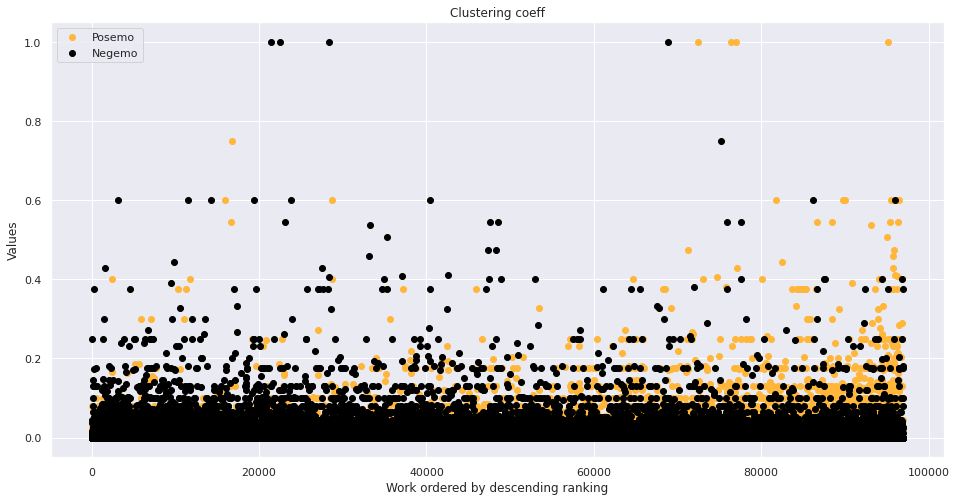

/home/ubuntu/jupyter-env/lib/python3.6/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


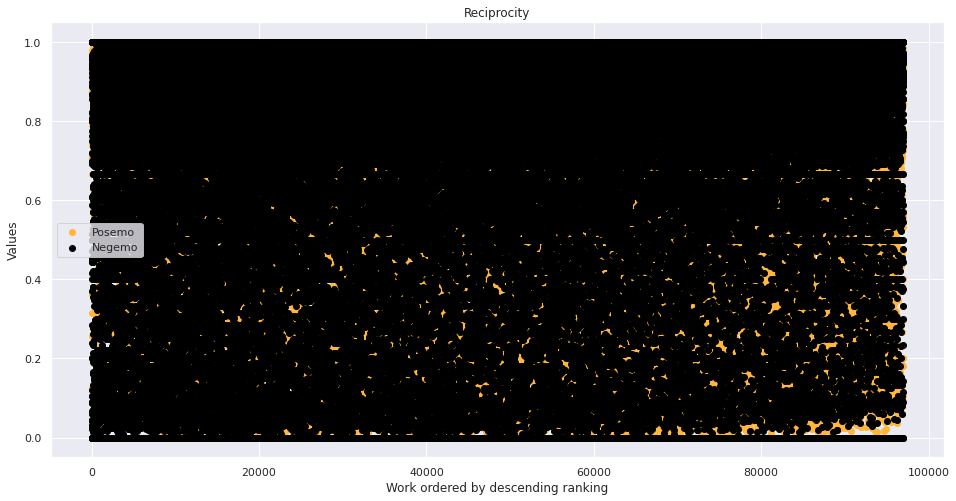

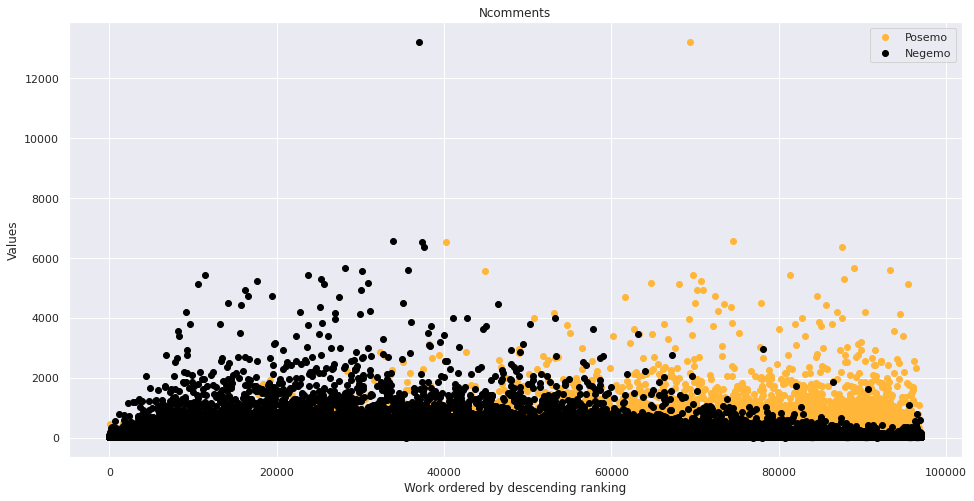

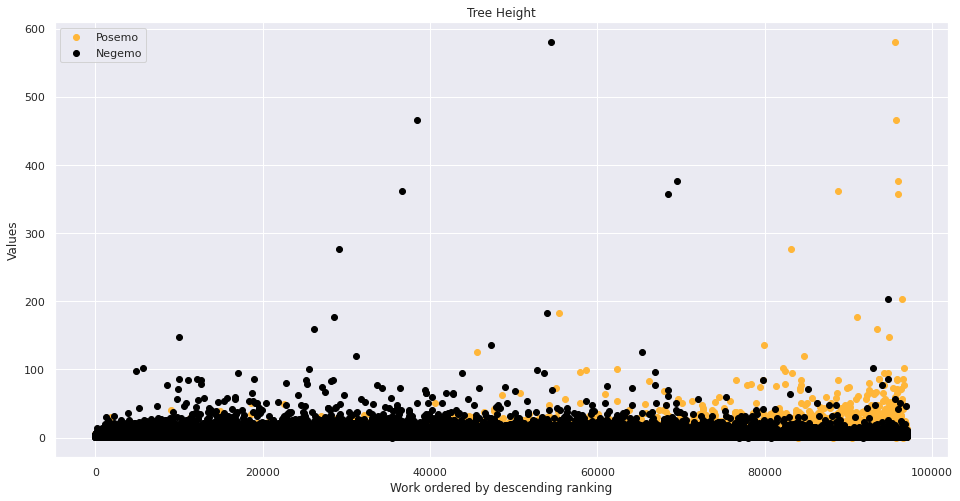

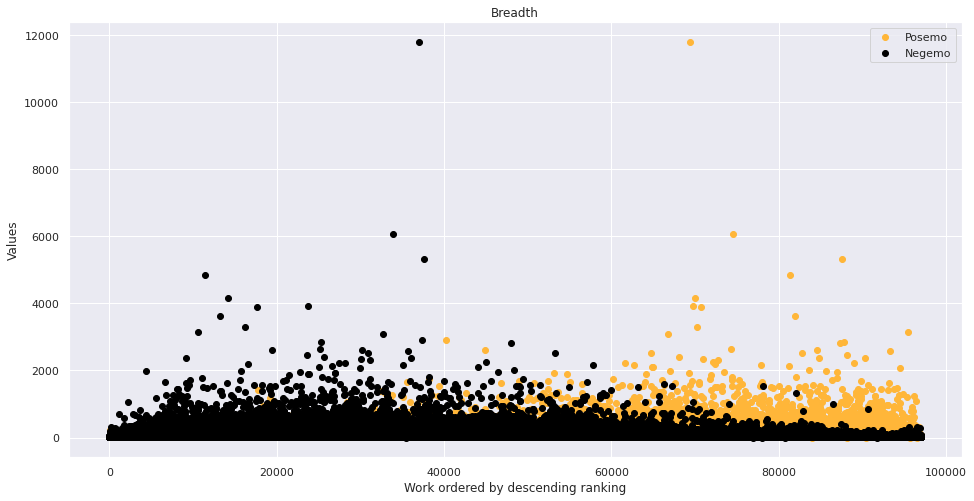

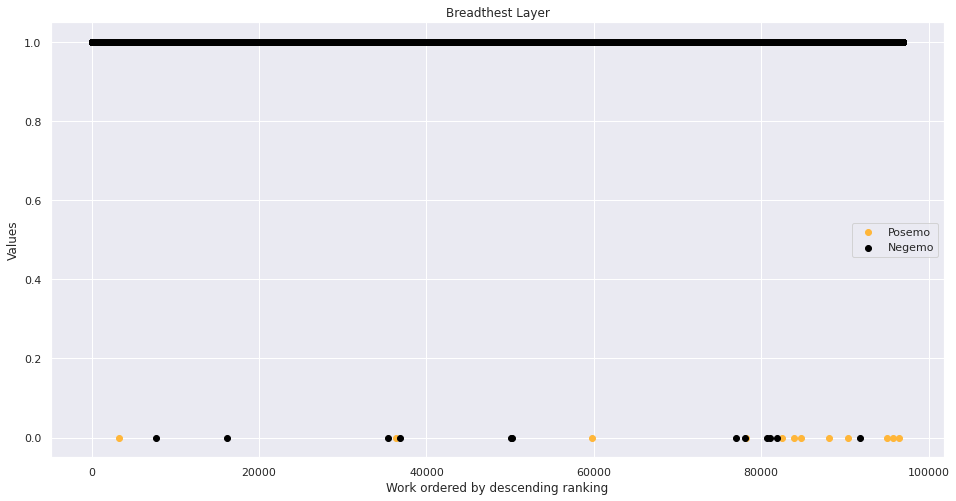

...

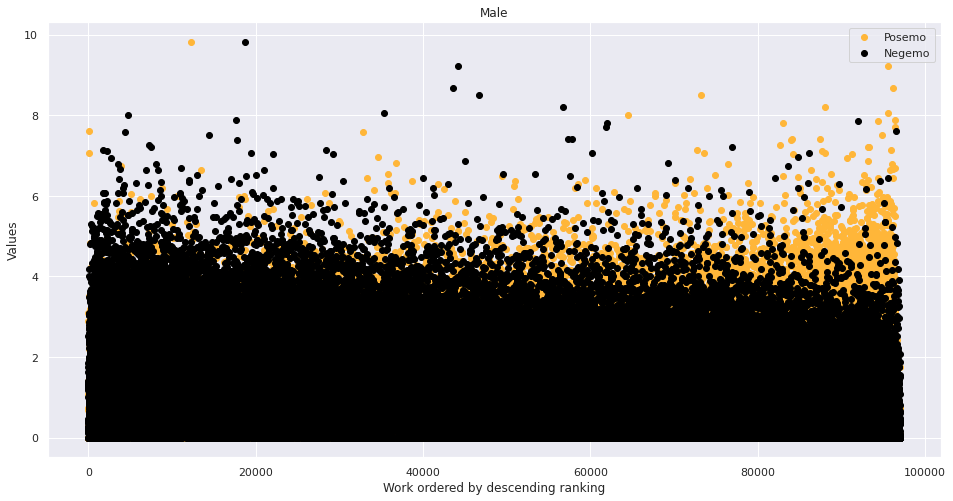

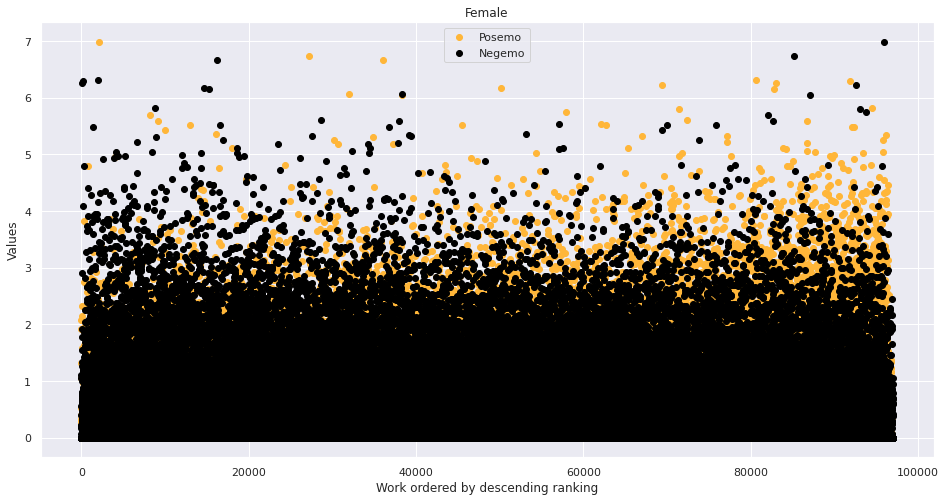

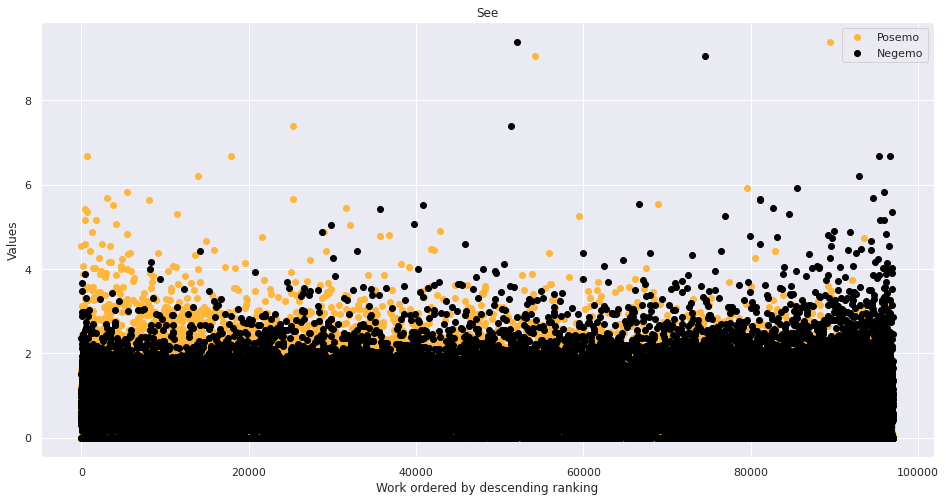

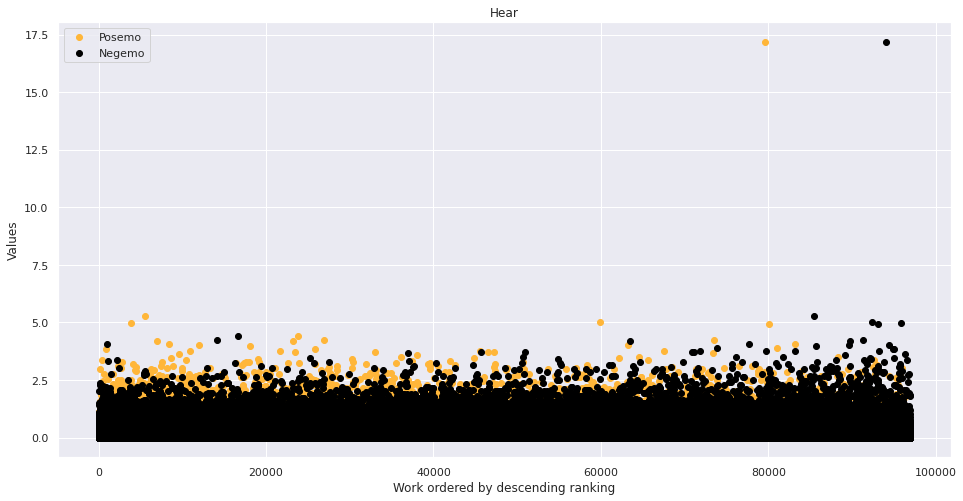

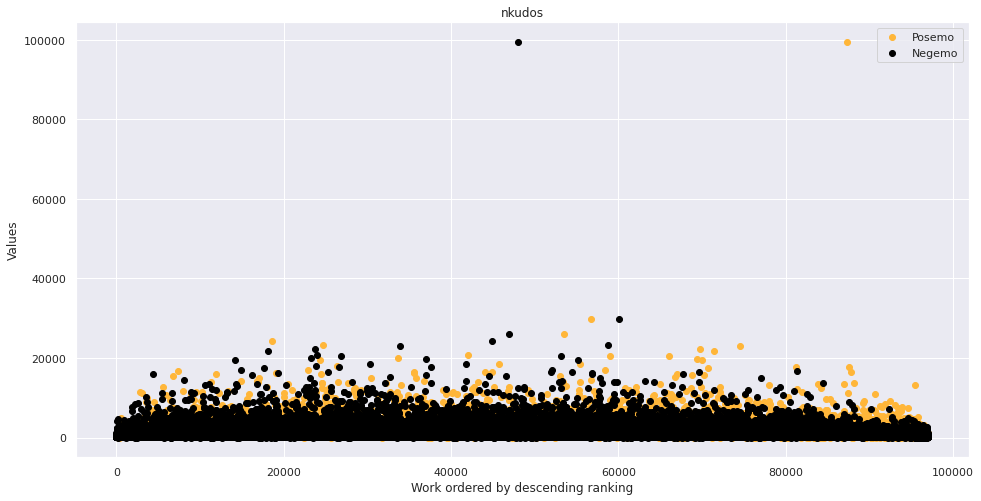

In [266]:
for field in joint_analysis.columns:
    if field not in ['Nodes', 'Edges', 'is Author most active user?', 'average_content_length', 'text_length', 'Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
        plt.figure(figsize=(16, 8))
        plt.scatter(list(joint_analysis.reset_index(level=0).index), list(joint_analysis.sort_values(by=['Posemo'], ascending=False)[field]), color=categories_colors["Posemo"])
        plt.scatter(list(joint_analysis.reset_index(level=0).index), list(joint_analysis.sort_values(by=['Negemo'], ascending=False)[field]), color=categories_colors["Negemo"])
        plt.xlabel("Work ordered by descending ranking")
        plt.ylabel("Values")
        plt.title(field)
        plt.legend(['Posemo', 'Negemo'])
        plt.show()

In [267]:
# for field in joint_analysis.columns:
#     if field not in ['Nodes', 'Edges', 'is Author most active user?', 'average_content_length', 'text_length', 'Posemo', 'Negemo', 'Anger', 'Sad']:
#         plt.figure(figsize=(16, 8))
#         plt.scatter(list(joint_analysis.reset_index(level=0).index), list(joint_analysis.sort_values(by=['Anx'], ascending=False)[field]))
#         plt.xlabel("Work ordered by descending ranking")
#         plt.ylabel("Values")
#         plt.legend([field])
#         plt.show()

In [268]:
# for field in joint_analysis.columns:
#     if field not in ['Nodes', 'Edges', 'is Author most active user?', 'average_content_length', 'text_length', 'Posemo', 'Negemo', 'Anx', 'Sad']:
#         plt.figure(figsize=(16, 8))
#         plt.scatter(list(joint_analysis.reset_index(level=0).index), list(joint_analysis.sort_values(by=['Anger'], ascending=False)[field]))
#         plt.xlabel("Work ordered by descending ranking")
#         plt.ylabel("Values")
#         plt.legend([field])
#         plt.show()

In [269]:
# for field in joint_analysis.columns:
#     if field not in ['Nodes', 'Edges', 'is Author most active user?', 'average_content_length', 'text_length', 'Posemo', 'Negemo', 'Anx', 'Anger']:
#         plt.figure(figsize=(16, 8))
#         plt.scatter(list(joint_analysis.reset_index(level=0).index), list(joint_analysis.sort_values(by=['Sad'], ascending=False)[field]))
#         plt.xlabel("Work ordered by descending ranking")
#         plt.ylabel("Values")
#         plt.legend([field])
#         plt.show()

#### How to combine nkudos, ncomments and emotions?

When a work has a lot of comments we expect that it has to do with a different kind of popularity maybe from a work with few comments. Is a work with high nkudos liked? 

Starting with the most positive works look at the relationship between nkudos and ncomments. Look for a relationship between the most positive and the most negative. Do the most positive works have fewer comments than nkudos and the most negative works have more comments than nkudos? In general, for the most positive, see this ratio as it goes.

In [270]:
popularity_res = pd.DataFrame(list(zip(community_by_work["marvel"][community_by_work["marvel"]['text_length']>50].index,
                                       community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Posemo'],
                                       community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['Negemo'],
                                       community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['ncomments'],
                                       nkudos,
                                       [0.00 if k==inf else k for k in list(nkudos/community_by_work["marvel"][community_by_work["marvel"]['text_length']>50]['ncomments'])])),
                              columns=['work_id', 'Posemo', 'Negemo', 'ncomments', 'nkudos', 'nkudos/ncomments'])
popularity_res.set_index('work_id', inplace=True)
popularity_res = popularity_res[popularity_res['ncomments'] > 100].round(2)
popularity_res

,Posemo,Negemo,ncomments,nkudos,nkudos/ncomments
work_id,,,,,
32546,9.68,1.69,151,282,1.87
34735,7.11,1.60,292,1562,5.35
85982,5.83,2.05,112,661,5.90
89825,8.69,2.35,143,2677,18.72
109628,9.61,1.53,152,10621,69.88
...,...,...,...,...,...
31605650,4.54,3.09,105,110,1.05
31649066,9.46,3.21,181,794,4.39
31654178,5.70,2.38,198,85,0.43


In [271]:
popularity_res.sort_values(by=['Posemo'], ascending=False).reset_index(level=0)

,work_id,Posemo,Negemo,ncomments,nkudos,nkudos/ncomments
0,25914946,24.91,1.39,456,390,0.86
1,19052773,20.99,1.47,125,1318,10.54
2,21260531,19.40,0.84,130,192,1.48
3,17769857,18.61,0.74,117,381,3.26
4,28160877,18.30,0.94,156,16,0.10
...,...,...,...,...,...,...
19823,28859289,0.02,0.03,139,288,2.07
19824,15975326,0.01,0.00,198,419,2.12
19825,6041935,0.01,0.00,586,2742,4.68
19826,22835938,0.00,0.00,114,19,0.17


In [272]:
popularity_res.sort_values(by=['Negemo'], ascending=False).reset_index(level=0)

,work_id,Posemo,Negemo,ncomments,nkudos,nkudos/ncomments
0,4172004,7.82,8.24,110,2276,20.69
1,17456489,6.18,7.52,119,1042,8.76
2,15927563,6.14,7.29,119,1983,16.66
3,16547501,6.59,7.21,191,2299,12.04
4,19804459,5.88,6.88,112,1395,12.46
...,...,...,...,...,...,...
19823,15931250,0.15,0.00,107,919,8.59
19824,8544628,0.00,0.00,138,688,4.99
19825,15975326,0.01,0.00,198,419,2.12
19826,6041935,0.01,0.00,586,2742,4.68


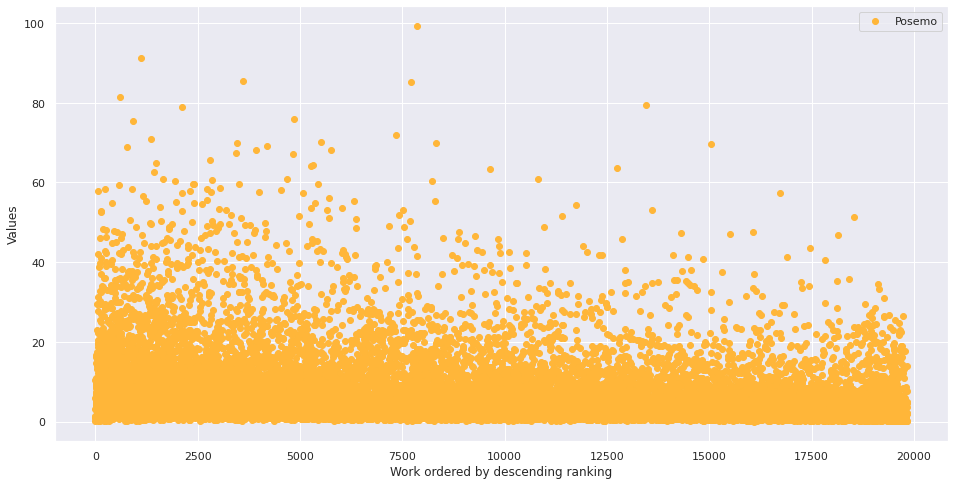

In [273]:
plt.figure(figsize=(16, 8))
plt.scatter(list(popularity_res.reset_index(level=0).index), list(popularity_res.sort_values(by=['Posemo'], ascending=False)['nkudos/ncomments']), color=categories_colors["Posemo"])
plt.xlabel("Work ordered by descending ranking")
plt.ylabel("Values")
plt.legend(['Posemo'])
plt.show()

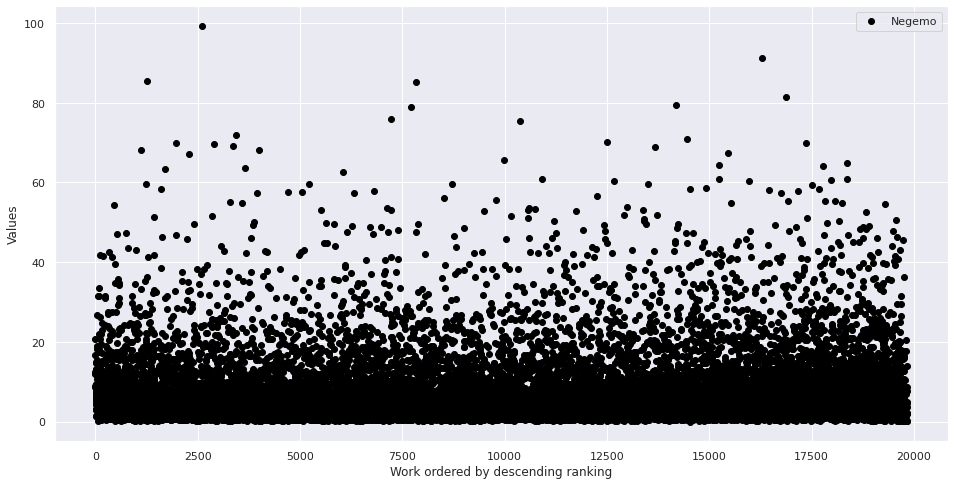

In [274]:
plt.figure(figsize=(16, 8))
plt.scatter(list(popularity_res.reset_index(level=0).index), list(popularity_res.sort_values(by=['Negemo'], ascending=False)['nkudos/ncomments']), color=categories_colors["Negemo"])
plt.xlabel("Work ordered by descending ranking")
plt.ylabel("Values")
plt.legend(['Negemo'])
plt.show()

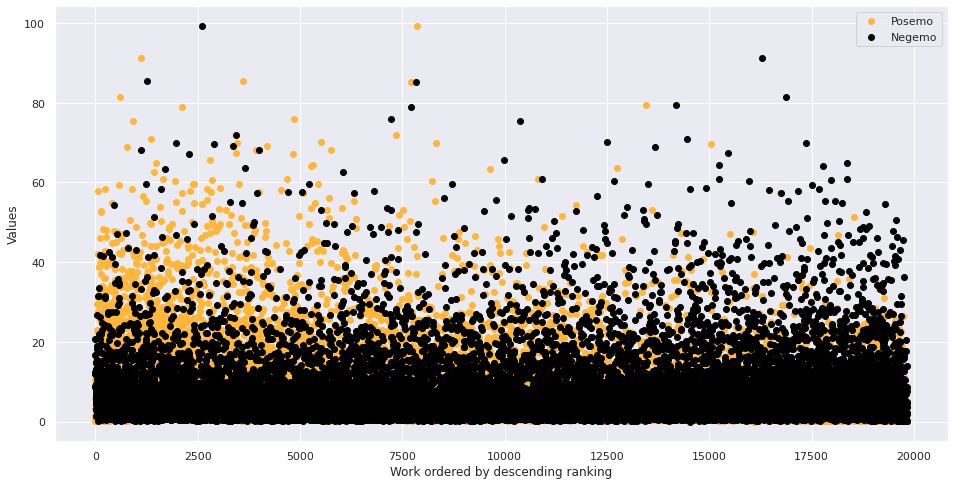

In [275]:
plt.figure(figsize=(16, 8))
plt.scatter(list(popularity_res.reset_index(level=0).index), list(popularity_res.sort_values(by=['Posemo'], ascending=False)['nkudos/ncomments']), color=categories_colors["Posemo"])
plt.scatter(list(popularity_res.reset_index(level=0).index), list(popularity_res.sort_values(by=['Negemo'], ascending=False)['nkudos/ncomments']), color=categories_colors["Negemo"])
plt.xlabel("Work ordered by descending ranking")
plt.ylabel("Values")
plt.legend(['Posemo', 'Negemo'])
plt.show()

Conclusions
- Do the most positive works have fewer comments than nkudos and the most negative works have more comments than nkudos? **Yes, it would seem so**.

#### Navigate by work

**We do all this analysis on each individual work as well**.

In [276]:
# work = 18523150

Let's first take a look at the global trend.

In [277]:
# plot_sma(daily_stats_by_work["marvel"][work], 'ncomments', rm1=20, rm2=50, polynomial_degree=3)
# plot_sma(daily_stats_by_work["marvel"][work], 'text_length', rm1=20, rm2=50, polynomial_degree=3)
# plot_sma(daily_stats_by_work["marvel"][work], 'average_content_length', rm1=20, rm2=50, polynomial_degree=3)

In [278]:
# plot_sma(monthly_stats_by_work["marvel"][work], 'ncomments', rolling_mean=False, polynomial_degree=1)
# plot_sma(monthly_stats_by_work["marvel"][work], 'text_length', rolling_mean=False, polynomial_degree=1)
# plot_sma(monthly_stats_by_work["marvel"][work], 'average_content_length', rolling_mean=False, polynomial_degree=1)

In [279]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     plot_sma(daily_stats_by_work["marvel"][work], category, rm1=20, rm2=50, polynomial_degree=3)

In [280]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     plot_sma(monthly_stats_by_work["marvel"][work], category, rolling_mean=False, polynomial_degree=1)

In [281]:
# bar_chart_race(monthly_stats_by_work["marvel"][work])

We now turn to **Zscore**.

In [282]:
# plot_zscore(daily_stats_by_work["marvel"][work], ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'])
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     plot_zscore(daily_stats_by_work["marvel"][work], pair)

In [283]:
# plot_zscore(monthly_stats_by_work["marvel"][work], ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'])
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     plot_zscore(monthly_stats_by_work["marvel"][work], pair)

And now let's take a look at this work **chapter by chapter**.

In [284]:
# plot_sma(chapter_stats_by_work["marvel"][work], 'ncomments', rm1=10, rm2=30, polynomial_degree=1)
# plot_sma(chapter_stats_by_work["marvel"][work], 'text_length', rm1=10, rm2=30, polynomial_degree=1)
# plot_sma(chapter_stats_by_work["marvel"][work], 'average_content_length', rm1=10, rm2=30, polynomial_degree=1)

In [285]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     plot_sma(chapter_stats_by_work["marvel"][work], category, rm1=10, rm2=30, polynomial_degree=1)

In [286]:
# plot_zscore(chapter_stats_by_work["marvel"][work], ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'])
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     plot_zscore(chapter_stats_by_work["marvel"][work], pair)

And now let's explore some variables with the use of **histograms**.

Let's aggregate by day.

In [287]:
# daily_stats_by_work["marvel"][work].describe()

In [288]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     plot_histogram_density_function(daily_stats_by_work["marvel"][work][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 1, 100)

In [289]:
# plot_histogram_density_function(daily_stats_by_work["marvel"][work]['ncomments'], ["Number of comments - Histogram", "Number of comments - Density Function", "Number of comments"], "Single units (1)", 0.5, 10)

In [290]:
# plot_histogram_density_function(daily_stats_by_work["marvel"][work]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.01, 10)

In [291]:
# plot_histogram_density_function(daily_stats_by_work["marvel"][work]['average_content_length'], ["Average content length - Histogram", "Average content length - Density Function", "Average content length"], "Single units (1)", 0.03, 50)

Let's aggregate by month.

In [292]:
# monthly_stats_by_work["marvel"][work].describe()

In [293]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     plot_histogram_density_function(monthly_stats_by_work["marvel"][work][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 2, 10)

In [294]:
# plot_histogram_density_function(monthly_stats_by_work["marvel"][work]['ncomments'], ["Number of comments - Histogram", "Number of comments - Density Function", "Number of comments"], "Single units (1)", 0.05, 10)

In [295]:
# plot_histogram_density_function(monthly_stats_by_work["marvel"][work]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.001, 10)

In [296]:
# plot_histogram_density_function(monthly_stats_by_work["marvel"][work]['average_content_length'], ["Average content length - Histogram", "Average content length - Density Function", "Average content length"], "Single units (1)", 0.04, 10)

Let's aggregate by comment.

In [297]:
# community_by_comment["marvel"][community_by_comment["marvel"]['work_id'] == work].describe()

In [298]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     plot_histogram_density_function(community_by_comment["marvel"][community_by_comment["marvel"]['work_id'] == work][category], [category+"'s percentage - Histogram", category+"'s percentage - Density Function", category+"'s percentage"], "Percentage (%)", 1, 100)

In [299]:
# plot_histogram_density_function(community_by_comment["marvel"][community_by_comment["marvel"]['work_id'] == work]['text_length'], ["Text's length - Histogram", "Text's length - Density Function", "Text's length"], "Single units (1)", 0.03, 100)

And now we analyze from year to year or from month to month...

In [300]:
# daily_stats_by_work["marvel"][work].filter(like='2019', axis=0).describe()

In [301]:
# daily_stats_by_work["marvel"][work].filter(like='2020', axis=0).describe()

In [302]:
# daily_stats_filtered = []
# monthly_stats_filtered = []
# period_filter = ['2019', '2020']
# for period in period_filter:
#     daily_stats_filtered.append(daily_stats_by_work["marvel"][work].filter(like=period, axis=0)) #Filter by day
#     monthly_stats_filtered.append(monthly_stats["marvel"].filter(like=period, axis=0)) #Filter by month

In [303]:
# subplot_sma(daily_stats_filtered, 'ncomments', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(daily_stats_filtered, 'text_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(daily_stats_filtered, 'average_content_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [304]:
# subplot_sma(monthly_stats_filtered, 'ncomments', rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(monthly_stats_filtered, 'text_length', rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_sma(monthly_stats_filtered, 'average_content_length', rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [305]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_sma(daily_stats_filtered, category, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [306]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_sma(monthly_stats_filtered, category, rolling_mean=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [307]:
# bar_chart_race(monthly_stats_filtered[0])

In [308]:
# bar_chart_race(monthly_stats_filtered[1])

In [309]:
# subplot_ema(daily_stats_filtered, 'ncomments', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(daily_stats_filtered, 'text_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(daily_stats_filtered, 'average_content_length', columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [310]:
# subplot_ema(monthly_stats_filtered, 'ncomments', exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(monthly_stats_filtered, 'text_length', exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)
# subplot_ema(monthly_stats_filtered, 'average_content_length', exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [311]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_ema(daily_stats_filtered, category, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

In [312]:
# for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
#     subplot_ema(monthly_stats_filtered, category, exp=False, columns=len(period_filter), polynomial_degree=1, height=8, width=25)

And now the Z-Score.

In [313]:
# subplot_zscore(daily_stats_filtered, ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], columns=len(period_filter), height=8, width=25)
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     subplot_zscore(daily_stats_filtered, pair, columns=len(period_filter), height=8, width=25)

In [314]:
# subplot_zscore(monthly_stats_filtered, ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], columns=len(period_filter), height=8, width=25)
# for pair in itertools.combinations(['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad'], 2):
#     subplot_zscore(monthly_stats_filtered, pair, columns=len(period_filter), height=8, width=25)

#### Prominence of the author

Now the **author centrality** part of the study begins, i.e., its behaviour compared to that of the normal user.

In [315]:
community_by_author["marvel"]

text_length  ncomments  Posemo  Negemo  Anx  Anger  \
comment_author work_id                                                        
006_stkglm     7071265            10          2     0.0     0.0  0.0    0.0   
               7375078            34          2     0.0     0.0  0.0    0.0   
               8416687           140          3    15.0     0.0  0.0    0.0   
               10623564           24          2     0.0     0.0  0.0    0.0   
               10623699           49          5     0.0     0.0  0.0    0.0   
...                              ...        ...     ...     ...  ...    ...   
zzeacat        30435042            8          1     1.0     0.0  0.0    0.0   
zzoaozz        772510             45          2     4.0     0.0  0.0    0.0   
               773057             18          3     4.0     0.0  0.0    0.0   
               773552             70          2     2.0     1.0  0.0    0.0   
               777027              3          1     1.0     0.0  0.0    0.0   

                         Sad  Ppron    I  SheHe   We  They   You  Ipron  Male  \
comment_author work_id                                                          
006_stkglm     7071265   0.0    0.0  0.0    0.0  0.0   0.0   0.0    0.0   0.0   
               7375078   0.0    0.0  0.0    0.0  0.0   0.0   0.0    0.0   0.0   
               8416687   0.0   16.0  6.0    0.0  0.0   0.0  10.0    5.0   0.0   
               10623564  0.0    0.0  0.0    0.0  0.0   0.0   0.0    0.0   0.0   
               10623699  0.0    0.0  0.0    0.0  0.0   0.0   0.0    0.0   0.0   
...                      ...    ...  ...    ...  ...   ...   ...    ...   ...   
zzeacat        30435042  0.0    1.0  1.0    0.0  0.0   0.0   0.0    0.0   0.0   
zzoaozz        772510    0.0    4.0  3.0    0.0  0.0   0.0   1.0    6.0   0.0   
               773057    0.0    5.0  1.0    0.0  0.0   0.0   4.0    0.0   0.0   
               773552    0.0    8.0  2.0    3.0  0.0   1.0   2.0    3.0   3.0   
               777027    0.0    1.0  0.0    0.0  0.0   0.0   1.0    0.0   0.0   

                         Female  See  Hear  Feel  
comment_author work_id                            
006_stkglm     7071265      0.0  0.0   0.0   0.0  
               7375078      0.0  0.0   0.0   0.0  
               8416687      0.0  0.0   0.0   0.0  
               10623564     0.0  0.0   0.0   0.0  
               10623699     0.0  0.0   0.0   0.0  
...                         ...  ...   ...   ...  
zzeacat        30435042     0.0  0.0   0.0   0.0  
zzoaozz        772510       0.0  1.0   0.0   0.0  
               773057       0.0  0.0   0.0   0.0  
               773552       0.0  2.0   0.0   0.0  
               777027       0.0  0.0   0.0   0.0  

[1718165 rows x 19 columns]

In [316]:
community_by_user["marvel"]

text_length  ncomments  Posemo  Negemo  Anx  Anger  \
comment_author work_id                                                        
 (Guest User)  532379             11          1     0.0     1.0  1.0    0.0   
               1178459             8          1     3.0     0.0  0.0    0.0   
               1256191            16          1     3.0     2.0  0.0    1.0   
               1848673            38          1     2.0     0.0  0.0    0.0   
               2403389           125          2    10.0     2.0  0.0    0.0   
...                              ...        ...     ...     ...  ...    ...   
🦋 (Guest User) 667480              6          1     0.0     1.0  0.0    1.0   
               15365850           19          1     2.0     1.0  0.0    0.0   
🦕 (Guest User) 22517590           29          3     1.0     1.0  0.0    0.0   
🧐 (Guest User) 25510144           46          1     0.0     1.0  0.0    0.0   
🧡 (Guest User) 19966900           26          1     2.0     2.0  0.0    0.0   

                         Sad  Ppron     I  SheHe   We  They  You  Ipron  Male  \
comment_author work_id                                                          
 (Guest User)  532379    0.0    1.0   1.0    0.0  0.0   0.0  0.0    0.0   0.0   
               1178459   0.0    1.0   1.0    0.0  0.0   0.0  0.0    1.0   0.0   
               1256191   1.0    3.0   1.0    0.0  0.0   0.0  2.0    0.0   0.0   
               1848673   0.0    2.0   1.0    1.0  0.0   0.0  0.0    1.0   1.0   
               2403389   1.0   14.0  10.0    2.0  0.0   0.0  2.0   11.0   2.0   
...                      ...    ...   ...    ...  ...   ...  ...    ...   ...   
🦋 (Guest User) 667480    0.0    1.0   1.0    0.0  0.0   0.0  0.0    1.0   0.0   
               15365850  1.0    2.0   2.0    0.0  0.0   0.0  0.0    3.0   0.0   
🦕 (Guest User) 22517590  0.0    4.0   4.0    0.0  0.0   0.0  0.0    1.0   0.0   
🧐 (Guest User) 25510144  1.0    3.0   0.0    3.0  0.0   0.0  0.0    2.0   3.0   
🧡 (Guest User) 19966900  2.0    3.0   2.0    0.0  0.0   0.0  1.0    1.0   0.0   

                         Female  See  Hear  Feel  
comment_author work_id                            
 (Guest User)  532379       0.0  0.0   0.0   0.0  
               1178459      0.0  0.0   0.0   0.0  
               1256191      0.0  0.0   0.0   1.0  
               1848673      0.0  1.0   0.0   0.0  
               2403389      0.0  2.0   0.0   0.0  
...                         ...  ...   ...   ...  
🦋 (Guest User) 667480       0.0  0.0   0.0   0.0  
               15365850     0.0  0.0   0.0   0.0  
🦕 (Guest User) 22517590     0.0  0.0   1.0   0.0  
🧐 (Guest User) 25510144     0.0  0.0   0.0   0.0  
🧡 (Guest User) 19966900     0.0  0.0   0.0   2.0  

[2873998 rows x 19 columns]

Let's first take a look at an **overview** between the **authors vs. all others**.

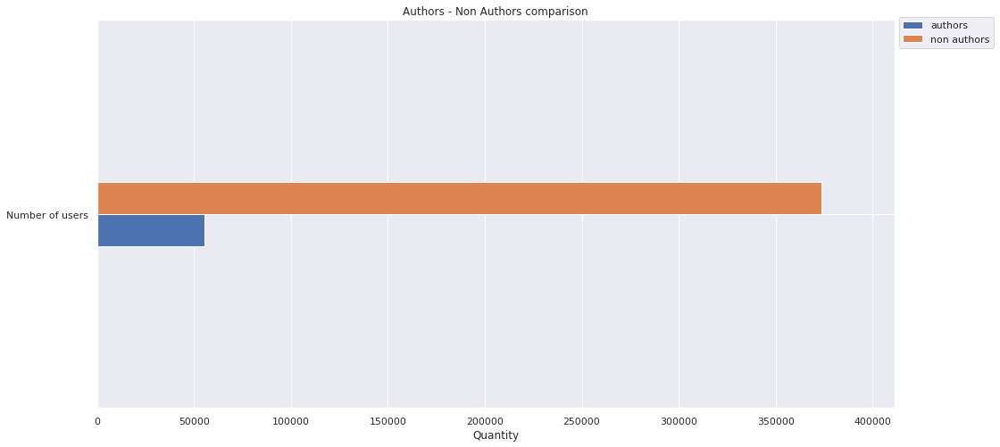

In [317]:
bar_chart(pd.DataFrame(list(zip(['Number of users'],
                                    [len(list(dict.fromkeys(community_by_author["marvel"].index.get_level_values('comment_author'))))],
                                    [len(list(dict.fromkeys(community_by_user["marvel"].index.get_level_values('comment_author'))))])),
                  columns=['index', 'authors', 'non authors']).set_index('index'),
         "Authors - Non Authors comparison")

In [ ]:
# show_distance(pd.DataFrame(list(zip(['Number of users'],
#                                     [len(list(dict.fromkeys(community_by_author["marvel"].index.get_level_values('comment_author'))))],
#                                     [len(list(dict.fromkeys(community_by_user["marvel"].index.get_level_values('comment_author'))))])),
#                   columns=['index', 'author', 'non-author']),
#               "Authors - Others comparison", "authors", "others", change_ylim=True)

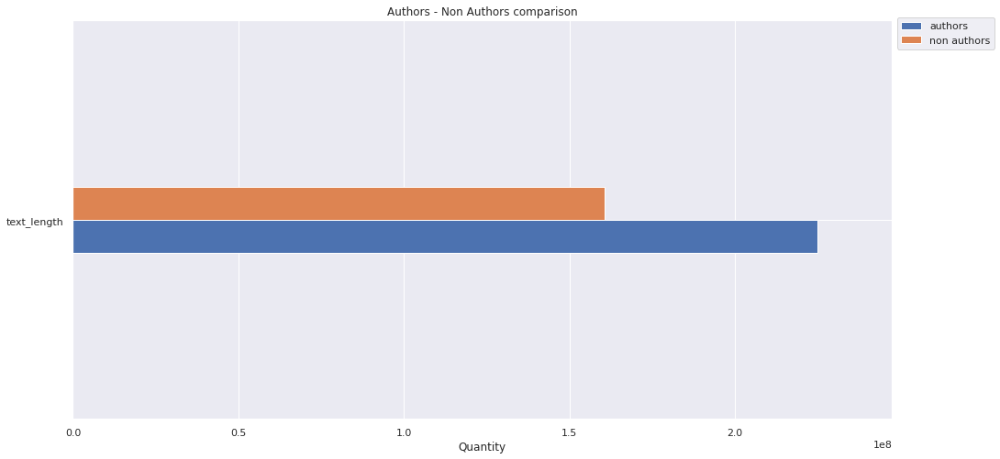

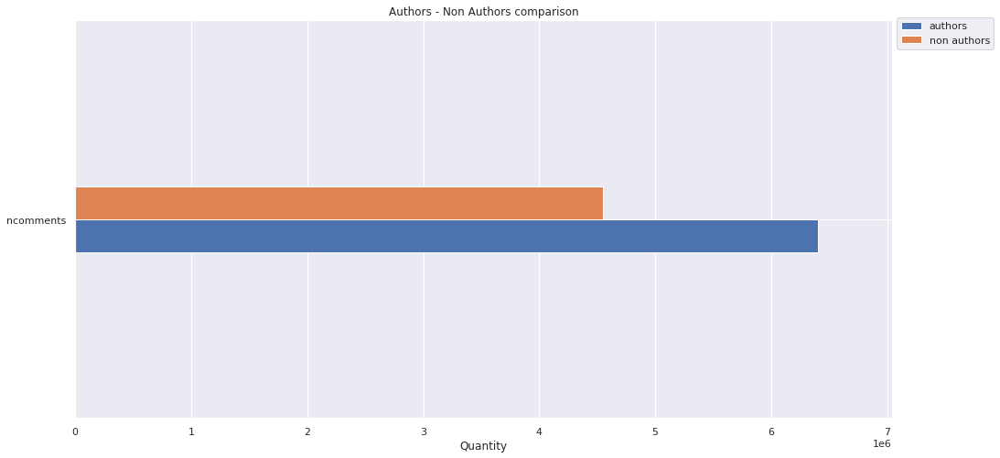

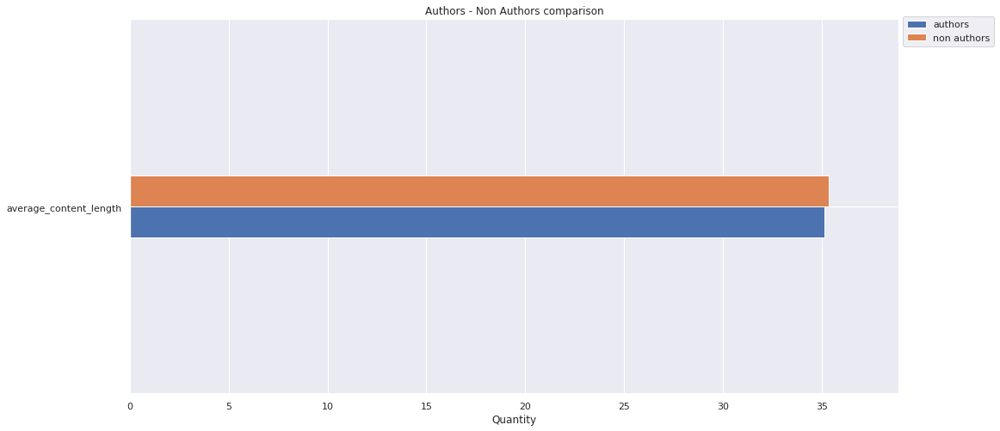

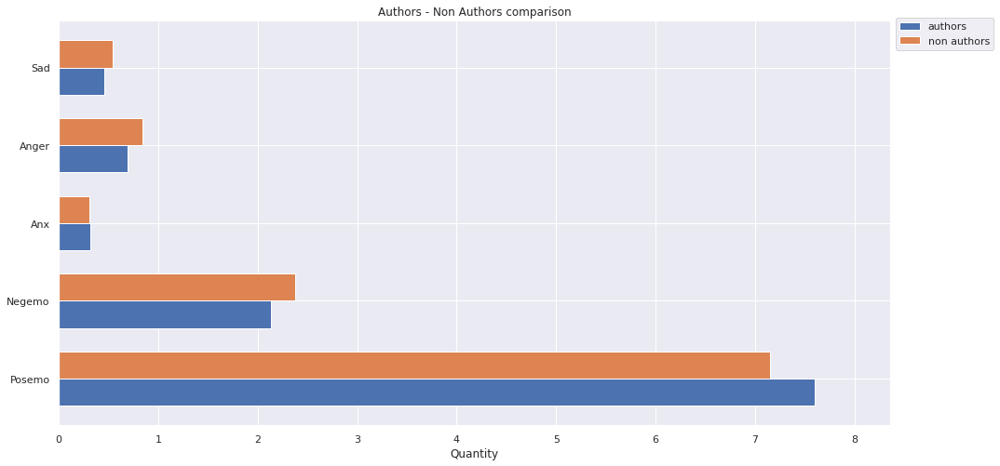

In [318]:
bar_chart(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors'}),
                         calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non authors'})],axis=1).reset_index(level=0)[:1].set_index('index'),
             "Authors - Non Authors comparison")
bar_chart(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors'}),
                         calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non authors'})],axis=1).reset_index(level=0)[1:2].set_index('index'),
             "Authors - Non Authors comparison")
bar_chart(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors'}),
                         calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non authors'})],axis=1).reset_index(level=0)[2:3].set_index('index'),
             "Authors - Non Authors comparison")
bar_chart(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors'}),
                         calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non authors'})],axis=1).reset_index(level=0)[3:8].set_index('index'),
             "Authors - Non Authors comparison", fmt='%.2f', width=0.7)

In [ ]:
# show_distance(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[:1],
#              "Authors - Others comparison", "authors", "others", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[1:2],
#              "Authors - Others comparison", "authors", "others", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[2:3],
#              "Authors - Others comparison", "authors", "others", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[3:],
#              "Authors - Others comparison", "authors", "others")

Below we calculate deltas to compare them among different communities.

In [ ]:
authors_vs_others_comparison["marvel"] = pd.concat([pd.concat([calculate_percentages_avg(community_by_author["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors'}),
                                                                 calculate_percentages_avg(community_by_user["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'others'})],axis=1).reset_index(level=0),
                                                      pd.DataFrame(list(zip(['Number of users'],
                                                                            [len(list(dict.fromkeys(community_by_author["marvel"].index.get_level_values('comment_author'))))],
                                                                            [len(list(dict.fromkeys(community_by_user["marvel"].index.get_level_values('comment_author'))))])),
                                                                   columns=['index', 'authors','others'])],axis=0)
authors_vs_others_comparison["marvel"]['score_diff'] = authors_vs_others_comparison["marvel"]['authors'] - authors_vs_others_comparison["marvel"]['others']
authors_vs_others_comparison["marvel"]

Now let's do something similar but considering only authors, that is, let's consider **only an author's comments related to his work**.

In [ ]:
others_comparison = pd.concat([community_by_user["marvel"], authors_on_others_works["marvel"]])
others_comparison

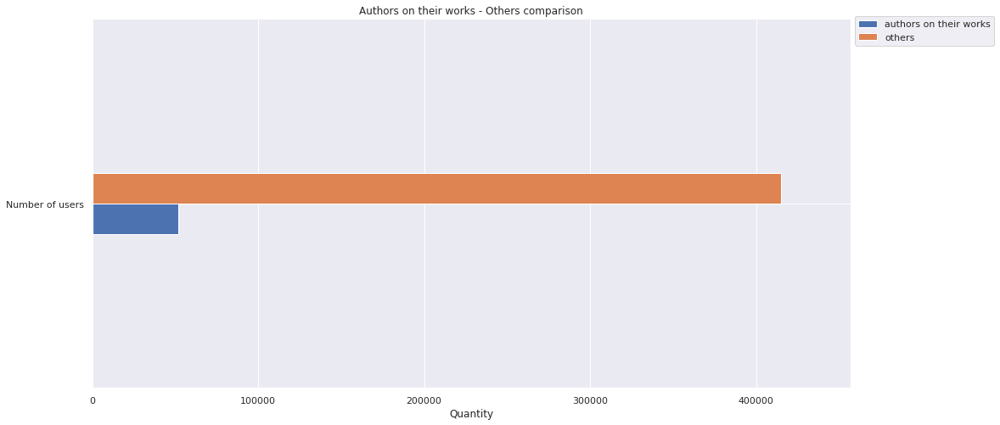

In [319]:
bar_chart(pd.DataFrame(list(zip(['Number of users'],
                                    [len(list(dict.fromkeys(authors_on_their_works["marvel"].index.get_level_values('comment_author'))))],
                                    [len(list(dict.fromkeys(others_comparison.index.get_level_values('comment_author'))))])),
                  columns=['index', 'authors on their works', 'others']).set_index('index'),
              "Authors on their works - Others comparison")

In [ ]:
# show_distance(pd.DataFrame(list(zip(['Number of users'],
#                                     [len(list(dict.fromkeys(author_and_self.index.get_level_values('comment_author'))))],
#                                     [len(list(dict.fromkeys(others.index.get_level_values('comment_author'))))])),
#                   columns=['index', 'author', 'non-author']),
#               "Very Authors - Others comparison", "very authors", "others", change_ylim=True)

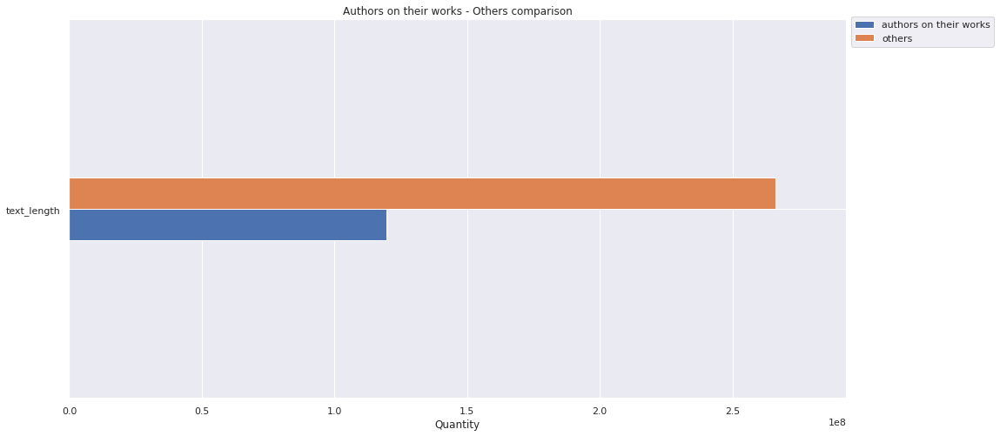

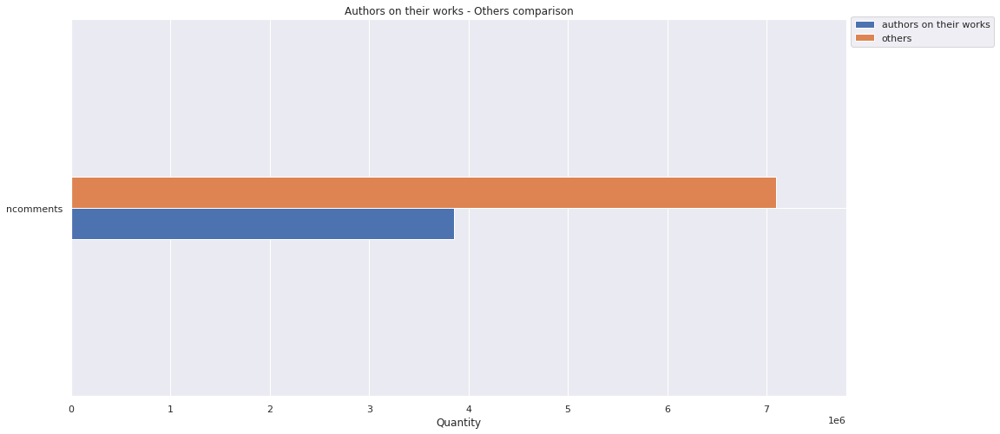

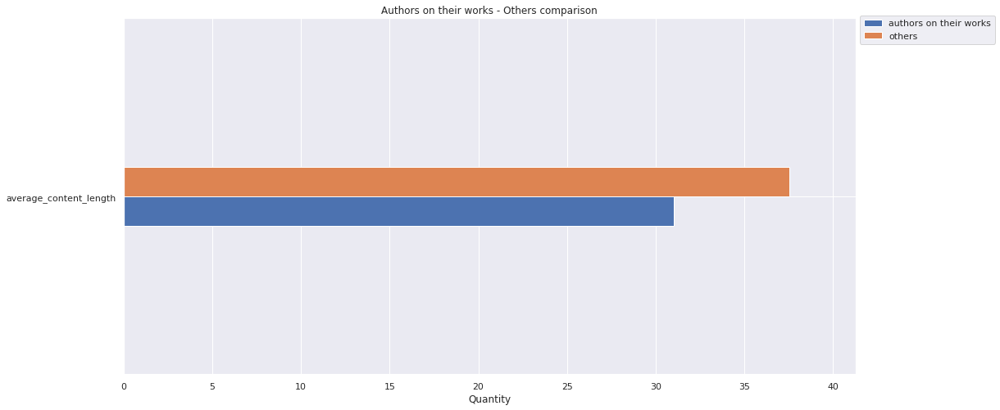

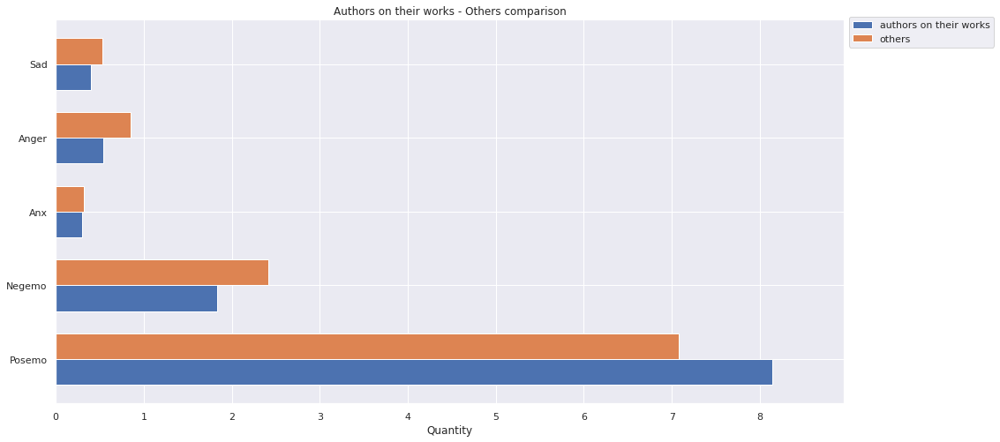

In [320]:
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(others_comparison.sum().to_frame().transpose()).transpose().rename(columns={0:'others'})],axis=1).reset_index(level=0)[:1].set_index('index'),
             "Authors on their works - Others comparison")
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(others_comparison.sum().to_frame().transpose()).transpose().rename(columns={0:'others'})],axis=1).reset_index(level=0)[1:2].set_index('index'),
             "Authors on their works - Others comparison")
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(others_comparison.sum().to_frame().transpose()).transpose().rename(columns={0:'others'})],axis=1).reset_index(level=0)[2:3].set_index('index'),
             "Authors on their works - Others comparison")
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(others_comparison.sum().to_frame().transpose()).transpose().rename(columns={0:'others'})],axis=1).reset_index(level=0)[3:8].set_index('index'),
             "Authors on their works - Others comparison", fmt='%.2f', width=0.7)

In [ ]:
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[:1],
#              "Very Authors - Others comparison", "very authors", "others", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[1:2],
#              "Very Authors - Others comparison", "very authors", "others", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[2:3],
#              "Very Authors - Others comparison", "very authors", "others", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[3:],
#              "Very Authors - Others comparison", "very authors", "others")

Below we calculate deltas to compare them among different communities.

In [ ]:
very_authors_vs_others_comparison["marvel"] = pd.concat([pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'very_authors'}),
                                                                      calculate_percentages_avg(others_comparison.sum().to_frame().transpose()).transpose().rename(columns={0:'others'})],axis=1).reset_index(level=0),
                                                           pd.DataFrame(list(zip(['Number of users'],
                                                                                 [len(list(dict.fromkeys(authors_on_their_works["marvel"].index.get_level_values('comment_author'))))],
                                                                                 [len(list(dict.fromkeys(others_comparison.index.get_level_values('comment_author'))))])),
                                                                        columns=['index', 'very_authors', 'others'])],axis=0)
very_authors_vs_others_comparison["marvel"]['score_diff'] = very_authors_vs_others_comparison["marvel"]['very_authors'] - very_authors_vs_others_comparison["marvel"]['others']
very_authors_vs_others_comparison["marvel"]

And now again the same thing but taking into account **only the authors**. This somewhat anticipates the "How does an author act when they are and when they are not?" discussion.

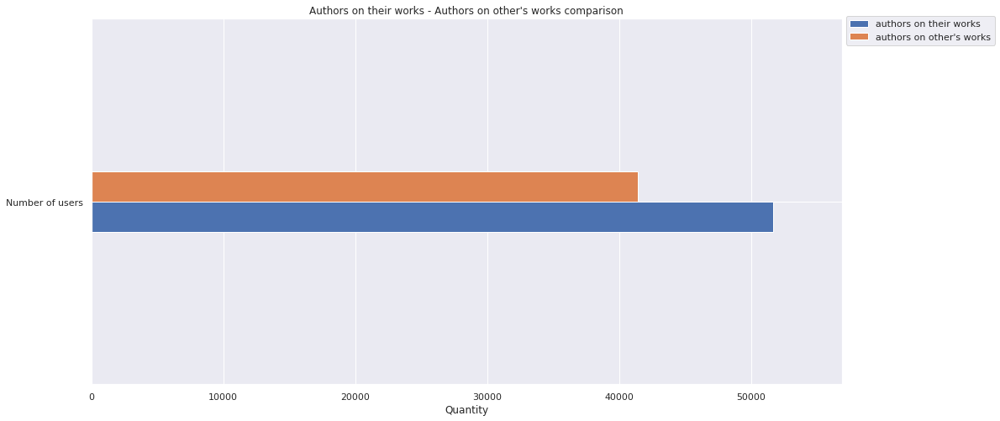

In [321]:
bar_chart(pd.DataFrame(list(zip(['Number of users'],
                                    [len(list(dict.fromkeys(authors_on_their_works["marvel"].index.get_level_values('comment_author'))))],
                                    [len(list(dict.fromkeys(authors_on_others_works["marvel"].index.get_level_values('comment_author'))))])),
                  columns=['index', 'authors on their works', 'authors on other\'s works']).set_index('index'),
             "Authors on their works - Authors on other's works comparison")

In [ ]:
# show_distance(pd.DataFrame(list(zip(['Number of users'],
#                                     [len(list(dict.fromkeys(author_and_self.index.get_level_values('comment_author'))))],
#                                     [len(list(dict.fromkeys(others.index.get_level_values('comment_author'))))])),
#                   columns=['index', 'author', 'non-author']),
#              "Author - Non Author comparison", "author", "non author", change_ylim=True)

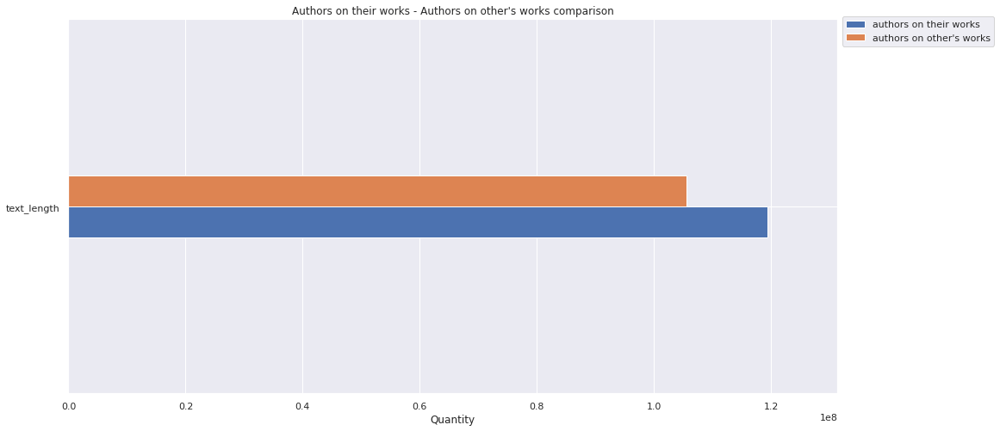

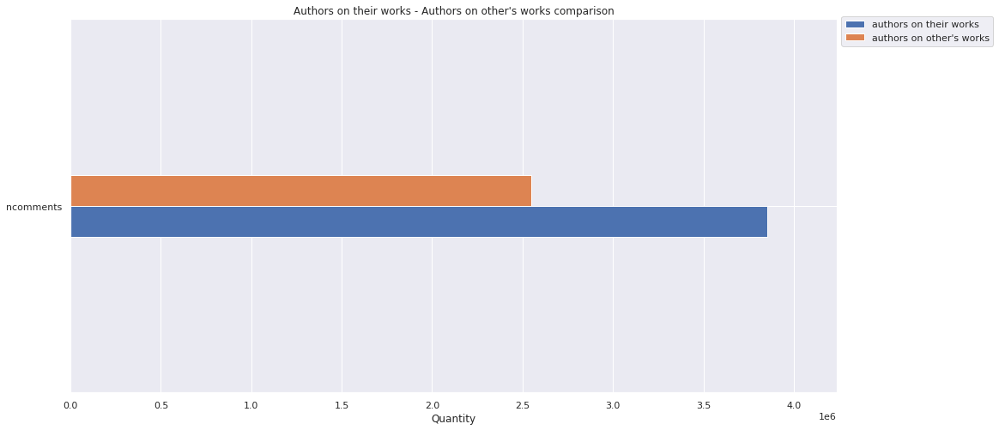

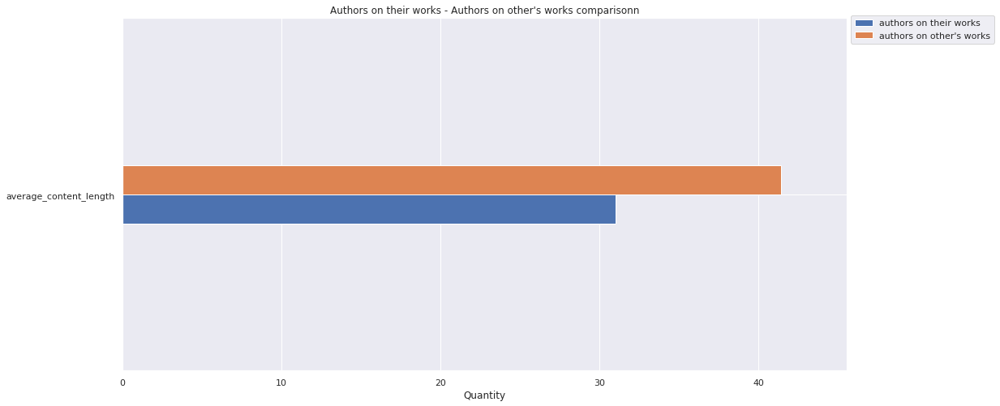

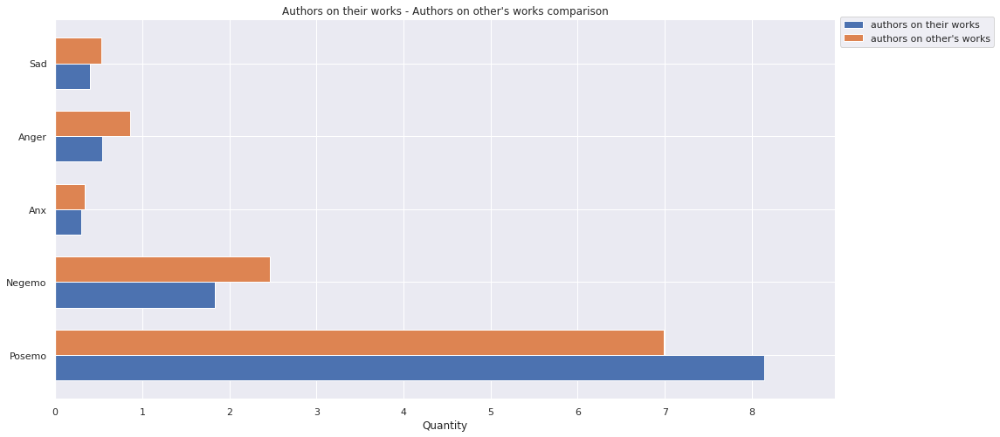

In [322]:
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(authors_on_others_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on other\'s works'})],axis=1).reset_index(level=0)[:1].set_index('index'),
             "Authors on their works - Authors on other's works comparison")
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(authors_on_others_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on other\'s works'})],axis=1).reset_index(level=0)[1:2].set_index('index'),
             "Authors on their works - Authors on other's works comparison")
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(authors_on_others_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on other\'s works'})],axis=1).reset_index(level=0)[2:3].set_index('index'),
             "Authors on their works - Authors on other's works comparisonn")
bar_chart(pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on their works'}),
                         calculate_percentages_avg(authors_on_others_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'authors on other\'s works'})],axis=1).reset_index(level=0)[3:8].set_index('index'),
             "Authors on their works - Authors on other's works comparison", fmt='%.2f', width=0.7)

In [ ]:
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[:1],
#              "Author - Non Author comparison", "author", "non author", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[1:2],
#              "Author - Non Author comparison", "author", "non author", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[2:3],
#              "Author - Non Author comparison", "author", "non author", change_ylim=True)
# show_distance(pd.concat([calculate_percentages_avg(author_and_self.sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
#                          calculate_percentages_avg(others.sum().to_frame().transpose()).transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[3:],
#              "Author - Non Author comparison", "author", "non author")

Below we calculate deltas to compare them among different communities.

In [ ]:
author_vs_non_author_comparison["marvel"] = pd.concat([pd.concat([calculate_percentages_avg(authors_on_their_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'author'}),
                                                                    calculate_percentages_avg(authors_on_others_works["marvel"].sum().to_frame().transpose()).transpose().rename(columns={0:'non_author'})],axis=1).reset_index(level=0),
                                                         pd.DataFrame(list(zip(['Number of users'],
                                                                               [len(list(dict.fromkeys(authors_on_their_works["marvel"].index.get_level_values('comment_author'))))],
                                                                               [len(list(dict.fromkeys(authors_on_others_works["marvel"].index.get_level_values('comment_author'))))])),
                                                                      columns=['index', 'author', 'non_author'])],axis=0)
author_vs_non_author_comparison["marvel"]['score_diff'] = author_vs_non_author_comparison["marvel"]['author'] - author_vs_non_author_comparison["marvel"]['non_author']
author_vs_non_author_comparison["marvel"]

Let us now analyze by individual **work**.

How differently will the author act in his or her comments than others?

In [ ]:
# work = 24474598

In [ ]:
# print(f'The author of work {work} is {authors_wid["marvel"][work]}')

In [ ]:
# author = calculate_percentages_avg(community_by_author["marvel"].iloc[(community_by_author["marvel"].index.get_level_values('work_id') == work) & (community_by_author["marvel"].index.get_level_values('comment_author') == authors_wid["marvel"][work])].sum().to_frame().transpose())
# author

In [ ]:
# others = calculate_percentages_avg(pd.concat([community_by_user["marvel"].iloc[community_by_user["marvel"].index.get_level_values('work_id') == work], community_by_author["marvel"].iloc[(community_by_author["marvel"].index.get_level_values('work_id') == work) & (community_by_author["marvel"].index.get_level_values('comment_author') != authors_wid["marvel"][work])]], axis=0).sum().to_frame().transpose())
# others

In [ ]:
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          others.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[:1],
#              "Author - Others comparison", "author", "others", change_ylim=True)
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          others.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[1:2],
#              "Author - Others comparison", "author", "others", change_ylim=True)
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          others.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[2:3],
#              "Author - Others comparison", "author", "others", change_ylim=True)
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          others.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[3:],
#              "Author - Others comparison", "author", "others")

In [ ]:
# temp = pd.DataFrame()
# #author_positivity and others_positivity will be Z-Score normalized later on
# temp['author_positivity'] = [ float(round((author['Posemo']-author['Negemo']), 2)) ]
# temp['others_positivity'] = [ float(round((others['Posemo']-others['Negemo']), 2)) ]
# for category in liwc_categories_main:
#     temp[f'author_vs_others_{category}'] = [ float(round((author[category]-others[category]), 2)) ]
# temp

And now all at once!

In [ ]:
columns = { 'work_id': [], 'text_length_author': [], 'ncomments_author': [], 'average_content_length_author': [], 
           'Posemo_author': [], 'Negemo_author': [], 'Anx_author': [], 'Anger_author': [], 'Sad_author': [], 'Ppron_author': [], 'I_author': [], 'SheHe_author': [], 'We_author': [], 'They_author': [], 'You_author': [], 
           'Ipron_author': [], 'Male_author': [], 'Female_author': [], 'See_author': [], 'Hear_author': [], 'Feel_author': [], 'text_length_others': [], 'ncomments_others': [], 
           'average_content_length_others': [], 'Posemo_others': [], 'Negemo_others': [], 'Anx_others': [], 'Anger_others': [], 'Sad_others': [], 'Ppron_others': [], 'I_others': [], 
           'SheHe_others': [], 'We_others': [], 'They_others': [], 'You_others': [], 'Ipron_others': [], 'Male_others': [], 'Female_others': [], 'See_others': [], 'Hear_others': [], 
           'Feel_others': [], 'author_vs_others_Posemo': [], 'author_vs_others_Negemo': [], 'author_vs_others_Anx': [], 'author_vs_others_Anger': [], 'author_vs_others_Sad': [], 
           'author_vs_others_Ppron': [], 'author_vs_others_I': [], 'author_vs_others_SheHe': [], 'author_vs_others_We': [], 'author_vs_others_They': [], 'author_vs_others_You': [], 
           'author_vs_others_Ipron': [], 'author_vs_others_Male': [], 'author_vs_others_Female': [], 'author_vs_others_See': [], 'author_vs_others_Hear': [], 'author_vs_others_Feel': [] }

for work in authors_wid["marvel"].keys():
    columns['work_id'].append(work)
    author = calculate_percentages_avg(community_by_author["marvel"].iloc[(community_by_author["marvel"].index.get_level_values('work_id') == work) & (community_by_author["marvel"].index.get_level_values('comment_author') == authors_wid["marvel"][work])].sum().to_frame().transpose()).add_suffix('_author')
    others = calculate_percentages_avg(pd.concat([community_by_user["marvel"].iloc[community_by_user["marvel"].index.get_level_values('work_id') == work], community_by_author["marvel"].iloc[(community_by_author["marvel"].index.get_level_values('work_id') == work) & (community_by_author["marvel"].index.get_level_values('comment_author') != authors_wid["marvel"][work])]], axis=0).sum().to_frame().transpose()).add_suffix('_others')
    for column in author.columns:
        columns[column].append(author.at[0,column])
    for column in others.columns:
        columns[column].append(others.at[0,column])
    for category in liwc_categories_main:
        columns[f'author_vs_others_{category}'].append(float(round((author[f'{category}_author']-others[f'{category}_others']), 2)))

author_vs_others_per_work["marvel"] = pd.DataFrame(data=columns).set_index('work_id')
#Z-Score normalization WIP
# author_vs_others_per_work["marvel"]['author_positivity'] = (((author_vs_others_per_work["marvel"]['Posemo_author'] - author_vs_others_per_work["marvel"]['Posemo_author'].mean()) / author_vs_others_per_work["marvel"]['Posemo_author'].std())-((author_vs_others_per_work["marvel"]['Negemo_author'] - author_vs_others_per_work["marvel"]['Negemo_author'].mean()) / author_vs_others_per_work["marvel"]['Negemo_author'].std()))
# author_vs_others_per_work["marvel"]['others_positivity'] = (((author_vs_others_per_work["marvel"]['Posemo_others'] - author_vs_others_per_work["marvel"]['Posemo_others'].mean()) / author_vs_others_per_work["marvel"]['Posemo_others'].std())-((author_vs_others_per_work["marvel"]['Negemo_others'] - author_vs_others_per_work["marvel"]['Negemo_others'].mean()) / author_vs_others_per_work["marvel"]['Negemo_others'].std()))
author_vs_others_per_work["marvel"]

In [323]:
author_vs_others_per_work["marvel"].describe()

,text_length_author,ncomments_author,average_content_length_author,Posemo_author,Negemo_author,Anx_author,Anger_author,Sad_author,Ppron_author,I_author,...,author_vs_others_SheHe,author_vs_others_We,author_vs_others_They,author_vs_others_You,author_vs_others_Ipron,author_vs_others_Male,author_vs_others_Female,author_vs_others_See,author_vs_others_Hear,author_vs_others_Feel
count,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,...,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000,295172.000000
mean,404.550591,13.050672,22.942880,10.313040,1.194895,0.184159,0.305334,0.344748,11.939558,5.171059,...,-0.576871,-0.040972,-0.206928,3.060577,-2.401308,-0.557190,-0.221168,-0.628204,-0.153793,-0.466360
std,2013.281388,48.660631,29.784149,10.200485,2.046537,0.589421,0.868162,1.314744,8.346601,4.111717,...,2.031372,0.789829,1.462147,6.864945,5.278466,1.982941,1.170843,2.035004,1.160474,1.767662
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-50.000000,-50.000000,-100.000000,-50.000000,-100.000000,-50.000000,-50.000000,-100.000000,-50.000000,-100.000000
25%,13.000000,1.000000,5.750000,3.880000,0.000000,0.000000,0.000000,0.000000,8.000000,0.000000,...,-1.330000,-0.100000,-0.620000,-0.360000,-5.120000,-1.270000,-0.230000,-1.060000,-0.410000,-0.780000
50%,73.000000,4.000000,16.000000,8.770000,0.580000,0.000000,0.000000,0.000000,12.500000,5.530000,...,-0.110000,0.000000,0.000000,1.480000,-1.390000,-0.160000,0.000000,-0.380000,0.000000,-0.130000
75%,244.000000,10.000000,30.000000,13.920000,1.850000,0.140000,0.350000,0.310000,16.070000,7.690000,...,0.000000,0.000000,0.000000,4.790000,0.370000,0.000000,0.000000,0.000000,0.000000,0.000000
max,202897.000000,3213.000000,1574.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,87.500000,50.000000,50.000000,100.000000,100.000000,96.700000,46.450000,50.000000,50.000000,100.000000


Before we proceed to analyze any correlations, let's take a look at the **most commonly used words** for each of the major LIWC categories.

In [ ]:
columns = { 'word': [], 'categories': [], 'frequency': [] }
author_text = ""
others_text = ""

for work in authors_wid["marvel"].keys():
    try:
        author_text += " " + community_by_author_only_text["marvel"].iloc[(community_by_author_only_text["marvel"].index.get_level_values('work_id') == work) & (community_by_author_only_text["marvel"].index.get_level_values('comment_author') == authors_wid["marvel"][work])]['text'].values[0]
        others_text += " " + pd.concat([community_by_user_only_text["marvel"].iloc[community_by_user_only_text["marvel"].index.get_level_values('work_id') == work], community_by_author_only_text["marvel"].iloc[(community_by_author_only_text["marvel"].index.get_level_values('work_id') == work) & (community_by_author_only_text["marvel"].index.get_level_values('comment_author') != authors_wid["marvel"][work])]], axis=0)['text'].values[0]
    except:
        author_text += ""
        others_text += ""

text_tokens = tokenize(author_text)
text_words = Counter(token for token in text_tokens)
for word in text_words:
    columns['word'].append(word)
    columns['frequency'].append(text_words[word])
    columns['categories'].append(' '.join(list(parse(word))))

word_frequency_author_vs_others_author["marvel"] = pd.DataFrame(data=columns)

columns = { 'word': [], 'categories': [], 'frequency': [] }

text_tokens = tokenize(others_text)
text_words = Counter(token for token in text_tokens)
for word in text_words:
    columns['word'].append(word)
    columns['frequency'].append(text_words[word])
    columns['categories'].append(' '.join(list(parse(word))))
    
word_frequency_author_vs_others_others["marvel"] = pd.DataFrame(data=columns)

**Posemo**

Author

In [324]:
res = word_frequency_author_vs_others_author["marvel"][word_frequency_author_vs_others_author["marvel"]['categories'].str.contains("Posemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,8,glad,Adj Affect Posemo,699269
2,1,thank,Verb Affect Posemo FocusPresent,537873
3,111,love,Affect Posemo Social Bio Drives Affiliation,339397
4,29,enjoyed,Affect Posemo,270551
5,513,liked,Verb Affect Posemo FocusPast,268076
6,468,happy,Adj Affect Posemo,233418
7,441,good,Affect Posemo Drives Reward,183370
8,34,hope,Verb Affect Posemo CogProc Discrep Tentat Focu...,168839
9,143,well,Function Adverb Affect Posemo Informal Nonflu,160869
10,857,kind,Affect Posemo,145006


Others

In [325]:
res = word_frequency_author_vs_others_others["marvel"][word_frequency_author_vs_others_others["marvel"]['categories'].str.contains("Posemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,52,love,Affect Posemo Social Bio Drives Affiliation,80639
2,166,good,Affect Posemo Drives Reward,31415
3,167,well,Function Adverb Affect Posemo Informal Nonflu,19396
4,54,great,Adj Affect Posemo Drives Reward,19389
5,81,loved,Affect Posemo Social Bio Drives Affiliation,18418
6,731,cute,Adj Affect Posemo,16366
7,1169,amazing,Adj Affect Posemo,14451
8,917,hope,Verb Affect Posemo CogProc Discrep Tentat Focu...,13434
9,385,sweet,Adj Affect Posemo Percept Bio Ingest,13268
10,97,thank,Verb Affect Posemo FocusPresent,11036


**Negemo**

Author

In [326]:
res = word_frequency_author_vs_others_author["marvel"][word_frequency_author_vs_others_author["marvel"]['categories'].str.contains("Negemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,41,sorry,Adj Affect Negemo Sad,92291
2,2562,bad,Affect Negemo Drives Risk,58391
3,2604,worry,Verb Affect Negemo Anx FocusPresent,41845
4,2071,poor,Adj Affect Negemo Drives Power Money,30531
5,3688,sad,Adj Affect Negemo Sad,28121
6,786,wrong,Adj Affect Negemo Drives Risk,26979
7,374,shit,Affect Negemo Anger Bio Body Informal Swear,26465
8,2660,hurt,Affect Negemo Sad Percept Feel,25188
9,1400,weird,Adj Affect Negemo,21448
10,1893,hate,Verb Affect Negemo Anger FocusPresent,20890


Others

In [327]:
res = word_frequency_author_vs_others_others["marvel"][word_frequency_author_vs_others_others["marvel"]['categories'].str.contains("Negemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,1016,sad,Adj Affect Negemo Sad,5827
2,135,bad,Affect Negemo Drives Risk,5288
3,1249,poor,Adj Affect Negemo Drives Power Money,4477
4,1526,sorry,Adj Affect Negemo Sad,3868
5,101,shit,Affect Negemo Anger Bio Body Informal Swear,3609
6,1251,fucking,Adj Affect Negemo Anger Bio Sexual Informal Swear,3342
7,134,hurt,Affect Negemo Sad Percept Feel,3255
8,1902,cry,Verb Affect Negemo Sad,3218
9,1171,crying,Verb Affect Negemo Sad,2952
10,162,damn,Affect Negemo Anger Informal Swear,2924


And now let's look at correlations.

In [328]:
mask1 = (author_vs_others_per_work["marvel"]['text_length_author']>50) & (author_vs_others_per_work["marvel"]['text_length_others']>50)

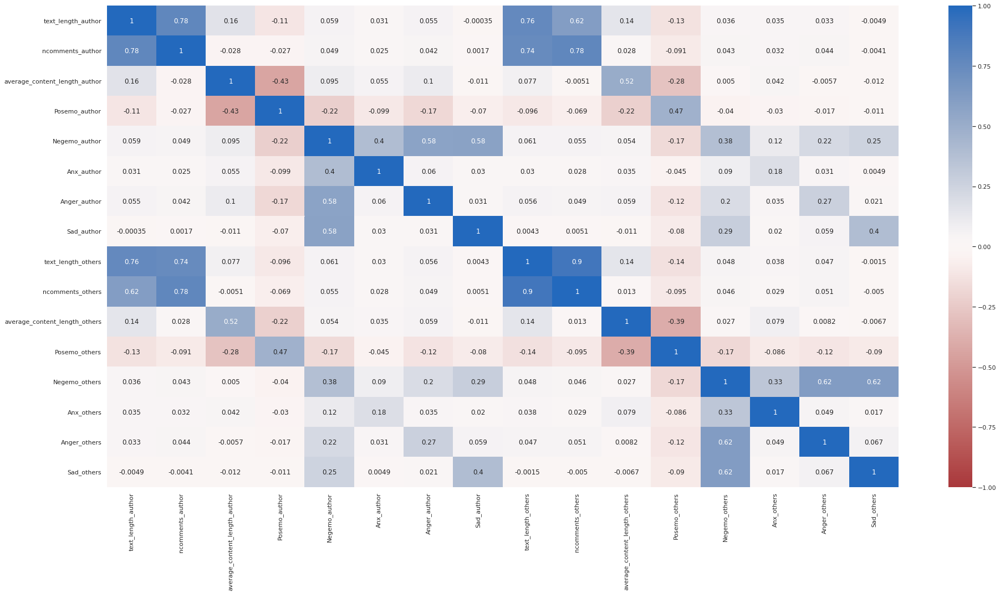

In [329]:
data = {'text_length_author': author_vs_others_per_work["marvel"][mask1]['text_length_author'], 
        'ncomments_author': author_vs_others_per_work["marvel"][mask1]['ncomments_author'], 
        'average_content_length_author': author_vs_others_per_work["marvel"][mask1]['average_content_length_author'], 
        'Posemo_author': author_vs_others_per_work["marvel"][mask1]['Posemo_author'], 
        'Negemo_author': author_vs_others_per_work["marvel"][mask1]['Negemo_author'], 
        'Anx_author': author_vs_others_per_work["marvel"][mask1]['Anx_author'], 
        'Anger_author': author_vs_others_per_work["marvel"][mask1]['Anger_author'], 
        'Sad_author': author_vs_others_per_work["marvel"][mask1]['Sad_author'], 
        'text_length_others': author_vs_others_per_work["marvel"][mask1]['text_length_others'], 
        'ncomments_others': author_vs_others_per_work["marvel"][mask1]['ncomments_others'], 
        'average_content_length_others': author_vs_others_per_work["marvel"][mask1]['average_content_length_others'], 
        'Posemo_others': author_vs_others_per_work["marvel"][mask1]['Posemo_others'], 
        'Negemo_others': author_vs_others_per_work["marvel"][mask1]['Negemo_others'], 
        'Anx_others': author_vs_others_per_work["marvel"][mask1]['Anx_others'], 
        'Anger_others': author_vs_others_per_work["marvel"][mask1]['Anger_others'], 
        'Sad_others': author_vs_others_per_work["marvel"][mask1]['Sad_others']
        }
df = pd.DataFrame(data,columns=['text_length_author', 
                                'ncomments_author', 
                                'average_content_length_author', 
                                'Posemo_author', 
                                'Negemo_author', 
                                'Anx_author', 
                                'Anger_author', 
                                'Sad_author', 
                                'text_length_others', 
                                'ncomments_others', 
                                'average_content_length_others', 
                                'Posemo_others', 
                                'Negemo_others', 
                                'Anx_others', 
                                'Anger_others', 
                                'Sad_others'
                               ])
plt.figure(figsize=(32, 16))
corrMatrix = df.corr()
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

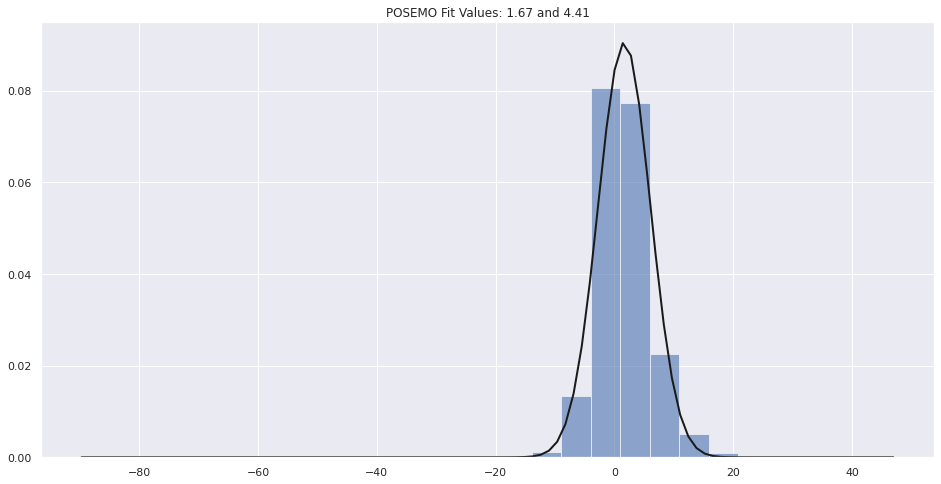

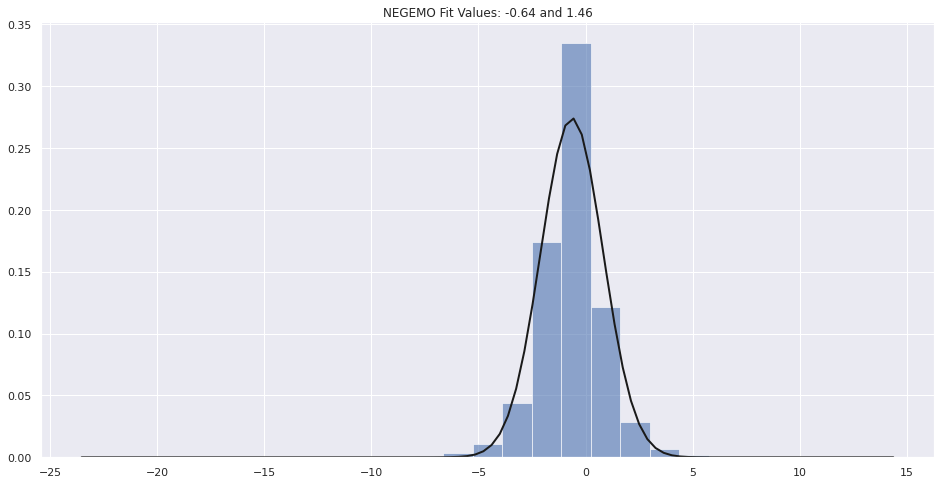

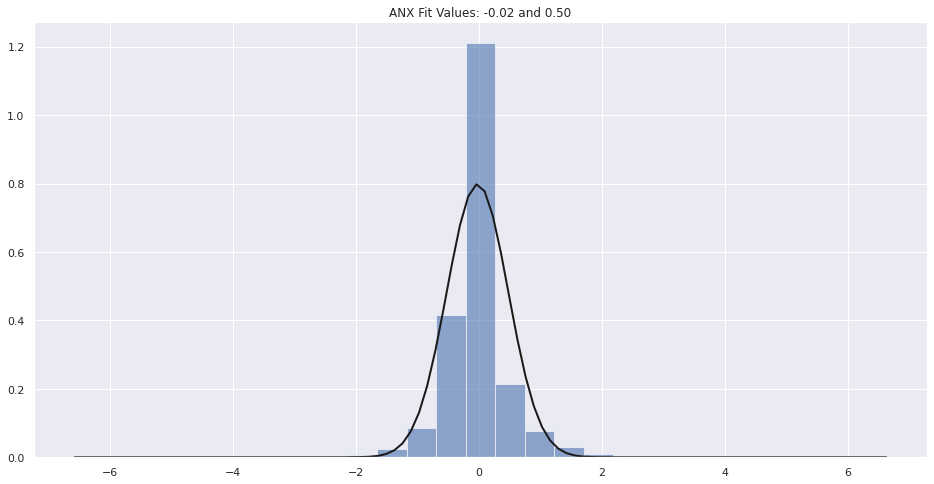

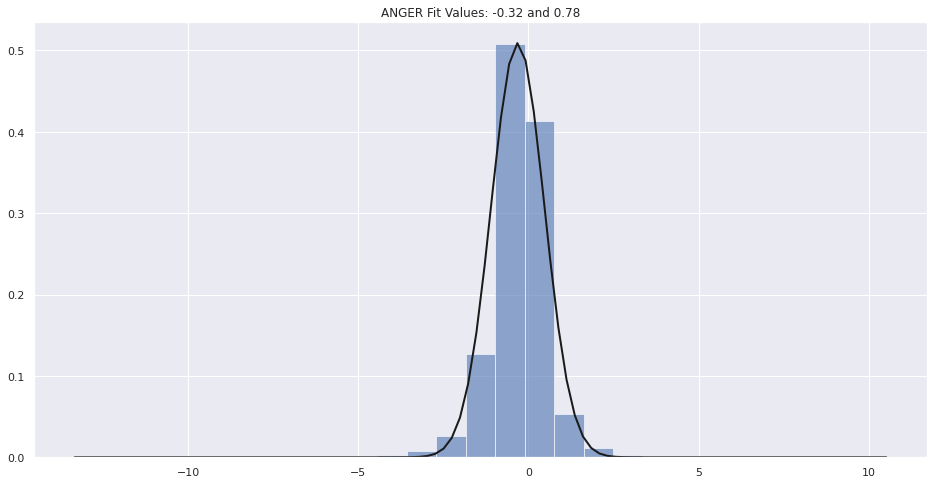

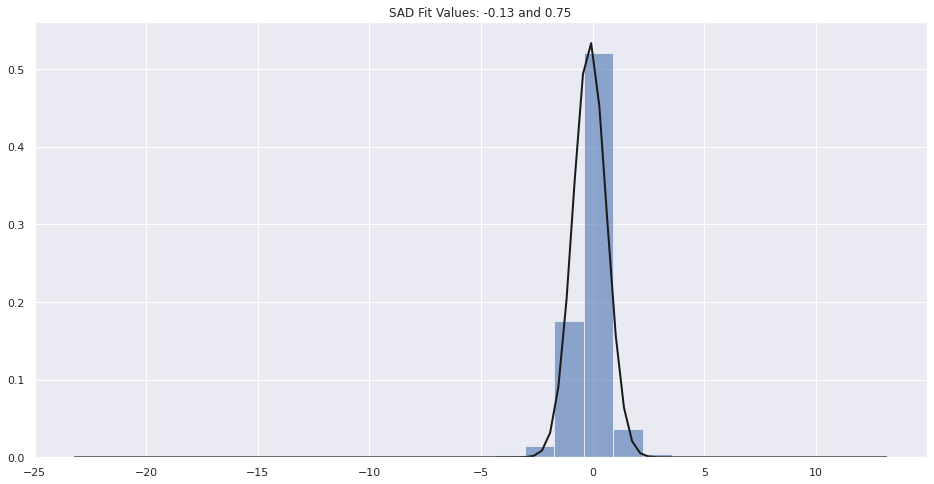

...

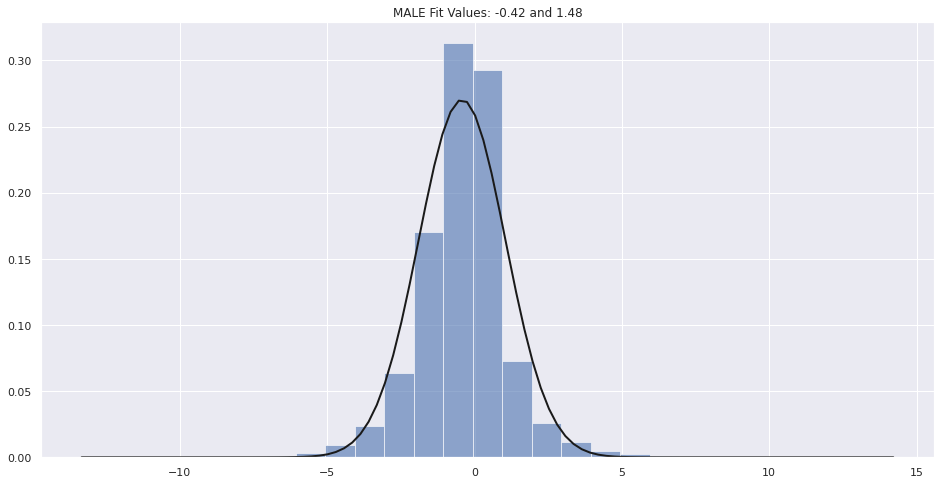

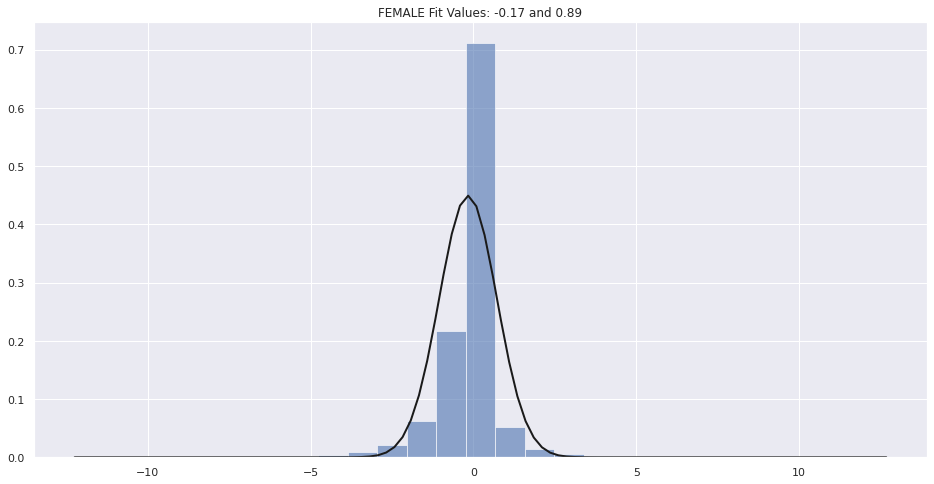

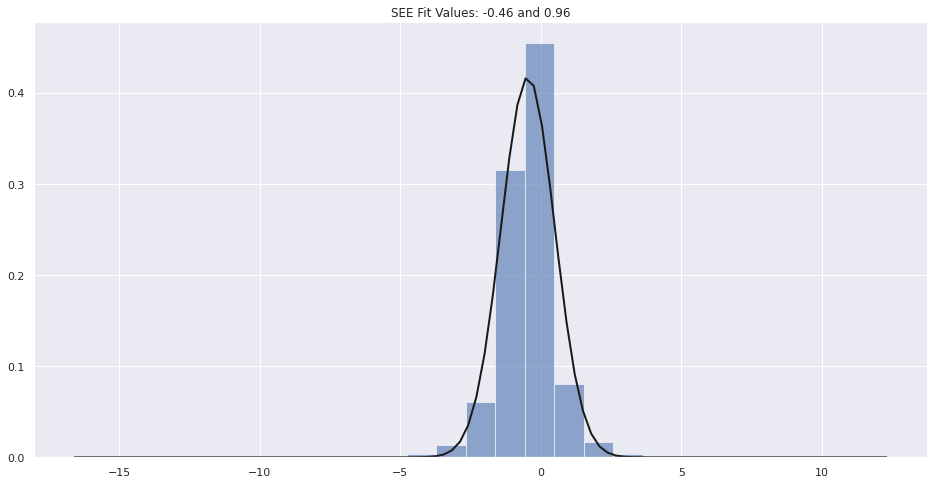

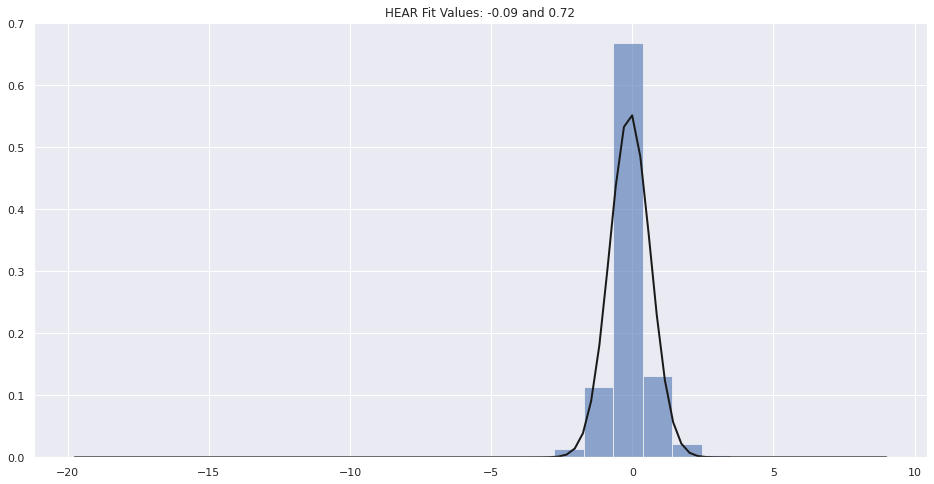

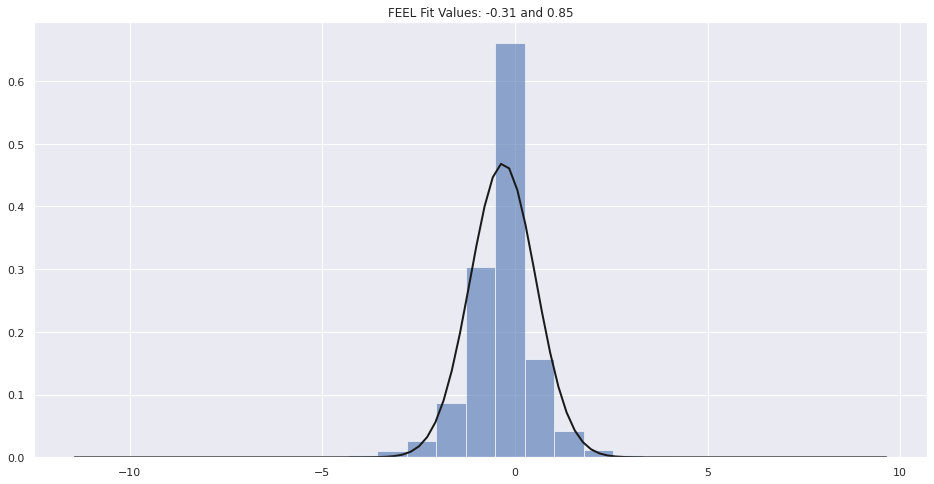

In [330]:
for category in liwc_categories_main:
    plt.figure(figsize=(16, 8))
    data = author_vs_others_per_work["marvel"][mask1][f'author_vs_others_{category}'] 
    #Fit a normal distribution to the data: mean and standard deviation
    mu, std = norm.fit(data)  
    #Plot the histogram
    plt.hist(data, bins=25, density=True, alpha=0.6, color='b')
    #Plot the PDF
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, 'k', linewidth=2)
    title = "{} Fit Values: {:.2f} and {:.2f}".format(category.upper(), mu, std)
    plt.title(title)
    plt.show()

And now we're looking for correlations, also adding Andrea's metrics.

Recall the meaning of some metrics:
- **Relevant users**: utenti distinti che hanno commentato sotto ad un work (compreso l'autore).
- **Relevant interactions**: numero di interazioni tra gli utenti che hanno commentato sotto ad un work, dove l'interazione è uno o più commenti in risposta.
- **Clustering coeff**: misura di quanto gli user sotto a un work si scrivono tra di loro, ovvero di quanto è social la rete dei commenti sotto ad un work.
- **Reciprocity**: misura di quanto gli user tendono a rispondere a chi gli ha commentato.
- **Ncomments**: numero di commenti totali sotto a un work.
- **Tree Height**: altezza della thread più lunga.
- **Breadth**: numero di risposte al commento con maggiore reply.
- **Breadthest Layer**: profondità del commento con maggiore reply.
- **Is author most active user?**
- **% Author Comments**: percentuale di commenti dell'autore sul totale di commenti.
- **% Author-replied comments**: percentuale di commenti a cui l'autore ha risposto (esclusi i suoi commenti).
- **Distinct Users**: numero di user che partecipano ai commenti sotto al work.
- **Avg. Comments per user**: media di commenti per utente (compreso l'autore).
- **Avg. Comments per user (no author)**: media di commenti per utente (senza l'autore).
- **Avg Thread Length**: lunghezza media di una thread.
- **% Single Comments**: percentuale di commenti singoli sul totale, ovvero commenti che non danno origine a una conversazione.
- **% Threads long 1 or 2**: percentuale di threads lunghi 1 o 2.
- **% Threads longer than 3**: percentuale di threads più lunghi di 3.
- **% Threads longer than 5**: percentuale di threads più lunghi di 5.
- **% Threads longer than 10**: percentuale di threads più lunghi di 10.
- **% Thread where user has last word**: percentuale di conversazioni dove l'autore è l'ultimo a scrivere.
- **Avg % Author Replies in Thread**: partecipazione media dell'autore in una conversazione.
- **Avg % Author Replies in Threads longer than 3**: partecipazione media dell'autore in una conversazione più lunga di 3.
- **Avg % Author Replies in Threads longer than 5**: partecipazione media dell'autore in una conversazione più lunga di 5.
- **Avg % Author Replies in Threads longer than 10**: partecipazione media dell'autore in una conversazione più lunga di 10.

In [331]:
joint_analysis = analysed_works_all_communities.join(author_vs_others_per_work["marvel"][mask1])
nkudos_joint = []
for work in joint_analysis.index:
    row_index = works_dfs["marvel"].index[works_dfs["marvel"]["id"] == work].tolist()[0]
    nkudos_joint.append(works_dfs["marvel"]['nkudos'][row_index])
joint_analysis['nkudos'] = nkudos_joint
joint_analysis

,Nodes,Edges,Clustering coeff,Reciprocity,Ncomments,Tree Height,Breadth,Breadthest Layer,is Author most active user?,% Author Comments,...,author_vs_others_We,author_vs_others_They,author_vs_others_You,author_vs_others_Ipron,author_vs_others_Male,author_vs_others_Female,author_vs_others_See,author_vs_others_Hear,author_vs_others_Feel,nkudos
workid,,,,,,,,,,,,,,,,,,,,,
16769773,17.0,28.0,0.0,0.857143,30.0,3.0,16.0,1.0,yes,40.000000,...,-0.71,0.88,2.69,-1.75,-1.02,0.00,-0.74,-0.50,0.15,233
16704133,12.0,21.0,0.0,0.952381,27.0,4.0,13.0,1.0,yes,44.444444,...,0.31,0.92,3.07,-1.97,-0.66,0.00,0.00,-0.35,-0.35,145
9821255,24.0,29.0,0.0,0.413793,32.0,2.0,26.0,1.0,yes,18.750000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,832
9417707,17.0,22.0,0.0,0.545455,23.0,3.0,16.0,1.0,yes,26.086957,...,-0.21,-1.27,13.79,3.46,-1.48,0.00,0.00,-2.75,-0.63,572
9340169,22.0,34.0,0.0,0.764706,34.0,2.0,21.0,1.0,yes,38.235294,...,-0.51,-0.17,2.99,-2.24,4.68,0.00,-0.20,-0.17,1.07,1013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
458152,20.0,34.0,0.0,0.882353,70.0,5.0,37.0,1.0,yes,38.571429,...,-0.39,0.10,-0.02,-0.49,0.71,0.82,-0.77,-0.06,0.42,237
424187,31.0,60.0,0.0,1.000000,71.0,4.0,33.0,1.0,yes,49.295775,...,0.05,0.25,0.06,-0.22,0.10,0.00,-0.94,-0.07,-0.40,225
421212,29.0,40.0,0.0,0.600000,46.0,3.0,31.0,1.0,yes,26.086957,...,0.00,-0.48,1.52,-0.36,-0.60,0.00,-1.08,-0.16,0.31,171


In [332]:
joint_analysis.describe()

,Nodes,Edges,Clustering coeff,Reciprocity,Ncomments,Tree Height,Breadth,Breadthest Layer,% Author Comments,% Author-replied comments,...,author_vs_others_We,author_vs_others_They,author_vs_others_You,author_vs_others_Ipron,author_vs_others_Male,author_vs_others_Female,author_vs_others_See,author_vs_others_Hear,author_vs_others_Feel,nkudos
count,96973.000000,96973.000000,96900.000000,96973.000000,96973.000000,96973.000000,96973.000000,96973.000000,96973.000000,96973.000000,...,87189.000000,87189.000000,87189.000000,87189.000000,87189.000000,87189.000000,87189.000000,87189.000000,87189.000000,96973.000000
mean,35.476823,54.944304,0.003698,0.737993,95.305518,4.223815,55.914904,0.999876,34.892888,61.111173,...,-0.007675,-0.078777,2.853581,-0.749891,-0.441008,-0.147655,-0.444824,-0.085912,-0.296653,690.489621
std,51.998503,77.177256,0.020180,0.314692,204.786485,5.051249,124.742665,0.011123,15.802664,32.567478,...,0.393746,0.736219,3.260811,2.022564,1.211456,0.676028,0.694334,0.545981,0.641882,1090.374589
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-13.050000,-6.220000,-11.340000,-27.990000,-9.510000,-8.700000,-9.390000,-18.450000,-8.640000,0.000000
25%,14.000000,23.000000,0.000000,0.592593,28.000000,2.000000,16.000000,1.000000,26.388889,35.483871,...,-0.180000,-0.470000,0.630000,-1.870000,-1.100000,-0.300000,-0.800000,-0.360000,-0.590000,189.000000
50%,21.000000,33.000000,0.000000,0.880000,43.000000,3.000000,25.000000,1.000000,41.666667,71.428571,...,0.000000,-0.090000,2.180000,-0.630000,-0.420000,0.000000,-0.430000,-0.090000,-0.250000,381.000000
75%,37.000000,57.000000,0.000000,0.981818,84.000000,5.000000,50.000000,1.000000,47.222222,89.041096,...,0.080000,0.270000,4.330000,0.460000,0.160000,0.000000,-0.070000,0.150000,0.020000,772.000000
max,2739.000000,3870.000000,1.000000,1.000000,13197.000000,580.000000,11787.000000,1.000000,100.000000,600.000000,...,10.910000,9.790000,41.330000,12.360000,10.990000,8.250000,9.540000,6.310000,8.410000,99419.000000


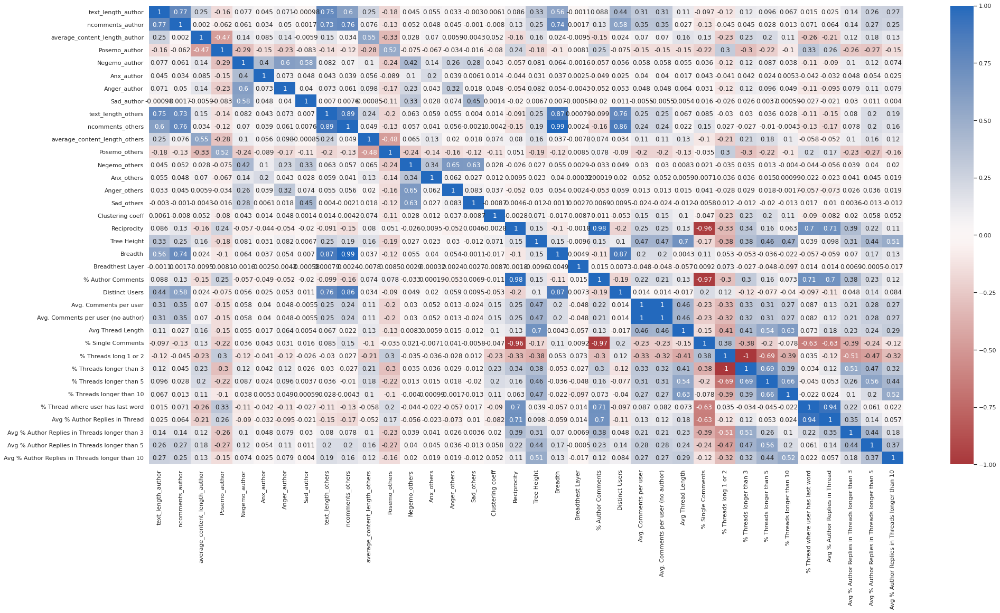

In [333]:
data = {'text_length_author': joint_analysis['text_length_author'], 
        'ncomments_author': joint_analysis['ncomments_author'], 
        'average_content_length_author': joint_analysis['average_content_length_author'], 
        'Posemo_author': joint_analysis['Posemo_author'], 
        'Negemo_author': joint_analysis['Negemo_author'], 
        'Anx_author': joint_analysis['Anx_author'], 
        'Anger_author': joint_analysis['Anger_author'], 
        'Sad_author': joint_analysis['Sad_author'], 
        'text_length_others': joint_analysis['text_length_others'], 
        'ncomments_others': joint_analysis['ncomments_others'], 
        'average_content_length_others': joint_analysis['average_content_length_others'], 
        'Posemo_others': joint_analysis['Posemo_others'], 
        'Negemo_others': joint_analysis['Negemo_others'], 
        'Anx_others': joint_analysis['Anx_others'], 
        'Anger_others': joint_analysis['Anger_others'], 
        'Sad_others': joint_analysis['Sad_others'],
        'Clustering coeff': joint_analysis['Clustering coeff'],
        'Reciprocity': joint_analysis['Reciprocity'],
        'Tree Height': joint_analysis['Tree Height'],
        'Breadth': joint_analysis['Breadth'],
        'Breadthest Layer': joint_analysis['Breadthest Layer'],
        '% Author Comments': joint_analysis['% Author Comments'],
        '% Author-replied comments': joint_analysis['% Author-replied comments'],
        'Distinct Users': joint_analysis['Distinct Users'],
        'Avg. Comments per user': joint_analysis['Avg. Comments per user'],
        'Avg. Comments per user (no author)': joint_analysis['Avg. Comments per user (no author)'],
        'Avg Thread Length': joint_analysis['Avg Thread Length'],
        '% Single Comments': joint_analysis['% Single Comments'],
        '% Threads long 1 or 2': joint_analysis['% Threads long 1 or 2'],
        '% Threads longer than 3': joint_analysis['% Threads longer than 3'],
        '% Threads longer than 5': joint_analysis['% Threads longer than 5'],
        '% Threads longer than 10': joint_analysis['% Threads longer than 10'],
        '% Thread where user has last word': joint_analysis['% Thread where user has last word'],
        'Avg % Author Replies in Thread': joint_analysis['Avg % Author Replies in Thread'],
        'Avg % Author Replies in Threads longer than 3': joint_analysis['Avg % Author Replies in Threads longer than 3'],
        'Avg % Author Replies in Threads longer than 5': joint_analysis['Avg % Author Replies in Threads longer than 5'],
        'Avg % Author Replies in Threads longer than 10': joint_analysis['Avg % Author Replies in Threads longer than 10']
        }
df = pd.DataFrame(data,columns=['text_length_author', 
                                'ncomments_author', 
                                'average_content_length_author', 
                                'Posemo_author', 
                                'Negemo_author', 
                                'Anx_author', 
                                'Anger_author', 
                                'Sad_author', 
                                'text_length_others', 
                                'ncomments_others', 
                                'average_content_length_others', 
                                'Posemo_others', 
                                'Negemo_others', 
                                'Anx_others', 
                                'Anger_others', 
                                'Sad_others',
                                'Clustering coeff',
                                'Reciprocity',
                                'Tree Height',
                                'Breadth',
                                'Breadthest Layer',
                                '% Author Comments',
                                '% Author-replied Comments',
                                'Distinct Users',
                                'Avg. Comments per user',
                                'Avg. Comments per user (no author)',
                                'Avg Thread Length',
                                '% Single Comments',
                                '% Threads long 1 or 2',
                                '% Threads longer than 3',
                                '% Threads longer than 5',
                                '% Threads longer than 10',
                                '% Thread where user has last word',
                                'Avg % Author Replies in Thread',
                                'Avg % Author Replies in Threads longer than 3',
                                'Avg % Author Replies in Threads longer than 5',
                                'Avg % Author Replies in Threads longer than 10'
                               ])
plt.figure(figsize=(32, 16))
corrMatrix = df.corr()
corrMatrix.to_csv('./marvel/marvel_second_comparison.csv')
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

Now let's **drill down** by **focusing on authors**. Does the same person behave differently when he/she is an author than when he/she is not an author? Maybe when they talk about their work they are positive and to the work of other authors they respond negatively.

In [ ]:
# community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == 'TheSkyclanCat']

In [ ]:
# author = calculate_percentages_avg(community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == 'TheSkyclanCat'][community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == 'TheSkyclanCat'].index.get_level_values('work_id').isin([k for k,v in authors_wid["marvel"].items() if v == 'TheSkyclanCat'])].sum().to_frame().transpose())
# author

In [ ]:
# non_author = calculate_percentages_avg(community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == 'TheSkyclanCat'][~community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == 'TheSkyclanCat'].index.get_level_values('work_id').isin([k for k,v in authors_wid["marvel"].items() if v == 'TheSkyclanCat'])].sum().to_frame().transpose())
# non_author

In [ ]:
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          non_author.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[:1],
#               "Author - Non Author comparison", "author", "non author", change_ylim=True)
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          non_author.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[1:2],
#               "Author - Non Author comparison", "author", "non author", change_ylim=True)
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          non_author.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[2:3],
#               "Author - Non Author comparison", "author", "non author", change_ylim=True)
# show_distance(pd.concat([author.transpose().rename(columns={0:'author'}),
#                          non_author.transpose().rename(columns={0:'non-author'})],axis=1).reset_index(level=0)[3:],
#              "Author - Non Author comparison", "author", "non author")

In [ ]:
# temp = pd.DataFrame()
# #author_positivity and non_author_positivity will be Z-Score normalized later on
# temp['author_positivity'] = [ float(round((author['Posemo']-author['Negemo']), 2)) ]
# temp['non_author_positivity'] = [ float(round((non_author['Posemo']-non_author['Negemo']), 2)) ]
# for category in liwc_categories_main:
#     temp[f'author_vs_non_author_{category}'] = [ float(round((author[category]-non_author[category]), 2)) ]
# temp

And now all at once!

In [ ]:
columns = { 'author': [], 'text_length_author': [], 'ncomments_author': [], 'average_content_length_author': [], 
           'Posemo_author': [], 'Negemo_author': [], 'Anx_author': [], 'Anger_author': [], 'Sad_author': [], 'Ppron_author': [], 'I_author': [], 'SheHe_author': [], 'We_author': [], 'They_author': [], 'You_author': [], 
           'Ipron_author': [], 'Male_author': [], 'Female_author': [], 'See_author': [], 'Hear_author': [], 'Feel_author': [], 'text_length_non_author': [], 'ncomments_non_author': [], 
           'average_content_length_non_author': [], 'Posemo_non_author': [], 'Negemo_non_author': [], 'Anx_non_author': [], 'Anger_non_author': [], 'Sad_non_author': [], 'Ppron_non_author': [], 'I_non_author': [], 
           'SheHe_non_author': [], 'We_non_author': [], 'They_non_author': [], 'You_non_author': [], 'Ipron_non_author': [], 'Male_non_author': [], 'Female_non_author': [], 'See_non_author': [], 'Hear_non_author': [], 
           'Feel_non_author': [], 'author_vs_non_author_Posemo': [], 'author_vs_non_author_Negemo': [], 'author_vs_non_author_Anx': [], 'author_vs_non_author_Anger': [], 'author_vs_non_author_Sad': [], 
           'author_vs_non_author_Ppron': [], 'author_vs_non_author_I': [], 'author_vs_non_author_SheHe': [], 'author_vs_non_author_We': [], 'author_vs_non_author_They': [], 'author_vs_non_author_You': [], 
           'author_vs_non_author_Ipron': [], 'author_vs_non_author_Male': [], 'author_vs_non_author_Female': [], 'author_vs_non_author_See': [], 'author_vs_non_author_Hear': [], 'author_vs_non_author_Feel': [] }

for author in authors["marvel"]:
    works = [k for k,v in authors_wid["marvel"].items() if v == author]
    columns['author'].append(author)
    non_author = calculate_percentages_avg(community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == author][~community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == author].index.get_level_values('work_id').isin(works)].sum().to_frame().transpose()).add_suffix('_non_author')
    author = calculate_percentages_avg(community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == author][community_by_author["marvel"][community_by_author["marvel"].index.get_level_values('comment_author') == author].index.get_level_values('work_id').isin(works)].sum().to_frame().transpose()).add_suffix('_author')
    for column in author.columns:
        columns[column].append(author.at[0,column])
    for column in non_author.columns:
        columns[column].append(non_author.at[0,column])
    for category in liwc_categories_main:
        columns[f'author_vs_non_author_{category}'].append(float(round((author[f'{category}_author']-non_author[f'{category}_non_author']), 2)))
    
author_vs_non_author["marvel"] = pd.DataFrame(data=columns).set_index('author')
#Z-Score normalization WIP
# author_vs_non_author["marvel"]['author_positivity'] = (((author_vs_non_author["marvel"]['Posemo_author'] - author_vs_non_author["marvel"]['Posemo_author'].mean()) / author_vs_non_author["marvel"]['Posemo_author'].std())-((author_vs_non_author["marvel"]['Negemo_author'] - author_vs_non_author["marvel"]['Negemo_author'].mean()) / author_vs_non_author["marvel"]['Negemo_author'].std()))
# author_vs_non_author["marvel"]['non_author_positivity'] = (((author_vs_non_author["marvel"]['Posemo_non_author'] - author_vs_non_author["marvel"]['Posemo_non_author'].mean()) / author_vs_non_author["marvel"]['Posemo_non_author'].std())-((author_vs_non_author["marvel"]['Negemo_non_author'] - author_vs_non_author["marvel"]['Negemo_non_author'].mean()) / author_vs_non_author["marvel"]['Negemo_non_author'].std()))
author_vs_non_author["marvel"]

In [334]:
author_vs_non_author["marvel"].describe()

,text_length_author,ncomments_author,average_content_length_author,Posemo_author,Negemo_author,Anx_author,Anger_author,Sad_author,Ppron_author,I_author,...,author_vs_non_author_SheHe,author_vs_non_author_We,author_vs_non_author_They,author_vs_non_author_You,author_vs_non_author_Ipron,author_vs_non_author_Male,author_vs_non_author_Female,author_vs_non_author_See,author_vs_non_author_Hear,author_vs_non_author_Feel
count,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,...,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000,60998.000000
mean,1957.638070,63.152776,24.211774,9.240219,1.245862,0.207356,0.305206,0.374513,11.806694,5.650013,...,0.047316,0.028947,0.074114,3.033455,-0.130853,-0.000467,0.025841,-0.224805,-0.030256,-0.153656
std,11669.094555,341.170588,27.258501,8.718760,1.875108,0.561782,0.869281,1.165508,7.535968,3.963686,...,1.768587,0.670233,1.093145,5.942302,5.456653,1.734074,0.992794,1.469581,1.128987,1.404472
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-32.900000,-20.000000,-33.330000,-46.470000,-66.670000,-32.480000,-25.000000,-50.000000,-66.670000,-100.000000
25%,21.000000,1.000000,8.480000,4.300000,0.000000,0.000000,0.000000,0.000000,8.990000,3.010000,...,-0.390000,0.000000,-0.130000,0.000000,-2.500000,-0.450000,0.000000,-0.610000,-0.200000,-0.410000
50%,126.000000,6.000000,18.695000,8.270000,1.000000,0.000000,0.000000,0.000000,12.610000,6.140000,...,0.000000,0.000000,0.000000,1.850000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,625.000000,24.000000,32.000000,12.230000,1.890000,0.280000,0.430000,0.440000,15.530000,8.000000,...,0.430000,0.000000,0.280000,4.717500,2.400000,0.330000,0.000000,0.000000,0.070000,0.000000
max,948671.000000,22718.000000,1168.000000,100.000000,100.000000,50.000000,100.000000,100.000000,100.000000,100.000000,...,98.800000,33.330000,33.330000,100.000000,42.040000,98.800000,50.000000,33.330000,50.000000,33.330000


Before we proceed to analyze any correlations, let's take a look at the **most commonly used words** for each of the major LIWC categories.

In [ ]:
columns = { 'word': [], 'categories': [], 'frequency': [] }
author_text = ""
non_author_text = ""

for author in authors["marvel"]:
    works = [k for k,v in authors_wid["marvel"].items() if v == author]
    try:
        author_text += " " + community_by_author_only_text["marvel"][community_by_author_only_text["marvel"].index.get_level_values('comment_author') == author][community_by_author_only_text["marvel"][community_by_author_only_text["marvel"].index.get_level_values('comment_author') == author].index.get_level_values('work_id').isin(works)].groupby('comment_author').agg({'text': ' '.join})['text'].values[0]
        non_author_text += " " + community_by_author_only_text["marvel"][community_by_author_only_text["marvel"].index.get_level_values('comment_author') == author][~community_by_author_only_text["marvel"][community_by_author_only_text["marvel"].index.get_level_values('comment_author') == author].index.get_level_values('work_id').isin(works)].groupby('comment_author').agg({'text': ' '.join})['text'].values[0]
    except:
        author_text += ""
        non_author_text += ""

text_tokens = tokenize(author_text)
text_words = Counter(token for token in text_tokens)
for word in text_words:
    columns['word'].append(word)
    columns['frequency'].append(text_words[word])
    columns['categories'].append(' '.join(list(parse(word))))

word_frequency_author_vs_non_author_author["marvel"] = pd.DataFrame(data=columns)

columns = { 'word': [], 'categories': [], 'frequency': [] }

text_tokens = tokenize(non_author_text)
text_words = Counter(token for token in text_tokens)
for word in text_words:
    columns['word'].append(word)
    columns['frequency'].append(text_words[word])
    columns['categories'].append(' '.join(list(parse(word))))
    
word_frequency_author_vs_non_author_non_author["marvel"] = pd.DataFrame(data=columns)

**Posemo**

Author

In [335]:
res = word_frequency_author_vs_non_author_author["marvel"][word_frequency_author_vs_non_author_author["marvel"]['categories'].str.contains("Posemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,8,glad,Adj Affect Posemo,699269
2,1,thank,Verb Affect Posemo FocusPresent,537873
3,160,love,Affect Posemo Social Bio Drives Affiliation,339397
4,29,enjoyed,Affect Posemo,270551
5,720,liked,Verb Affect Posemo FocusPast,268076
6,119,happy,Adj Affect Posemo,233418
7,515,good,Affect Posemo Drives Reward,183370
8,34,hope,Verb Affect Posemo CogProc Discrep Tentat Focu...,168839
9,253,well,Function Adverb Affect Posemo Informal Nonflu,160869
10,984,kind,Affect Posemo,145006


Non author

In [336]:
res = word_frequency_author_vs_non_author_non_author["marvel"][word_frequency_author_vs_non_author_non_author["marvel"]['categories'].str.contains("Posemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,106,love,Affect Posemo Social Bio Drives Affiliation,784530
2,257,good,Affect Posemo Drives Reward,264465
3,965,well,Function Adverb Affect Posemo Informal Nonflu,176221
4,938,loved,Affect Posemo Social Bio Drives Affiliation,172502
5,361,great,Adj Affect Posemo Drives Reward,155968
6,520,amazing,Adj Affect Posemo,127139
7,1088,sweet,Adj Affect Posemo Percept Bio Ingest,111833
8,993,cute,Adj Affect Posemo,107477
9,910,happy,Adj Affect Posemo,104836
10,43,perfect,Adj Affect Posemo CogProc Certain Drives Rewar...,104081


**Negemo**

Author

In [337]:
res = word_frequency_author_vs_non_author_author["marvel"][word_frequency_author_vs_non_author_author["marvel"]['categories'].str.contains("Negemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,41,sorry,Adj Affect Negemo Sad,92291
2,704,bad,Affect Negemo Drives Risk,58391
3,5139,worry,Verb Affect Negemo Anx FocusPresent,41845
4,653,poor,Adj Affect Negemo Drives Power Money,30531
5,941,sad,Adj Affect Negemo Sad,28121
6,1258,wrong,Adj Affect Negemo Drives Risk,26979
7,449,shit,Affect Negemo Anger Bio Body Informal Swear,26465
8,3909,hurt,Affect Negemo Sad Percept Feel,25188
9,2747,weird,Adj Affect Negemo,21448
10,2236,hate,Verb Affect Negemo Anger FocusPresent,20890


Non author

In [338]:
res = word_frequency_author_vs_non_author_non_author["marvel"][word_frequency_author_vs_non_author_non_author["marvel"]['categories'].str.contains("Negemo")].sort_values(by=['frequency'], ascending=False).head(10).reset_index()
res.index = np.arange(1, len(res) + 1)
res

,index,word,categories,frequency
1,2028,poor,Adj Affect Negemo Drives Power Money,53092
2,3599,bad,Affect Negemo Drives Risk,50371
3,738,fucking,Adj Affect Negemo Anger Bio Sexual Informal Swear,47856
4,312,sad,Adj Affect Negemo Sad,46883
5,3019,shit,Affect Negemo Anger Bio Body Informal Swear,45841
6,1638,hurt,Affect Negemo Sad Percept Feel,37835
7,1607,damn,Affect Negemo Anger Informal Swear,33323
8,2150,sorry,Adj Affect Negemo Sad,29831
9,1308,fuck,Verb Affect Negemo Anger Bio Sexual FocusPrese...,29682
10,734,crying,Verb Affect Negemo Sad,26685


And now let's look at correlations.

In [339]:
mask2 = (author_vs_non_author["marvel"]['text_length_author']>50) & (author_vs_non_author["marvel"]['text_length_non_author']>50)

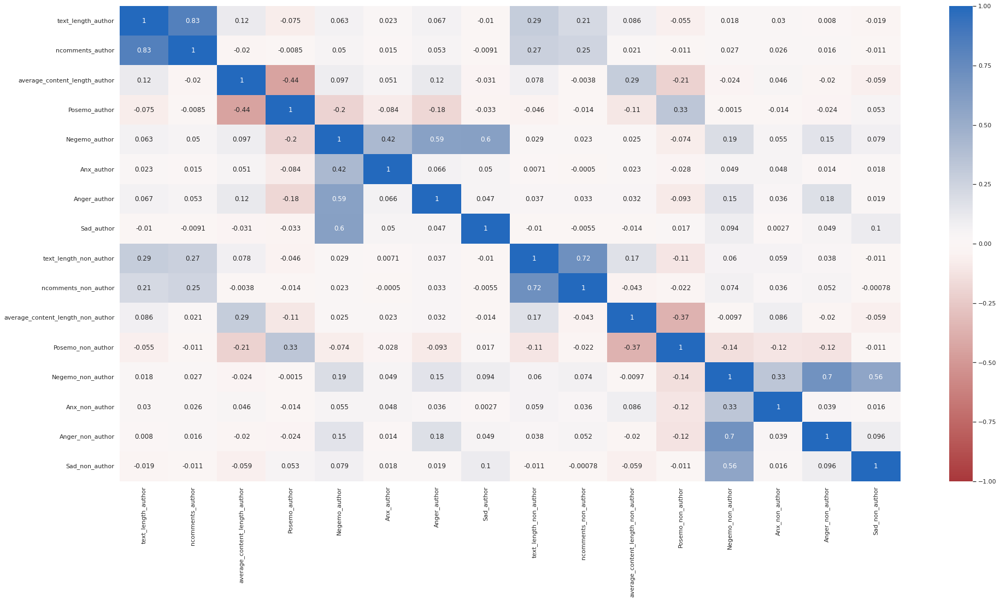

In [340]:
data = {'text_length_author': author_vs_non_author["marvel"][mask2]['text_length_author'], 
        'ncomments_author': author_vs_non_author["marvel"][mask2]['ncomments_author'], 
        'average_content_length_author': author_vs_non_author["marvel"][mask2]['average_content_length_author'], 
        'Posemo_author': author_vs_non_author["marvel"][mask2]['Posemo_author'], 
        'Negemo_author': author_vs_non_author["marvel"][mask2]['Negemo_author'], 
        'Anx_author': author_vs_non_author["marvel"][mask2]['Anx_author'], 
        'Anger_author': author_vs_non_author["marvel"][mask2]['Anger_author'], 
        'Sad_author': author_vs_non_author["marvel"][mask2]['Sad_author'], 
        'text_length_non_author': author_vs_non_author["marvel"][mask2]['text_length_non_author'], 
        'ncomments_non_author': author_vs_non_author["marvel"][mask2]['ncomments_non_author'], 
        'average_content_length_non_author': author_vs_non_author["marvel"][mask2]['average_content_length_non_author'], 
        'Posemo_non_author': author_vs_non_author["marvel"][mask2]['Posemo_non_author'], 
        'Negemo_non_author': author_vs_non_author["marvel"][mask2]['Negemo_non_author'], 
        'Anx_non_author': author_vs_non_author["marvel"][mask2]['Anx_non_author'], 
        'Anger_non_author': author_vs_non_author["marvel"][mask2]['Anger_non_author'], 
        'Sad_non_author': author_vs_non_author["marvel"][mask2]['Sad_non_author']
        }
df = pd.DataFrame(data,columns=['text_length_author', 
                                'ncomments_author', 
                                'average_content_length_author', 
                                'Posemo_author', 
                                'Negemo_author', 
                                'Anx_author', 
                                'Anger_author', 
                                'Sad_author', 
                                'text_length_non_author', 
                                'ncomments_non_author', 
                                'average_content_length_non_author', 
                                'Posemo_non_author', 
                                'Negemo_non_author', 
                                'Anx_non_author', 
                                'Anger_non_author', 
                                'Sad_non_author'
                               ])
plt.figure(figsize=(32, 16))
corrMatrix = df.corr()
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

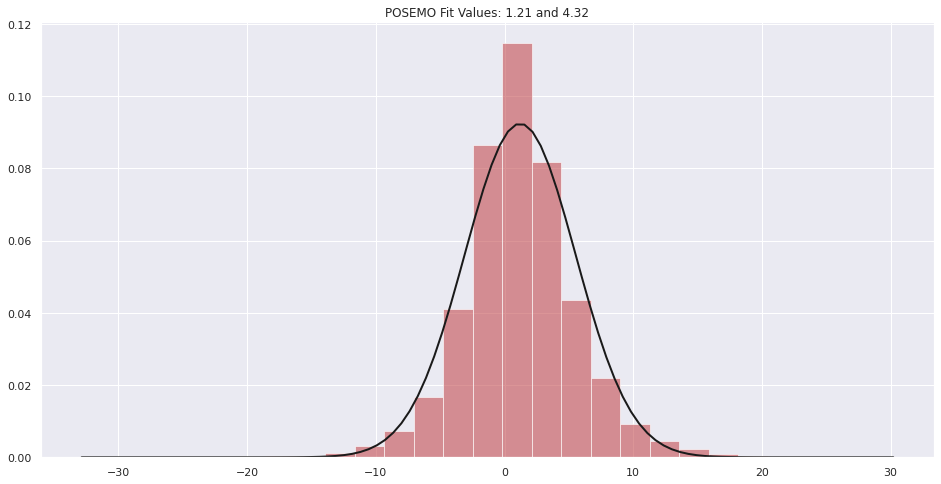

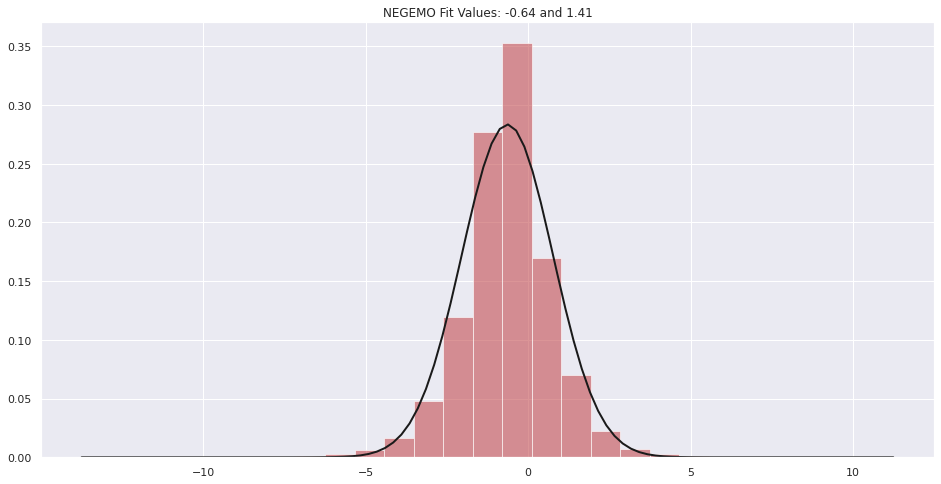

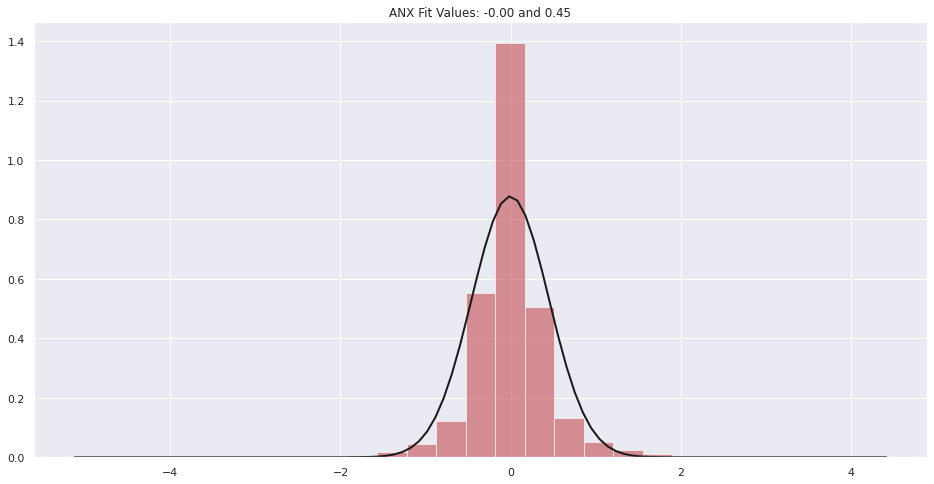

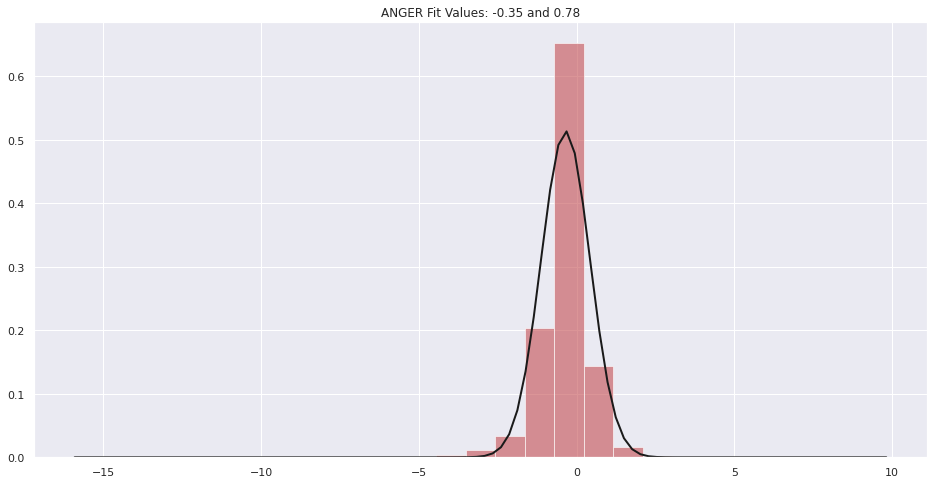

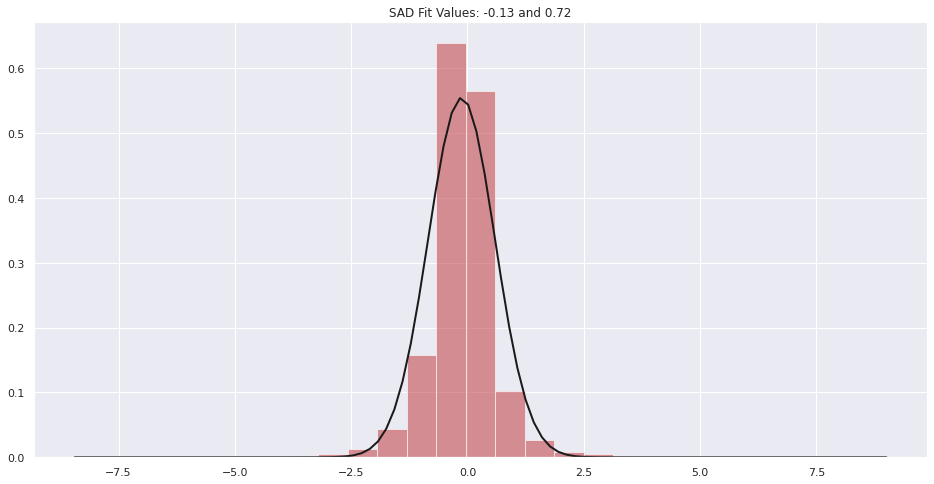

...

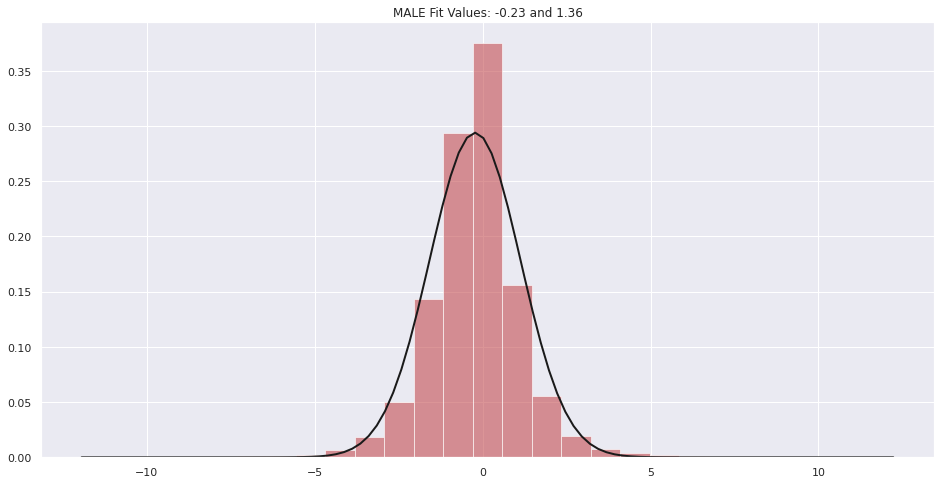

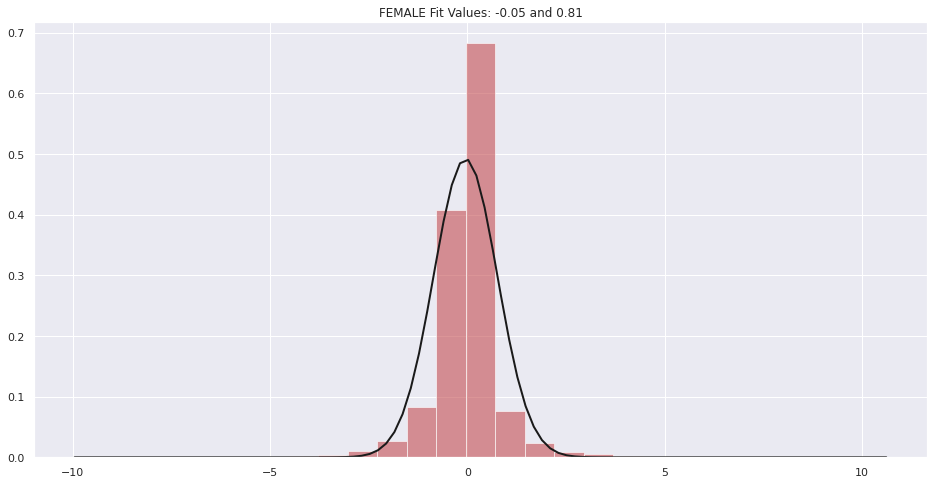

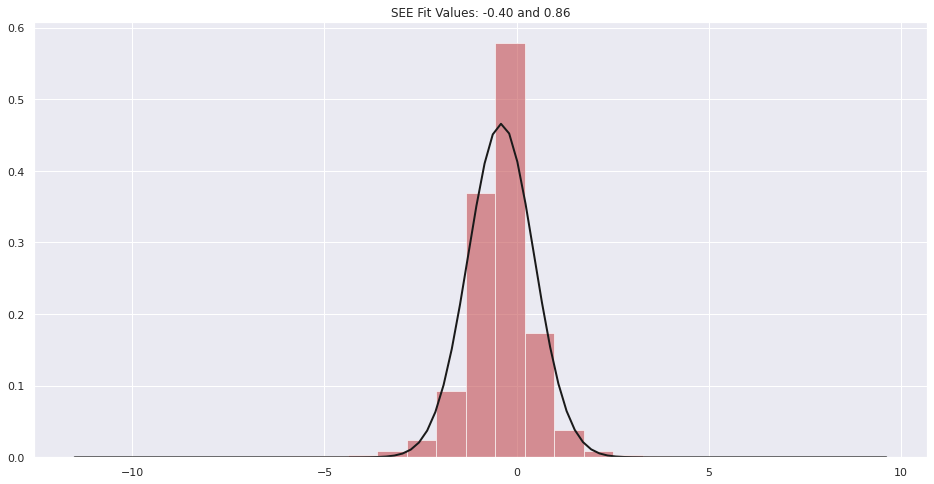

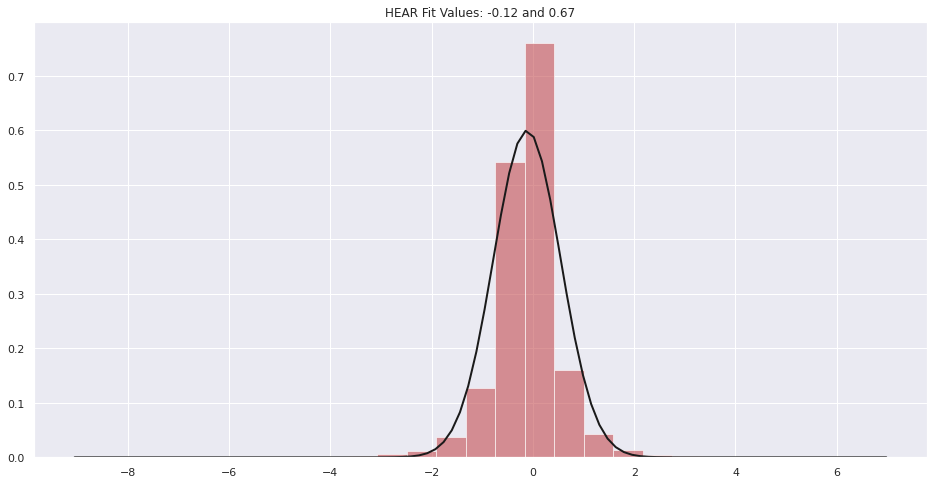

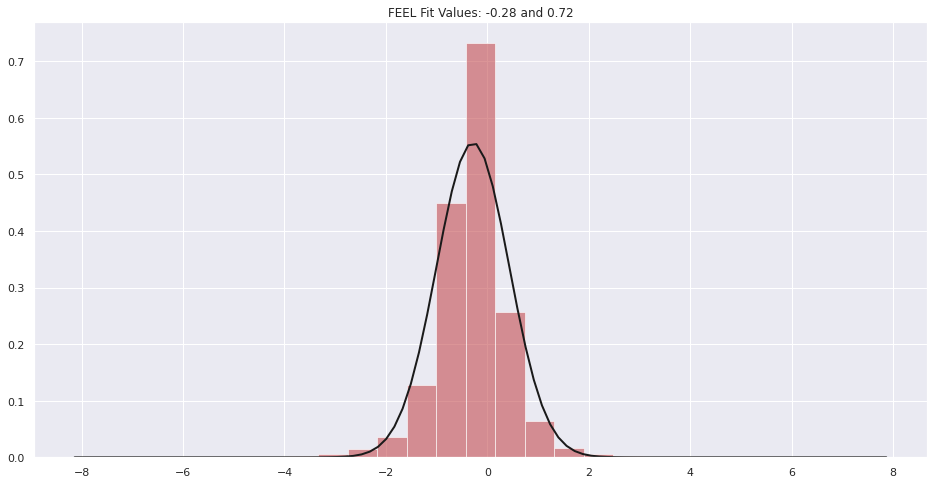

In [341]:
for category in liwc_categories_main:
    plt.figure(figsize=(16, 8))
    data = author_vs_non_author["marvel"][mask2][f'author_vs_non_author_{category}'] 
    #Fit a normal distribution to the data: mean and standard deviation
    mu, std = norm.fit(data)  
    #Plot the histogram
    plt.hist(data, bins=25, density=True, alpha=0.6, color='r')
    #Plot the PDF
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, 'k', linewidth=2)
    title = "{} Fit Values: {:.2f} and {:.2f}".format(category.upper(), mu, std)
    plt.title(title)
    plt.show()

And now let's compare it all and see the difference distributions of the categories together. In blue the one that takes a work, considers the comments of the author separate from those of others, while in red the author when it is compared to when it is not.

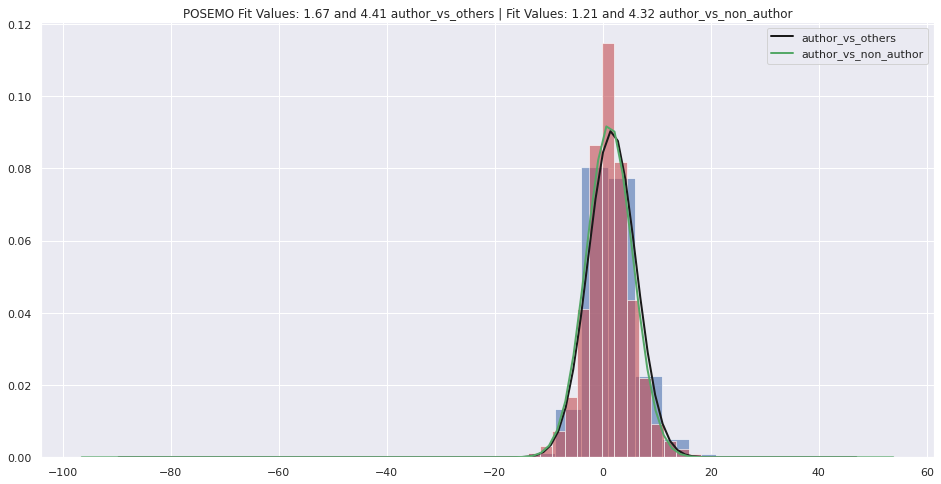

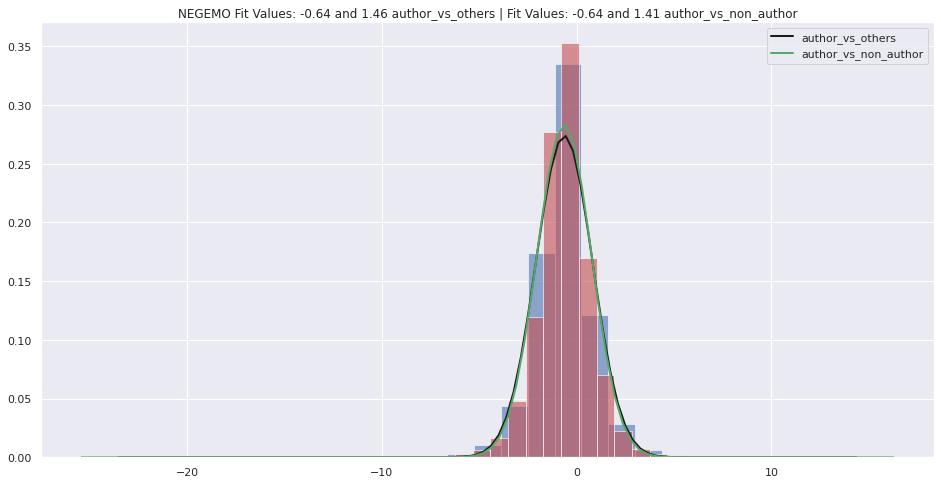

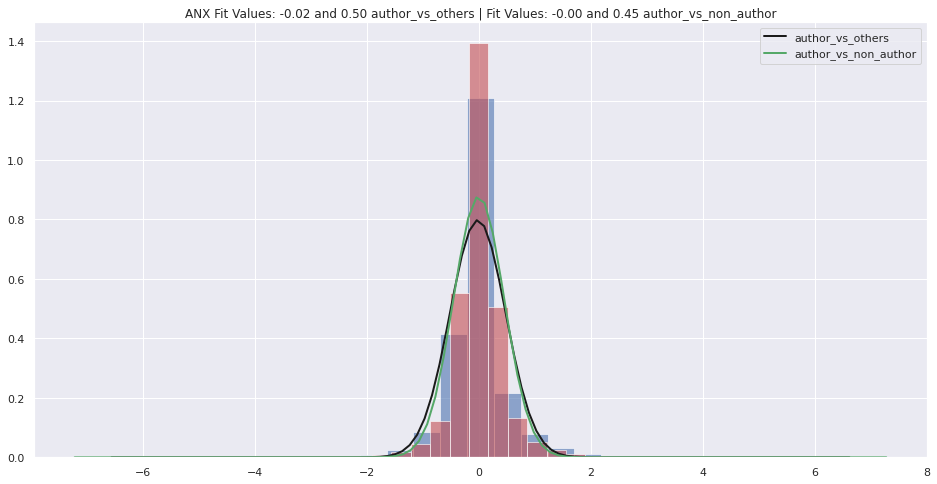

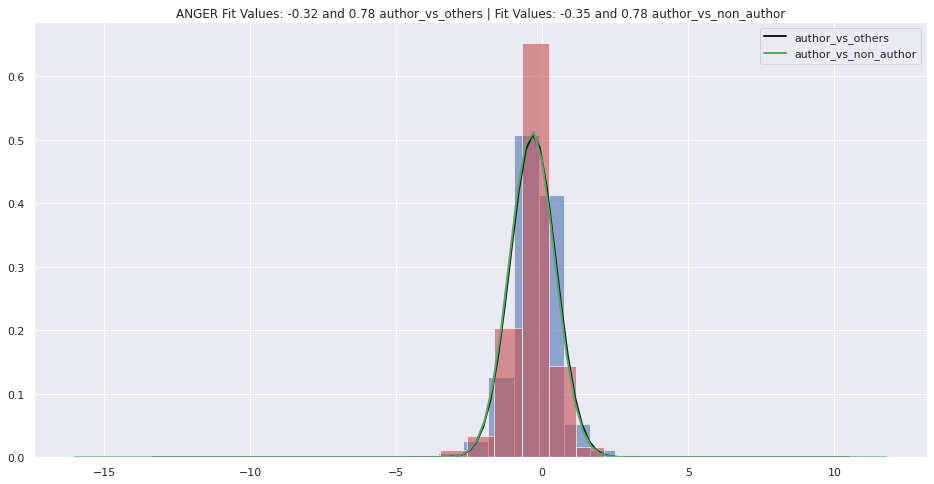

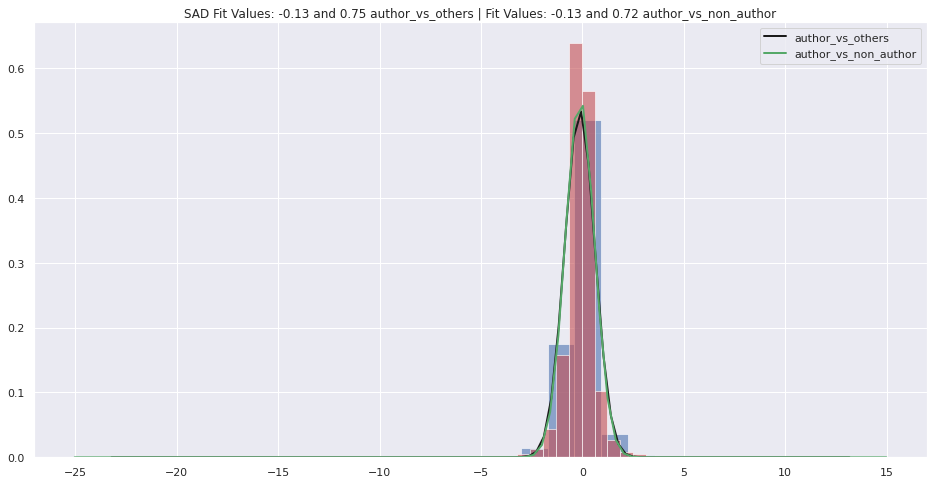

...

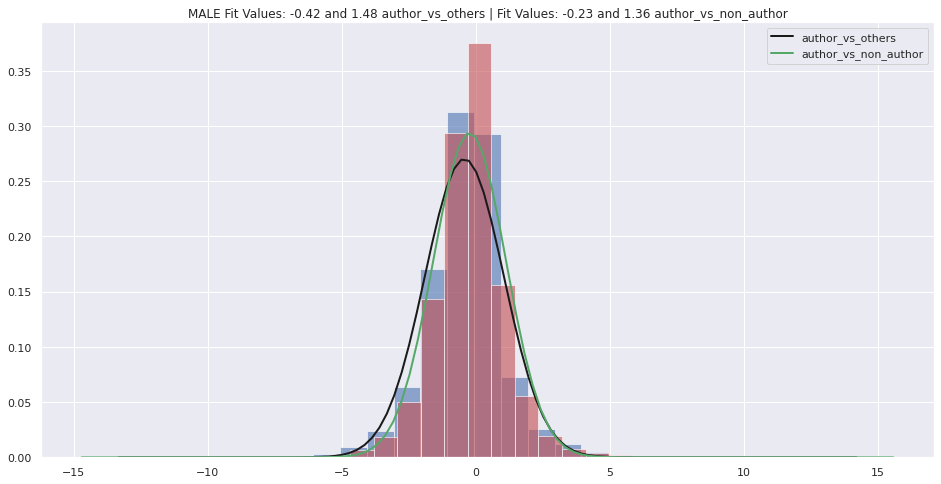

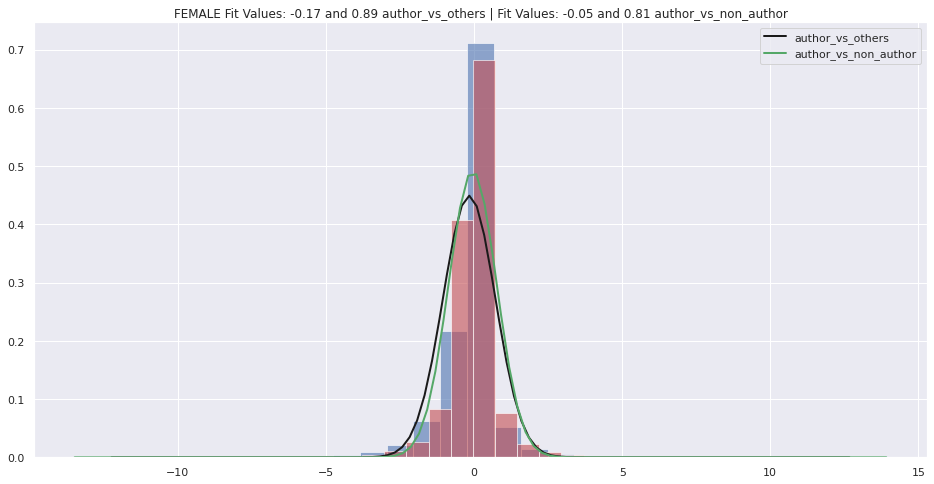

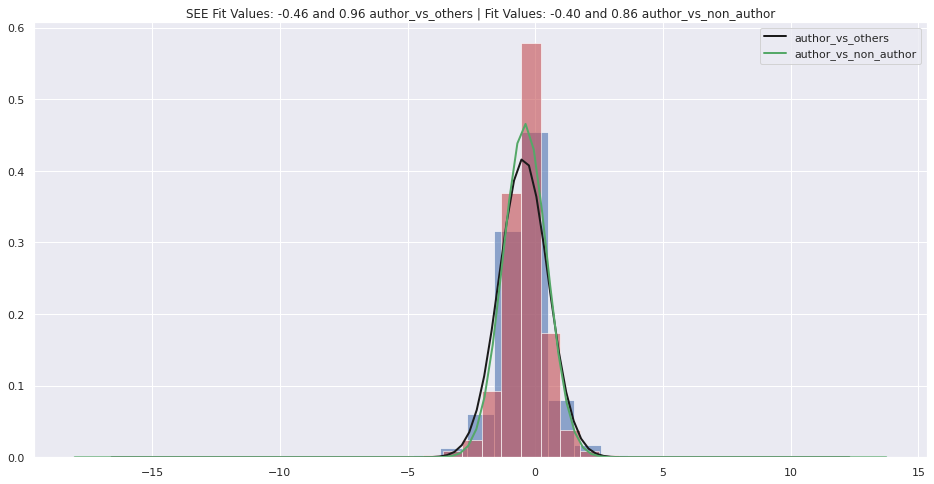

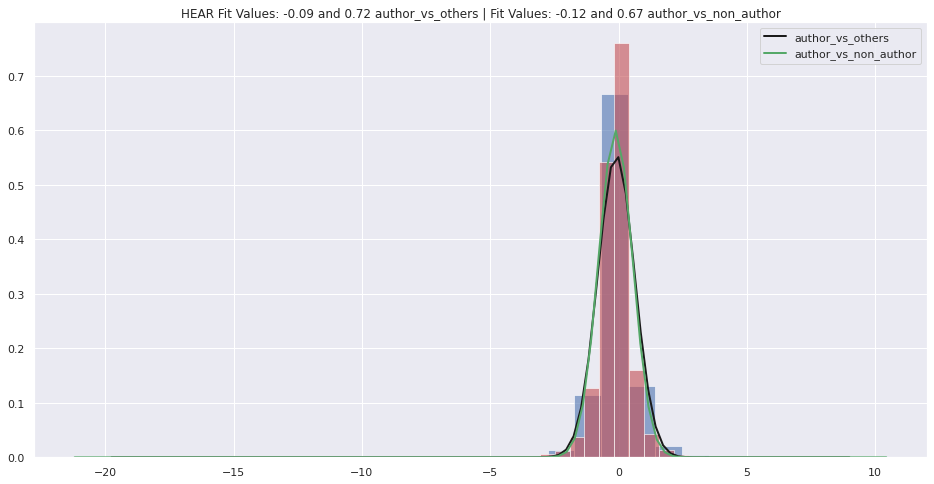

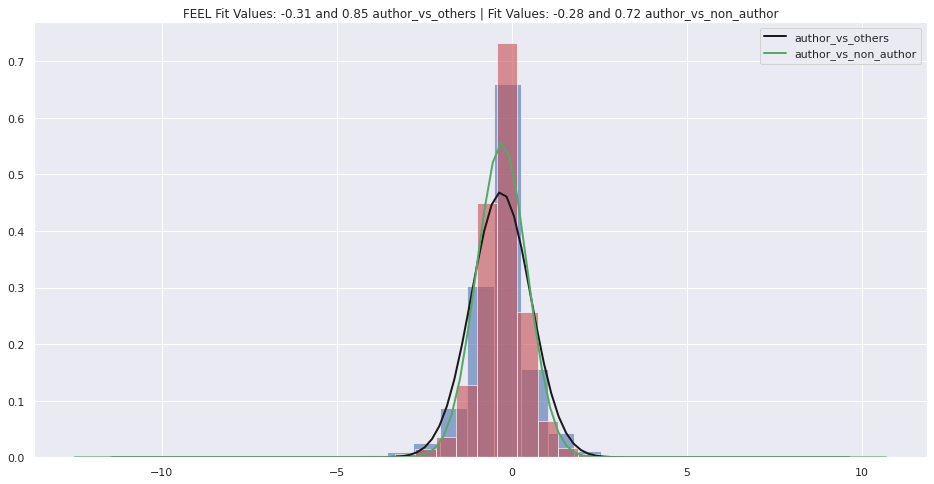

In [342]:
for category in liwc_categories_main:
    plt.figure(figsize=(16, 8))
    data = author_vs_others_per_work["marvel"][mask1][f'author_vs_others_{category}'] 
    #Fit a normal distribution to the data: mean and standard deviation
    mu, std = norm.fit(data)  
    #Plot the histogram
    plt.hist(data, bins=25, density=True, alpha=0.6, color='b')
    #Plot the PDF
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, 'k', linewidth=2)
    title = "{} Fit Values: {:.2f} and {:.2f} author_vs_others | ".format(category.upper(), mu, std)
    data = author_vs_non_author["marvel"][mask2][f'author_vs_non_author_{category}'] 
    #Fit a normal distribution to the data: mean and standard deviation
    mu, std = norm.fit(data)  
    #Plot the histogram
    plt.hist(data, bins=25, density=True, alpha=0.6, color='r')
    #Plot the PDF
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, 'g', linewidth=2)
    title += "Fit Values: {:.2f} and {:.2f} author_vs_non_author".format(mu, std)
    plt.title(title)
    plt.legend(['author_vs_others', 'author_vs_non_author'])
    plt.show()

In [343]:
joint_analysis = analysed_users_all_communities.join(author_vs_non_author["marvel"][mask2])
joint_analysis

,Comments (others works),Comments (own works),Commented works,Written works,"Avg ""comments"" (others works)","Avg ""comments"" (own works)",Avg pagerank (others works),Avg pagerank (own works),Avg out degree (others works),Avg out degree (own works),...,author_vs_non_author_SheHe,author_vs_non_author_We,author_vs_non_author_They,author_vs_non_author_You,author_vs_non_author_Ipron,author_vs_non_author_Male,author_vs_non_author_Female,author_vs_non_author_See,author_vs_non_author_Hear,author_vs_non_author_Feel
user,,,,,,,,,,,,,,,,,,,,,
STARSdidathing,24127,22718,848,423,28.451651,53.706856,25.682568,39.976303,19,38,...,-1.82,-0.03,0.08,3.24,0.26,-1.83,-0.06,-0.63,-0.30,-0.66
Nonymos,20748,19389,668,42,31.059880,461.642857,58.772795,221.000000,14,218,...,-0.78,0.04,0.07,2.37,-0.60,-0.79,-0.03,-0.50,-0.12,-0.32
Hermaline75,15944,14810,380,109,41.957895,135.871560,24.705736,34.545455,7,31,...,1.40,-0.03,-0.17,0.84,0.26,0.98,0.38,-0.24,-0.16,-0.28
AnonEhouse,14844,11028,1489,336,9.969107,32.821429,52.623568,37.246988,3,28,...,-0.19,-0.03,-0.03,-0.06,0.42,-0.08,-0.16,-0.22,-0.05,-0.12
Sineala,14214,12708,1537,157,9.247885,80.942675,18.817739,63.922581,6,62,...,0.38,0.01,0.07,1.00,-0.44,0.26,0.03,-0.49,-0.11,-0.16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Calendula07,0,0,0,11,0.000000,0.000000,0.000000,0.000000,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
RedK_addict,0,0,0,11,0.000000,0.000000,0.000000,0.000000,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
d_aredevisl,0,0,0,11,0.000000,0.000000,0.000000,0.000000,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [344]:
joint_analysis.describe()

,Comments (others works),Comments (own works),Commented works,Written works,"Avg ""comments"" (others works)","Avg ""comments"" (own works)",Avg pagerank (others works),Avg pagerank (own works),Avg out degree (others works),Avg out degree (own works),...,author_vs_non_author_SheHe,author_vs_non_author_We,author_vs_non_author_They,author_vs_non_author_You,author_vs_non_author_Ipron,author_vs_non_author_Male,author_vs_non_author_Female,author_vs_non_author_See,author_vs_non_author_Hear,author_vs_non_author_Feel
count,8701.000000,8701.000000,8701.000000,8701.000000,8701.000000,8701.000000,8701.000000,8701.000000,8701.000000,8701.000000,...,6643.000000,6643.000000,6643.00000,6643.000000,6643.000000,6643.000000,6643.000000,6643.000000,6643.000000,6643.000000
mean,432.476267,303.579589,91.373520,30.280887,5.006860,9.538661,15.517819,19.551522,1.339386,10.515803,...,-0.193568,0.000327,0.00908,2.183614,-1.112398,-0.206523,-0.068421,-0.388490,-0.138492,-0.314552
std,1012.516118,836.739883,188.498857,35.086831,7.539918,21.013001,19.683847,23.545071,3.456209,12.729354,...,1.263856,0.298349,0.57267,2.631062,1.952096,1.073352,0.633786,0.620824,0.486677,0.551168
min,0.000000,0.000000,0.000000,11.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-15.330000,-4.700000,-4.45000,-8.000000,-15.110000,-7.640000,-9.020000,-7.020000,-4.880000,-5.260000
25%,32.000000,17.000000,12.000000,14.000000,1.758333,0.833333,2.043902,0.000000,0.000000,0.000000,...,-0.810000,-0.100000,-0.27000,0.510000,-1.900000,-0.760000,-0.250000,-0.650000,-0.330000,-0.560000
50%,123.000000,72.000000,33.000000,19.000000,2.875000,3.312500,8.636364,16.000000,0.000000,8.000000,...,-0.100000,0.000000,0.01000,1.860000,-0.820000,-0.170000,0.000000,-0.350000,-0.100000,-0.280000
75%,404.000000,245.000000,91.000000,32.000000,5.240000,9.909091,22.385246,26.500000,1.000000,15.000000,...,0.500000,0.110000,0.31000,3.510000,0.000000,0.385000,0.170000,-0.070000,0.090000,-0.010000
max,24127.000000,22718.000000,3838.000000,896.000000,207.465116,577.923077,398.166667,739.545455,94.000000,218.000000,...,7.920000,3.690000,3.36000,20.200000,11.510000,7.920000,5.110000,4.290000,6.250000,4.910000


And now we're looking for correlations, also adding Andrea's metrics.

Recall the meaning of some metrics:
- **Comments (others works)**: numero di commenti che fa un autore a work che non sono suoi. 
- **Comments (own works)**: numero di commenti che fa un autore a work suoi.
- **Commented works**: numero di work altrui a cui commenta un autore.
- **Written works**: numero di work scritti da un autore.
- **Avg "comments" (others works)**: numero di commenti in media di un autore per work di altri utenti.
- **Avg "comments" (own works)**: numero di commenti in media di un autore nei suoi work.
- **Avg pagerank (others works)**: quanto è rilevante l'autore nei work degli altri.
- **Avg pagerank (own works)**: quanto è rilevante l'autore nei suoi work.
- **Avg out degree (others works)**: con quanti utenti interagisce in media l'autore in work di altri.
- **Avg out degree (own works)**: con quanti utenti interagisce in media l'autore nei suoi work.
- **Avg in degree (others works)**: quanti utenti interagiscono con l'autore in work che non sono suoi.
- **Avg in degree (own works)**: quanti utenti interagiscono con l'autore nei suoi work.

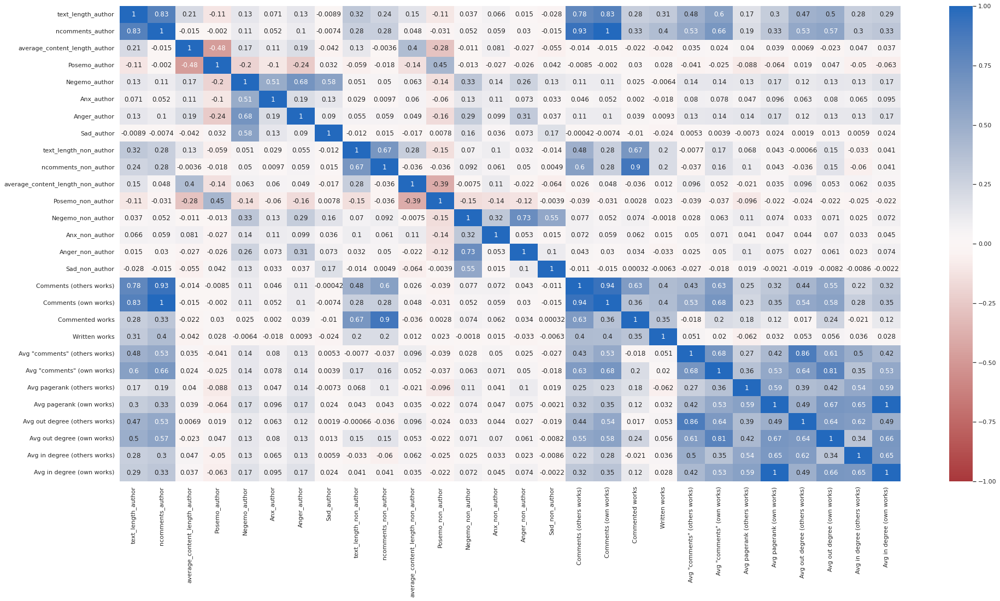

In [345]:
data = {'text_length_author': joint_analysis['text_length_author'], 
        'ncomments_author': joint_analysis['ncomments_author'], 
        'average_content_length_author': joint_analysis['average_content_length_author'], 
        'Posemo_author': joint_analysis['Posemo_author'], 
        'Negemo_author': joint_analysis['Negemo_author'], 
        'Anx_author': joint_analysis['Anx_author'], 
        'Anger_author': joint_analysis['Anger_author'], 
        'Sad_author': joint_analysis['Sad_author'], 
        'text_length_non_author': joint_analysis['text_length_non_author'], 
        'ncomments_non_author': joint_analysis['ncomments_non_author'], 
        'average_content_length_non_author': joint_analysis['average_content_length_non_author'], 
        'Posemo_non_author': joint_analysis['Posemo_non_author'], 
        'Negemo_non_author': joint_analysis['Negemo_non_author'], 
        'Anx_non_author': joint_analysis['Anx_non_author'], 
        'Anger_non_author': joint_analysis['Anger_non_author'], 
        'Sad_non_author': joint_analysis['Sad_non_author'],
        'Comments (others works)': joint_analysis['Comments (others works)'],
        'Comments (own works)': joint_analysis['Comments (own works)'],
        'Commented works': joint_analysis['Commented works'],
        'Written works': joint_analysis['Written works'],
        'Avg "comments" (others works)': joint_analysis['Avg "comments" (others works)'],
        'Avg "comments" (own works)': joint_analysis['Avg "comments" (own works)'],
        'Avg pagerank (others works)': joint_analysis['Avg pagerank (others works)'],
        'Avg pagerank (own works)': joint_analysis['Avg pagerank (own works)'],
        'Avg out degree (others works)': joint_analysis['Avg out degree (others works)'],
        'Avg out degree (own works)': joint_analysis['Avg out degree (own works)'],
        'Avg in degree (others works)': joint_analysis['Avg in degree (others works)'],
        'Avg in degree (own works)': joint_analysis['Avg in degree (own works)']
        }
df = pd.DataFrame(data,columns=['text_length_author', 
                                'ncomments_author', 
                                'average_content_length_author', 
                                'Posemo_author', 
                                'Negemo_author', 
                                'Anx_author', 
                                'Anger_author', 
                                'Sad_author', 
                                'text_length_non_author', 
                                'ncomments_non_author', 
                                'average_content_length_non_author', 
                                'Posemo_non_author', 
                                'Negemo_non_author', 
                                'Anx_non_author', 
                                'Anger_non_author', 
                                'Sad_non_author',
                                'Comments (others works)',
                                'Comments (own works)',
                                'Commented works',
                                'Written works',
                                'Avg "comments" (others works)',
                                'Avg "comments" (own works)',
                                'Avg pagerank (others works)',
                                'Avg pagerank (own works)',
                                'Avg out degree (others works)',
                                'Avg out degree (own works)',
                                'Avg in degree (others works)',
                                'Avg in degree (own works)'
                               ])
plt.figure(figsize=(32, 16))
corrMatrix = df.corr()
corrMatrix.to_csv('./marvel/marvel_third_comparison.csv')
sns.heatmap(corrMatrix, vmin=-1, vmax=1, cmap="vlag_r", annot=True)
plt.show()

And now let see a **comparison of emotions between first level comments and all the others**. In this analysis we consider only others comments, that is everyone except author.

In [ ]:
community_by_work_level_analysis["marvel"] = ao3_comments_dfs["marvel"].copy(deep=True)
community_by_work_level_analysis["marvel"] = community_by_work_level_analysis["marvel"].drop(labels=['chapter', 'datetime', 'work_author', 'comment_id', 'text_len', 'reply_to'], axis=1)
community_by_work_level_analysis["marvel"] = community_by_work_level_analysis["marvel"][[False if elem in list(authors_wid["marvel"].items()) else True for elem in list(zip(community_by_work_level_analysis["marvel"]['work_id'], community_by_work_level_analysis["marvel"]['comment_author']))]]
community_by_work_level_analysis["marvel"]['parent_id'] = community_by_work_level_analysis["marvel"]['parent_id'].apply(lambda x: 1 if x == -1 else 2)
community_by_work_level_analysis["marvel"] = community_by_work_level_analysis["marvel"].groupby(['work_id', 'parent_id']).agg({'text': ' '.join})
community_by_work_level_analysis["marvel"]

In [ ]:
columns = { 'text_length': [], 'Posemo': [], 'Negemo': [], 'Anx': [], 'Anger': [], 'Sad': [] }
           
community_by_work_level_analysis["marvel"] = community_by_work_level_analysis["marvel"].reset_index()

for index, row in community_by_work_level_analysis["marvel"].iterrows():
    text = row['text'].lower()
    text_tokens = tokenize(text)
    text_tokens_len = len(list(tokenize(text)))
    columns['text_length'].append(text_tokens_len)
    text_categories = Counter(category for token in text_tokens for category in parse(token))
    #Adding categories with values and filling missing categories with 0 value
    for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
        if category in text_categories:
            columns[category].append(float(text_categories[category]))
        else:
            columns[category].append(float(0))
            
for column in columns:
    community_by_work_level_analysis["marvel"][column] = columns[column]
    
#Calculate liwc categories' percentages
for i, row in community_by_work_level_analysis["marvel"].iterrows():
    for category in ['Posemo', 'Negemo', 'Anx', 'Anger', 'Sad']:
        ifor_val = 0.00
        if row[category] != 0:
                ifor_val = round(((row[category] / row['text_length']) * 100), 2)
        community_by_work_level_analysis["marvel"].at[i,category] = ifor_val
            
community_by_work_level_analysis["marvel"].set_index(['work_id', 'parent_id'], inplace=True)
community_by_work_level_analysis["marvel"]

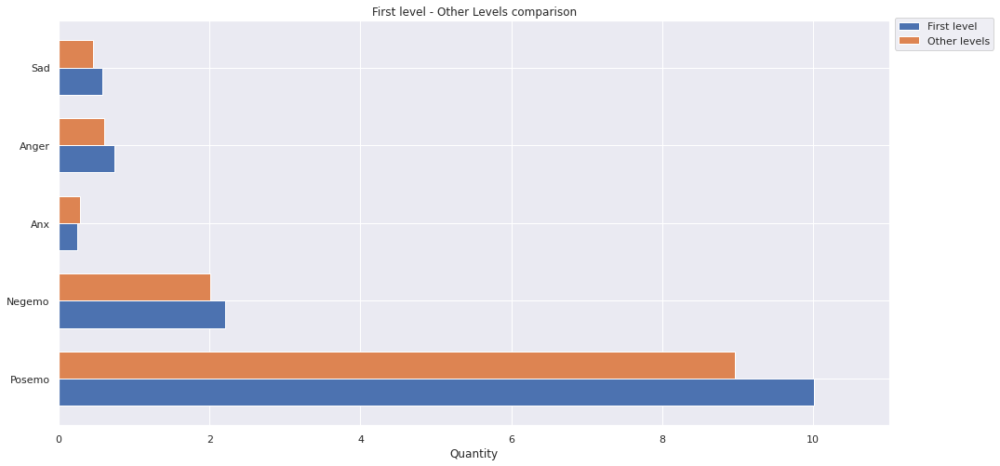

In [346]:
bar_chart(pd.concat([community_by_work_level_analysis["marvel"][community_by_work_level_analysis["marvel"].index.get_level_values('parent_id') == 1].describe().iloc[1].to_frame().rename(columns = {'mean' : 'First level'}),
                     community_by_work_level_analysis["marvel"][community_by_work_level_analysis["marvel"].index.get_level_values('parent_id') == 2].describe().iloc[1].to_frame().rename(columns = {'mean' : 'Other levels'})],axis=1).reset_index(level=0)[1:6].set_index('index'),
          "First level - Other Levels comparison", fmt='%.2f', width=0.7)

#### Exporting

In [ ]:
#Part of the study related to the community
community_by_comment["marvel"].to_csv('./marvel/marvel_community_by_comment.csv')
community_by_work["marvel"].to_csv('./marvel/marvel_community_by_work.csv')
community_by_author["marvel"].to_csv('./marvel/marvel_community_by_author.csv')
community_by_user["marvel"].to_csv('./marvel/marvel_community_by_user.csv')
daily_stats["marvel"].to_csv('./marvel/marvel_daily_stats.csv')
total_stats["marvel"].to_csv('./marvel/marvel_total_stats.csv')
monthly_stats["marvel"].to_csv('./marvel/marvel_monthly_stats.csv')
#Part of the study related to the centrality of the author and the user more in general
authors_on_their_works["marvel"].to_csv('./marvel/marvel_authors_on_their_works.csv')
authors_on_others_works["marvel"].to_csv('./marvel/marvel_authors_on_others_works.csv')
authors_vs_others_comparison["marvel"].to_csv('./marvel/marvel_authors_vs_others_comparison.csv')
very_authors_vs_others_comparison["marvel"].to_csv('./marvel/marvel_very_authors_vs_others_comparison.csv')
author_vs_non_author_comparison["marvel"].to_csv('./marvel/marvel_author_vs_non_author_comparison.csv')
author_vs_others_per_work["marvel"].to_csv('./marvel/marvel_author_vs_others_per_work.csv')
author_vs_non_author["marvel"].to_csv('./marvel/marvel_author_vs_non_author.csv')
word_frequency_author_vs_others_author["marvel"].to_csv('./marvel/marvel_word_frequency_author_vs_others_author.csv')
word_frequency_author_vs_others_others["marvel"].to_csv('./marvel/marvel_word_frequency_author_vs_others_others.csv')
word_frequency_author_vs_non_author_author["marvel"].to_csv('./marvel/marvel_word_frequency_author_vs_non_author_author.csv')
word_frequency_author_vs_non_author_non_author["marvel"].to_csv('./marvel/marvel_word_frequency_author_vs_non_author_non_author.csv')
community_by_work_level_analysis["marvel"].to_csv('./marvel/marvel_community_by_work_level_analysis.csv')